<a href="https://colab.research.google.com/github/lightdiffraction/sem6_nnlabs/blob/main/BDZ.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install ncg_optimizer
!pip install ucimlrepo
!pip install gradoptorch
!pip install torch-levenberg-marquardt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 96.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 84.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 50.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 67.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import torch.nn as nn
import torch.optim as optim
import torch
import tqdm
from sklearn.preprocessing import OneHotEncoder
import numpy as np
from sklearn.model_selection import StratifiedKFold, train_test_split
from gradoptorch import optimize_module
import torch_levenberg_marquardt as tlm

In [ ]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
diabetic_retinopathy_debrecen = fetch_ucirepo(id=329)

# data (as pandas dataframes)
X = diabetic_retinopathy_debrecen.data.features
y = diabetic_retinopathy_debrecen.data.targets

# metadata
#print(diabetic_retinopathy_debrecen.metadata)

# variable information
#print(diabetic_retinopathy_debrecen.variables)

In [ ]:
X.shape[1]

16

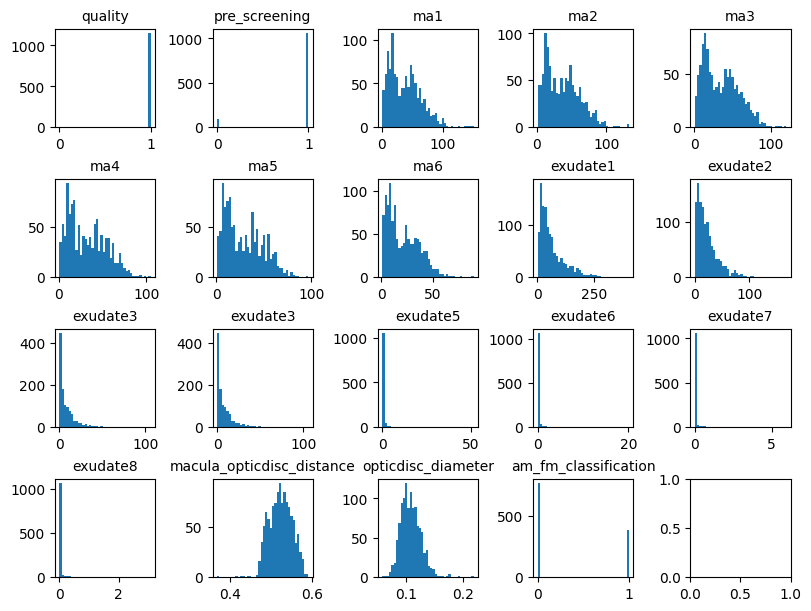

In [ ]:
fig, axs = plt.subplots(4, 5, figsize=(8, 6), layout='constrained')

for i in range(X.shape[1]):
    axs[int(i/5), int(i%5)].hist(X.iloc[:, i], bins = 40)
    axs[int(i/5), int(i%5)].set_title(X.iloc[:, i].name, fontsize = 10)
plt.show()

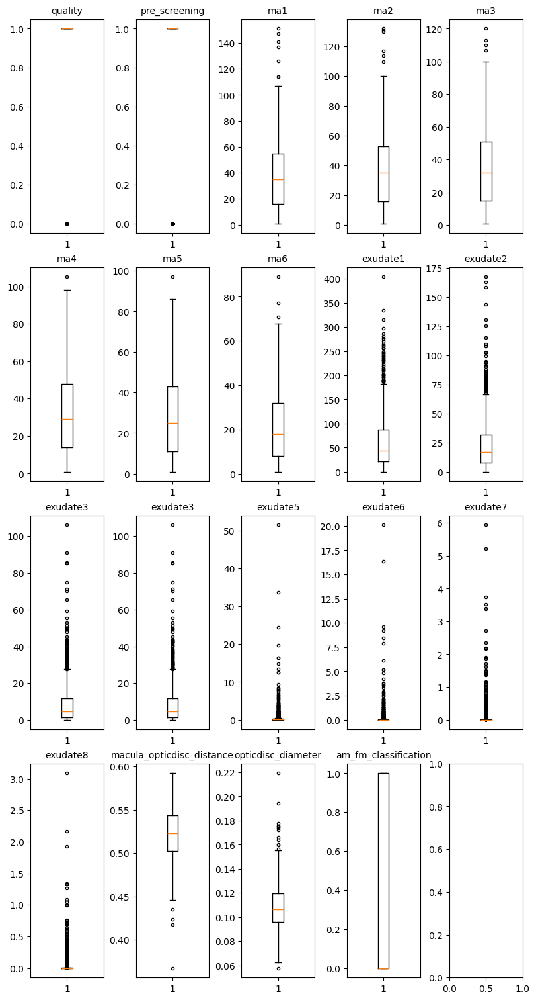

In [ ]:
#for i in range(X.shape[1]):
#    plt.boxplot(X.iloc[:, i])
#    plt.title(X.iloc[:, i].name)
#    plt.show()
fig, axs = plt.subplots(4, 5, figsize=(8, 15), layout='constrained')
flierprops={'marker': 'o', 'markersize': 3}
for i in range(X.shape[1]):
    axs[int(i/5), int(i%5)].boxplot(X.iloc[:, i], flierprops = flierprops)
    axs[int(i/5), int(i%5)].set_title(X.iloc[:, i].name, fontsize = 10)
plt.show()

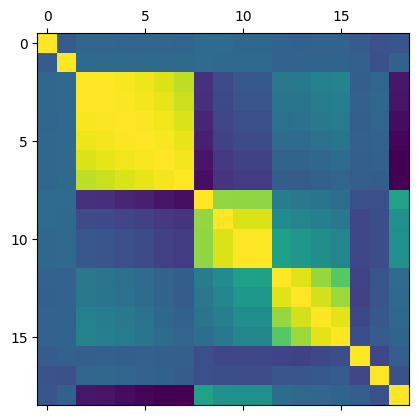

In [ ]:
plt.matshow(X.corr())
plt.show()

0 0
0 1
0 2
0 3
0 4
0 5
0 6
0 7
0 8
0 9
0 10
0 11
0 12
0 13
0 14
0 15
0 16
0 17
0 18
1 0
1 1
1 2
1 3
1 4
1 5
1 6
1 7
1 8
1 9
1 10
1 11
1 12
1 13
1 14
1 15
1 16
1 17
1 18
2 0
2 1
2 2
2 3
2 4
2 5
2 6
2 7
2 8
2 9
2 10
2 11
2 12
2 13
2 14
2 15
2 16
2 17
2 18
3 0
3 1
3 2
3 3
3 4
3 5
3 6
3 7
3 8
3 9
3 10
3 11
3 12
3 13
3 14
3 15
3 16
3 17
3 18
4 0
4 1
4 2
4 3
4 4
4 5
4 6
4 7
4 8
4 9
4 10
4 11
4 12
4 13
4 14
4 15
4 16
4 17
4 18
5 0
5 1
5 2
5 3
5 4
5 5
5 6
5 7
5 8
5 9
5 10
5 11
5 12
5 13
5 14
5 15
5 16
5 17
5 18
6 0
6 1
6 2
6 3
6 4
6 5
6 6
6 7
6 8
6 9
6 10
6 11
6 12
6 13
6 14
6 15
6 16
6 17
6 18
7 0
7 1
7 2
7 3
7 4
7 5
7 6
7 7
7 8
7 9
7 10
7 11
7 12
7 13
7 14
7 15
7 16
7 17
7 18
8 0
8 1
8 2
8 3
8 4
8 5
8 6
8 7
8 8
8 9
8 10
8 11
8 12
8 13
8 14
8 15
8 16
8 17
8 18
9 0
9 1
9 2
9 3
9 4
9 5
9 6
9 7
9 8
9 9
9 10
9 11
9 12
9 13
9 14
9 15
9 16
9 17
9 18
10 0
10 1
10 2
10 3
10 4
10 5
10 6
10 7
10 8
10 9
10 10
10 11
10 12
10 13
10 14
10 15
10 16
10 17
10 18
11 0
11 1
11 2
11 3
11 4
11 5
11 6
11 7
11 8
1

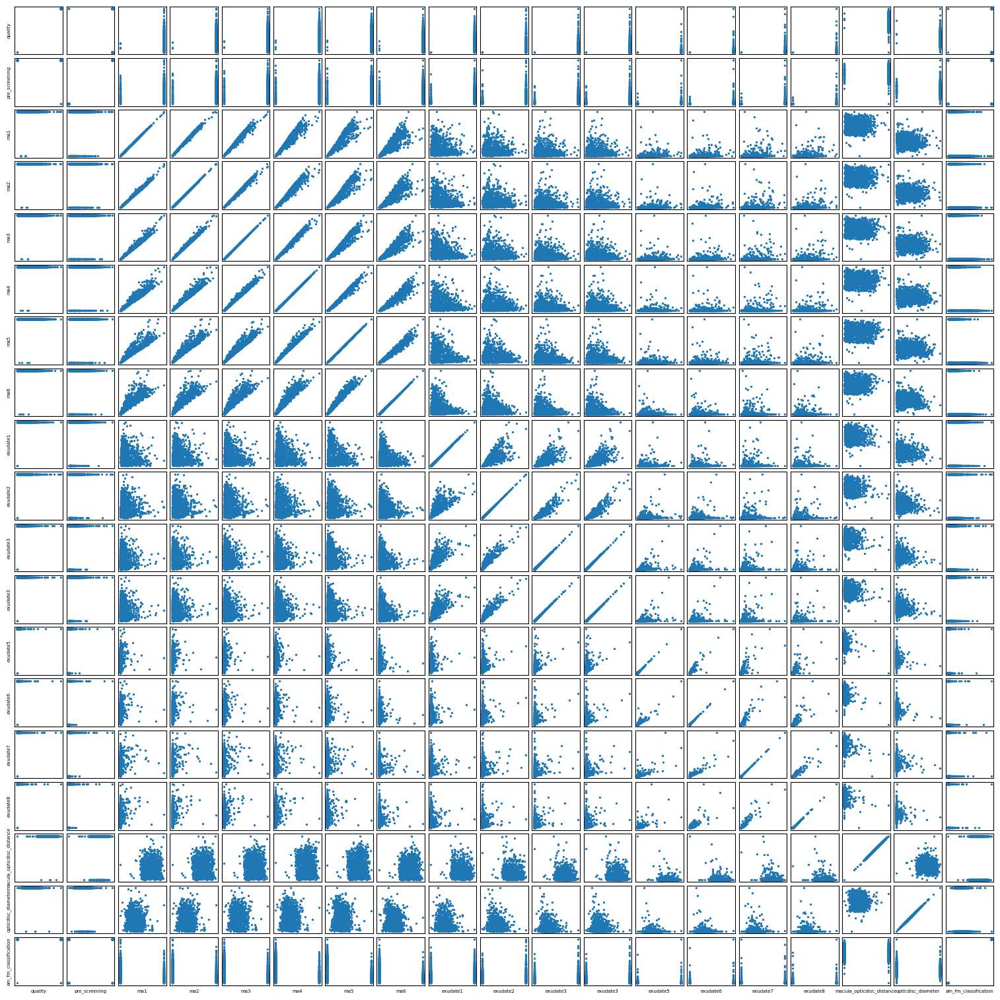

In [ ]:
fig, axs = plt.subplots(19, 19, figsize=(15, 15), layout='constrained')
fig.get_layout_engine().set(w_pad=2 / 72, h_pad=2 / 72, hspace=0,
                            wspace=0)
for i in range(X.shape[1]):
  for j in range(X.shape[1]):
    print(i,j)
    axs[i,j].scatter(X.iloc[:, i], X.iloc[:, j], s = 2)
    axs[i,j].set_xticks([])
    axs[i,j].set_yticks([])
    if (i == X.shape[1]-1):
      axs[i, j].set_xlabel(X.iloc[:, j].name, fontsize = 5)
    if (j == 0):
      axs[i, j].set_ylabel(X.iloc[:, i].name, fontsize = 5)
    #axs[i,j].set_title(X.iloc[:, i].name + ", " + X.iloc[:, j].name, fontsize = 10)

plt.show()


In [ ]:
#удаление дубликатов
X = X.loc[:,~X.columns.duplicated()].copy()

In [ ]:
from scipy import stats

In [ ]:
#for i in range(X.shape[1]):
  #  q_low = X.iloc[:, i].quantile(0.01)
   # q_hi  = X.iloc[:, i].quantile(0.99)
    #outlier_indices = np.where((X.iloc[:, i] < q_hi) & (X.iloc[:, i] > q_low))[0]
 #   X = X.drop(outlier_indices)
  #  y = y.drop(outlier_indices)
   # X.reset_index(drop=True, inplace = True)
   # y.reset_index(drop=True, inplace = True)
    #print (len(X))



In [ ]:
backup_X = X
backup_y = y

In [ ]:
threshold_z = 3
X = backup_X
y = backup_y
for i in range(X.shape[1]):
    z = np.abs(stats.zscore(X.iloc[:, i]))
    median = X.iloc[:, i].median()
    outlier_indices = np.where(abs(z) > threshold_z)[0]
    for j in outlier_indices:
      X.iloc[j, i] = median
    #X = X.drop(outlier_indices)
    #X.reset_index(drop=True, inplace = True)
    #y = y.drop(outlier_indices)
    #y.reset_index(drop=True, inplace = True)

In [ ]:
len(X)

1151

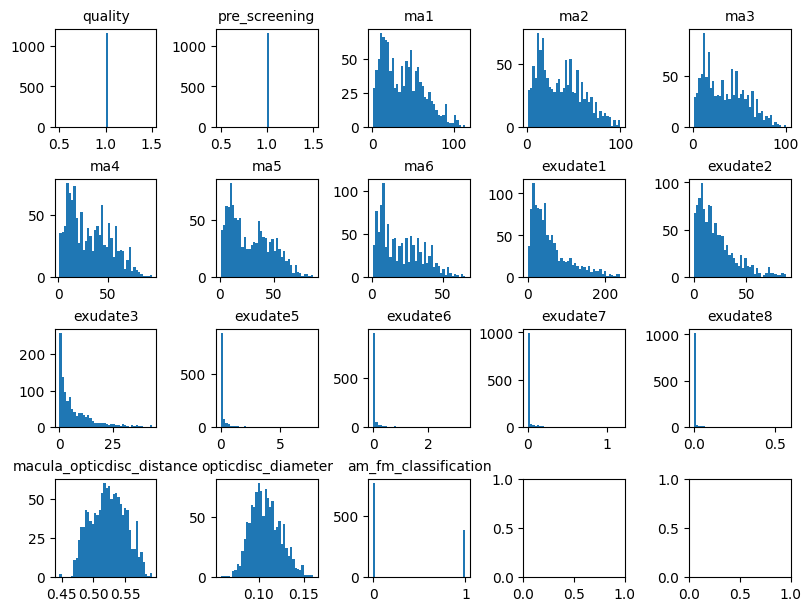

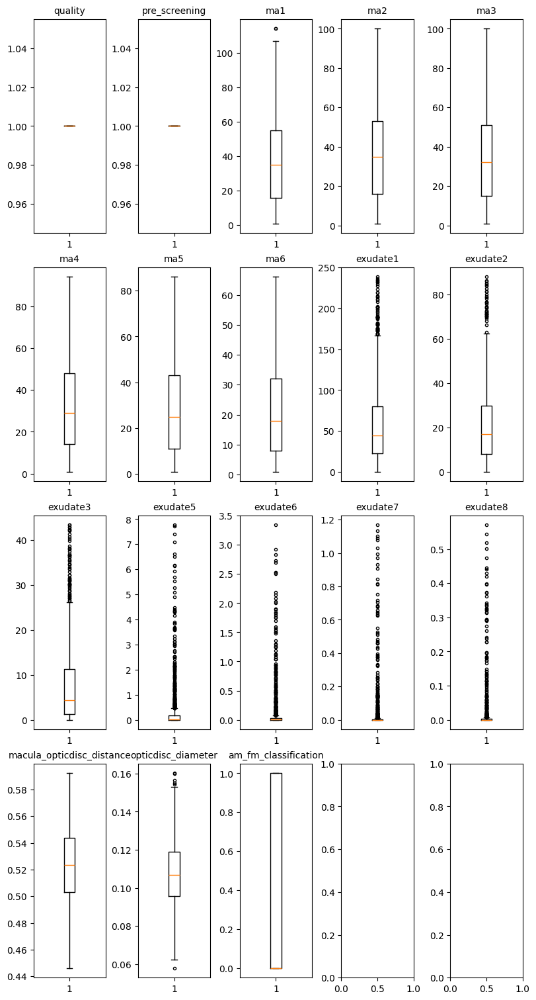

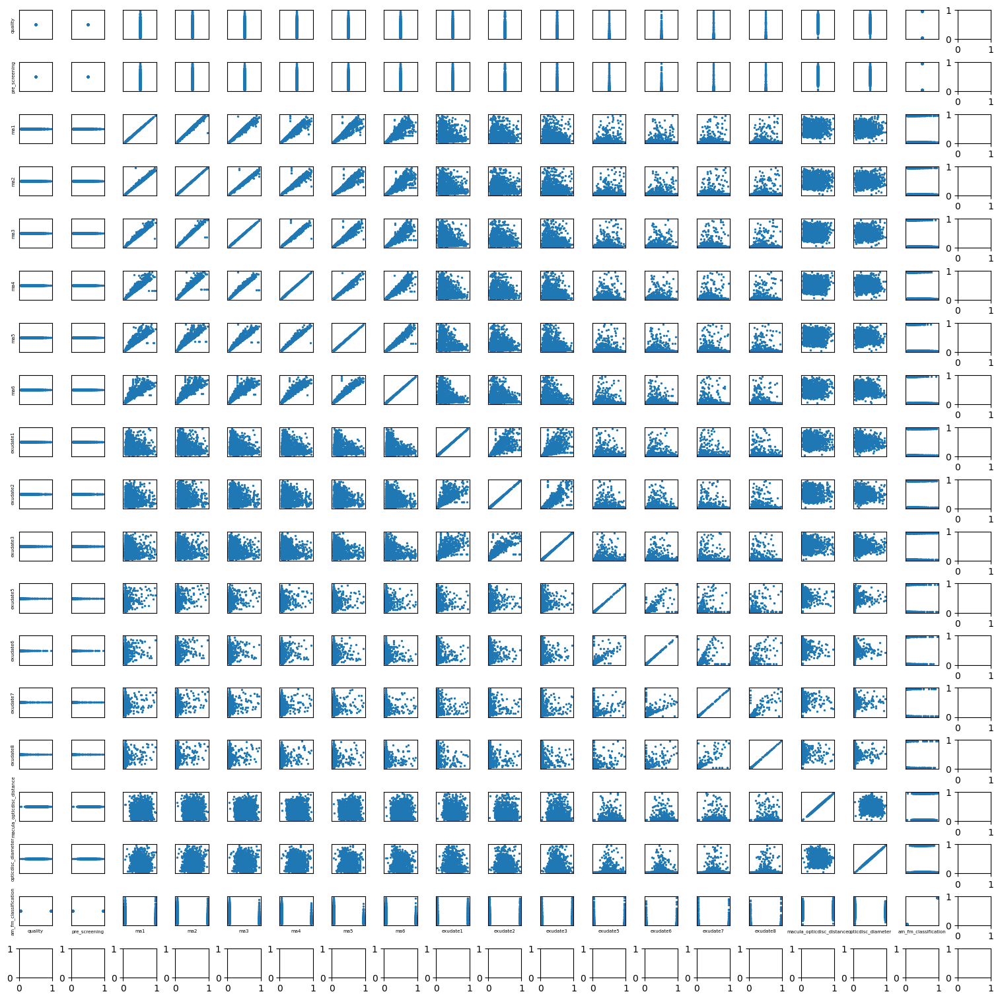

In [ ]:
fig, axs = plt.subplots(4, 5, figsize=(8, 6), layout='constrained')

for i in range(X.shape[1]):
    axs[int(i/5), int(i%5)].hist(X.iloc[:, i], bins = 40)
    axs[int(i/5), int(i%5)].set_title(X.iloc[:, i].name, fontsize = 10)
plt.show()

fig, axs = plt.subplots(4, 5, figsize=(8, 15), layout='constrained')
flierprops={'marker': 'o', 'markersize': 3}
for i in range(X.shape[1]):
    axs[int(i/5), int(i%5)].boxplot(X.iloc[:, i], flierprops = flierprops)
    axs[int(i/5), int(i%5)].set_title(X.iloc[:, i].name, fontsize = 10)
plt.show()

fig, axs = plt.subplots(19, 19, figsize=(15, 15), layout='constrained')
fig.get_layout_engine().set(w_pad=2 / 72, h_pad=2 / 72, hspace=0,
                            wspace=0)
for i in range(X.shape[1]):
  for j in range(X.shape[1]):
    axs[i,j].scatter(X.iloc[:, i], X.iloc[:, j], s = 2)
    axs[i,j].set_xticks([])
    axs[i,j].set_yticks([])
    if (i == X.shape[1]-1):
      axs[i, j].set_xlabel(X.iloc[:, j].name, fontsize = 5)
    if (j == 0):
      axs[i, j].set_ylabel(X.iloc[:, i].name, fontsize = 5)
    #axs[i,j].set_title(X.iloc[:, i].name + ", " + X.iloc[:, j].name, fontsize = 10)

plt.show()


In [ ]:
def plot_nas(df: pd.DataFrame):
    if df.isnull().sum().sum() != 0:
        na_df = (df.isnull().sum() / len(df)) * 100
        na_df = na_df.drop(na_df[na_df == 0].index).sort_values(ascending=False)
        missing_data = pd.DataFrame({'Missing Ratio %' :na_df})
        missing_data.plot(kind = "barh")
        plt.show()
    else:
        print('No NAs found')
plot_nas(X)

No NAs found


In [ ]:
X = X.astype(np.float64)

In [ ]:
#X.iloc[:, i]=(X.iloc[:, i]-X.iloc[:, i].mean())/X.iloc[:, i].std()

for i in range(X.shape[1]-2):
  X.iloc[:, i+2]=(X.iloc[:, i+2]-X.iloc[:, i+2].mean())/X.iloc[:, i+2].std()

In [ ]:
len(X)

1151

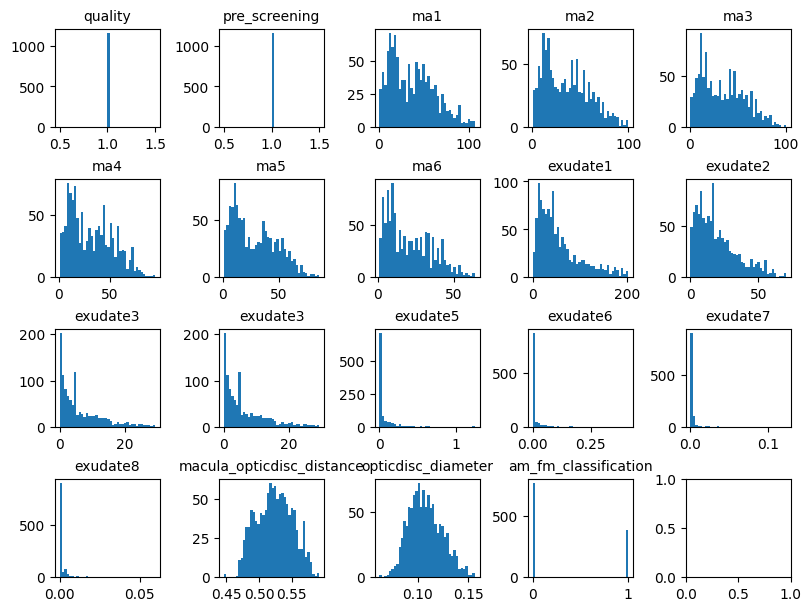

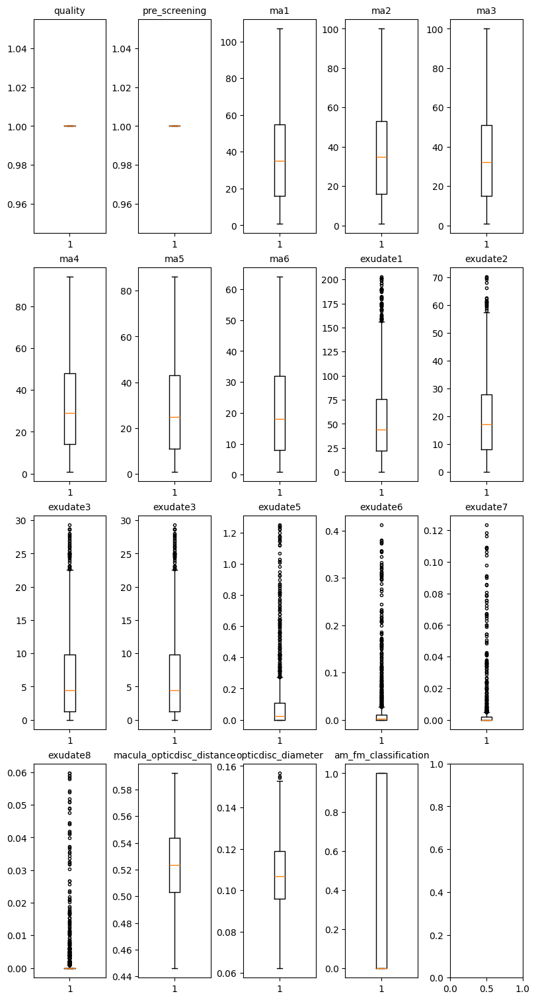

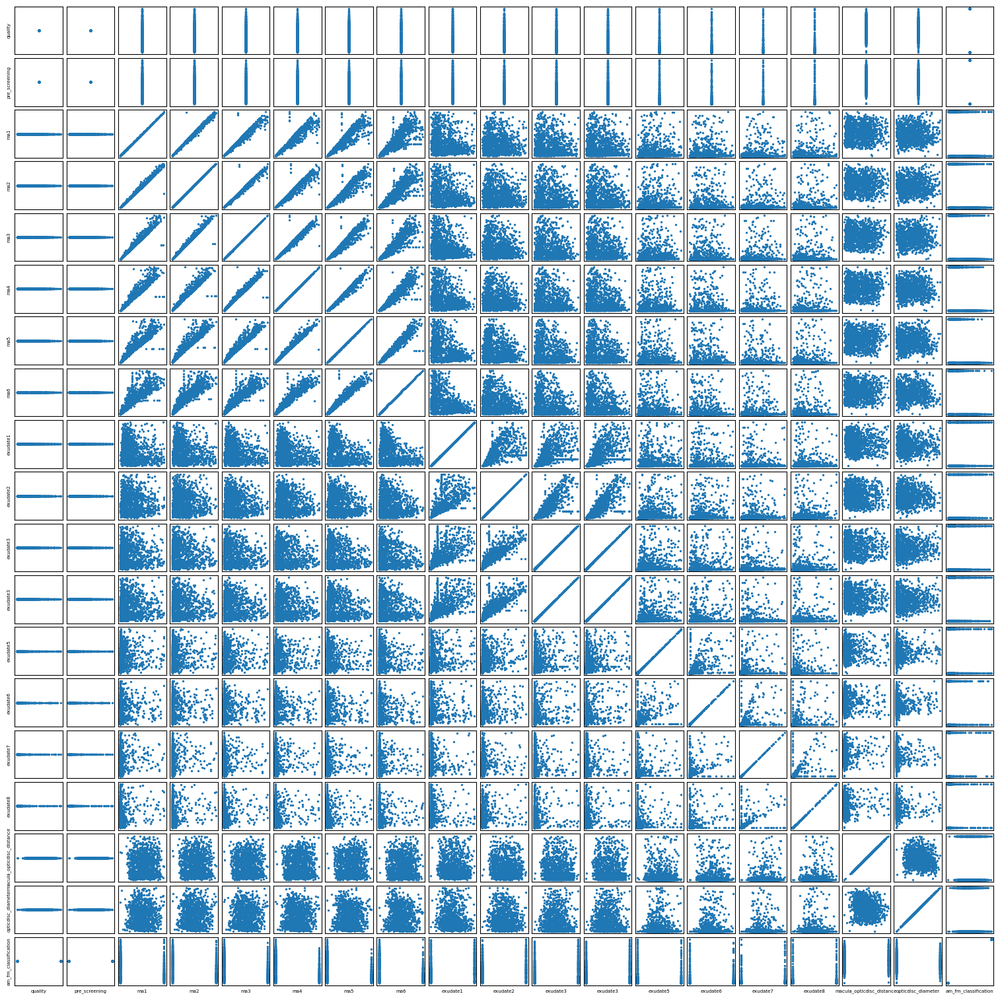

In [ ]:
fig, axs = plt.subplots(4, 5, figsize=(8, 6), layout='constrained')

for i in range(X.shape[1]):
    axs[int(i/5), int(i%5)].hist(X.iloc[:, i], bins = 40)
    axs[int(i/5), int(i%5)].set_title(X.iloc[:, i].name, fontsize = 10)
plt.show()

fig, axs = plt.subplots(4, 5, figsize=(8, 15), layout='constrained')
flierprops={'marker': 'o', 'markersize': 3}
for i in range(X.shape[1]):
    axs[int(i/5), int(i%5)].boxplot(X.iloc[:, i], flierprops = flierprops)
    axs[int(i/5), int(i%5)].set_title(X.iloc[:, i].name, fontsize = 10)
plt.show()

fig, axs = plt.subplots(19, 19, figsize=(15, 15), layout='constrained')
fig.get_layout_engine().set(w_pad=2 / 72, h_pad=2 / 72, hspace=0,
                            wspace=0)
for i in range(X.shape[1]):
  for j in range(X.shape[1]):
    axs[i,j].scatter(X.iloc[:, i], X.iloc[:, j], s = 2)
    axs[i,j].set_xticks([])
    axs[i,j].set_yticks([])
    if (i == X.shape[1]-1):
      axs[i, j].set_xlabel(X.iloc[:, j].name, fontsize = 5)
    if (j == 0):
      axs[i, j].set_ylabel(X.iloc[:, i].name, fontsize = 5)
    #axs[i,j].set_title(X.iloc[:, i].name + ", " + X.iloc[:, j].name, fontsize = 10)

plt.show()


In [ ]:
X = X.drop(['quality', 'pre_screening'], axis=1)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=1)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.33, random_state=1)

In [ ]:
X_train = torch.tensor(X_train.values, dtype=torch.float32)
y_train = torch.tensor(y_train.values, dtype=torch.float32)
X_val = torch.tensor(X_val.values, dtype=torch.float32)
y_val = torch.tensor(y_val.values, dtype=torch.float32)
X_test = torch.tensor(X_test.values, dtype=torch.float32)
y_test = torch.tensor(y_test.values, dtype=torch.float32)

In [ ]:
loss_graph = []
val_loss_graph = []
test_loss_graph = []
classification_error_graph = []
val_classification_error_graph = []
test_classification_error_graph = []

In [ ]:
class Deep(nn.Module):
    def __init__(self):
        super().__init__()
        self.layer1 = nn.Linear(16, 20)
        torch.nn.init.xavier_normal_(self.layer1.weight)
        self.act1 = nn.Sigmoid()
        self.layer2 = nn.Linear(20, 20)
        torch.nn.init.xavier_normal_(self.layer2.weight)
        self.act2 = nn.Sigmoid()
        self.output = nn.Linear(20, 1)
        torch.nn.init.xavier_normal_(self.output.weight)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.act1(self.layer1(x))
        x = self.act2(self.layer2(x))
        x = self.sigmoid(self.output(x))
        return x

In [ ]:

import copy
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import tqdm

def model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, batch_size = len(X_train), regularization_type=None, lambda_reg=0.01, noisy = False):
    weights1_dynamic = []
    weights2_dynamic = []
    weights3_dynamic = []
    for i in range (6):
                  weights1_dynamic.append([])
                  weights2_dynamic.append([])
                  weights3_dynamic.append([])
    loss_graph = []
    val_loss_graph = []
    test_loss_graph = []
    classification_error_graph = []
    val_classification_error_graph = []
    test_classification_error_graph = []
    l1 = []
    l2 = []
    #current_weights1 = []
    #current_weights2 = []
    #current_weights3 = []
    #max_weights1_dynamic = []
    #min_weights1_dynamic = []
    #avg_weights1_dynamic = []
    stop_criterion = 0

    # loss function and optimizer
    loss_fn = nn.BCELoss()  # binary cross entropy
    #optimizer = optim.Adam(model.parameters(), lr=lr)


    n_epochs = 10000   # number of epochs to run
    #batch_size = len(X_train)  # size of each batch
    batch_start = torch.arange(0, len(X_train), batch_size)

    # Hold the best model
    best_acc = - np.inf   # init to negative infinity
    best_weights = None

    for epoch in range(n_epochs):
        model.train()
        with tqdm.tqdm(batch_start, unit="batch", mininterval=0, disable=True) as bar:
            bar.set_description(f"Epoch {epoch}")
            for start in bar:
                # take a batch
                X_batch = X_train[start:start+batch_size]
                y_batch = y_train[start:start+batch_size]
                # forward pass
                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)
                loss_graph.append(loss.detach().numpy())
                l1_norm = sum(p.abs().sum() for p in model.parameters())
                l1.append(l1_norm.detach().numpy())
                l2_norm = sum(p.pow(2).sum() for p in model.parameters())
                l2.append(l2_norm.detach().numpy())
                    # Apply L1 regularization
                if regularization_type == 'L1':

                    loss += lambda_reg * l1_norm

                # Apply L2 regularization
                elif regularization_type == 'L2':

                    loss += lambda_reg * l2_norm
                # backward pass
                optimizer.zero_grad()
                loss.backward()
                if (noisy):
                    model.layer2.weight.grad = model.layer2.weight.grad + torch.randn_like(model.layer1.weight.grad)
                optimizer.step()
                # update weights
                optimizer.step()
                model.eval()

                y_pred = model(X_test)
                acc = (y_pred.round() == y_test).float().mean()
                test_loss = loss_fn(y_pred, y_test)
                test_loss_graph.append(test_loss.detach().numpy())
                test_classification_error_graph.append(float(acc))
                y_pred = model(X_val)
                acc = (y_pred.round() == y_val).float().mean()
                val_loss = loss_fn(y_pred, y_val)
                val_loss_graph.append(val_loss.detach().numpy())

                #print (stop_criterion)
                val_classification_error_graph.append(float(acc))
                # присоединение весов на данном этапе к массиву с изменением весов во времени
                #for i in range (6):
                 # if weights1_dynamic[i]:
                  #   weights1_dynamic[i][-1] = weights1_dynamic[i][-1] - model.layer1.weight.detach().numpy()[0][i]
                   #  weights2_dynamic[i][-1] = weights2_dynamic[i][-1] - model.layer2.weight.detach().numpy()[0][i]
                    # weights3_dynamic[i][-1] = weights3_dynamic[i][-1] - model.output.weight.detach().numpy()[0][i]
                 # weights1_dynamic[i].append(model.layer1.weight.detach().numpy()[0][i])
                  #weights2_dynamic[i].append(model.layer2.weight.detach().numpy()[0][i])
                  #weights3_dynamic[i].append(model.output.weight.detach().numpy()[0][i])

                # для максимальной, средней и минимальной скоростей
                #concat = (np.concatenate((np.ndarray.flatten(model.layer1.weight.detach().numpy()),
                       #                   np.ndarray.flatten(model.layer1.bias.detach().numpy()),
                        #                  np.ndarray.flatten(model.layer2.weight.detach().numpy()),
                         #                 np.ndarray.flatten(model.layer2.bias.detach().numpy()),
                          #                np.ndarray.flatten(model.output.weight.detach().numpy()),
                           #               np.ndarray.flatten(model.output.bias.detach().numpy())), axis = 0))
                #if epoch > 0:
                 # max = model.layer1.weight.detach().numpy()[0][0] - current_weights1[0]
                 # min = max
                 # sum = 0
                 # for i in range (len(concat)):
                 #   if concat[i]-current_weights1[i] > max:
                #      max = concat[i]-current_weights1[i]
               #     if concat[i]-current_weights1[i] < min:
                   #   min = concat[i]-current_weights1[i]
                   # sum = sum + concat[i]-current_weights1[i]
                  #max_weights1_dynamic.append(max)
                  #min_weights1_dynamic.append(min)
                  #avg_weights1_dynamic.append(sum/len(concat))
                  #print (current_weights1)
                  #print (model.layer1.weight.detach().numpy())


                #current_weights1 = concat
                # print progress
                if len(val_loss_graph)>1:
                  if val_loss_graph[-1] > val_loss_graph[-2]:
                    stop_criterion += 1
                  if stop_criterion >= 10:
                    break
                #acc = (y_pred.round() == y_batch).float().mean()
                #classification_error_graph.append(float(acc))
                bar.set_postfix(
                    loss=float(loss),
                    acc=float(acc)
                )
        # evaluate accuracy at end of each epoch

        acc = float(acc)
        if epoch % 100 == 0:
          print (epoch)
        if stop_criterion >= 10:
                    break
        if acc > best_acc:
            best_acc = acc
            best_weights = copy.deepcopy(model.state_dict())


    #for i in range (6):
    #              if weights1_dynamic[i]:
    #                 weights1_dynamic[i].pop()
    #                 weights2_dynamic[i].pop()
    #                 weights3_dynamic[i].pop()
    # restore model and return best accuracy
    plt.plot(loss_graph, 'g', label='Training data loss', linewidth=0.8)
    plt.plot(val_loss_graph, 'b', label='Validation data loss', linewidth=0.8)
    plt.plot(test_loss_graph, 'r', label='Test data loss', linewidth=0.8)
    plt.legend()
    plt.show()
    #plt.plot(classification_error_graph, 'g', label='Training accuracy', linewidth=0.8)
    #plt.plot(val_classification_error_graph, 'b', label='Validation accuracy', linewidth=0.8)
    #plt.plot(test_classification_error_graph, 'r', label='Test accuracy', linewidth=0.8)
    #plt.legend()
    #plt.show()

    #print (weights1_dynamic)
    #fig, axs = plt.subplots(2, 2, figsize=(10, 8), layout='constrained')
    #for i in range (6):
    #              axs[0,0].plot(weights1_dynamic[i])
    #axs[0,0].set_title("Скорость обучения слоя 1")
    #for i in range (6):
    #              axs[0,1].plot(weights2_dynamic[i])
    #axs[0,1].set_title("Скорость обучения слоя 2")
    #for i in range (6):
    #              axs[1,0].plot(weights3_dynamic[i])
    #axs[1,0].set_title("Скорость обучения output")

    #axs[1,1].plot(max_weights1_dynamic, 'g', label='Максимальная скорость обучения')
    #axs[1,1].plot(min_weights1_dynamic, 'b', label='Минимальная скорость обучения')
    #axs[1,1].plot(avg_weights1_dynamic, 'r', label='Средняя скорость обучения')
    #axs[1,1].legend()
    #plt.rcParams['font.size'] = '10'
    #plt.show()

    model.load_state_dict(best_weights)
    plt.plot(l1, 'g', label='L1 norm', linewidth=0.8)
    plt.plot(l2, 'b', label='L2 norm', linewidth=0.8)
    plt.legend()
    plt.show()

    y_pred = model(X_test)
    acc = (y_pred.round() == y_test).float().mean()
    test_loss = loss_fn(y_pred, y_test).detach().item()

    y_pred = model(X_train)
    train_loss = loss_fn(y_pred, y_train).detach().item()

    return train_loss, test_loss, epoch, l1[-1], l2[-1]

In [ ]:
model_initial = Deep()

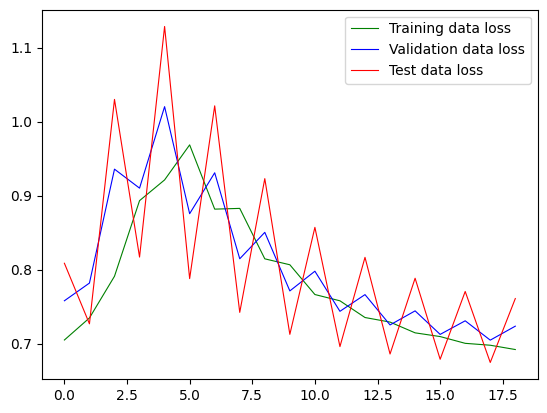

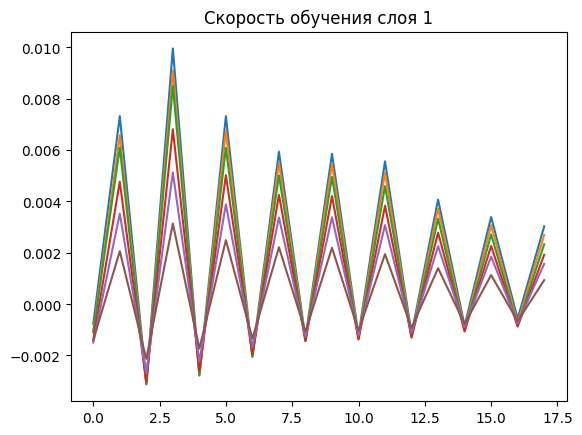

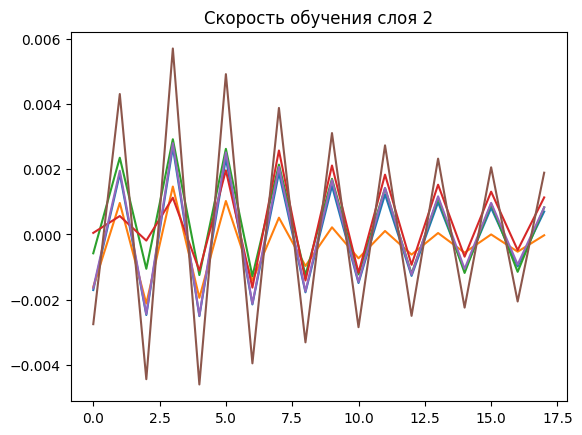

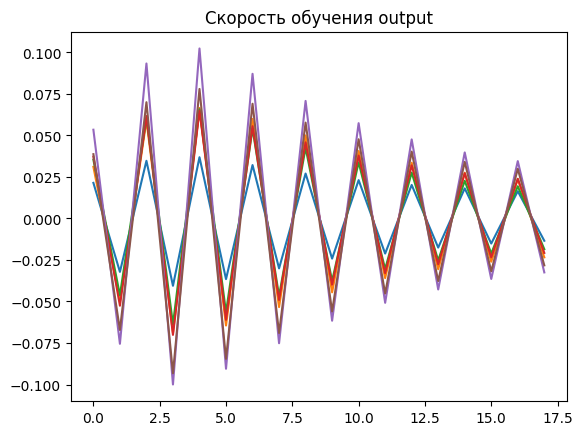

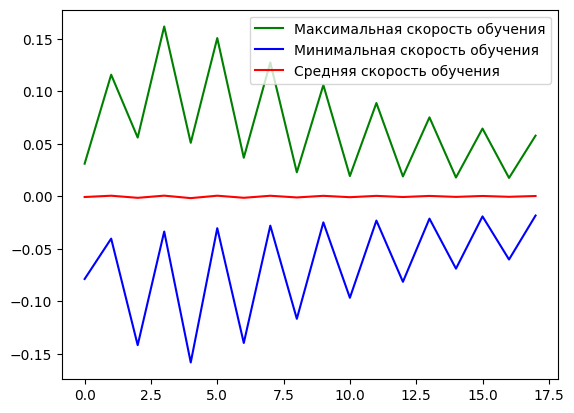

(0.6919170022010803, 0.6744251251220703, 18)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.5)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

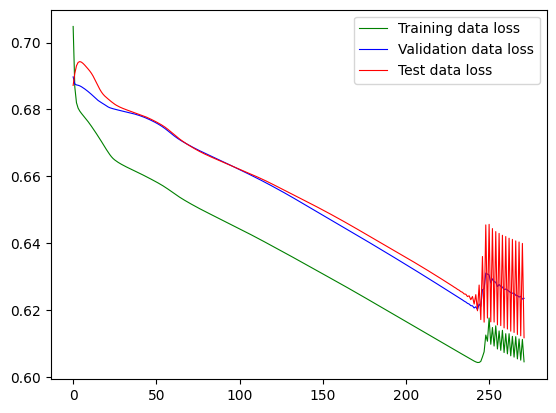

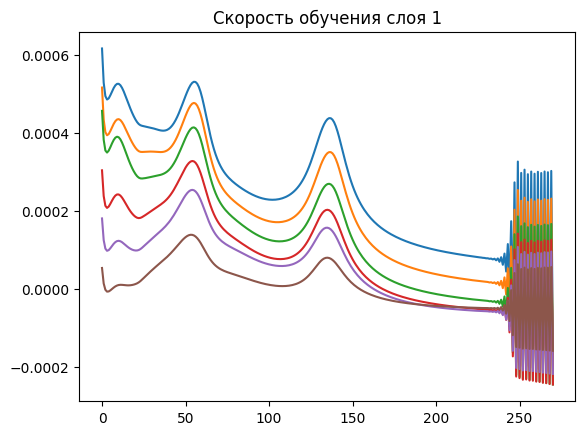

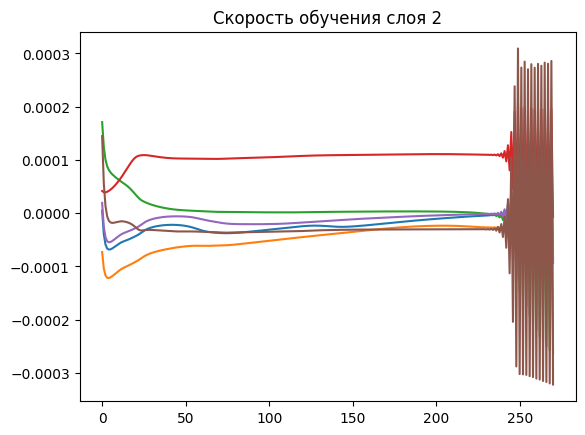

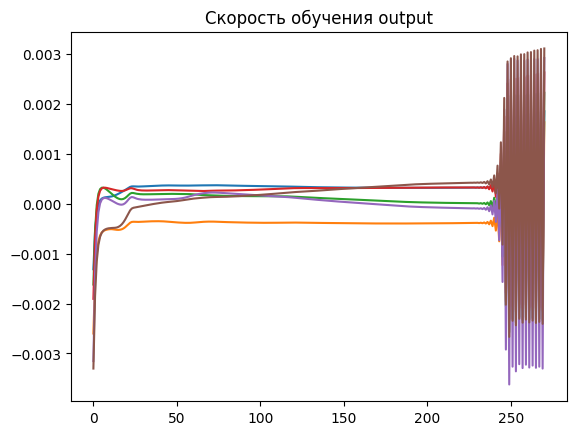

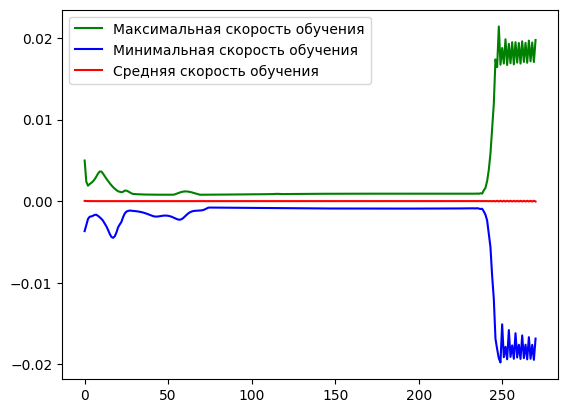

(0.6176960468292236, 0.6176789999008179, 271)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.1)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

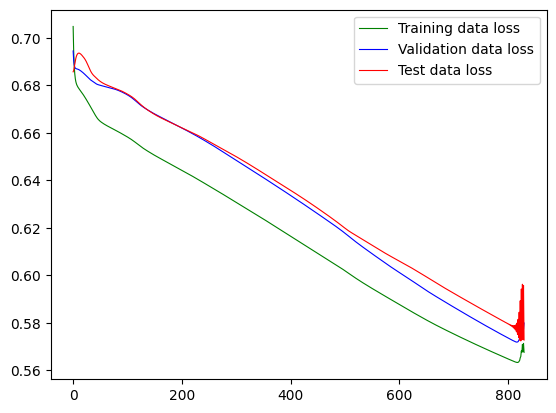

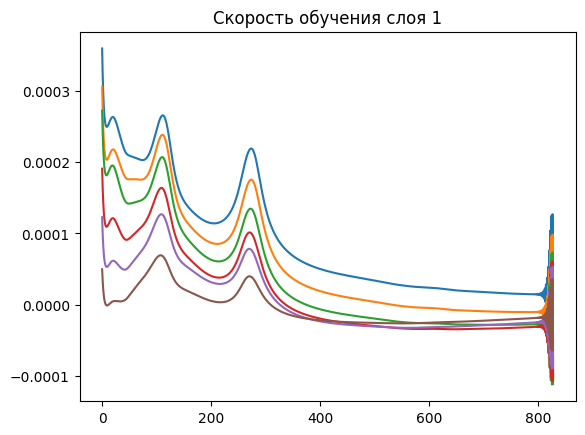

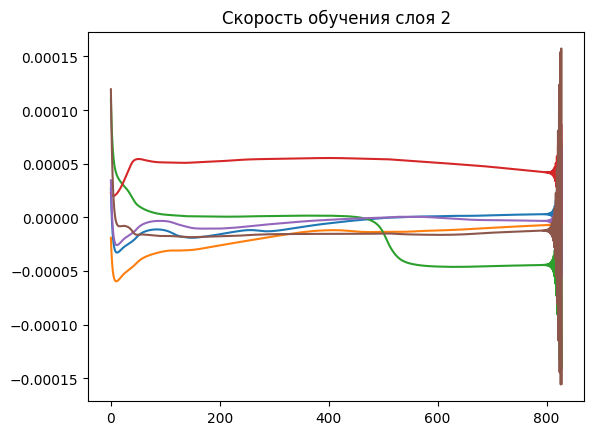

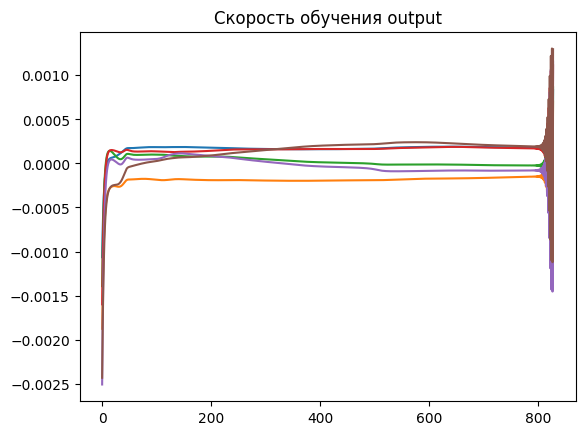

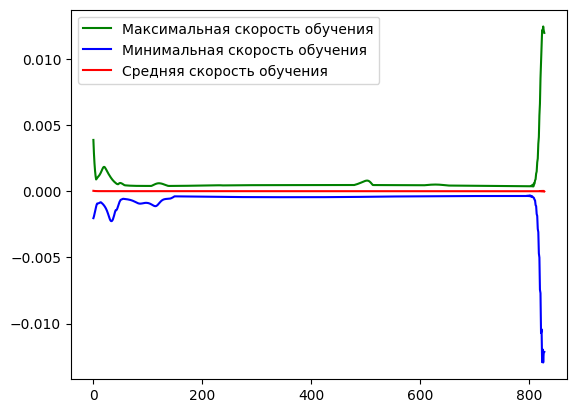

(0.5634911060333252, 0.5770513415336609, 829)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.05)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

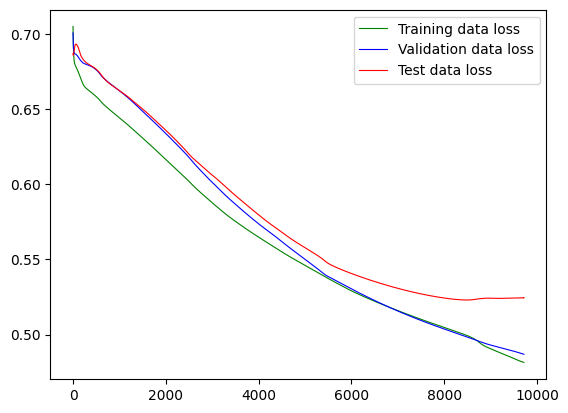

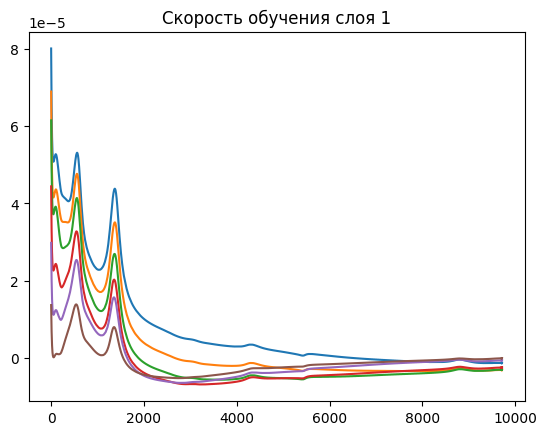

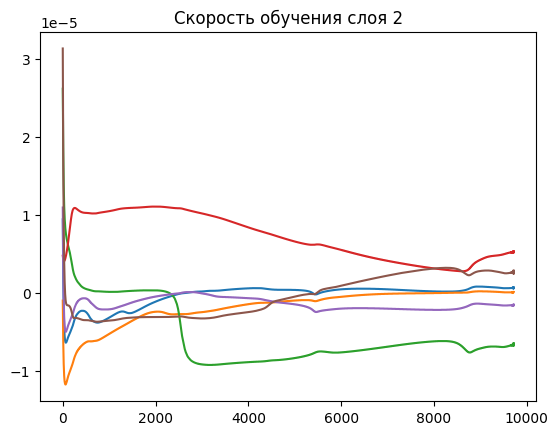

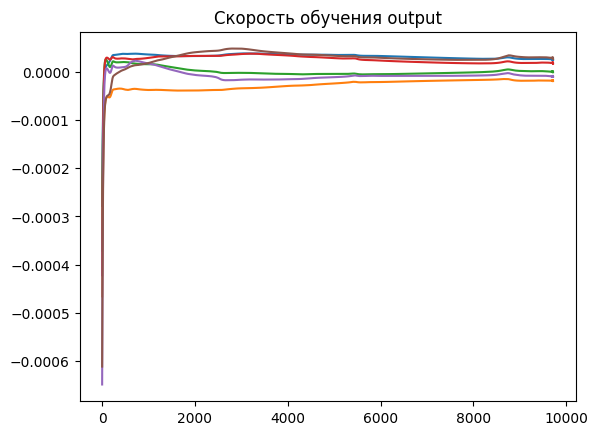

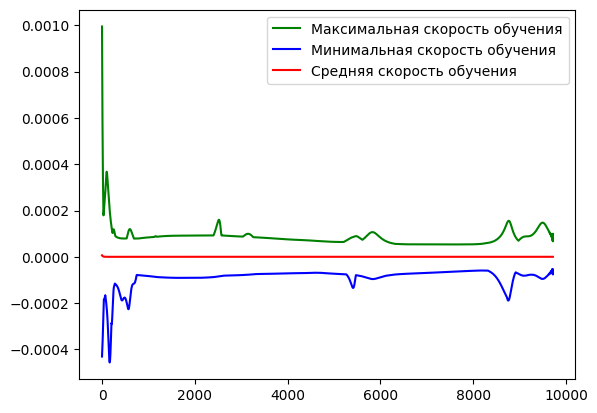

(0.48214638233184814, 0.5243867039680481, 9719)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

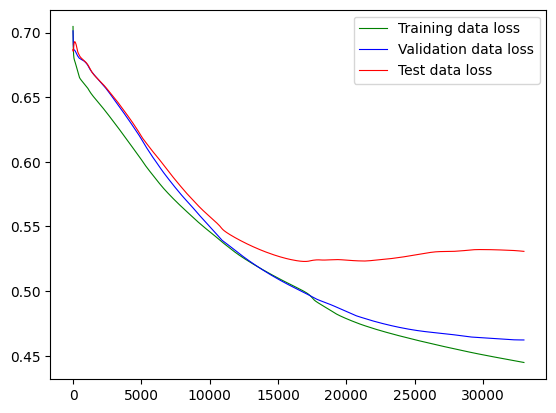

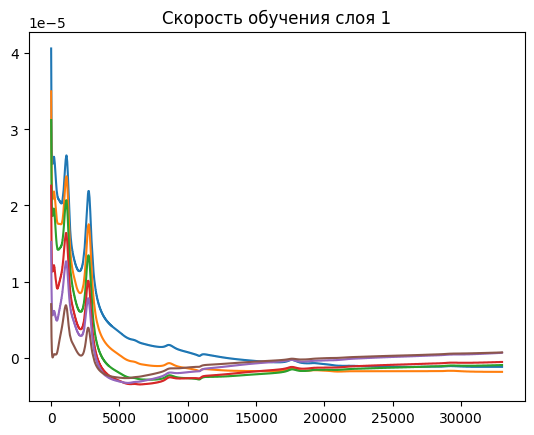

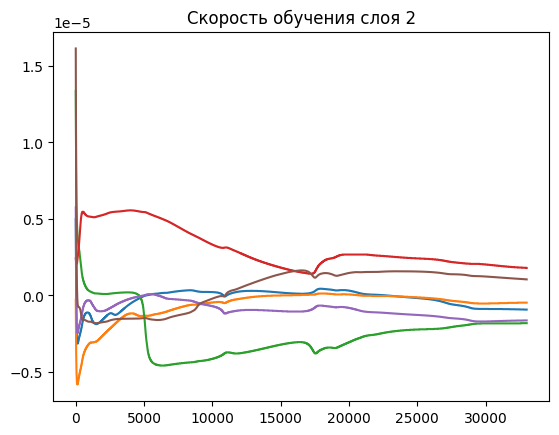

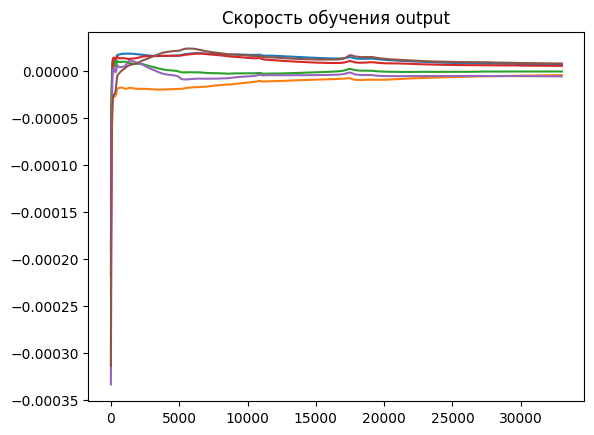

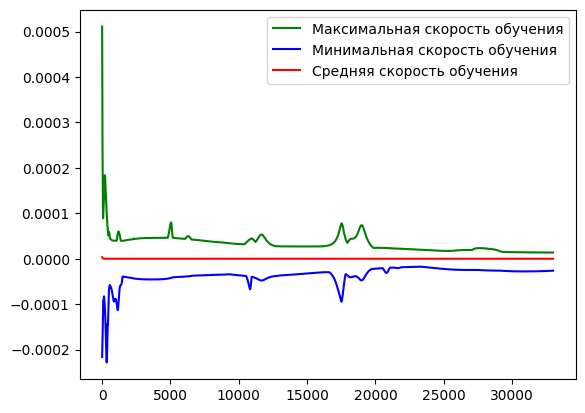

(0.463083952665329, 0.5274113416671753, 33001)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.005)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

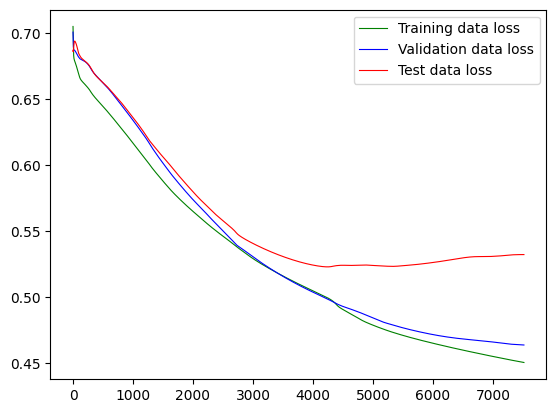

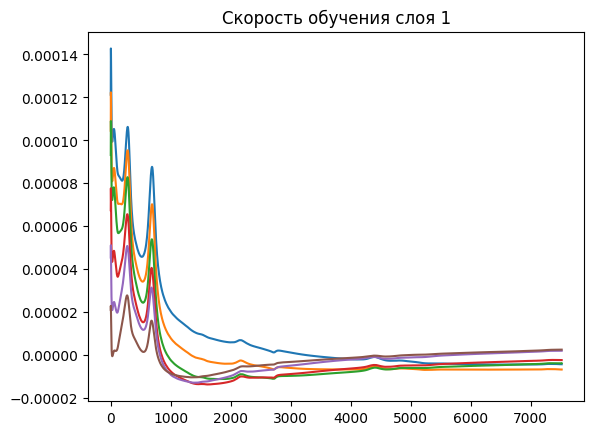

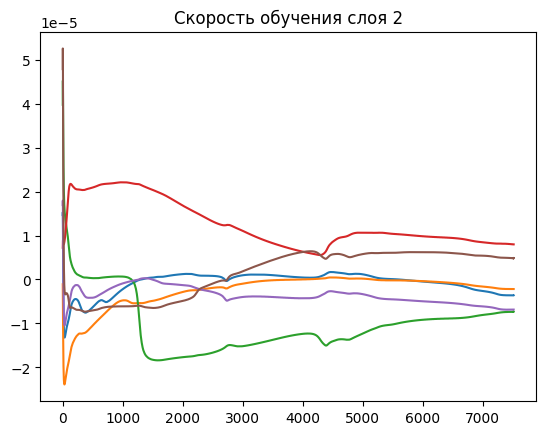

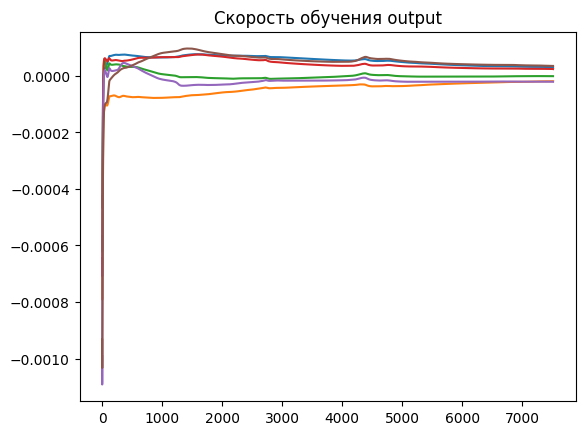

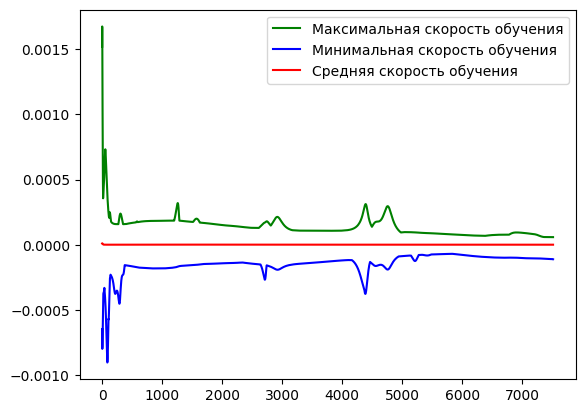

(0.46302613615989685, 0.5275137424468994, 7517)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.5, nesterov = False)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

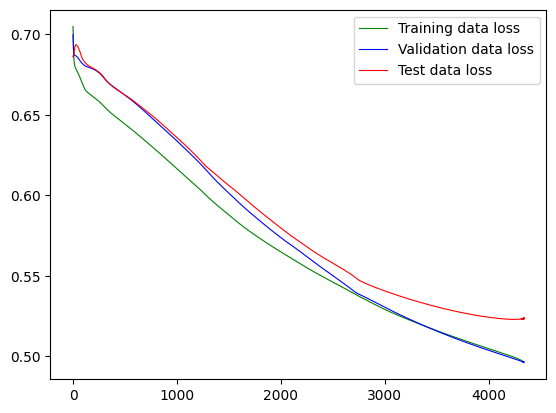

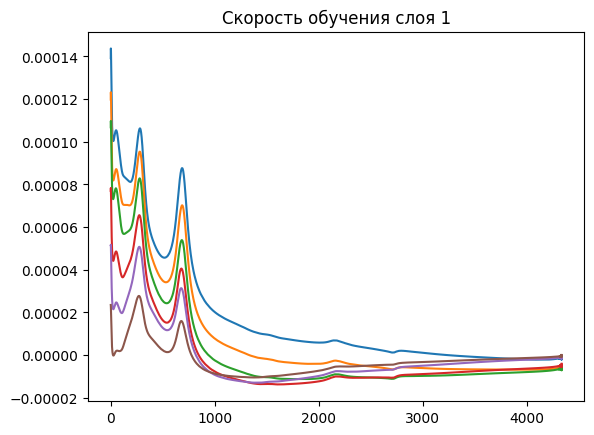

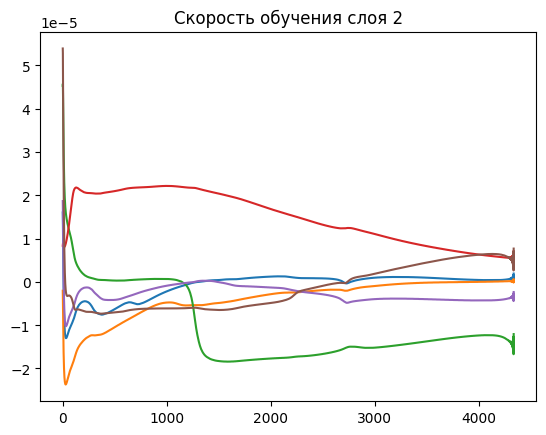

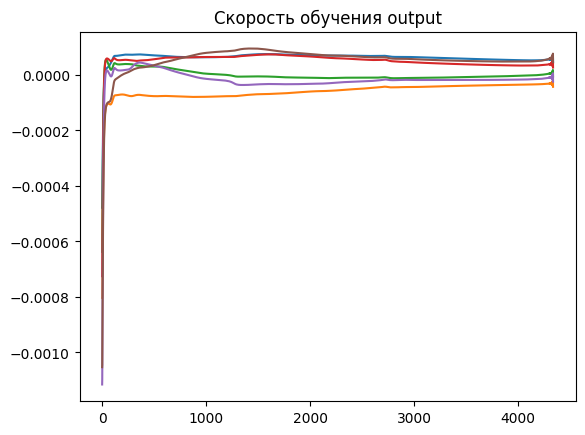

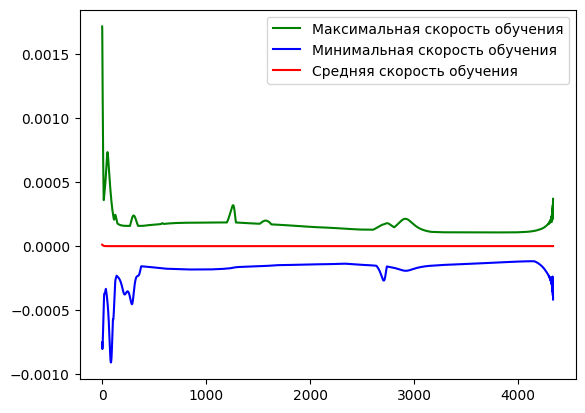

(0.4998597502708435, 0.5229347348213196, 4339)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.5, nesterov = True)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

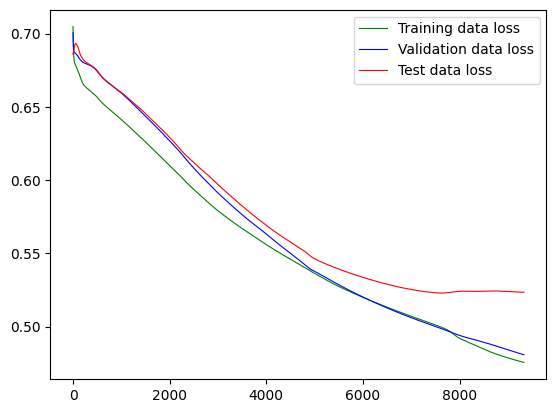

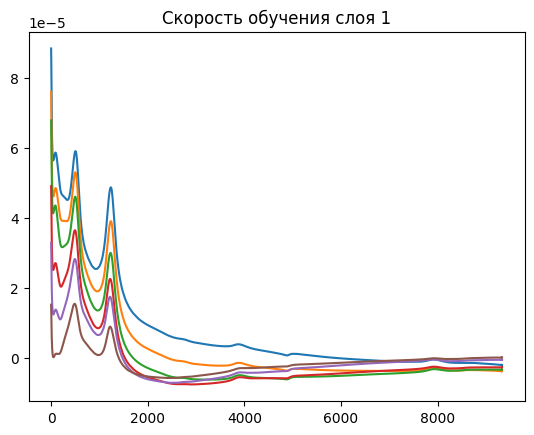

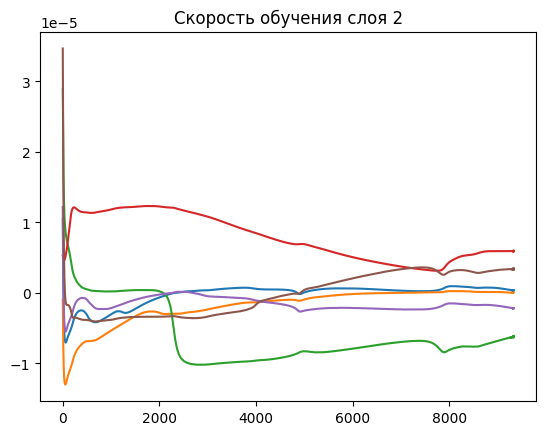

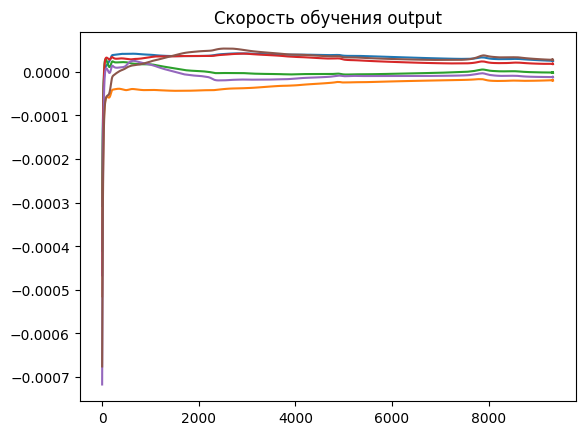

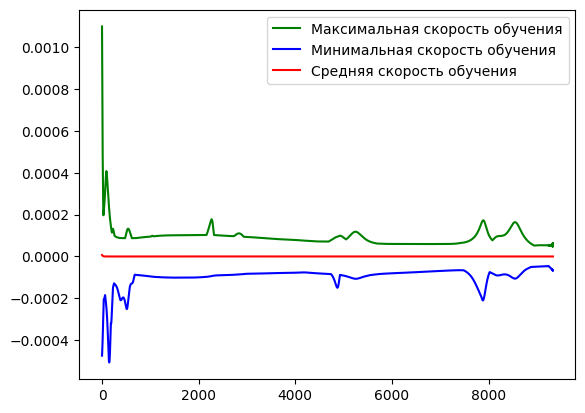

(0.4821416139602661, 0.5243855118751526, 9333)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.1, nesterov = False)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

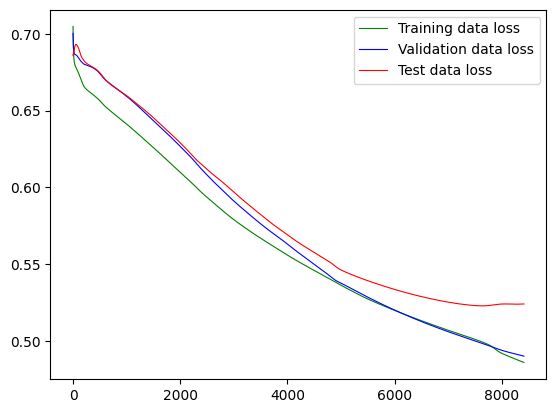

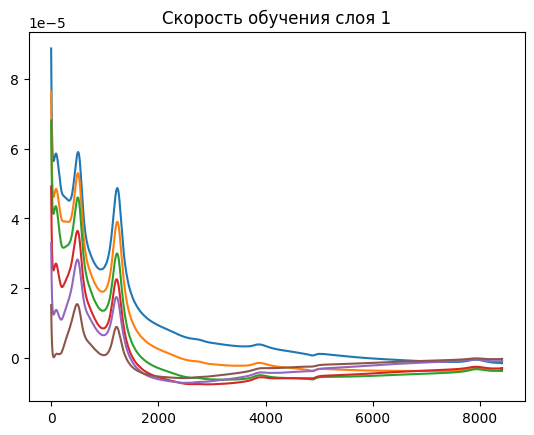

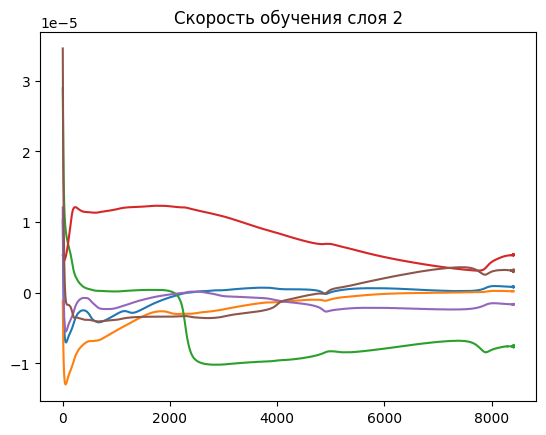

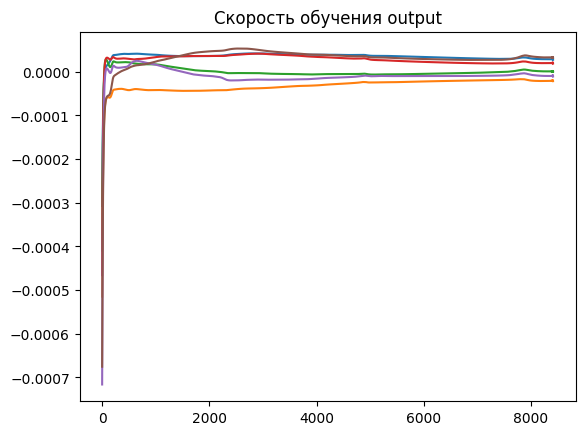

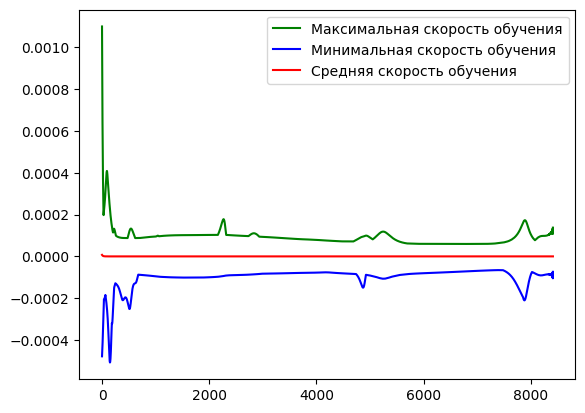

(0.4951516389846802, 0.523719847202301, 8414)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.1, nesterov = True)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

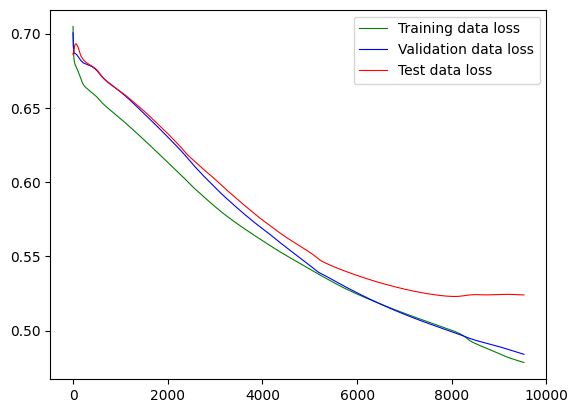

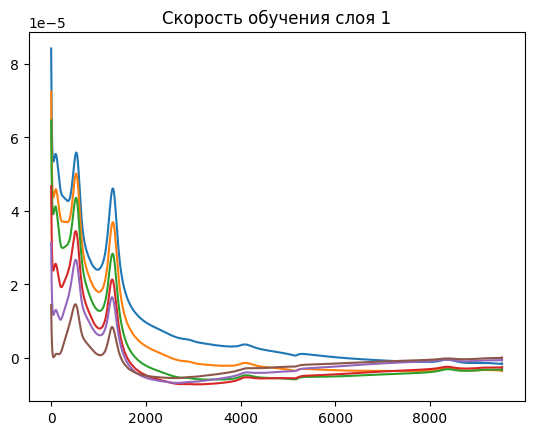

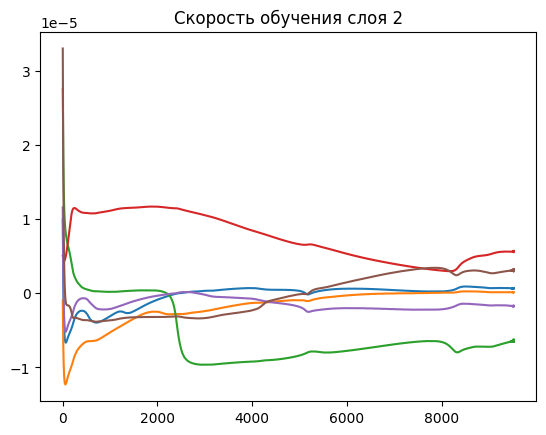

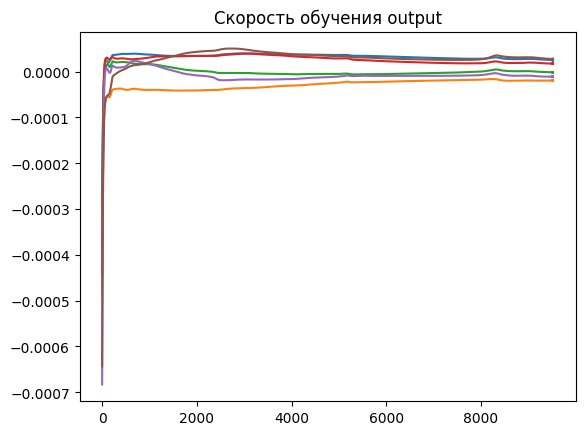

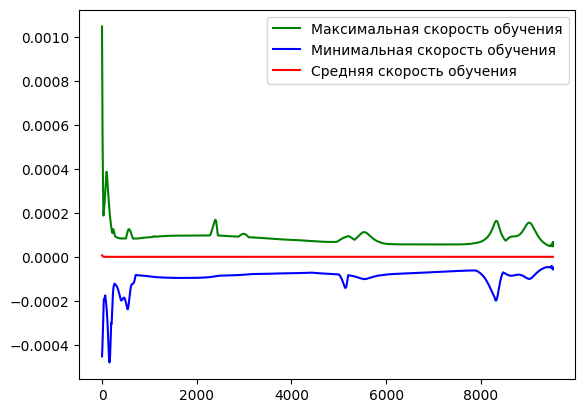

(0.48214399814605713, 0.5243865847587585, 9524)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.05, nesterov = False)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

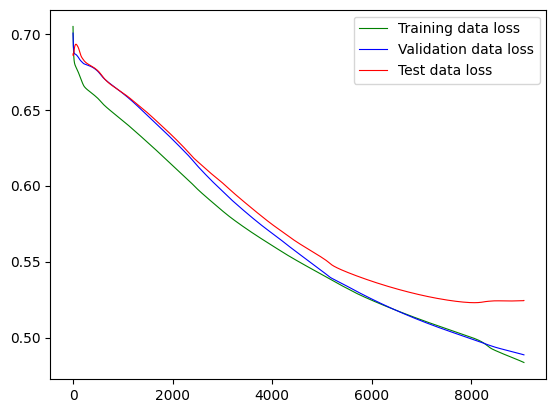

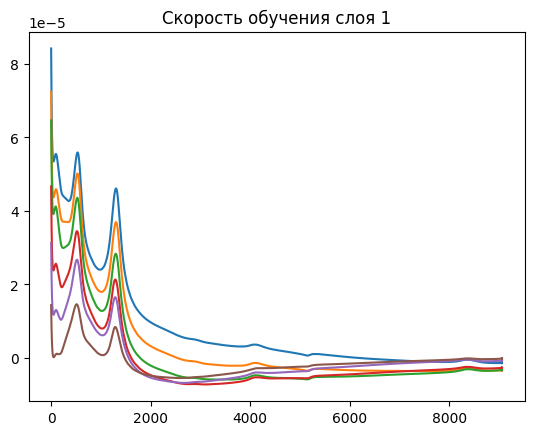

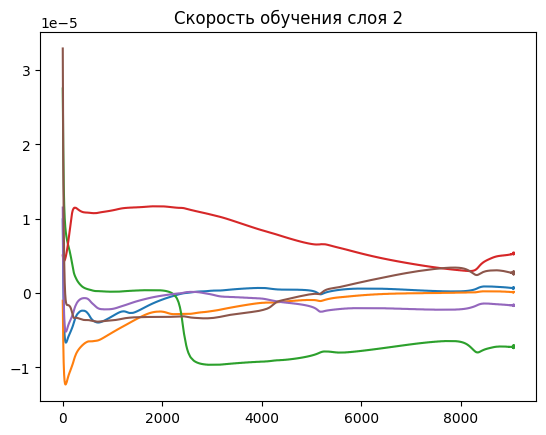

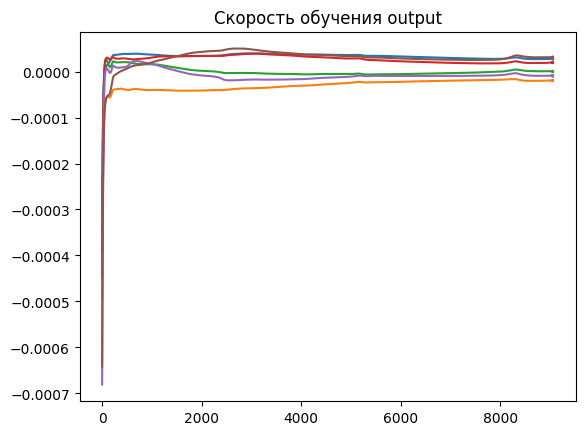

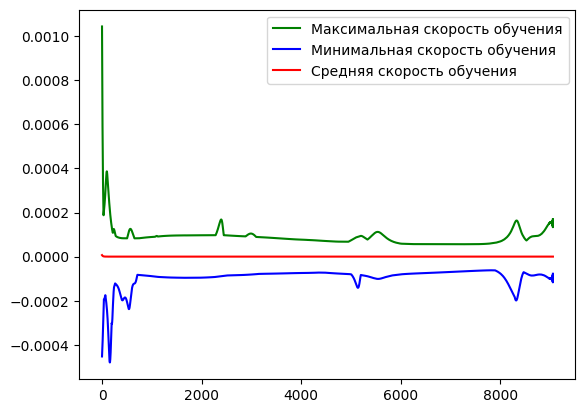

(0.4951733648777008, 0.5237150192260742, 9059)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.05, nesterov = True)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

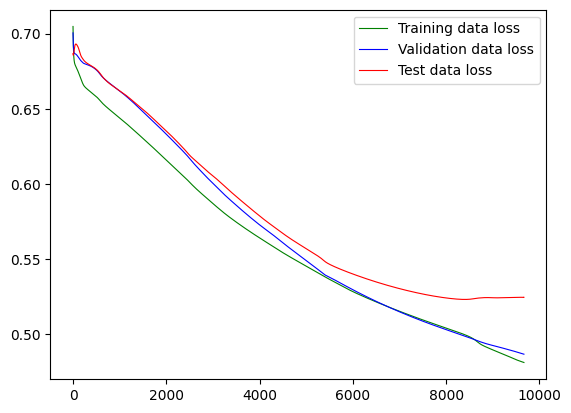

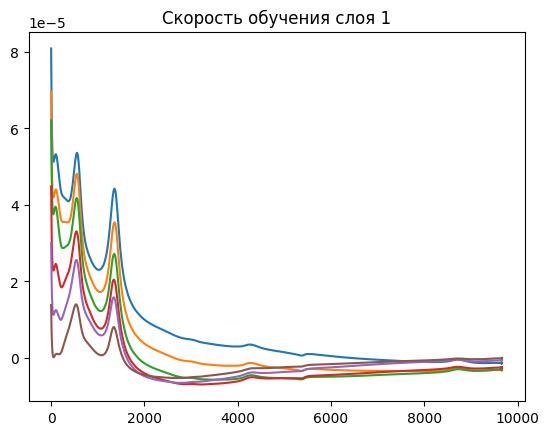

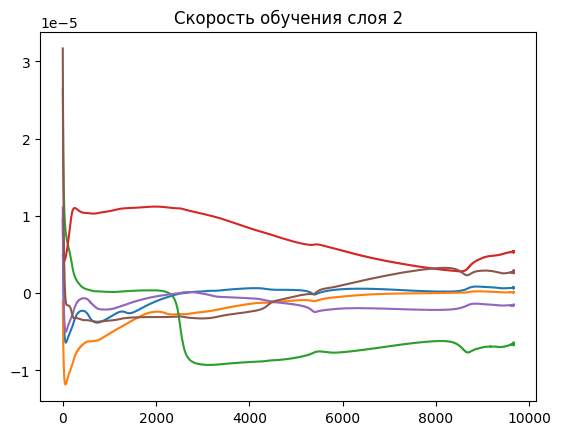

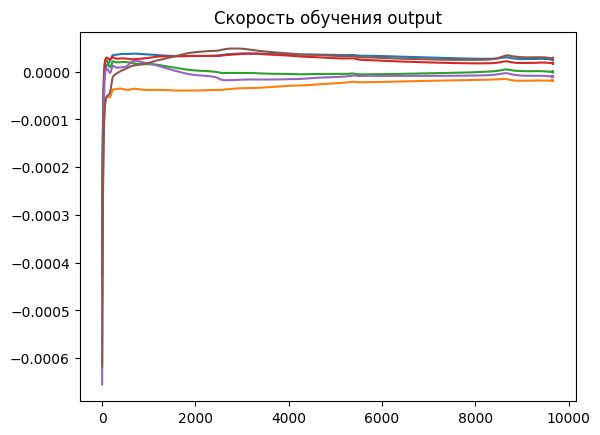

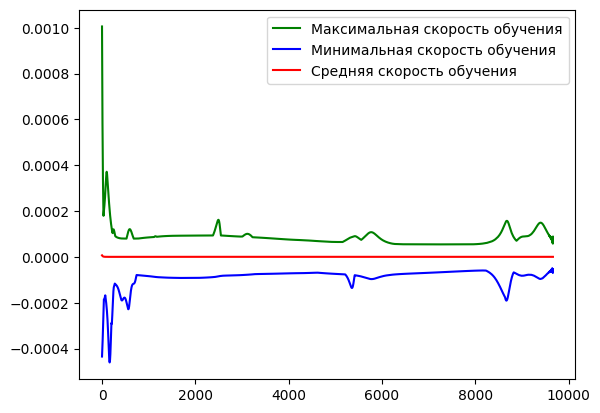

(0.4821528196334839, 0.5243875980377197, 9667)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.01, nesterov = False)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

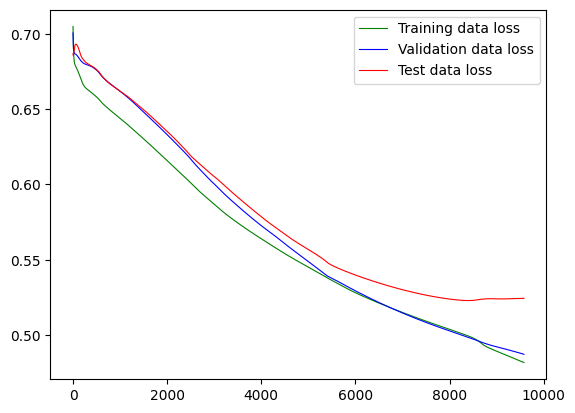

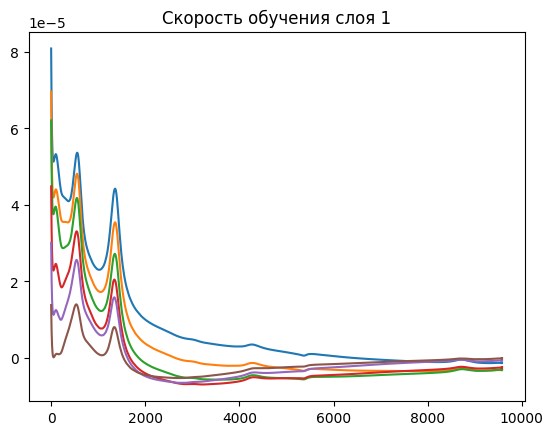

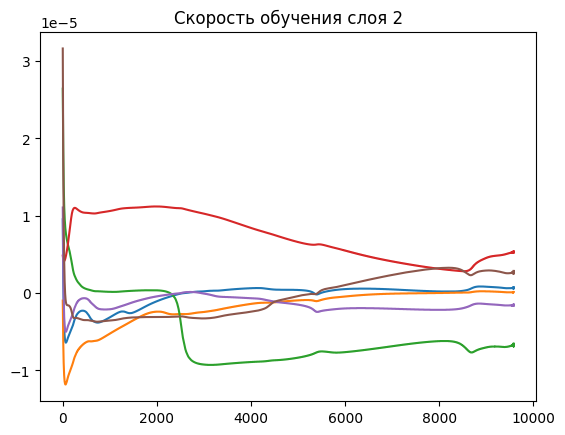

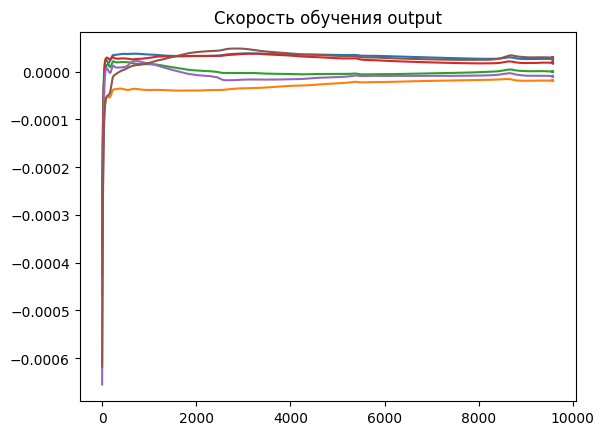

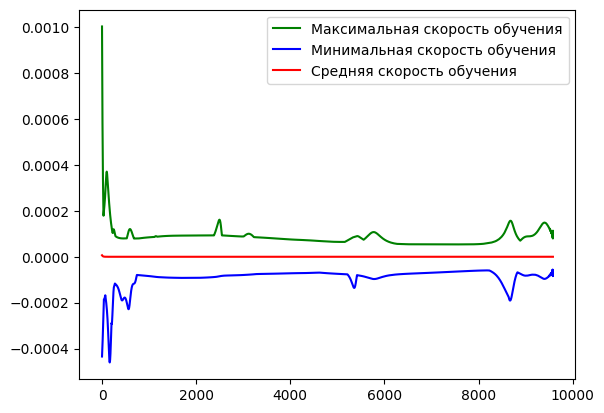

(0.4821636974811554, 0.5243939161300659, 9580)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.01, nesterov = True)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

In [ ]:

import copy
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import tqdm

def model_train_basic(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, closure):
    weights1_dynamic = []
    weights2_dynamic = []
    weights3_dynamic = []
    for i in range (6):
                  weights1_dynamic.append([])
                  weights2_dynamic.append([])
                  weights3_dynamic.append([])
    loss_graph = []
    val_loss_graph = []
    test_loss_graph = []
    classification_error_graph = []
    val_classification_error_graph = []
    test_classification_error_graph = []
    current_weights1 = []
    current_weights2 = []
    current_weights3 = []
    max_weights1_dynamic = []
    min_weights1_dynamic = []
    avg_weights1_dynamic = []
    stop_criterion = 0

    # loss function and optimizer
    loss_fn = nn.BCELoss()  # binary cross entropy
    #optimizer = optim.Adam(model.parameters(), lr=lr)


    n_epochs = 10000   # number of epochs to run
    batch_size = len(X_train)  # size of each batch
    batch_start = torch.arange(0, len(X_train), batch_size)

    # Hold the best model
    best_acc = - np.inf   # init to negative infinity
    best_weights = None

    for epoch in range(n_epochs):
        model.train()
        with tqdm.tqdm(batch_start, unit="batch", mininterval=0, disable=True) as bar:
            bar.set_description(f"Epoch {epoch}")
            for start in bar:
                # take a batch
                X_batch = X_train[start:start+batch_size]
                y_batch = y_train[start:start+batch_size]
                # forward pass
                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)
                loss_graph.append(loss.detach().numpy())
                # backward pass
                optimizer.zero_grad()
                loss.backward()
                # update weights
                optimizer.step(closure)
                # присоединение весов на данном этапе к массиву с изменением весов во времени
                for i in range (6):
                  if weights1_dynamic[i]:
                     weights1_dynamic[i][-1] = weights1_dynamic[i][-1] - model.layer1.weight.detach().numpy()[0][i]
                     weights2_dynamic[i][-1] = weights2_dynamic[i][-1] - model.layer2.weight.detach().numpy()[0][i]
                     weights3_dynamic[i][-1] = weights3_dynamic[i][-1] - model.output.weight.detach().numpy()[0][i]
                  weights1_dynamic[i].append(model.layer1.weight.detach().numpy()[0][i])
                  weights2_dynamic[i].append(model.layer2.weight.detach().numpy()[0][i])
                  weights3_dynamic[i].append(model.output.weight.detach().numpy()[0][i])

                # для максимальной, средней и минимальной скоростей
                concat = (np.concatenate((np.ndarray.flatten(model.layer1.weight.detach().numpy()),
                                          np.ndarray.flatten(model.layer1.bias.detach().numpy()),
                                          np.ndarray.flatten(model.layer2.weight.detach().numpy()),
                                          np.ndarray.flatten(model.layer2.bias.detach().numpy()),
                                          np.ndarray.flatten(model.output.weight.detach().numpy()),
                                          np.ndarray.flatten(model.output.bias.detach().numpy())), axis = 0))
                if epoch > 0:
                  max = model.layer1.weight.detach().numpy()[0][0] - current_weights1[0]
                  min = max
                  sum = 0
                  for i in range (len(concat)):
                    if concat[i]-current_weights1[i] > max:
                      max = concat[i]-current_weights1[i]
                    if concat[i]-current_weights1[i] < min:
                      min = concat[i]-current_weights1[i]
                    sum = sum + concat[i]-current_weights1[i]
                  max_weights1_dynamic.append(max)
                  min_weights1_dynamic.append(min)
                  avg_weights1_dynamic.append(sum/len(concat))
                  #print (current_weights1)
                  #print (model.layer1.weight.detach().numpy())


                current_weights1 = concat
                # print progress
                #acc = (y_pred.round() == y_batch).float().mean()
                #classification_error_graph.append(float(acc))
                #bar.set_postfix(
                #    loss=float(loss),
                #    acc=float(acc)
                #)
        # evaluate accuracy at end of each epoch
        model.eval()
        y_pred = model(X_test)
        acc = (y_pred.round() == y_test).float().mean()
        test_loss = loss_fn(y_pred, y_test)
        test_loss_graph.append(test_loss.detach().numpy())
        test_classification_error_graph.append(float(acc))
        y_pred = model(X_val)
        acc = (y_pred.round() == y_val).float().mean()
        val_loss = loss_fn(y_pred, y_val)
        val_loss_graph.append(val_loss.detach().numpy())
        if len(val_loss_graph)>1:
          if val_loss_graph[-1] > val_loss_graph[-2]:
            stop_criterion += 1
          if stop_criterion >= 10:
            break

        val_classification_error_graph.append(float(acc))
        acc = float(acc)
        if acc > best_acc:
            best_acc = acc
            best_weights = copy.deepcopy(model.state_dict())


    for i in range (6):
                  if weights1_dynamic[i]:
                     weights1_dynamic[i].pop()
                     weights2_dynamic[i].pop()
                     weights3_dynamic[i].pop()
    # restore model and return best accuracy
    plt.plot(loss_graph, 'g', label='Training data loss', linewidth=0.8)
    plt.plot(val_loss_graph, 'b', label='Validation data loss', linewidth=0.8)
    plt.plot(test_loss_graph, 'r', label='Test data loss', linewidth=0.8)
    plt.legend()
    plt.show()
    #plt.plot(classification_error_graph, 'g', label='Training accuracy', linewidth=0.8)
    #plt.plot(val_classification_error_graph, 'b', label='Validation accuracy', linewidth=0.8)
    #plt.plot(test_classification_error_graph, 'r', label='Test accuracy', linewidth=0.8)
    #plt.legend()
    #plt.show()
    #print (weights1_dynamic)
    for i in range (6):
                  plt.plot(weights1_dynamic[i])
    plt.title("Скорость обучения слоя 1")
    plt.show()
    for i in range (6):
                  plt.plot(weights2_dynamic[i])
    plt.title("Скорость обучения слоя 2")
    plt.show()
    for i in range (6):
                  plt.plot(weights3_dynamic[i])
    plt.title("Скорость обучения output")
    plt.show()

    plt.plot(max_weights1_dynamic, 'g', label='Максимальная скорость обучения')
    plt.plot(min_weights1_dynamic, 'b', label='Минимальная скорость обучения')
    plt.plot(avg_weights1_dynamic, 'r', label='Средняя скорость обучения')
    plt.legend()
    plt.show()

    model.load_state_dict(best_weights)

    y_pred = model(X_test)
    acc = (y_pred.round() == y_test).float().mean()
    test_loss = loss_fn(y_pred, y_test).detach().item()

    y_pred = model(X_train)
    train_loss = loss_fn(y_pred, y_train).detach().item()

    return train_loss, test_loss, epoch

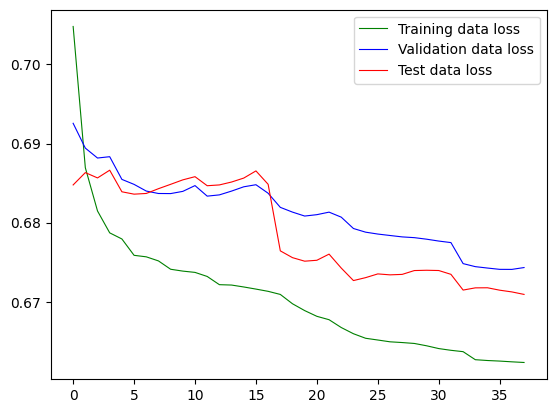

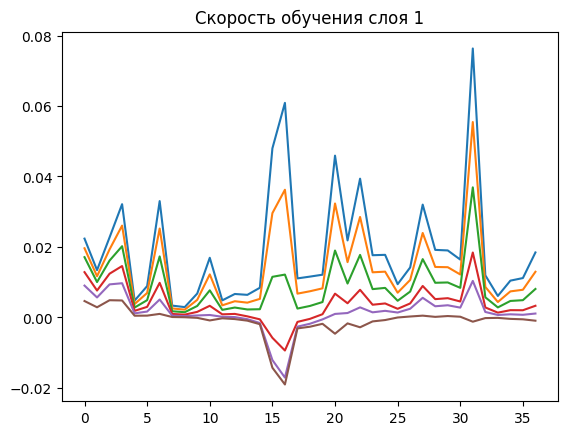

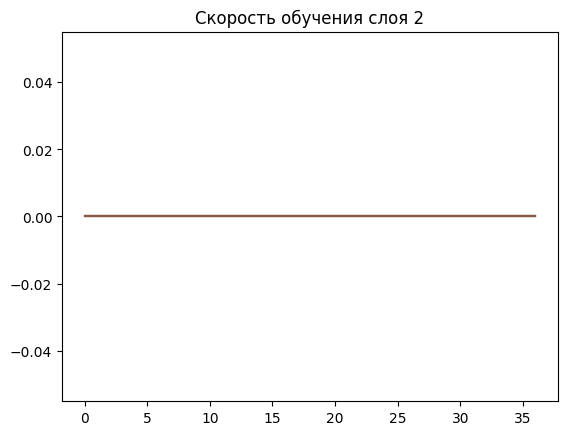

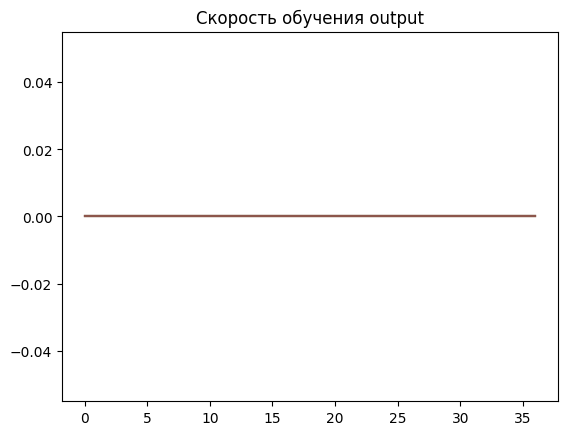

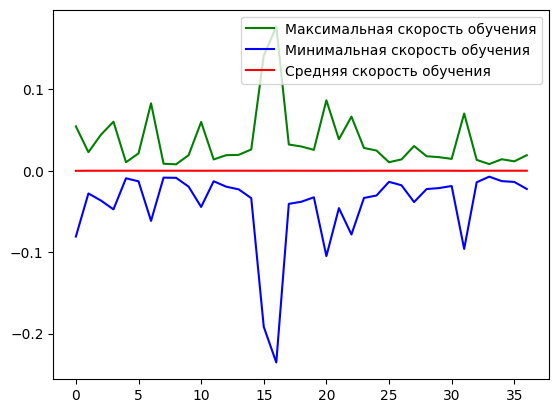

(0.6718677282333374, 0.6851335763931274, 37)

In [ ]:
import ncg_optimizer as ncg_optim
#Fletcher-Reeves Method
model = copy.deepcopy(model_initial)
loss_fn = nn.BCELoss()
optimizer = ncg_optim.BASIC(
    model.parameters(), method = 'FR',
    line_search = 'Strong_Wolfe', c1 = 1e-4,
    c2 = 0.5, lr = 0.01, max_ls = 25)
def closure():
    optimizer.zero_grad()
    loss_fn(model(X_train), y_train).backward()
    loss = loss_fn(model(X_train), y_train)
    return loss
train_loss, test_loss, epoch = model_train_basic(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, closure)
train_loss, test_loss, epoch

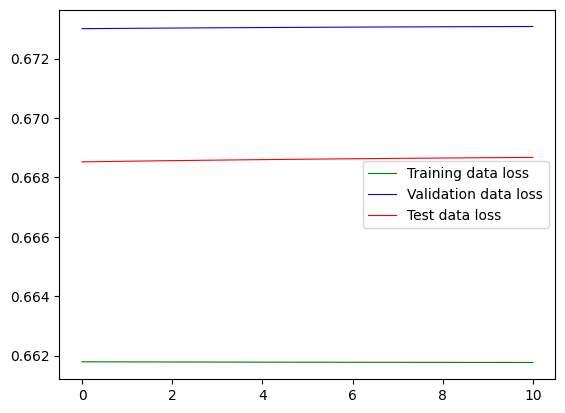

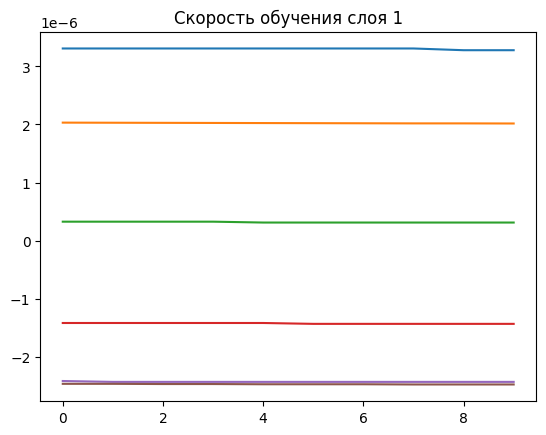

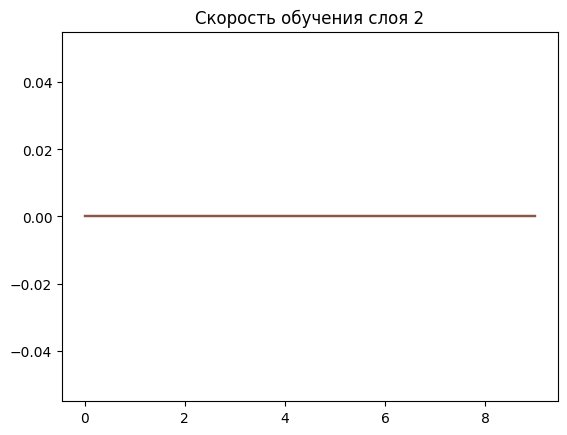

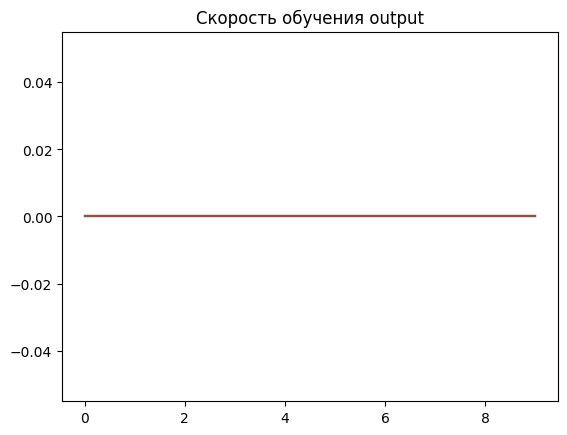

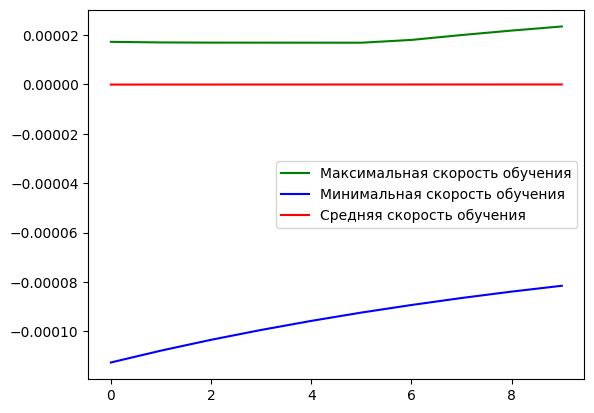

(0.661786675453186, 0.6685235500335693, 10)

In [ ]:
#Polak-Ribiere-Polyak Method
optimizer = ncg_optim.BASIC(
    model.parameters(), method = 'PRP',
    line_search = 'Armijo', c1 = 1e-4,
    c2 = 0.9, lr = 0.01, rho = 0.5,)
def closure():
    optimizer.zero_grad()
    loss_fn(model(X_train), y_train).backward()
    loss = loss_fn(model(X_train), y_train)
    return loss
train_loss, test_loss, epoch = model_train_basic(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, closure)
train_loss, test_loss, epoch

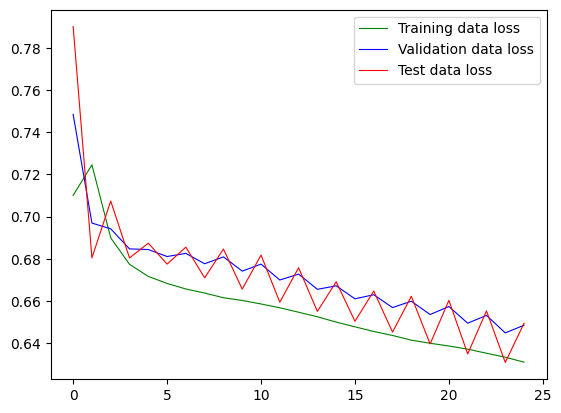

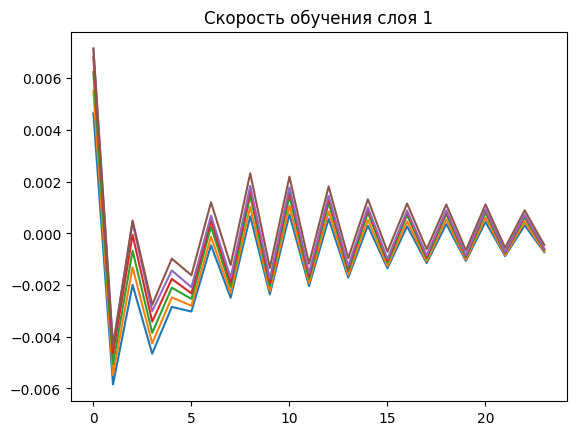

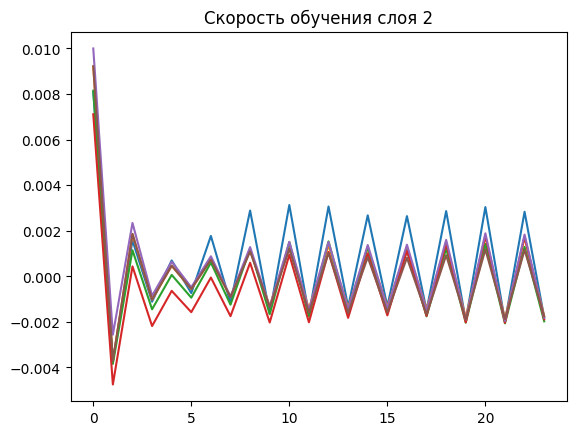

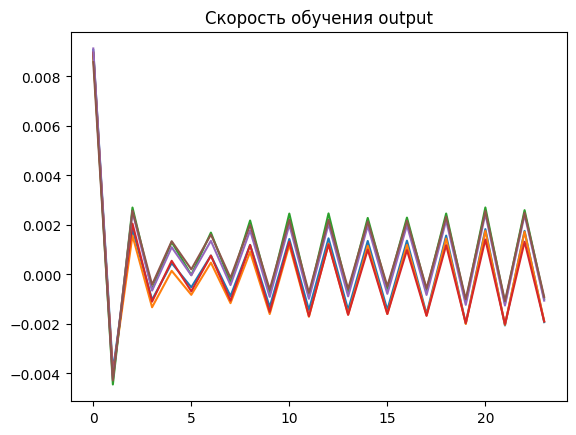

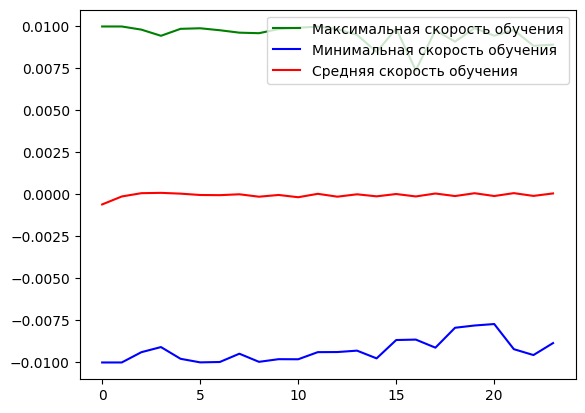

(0.6309188008308411, 0.6307761073112488, 24)

In [ ]:
#AdaGrad
model = Deep()
optimizer = optim.Adagrad(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

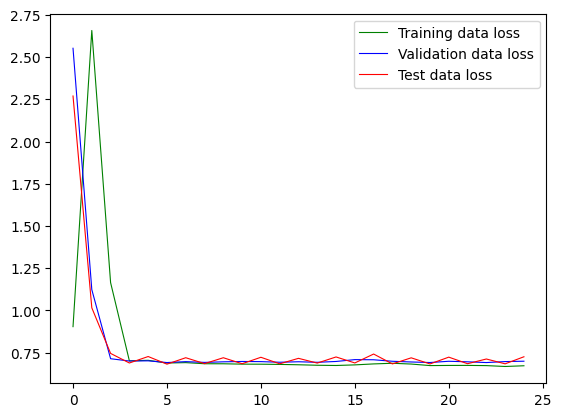

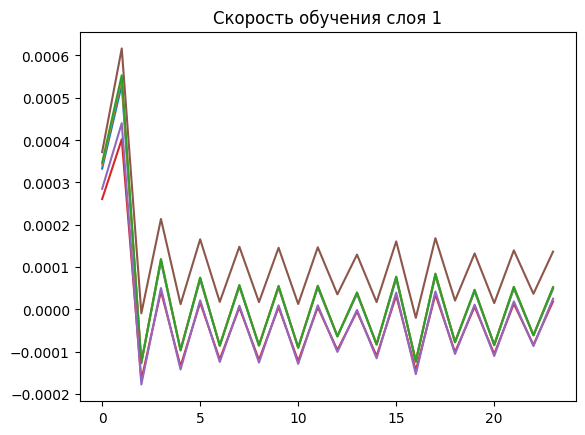

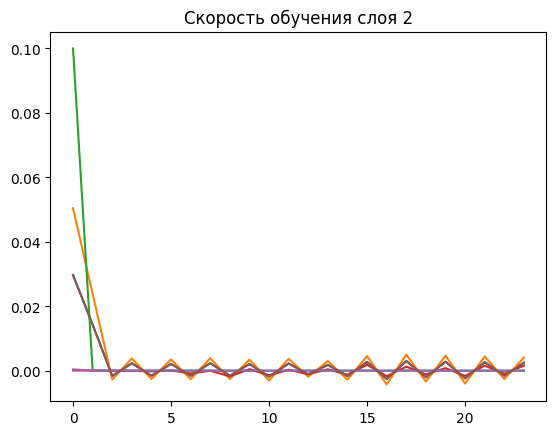

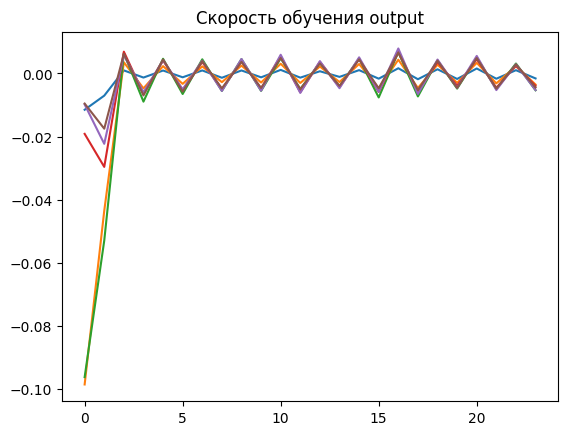

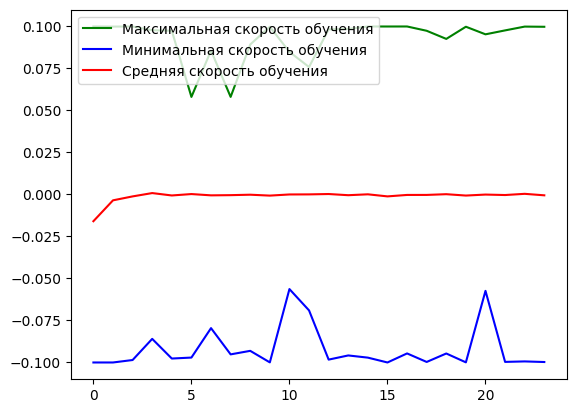

(0.6775248050689697, 0.7244954705238342, 24)

In [ ]:
#RMSprop
model = Deep()
optimizer = optim.RMSprop(model.parameters(), lr=0.01, alpha = 0.9)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

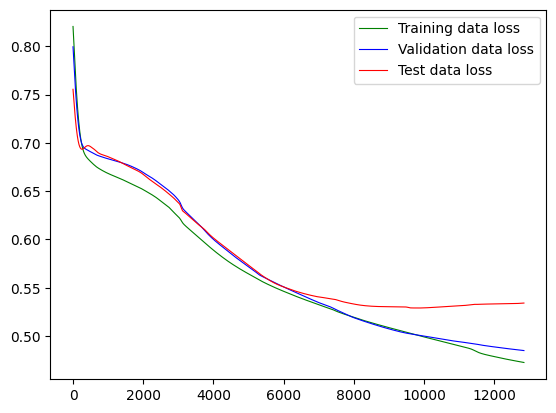

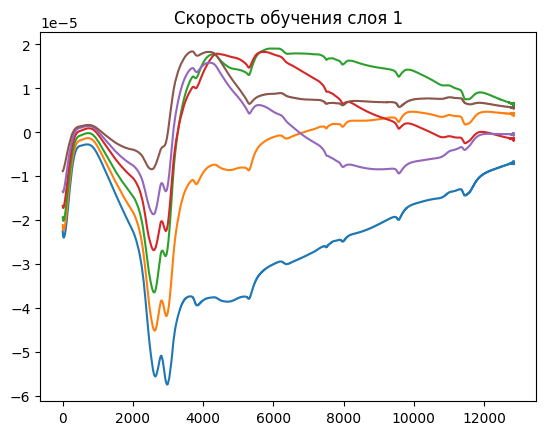

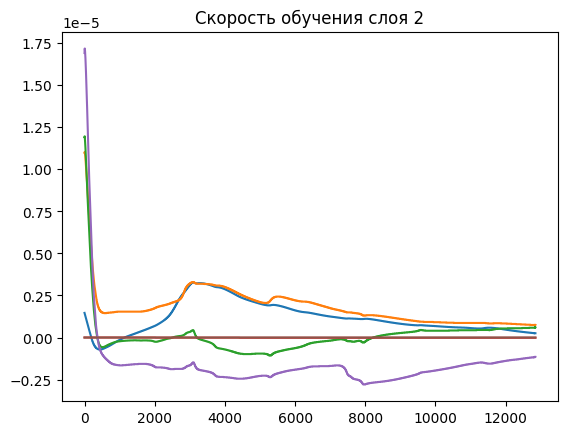

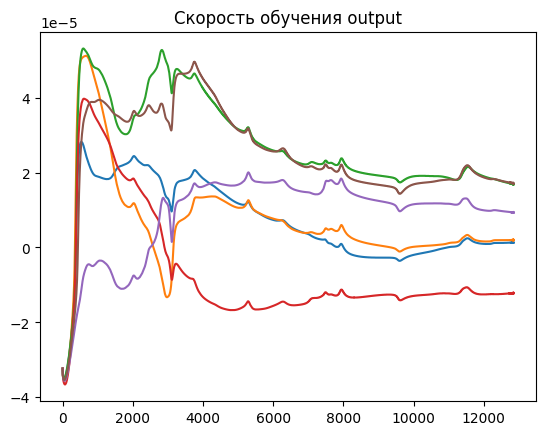

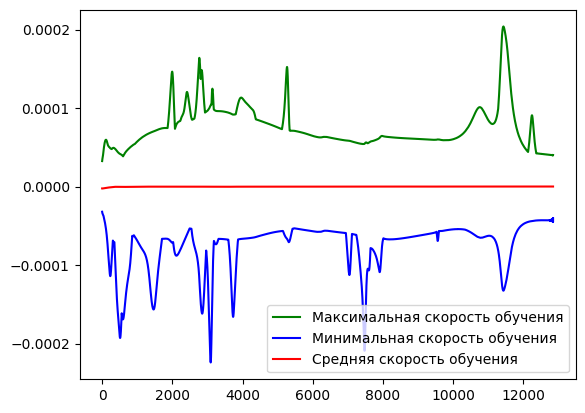

(0.5056559443473816, 0.5303270220756531, 12850)

In [ ]:
#AdaDelta
model = Deep()
optimizer = optim.Adadelta(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

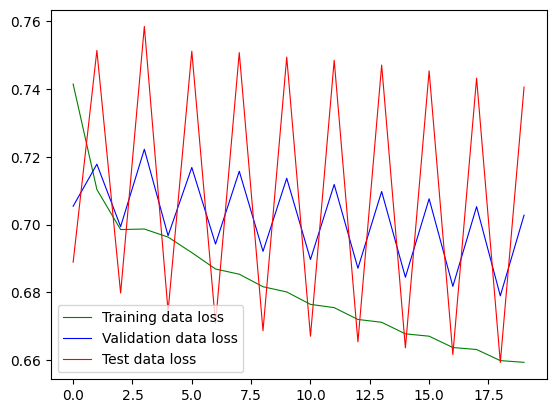

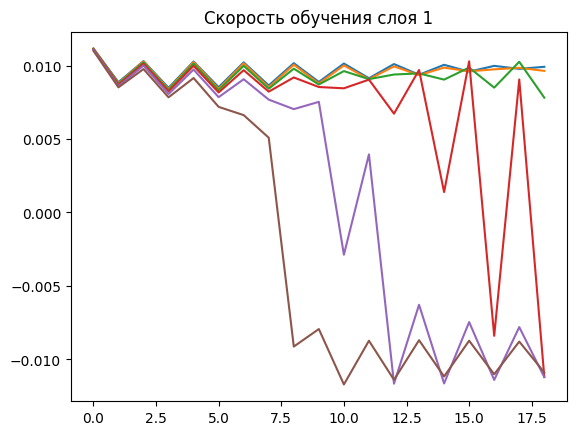

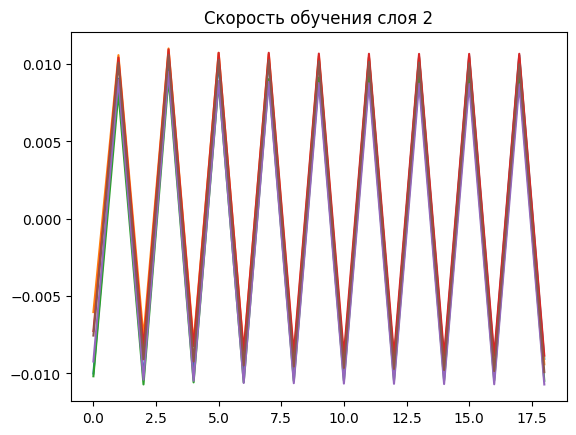

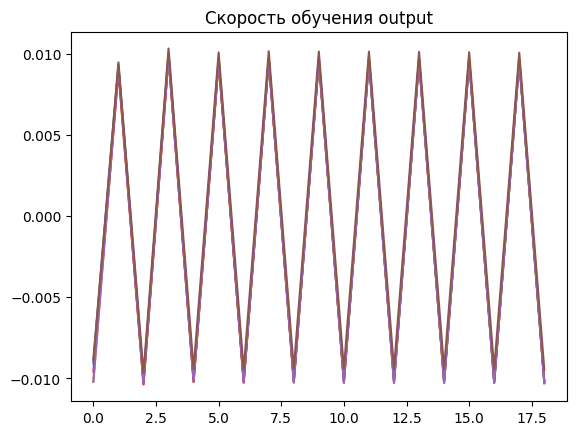

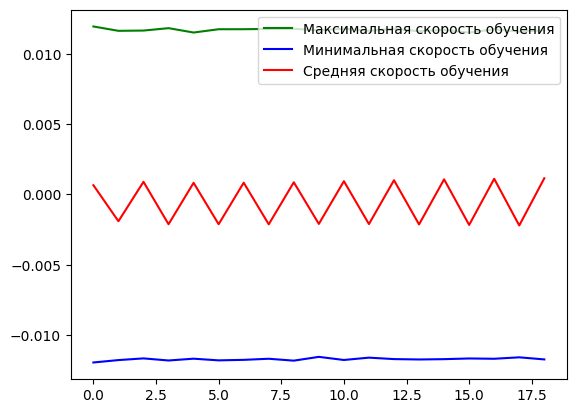

(0.6670630574226379, 0.6636316180229187, 19)

In [ ]:
#RMSprop
model = Deep()
optimizer = optim.RMSprop(model.parameters(), lr=0.01, alpha=0.3)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

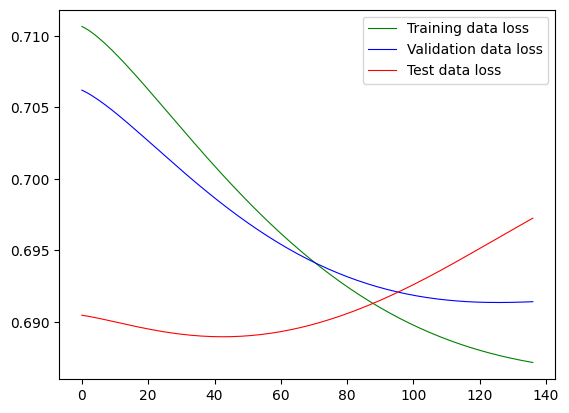

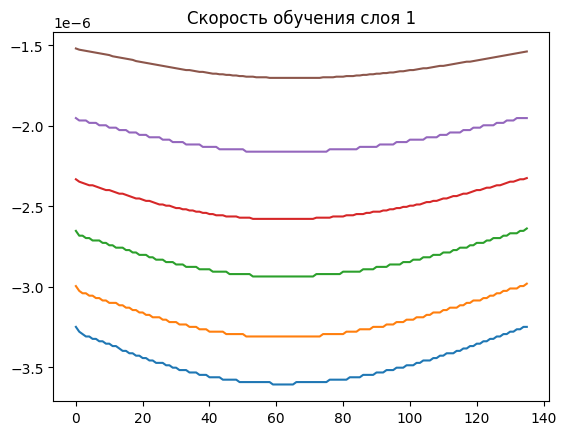

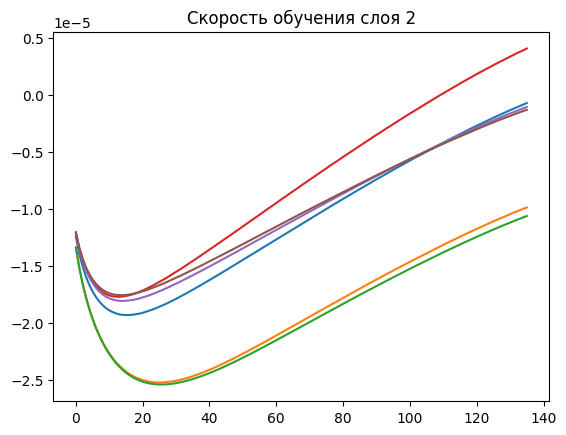

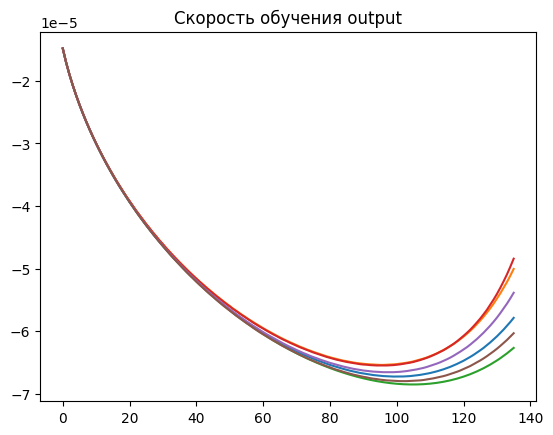

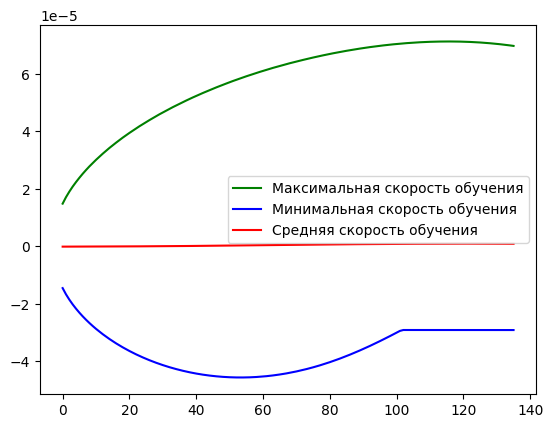

(0.6895530223846436, 0.6927206516265869, 136)

In [ ]:
#AdaDelta
model = Deep()
optimizer = optim.Adadelta(model.parameters(), lr=0.01, rho=0.3)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

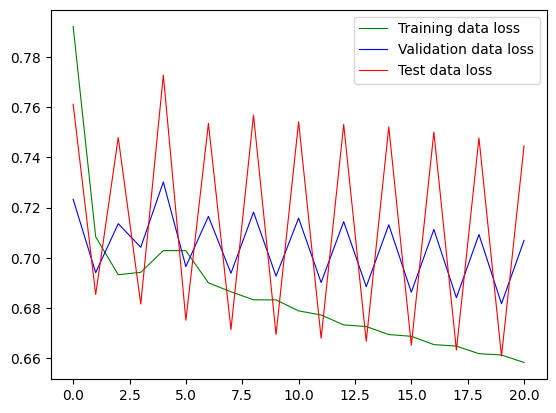

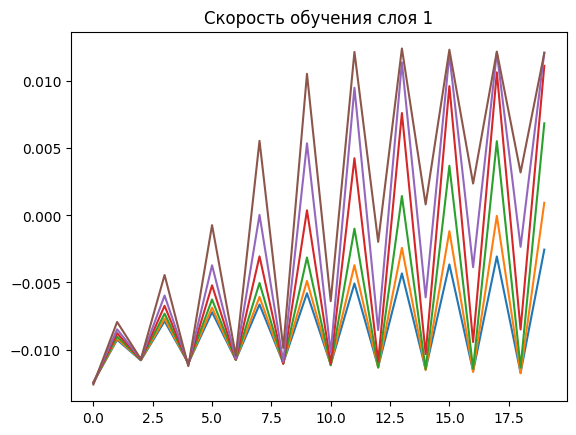

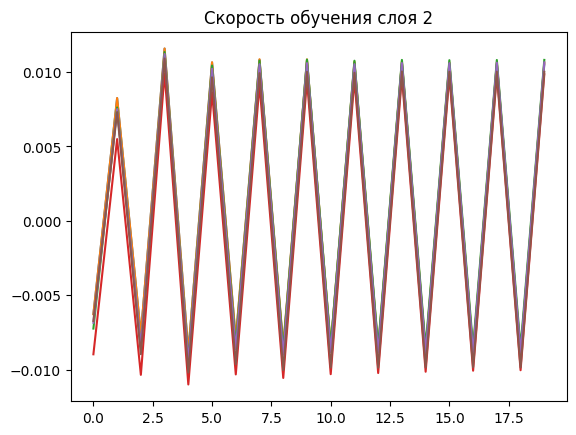

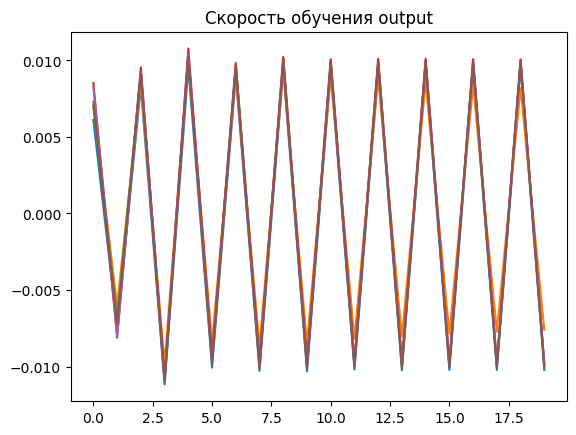

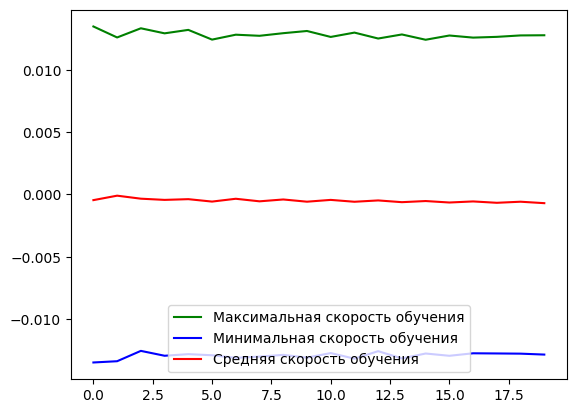

(0.6582522988319397, 0.6607911586761475, 20)

In [ ]:
#RMSprop
model = Deep()
optimizer = optim.RMSprop(model.parameters(), lr=0.01, alpha=0.45)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

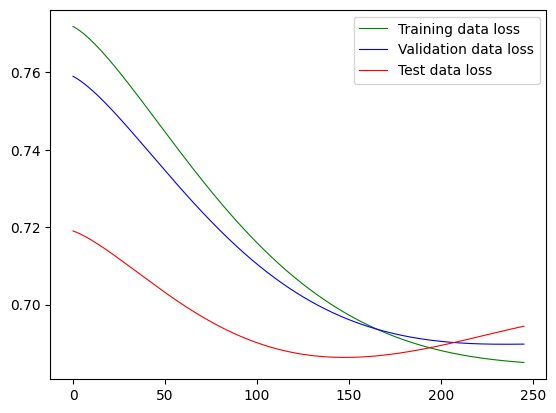

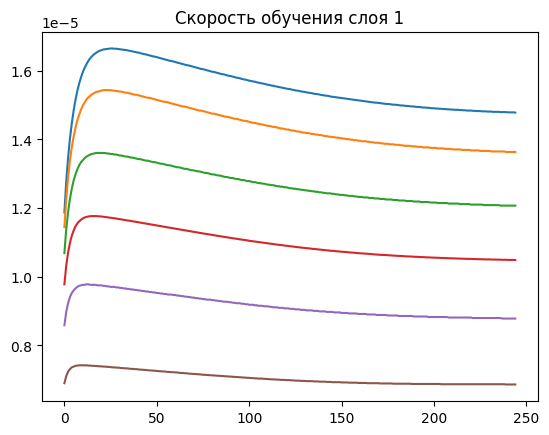

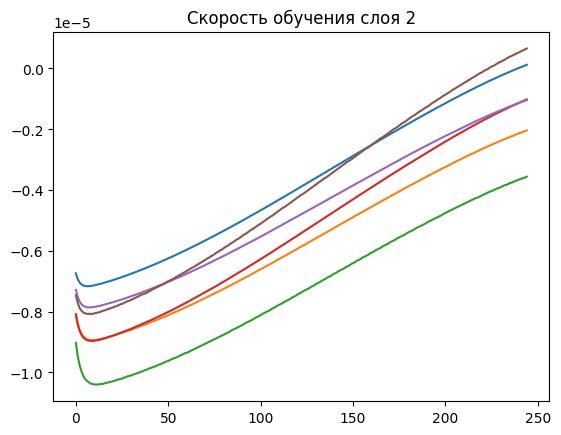

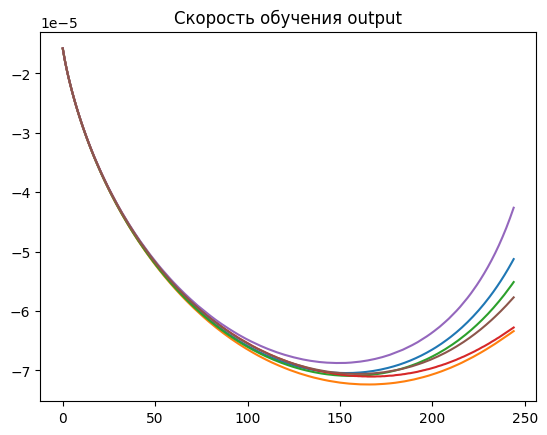

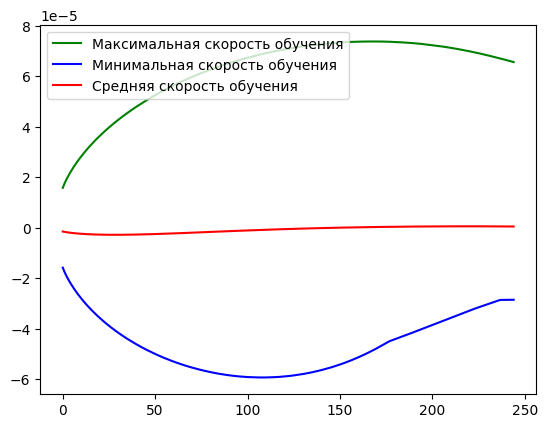

(0.690866231918335, 0.6876055002212524, 245)

In [ ]:
#AdaDelta
model = Deep()
optimizer = optim.Adadelta(model.parameters(), lr=0.01, rho=0.45)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

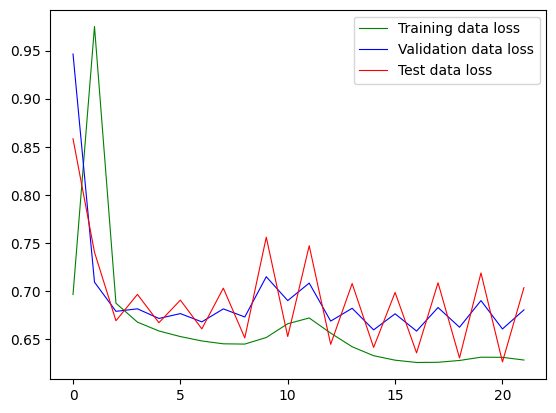

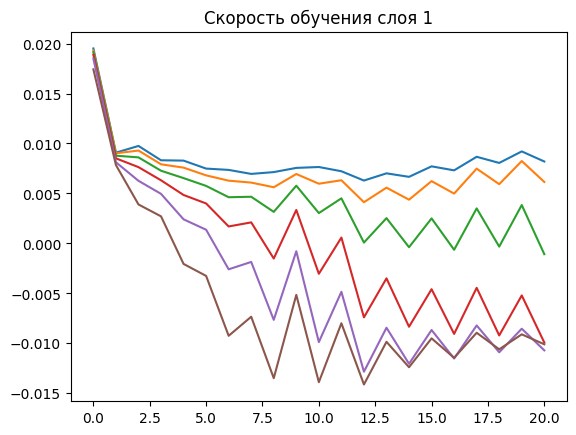

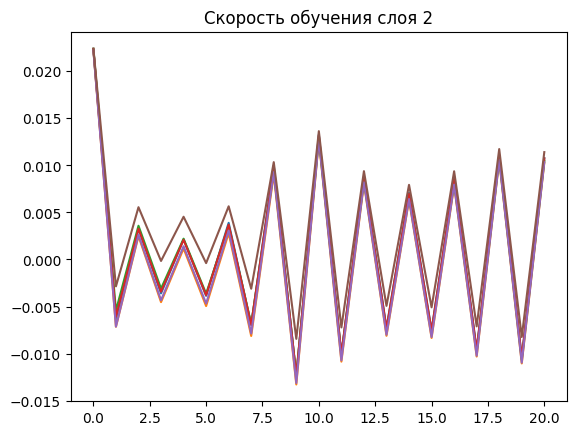

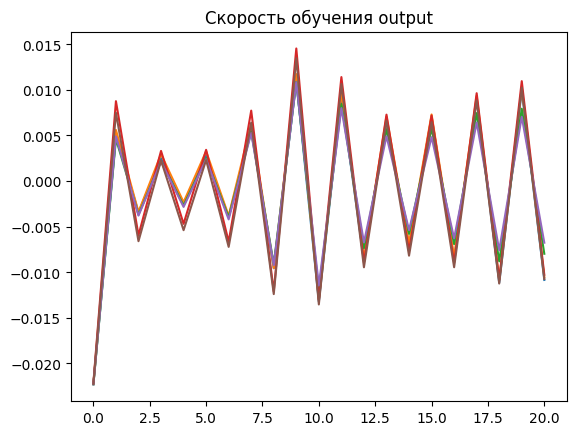

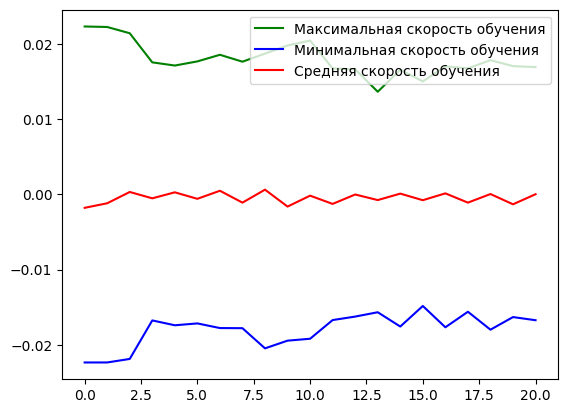

(0.6279191374778748, 0.6259676218032837, 21)

In [ ]:
#RMSprop
model = copy.deepcopy(model_initial)
optimizer = optim.RMSprop(model.parameters(), lr=0.01, alpha=0.8)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600
10700
10800
10900
11000
11100
11200
11300
11400
11500
11600
11700
11800
11900
12000
12100
12200
12300
12400
12500
12600
12700
12800
12900
13000
13100
13200
13300
13400
13500
13600
13700
13800
13900
14000
14100
14200
14300
14400
14500
14600
14700
14800
14900
15000
15100
15200
15300
15400
15500
15600
15700
15800
15900
16000
16100
16200
16300
16400
16500
16600
16700
16800
16900
17000
17100
17200
17300
17400
17500
17600
17700
17800
17900
18000
18100
18200
18300
18400
18

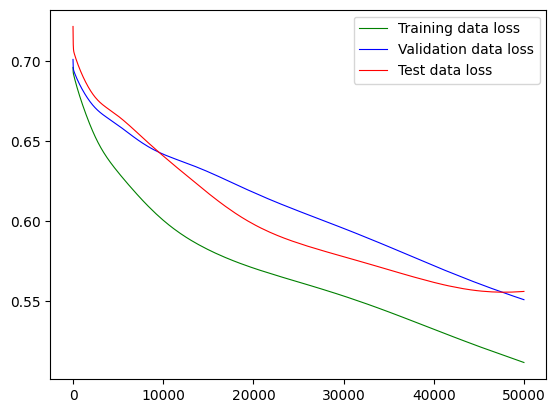

(0.5114453434944153, 0.5559144616127014, 49999)

In [ ]:
#AdaDelta
model = copy.deepcopy(model_initial)
optimizer = optim.Adadelta(model.parameters(), lr=0.01, rho=1)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600
10700
10800
10900
11000
11100
11200
11300
11400
11500
11600
11700
11800
11900
12000
12100
12200
12300
12400
12500
12600
12700
12800
12900
13000
13100
13200
13300
13400
13500
13600
13700
13800
13900
14000
14100
14200
14300
14400
14500
14600
14700
14800
14900
15000
15100
15200
15300
15400
15500
15600
15700
15800
15900
16000
16100
16200
16300
16400
16500
16600
16700
16800
16900
17000
17100
17200
17300
17400
17500
17600
17700
17800
17900
18000
18100
18200
18300
18400
18

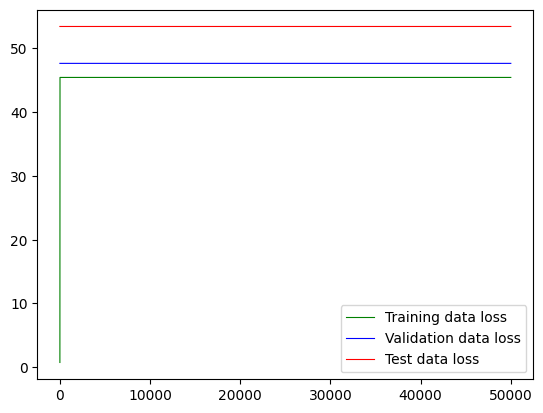

(45.45454406738281, 53.44827651977539, 49999)

In [ ]:
#RMSprop
model = Deep()
optimizer = optim.RMSprop(model.parameters(), lr=0.01, alpha=0.99)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

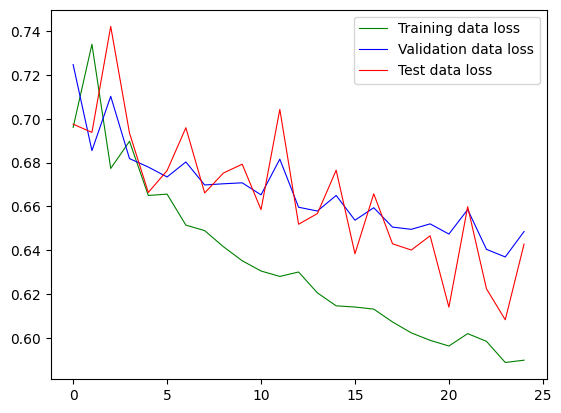

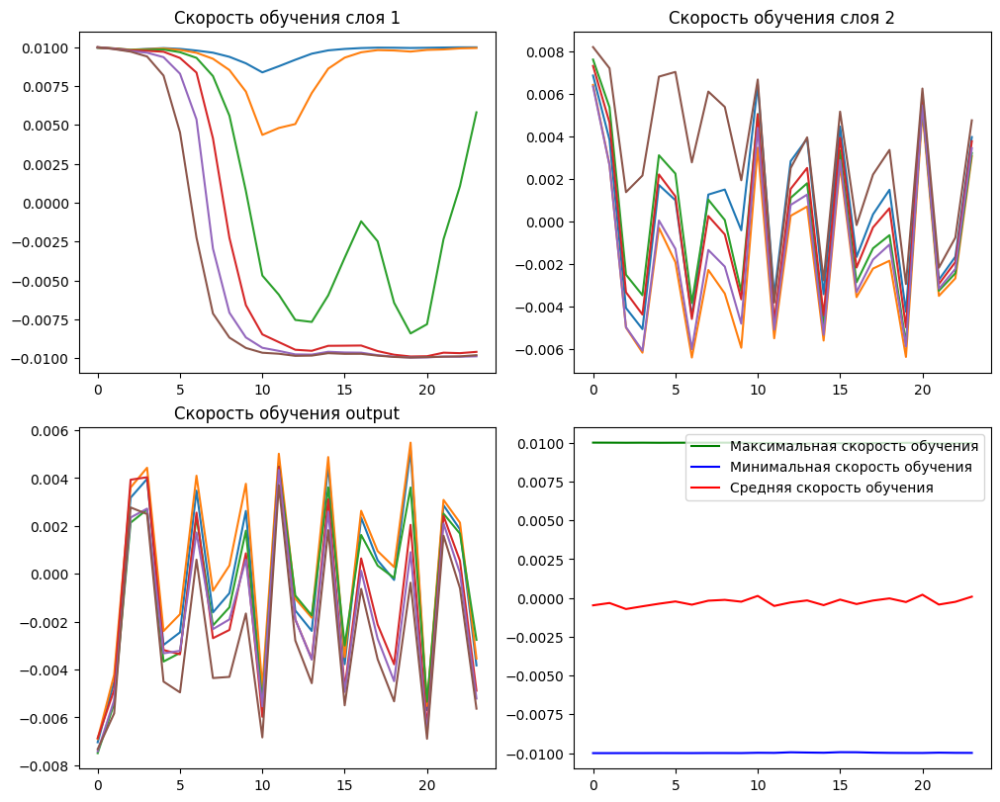

(0.5899013876914978, 0.608332097530365, 24)

In [ ]:
#Adam
model = copy.deepcopy(model_initial)
optimizer = optim.Adam(model.parameters(), lr=0.01, betas=(0.5, 0.5))
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

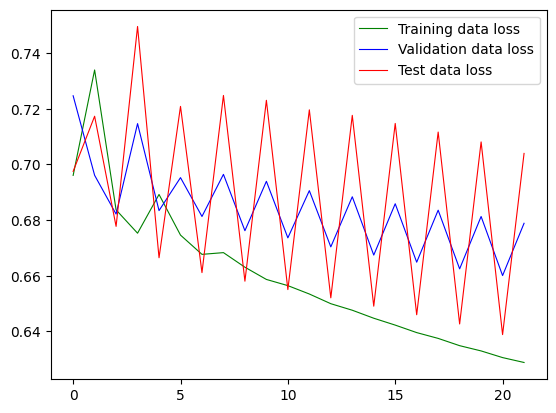

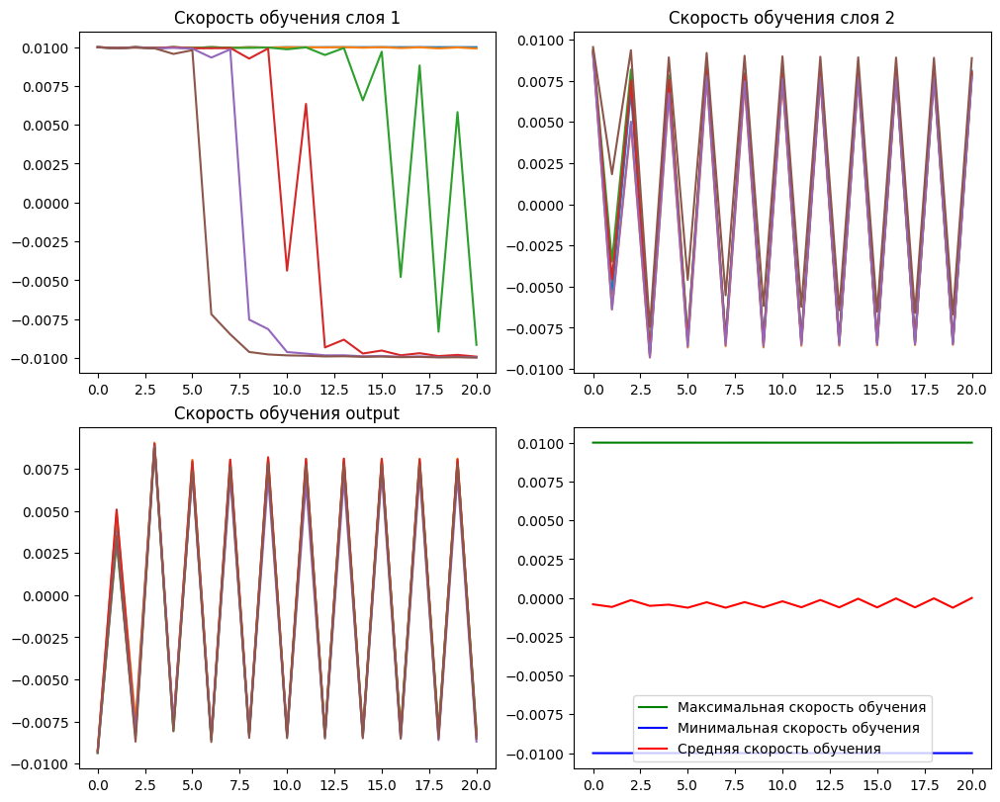

(0.6288468837738037, 0.6388666033744812, 21)

In [ ]:
#Adam
model = copy.deepcopy(model_initial)
optimizer = optim.Adam(model.parameters(), lr=0.01, betas=(0.1, 0.1))
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

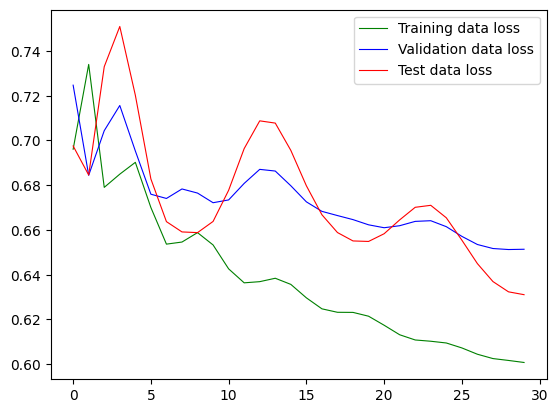

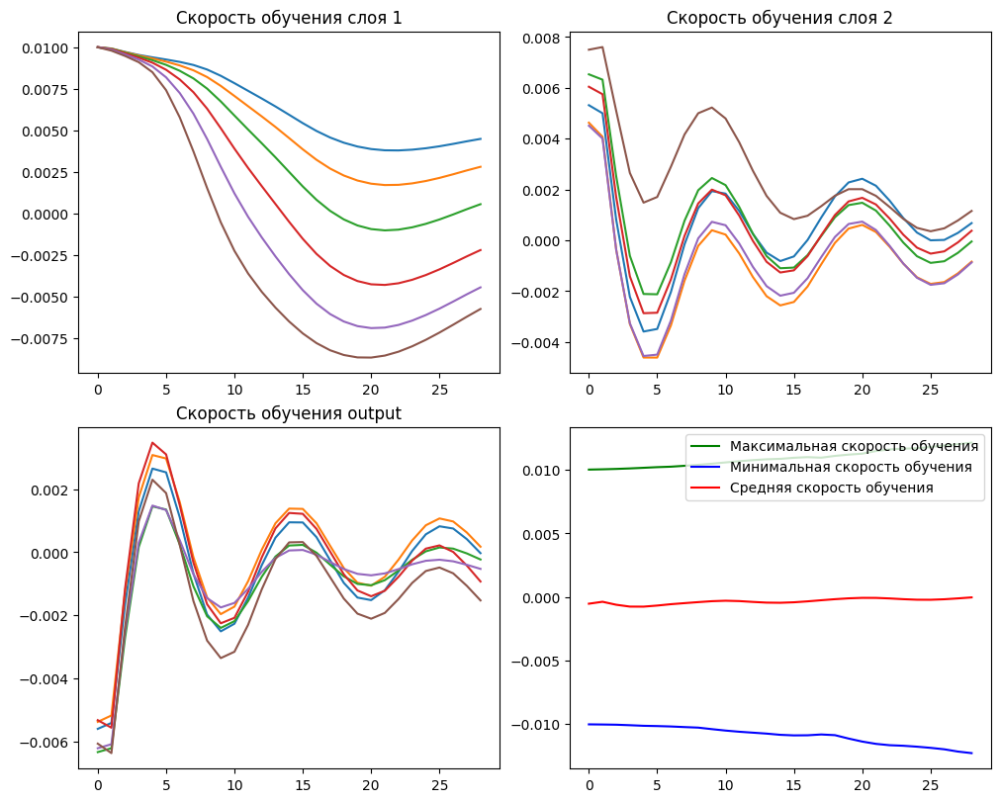

(0.6007708311080933, 0.6323428153991699, 29)

In [ ]:
#Adam
model = copy.deepcopy(model_initial)
optimizer = optim.Adam(model.parameters(), lr=0.01, betas=(0.9, 0.999))
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

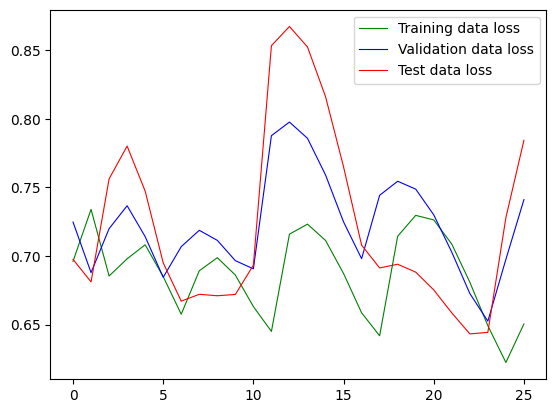

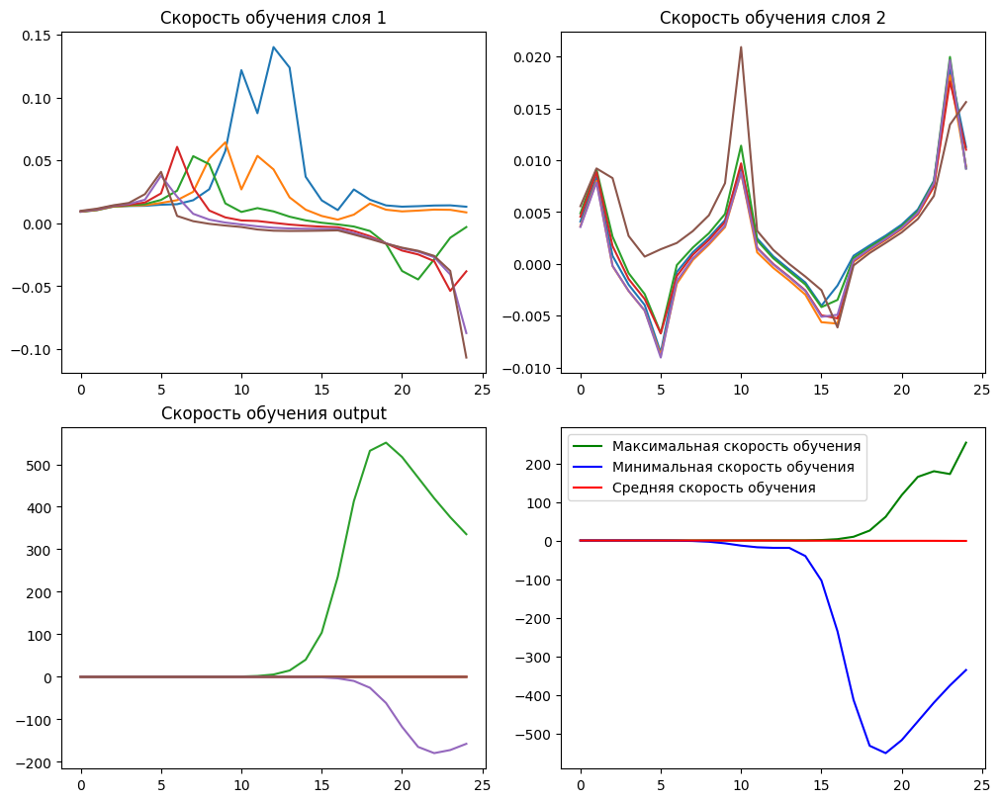

(0.6223342418670654, 0.6442831754684448, 25)

In [ ]:
#Adam
model = copy.deepcopy(model_initial)
optimizer = optim.Adam(model.parameters(), lr=0.01, betas=(0.9, 0.1))
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

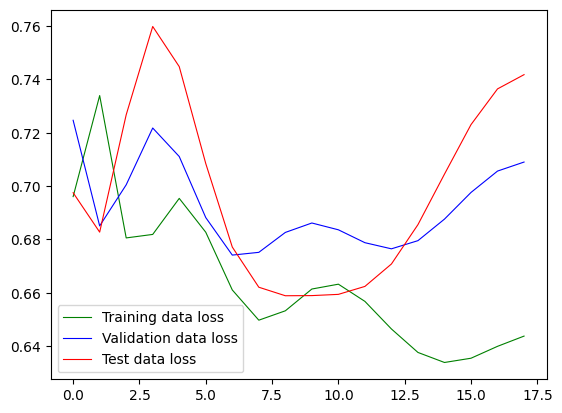

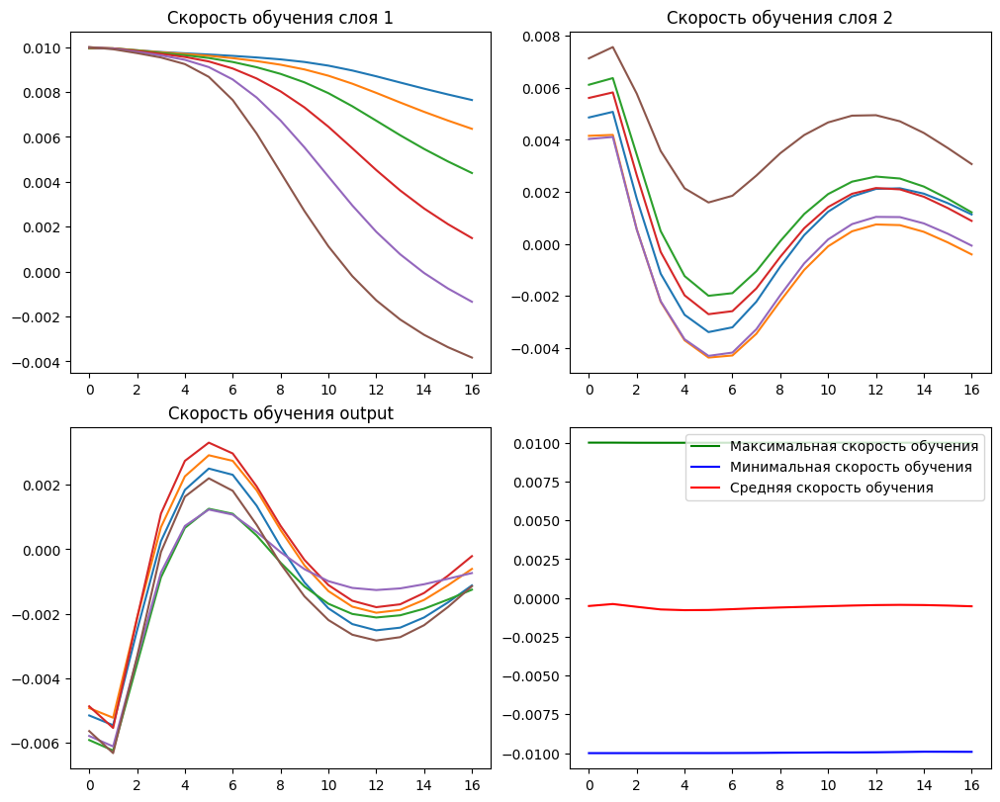

(0.6437702775001526, 0.7364757657051086, 17)

In [ ]:
#Adam
model = copy.deepcopy(model_initial)
optimizer = optim.Adam(model.parameters(), lr=0.01, betas=(0.999, 0.999))
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

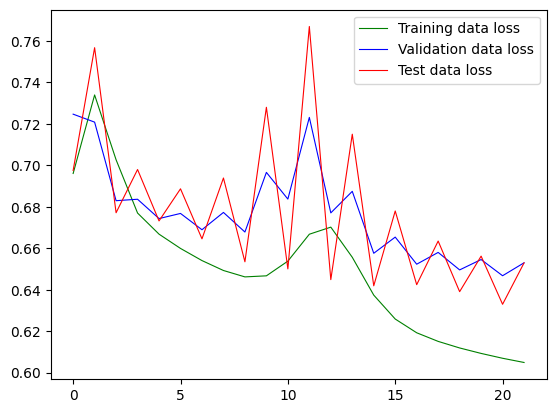

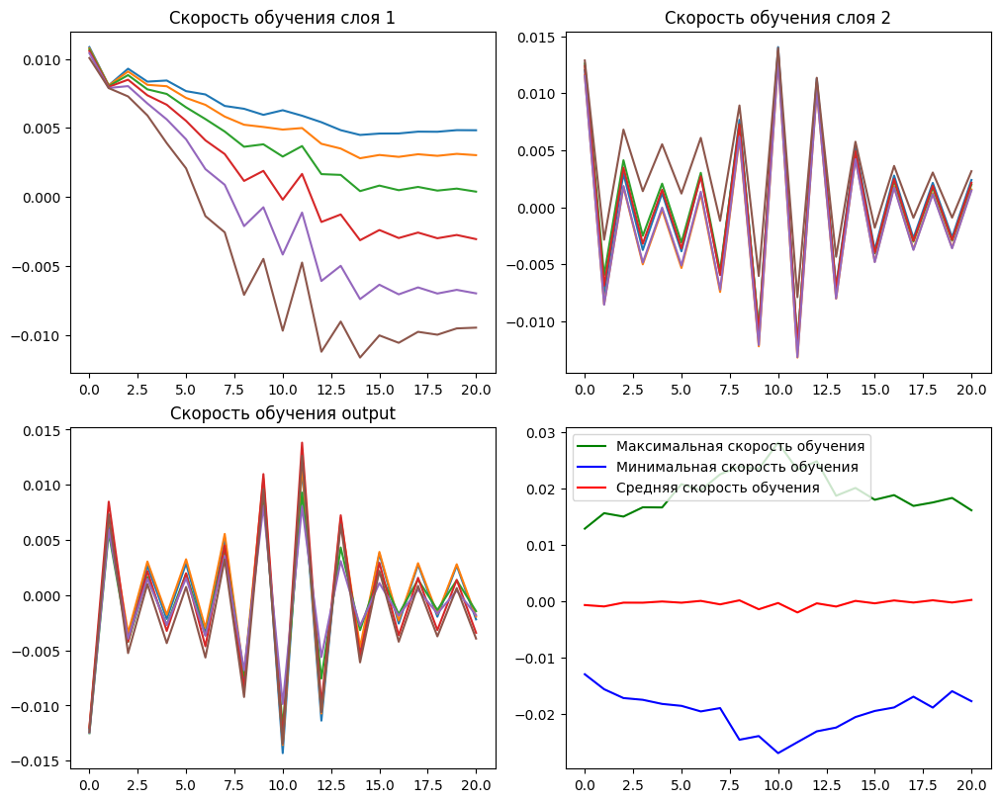

(0.6048963665962219, 0.6329725980758667, 21)

In [ ]:
#Adam
model = copy.deepcopy(model_initial)
optimizer = optim.Adam(model.parameters(), lr=0.01, betas=(0.1, 0.999))
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

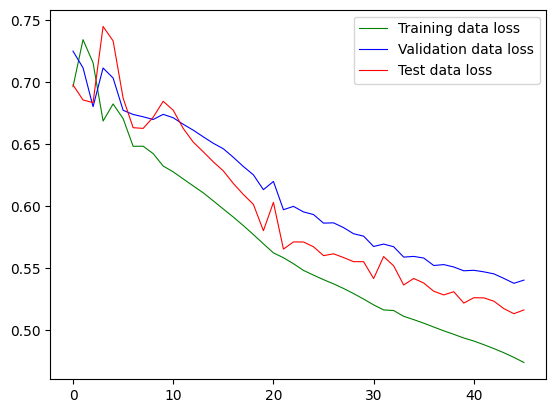

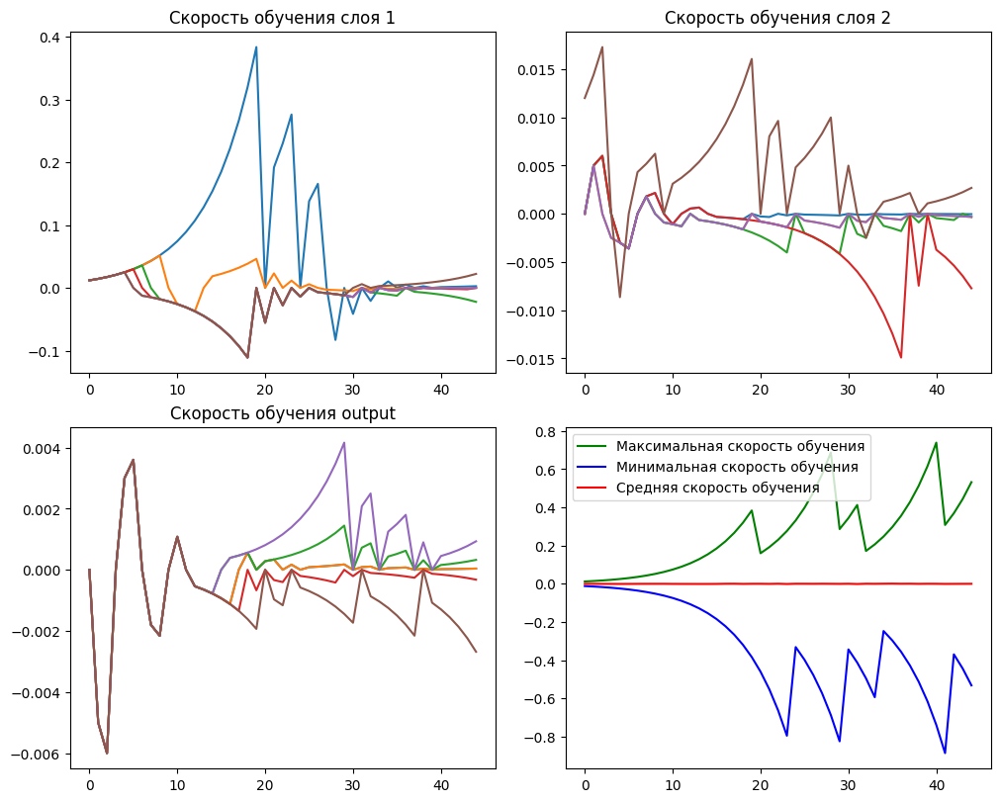

(0.47800731658935547, 0.5173057317733765, 45)

In [ ]:
#RProp
model = copy.deepcopy(model_initial)
optimizer = optim.Rprop(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

In [ ]:
from torch.utils.data import Dataset, DataLoader
# The fit function provides an example of how to train your model in PyTorch training loop

# create DataLoader, then take one batch
trainset = torch.utils.data.TensorDataset(X_train, y_train)
model = copy.deepcopy(model_initial)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=128, shuffle=True, drop_last=True)

tlm.utils.fit(
  tlm.training.LevenbergMarquardtModule(
    model=model,
    loss_fn=tlm.loss.BCELoss(),
    learning_rate=1.0,
    attempts_per_step=10,
    solve_method='qr',
  ),
  trainloader,
  epochs=22,
)
loss_fn = nn.BCELoss()
y_pred = model(X_test)
test_loss = loss_fn(y_pred, y_test)
test_loss

Epoch 22/22: 100%|██████████| 5/5 [00:00<00:00, 14.86it/s, epoch_avg_loss=4.6151e-01]

Training complete. Final epoch average loss: 4.6151e-01


tensor(0.7088, grad_fn=<BinaryCrossEntropyBackward0>)

In [ ]:
torch.nn.BCELoss(y_test, model(X_test))

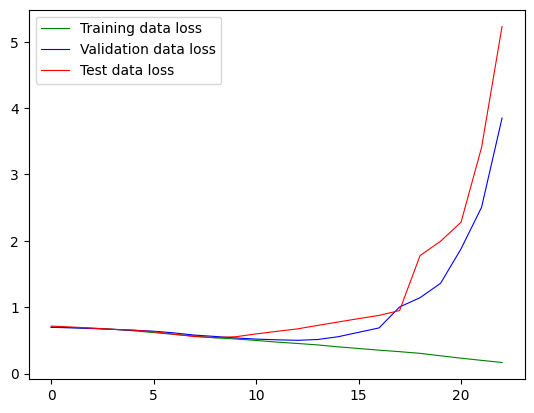

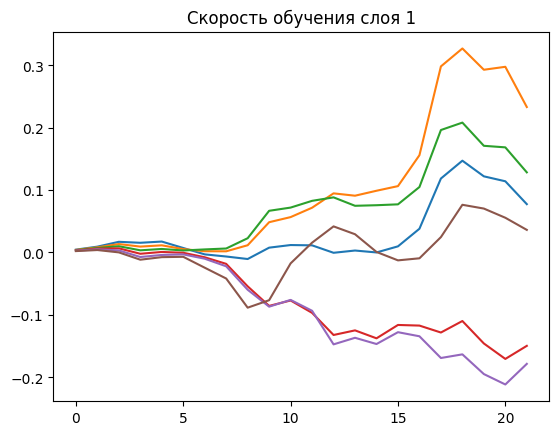

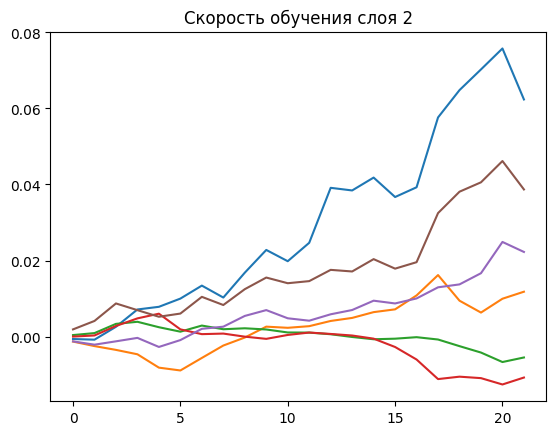

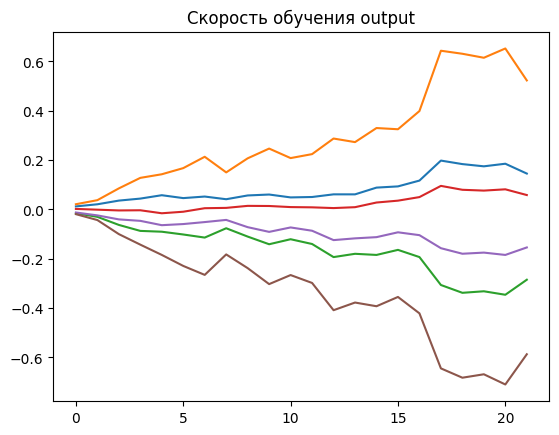

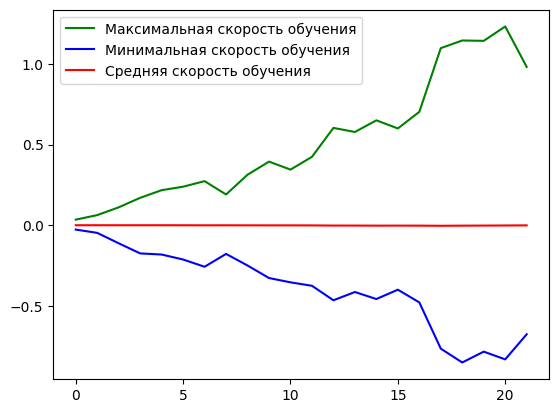

(0.40276092290878296, 0.7252334356307983, 22)

In [ ]:
#BFGS
model = copy.deepcopy(model_initial)
optimizer = optim.LBFGS(model.parameters(), lr=0.01)
loss_fn = torch.nn.BCELoss()
def closure():
    optimizer.zero_grad()
    loss_fn(model(X_train), y_train).backward()
    loss = loss_fn(model(X_train), y_train)
    return loss
train_loss, test_loss, epoch = model_train_basic(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, closure)
train_loss, test_loss, epoch

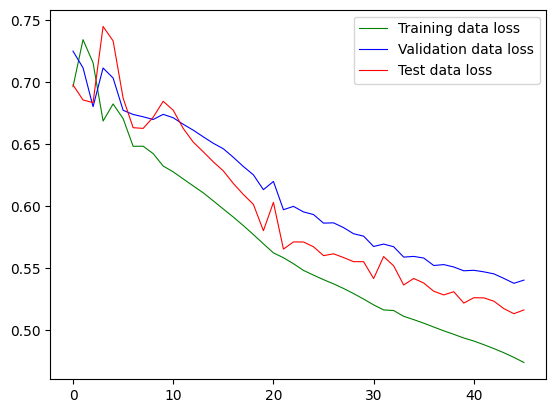

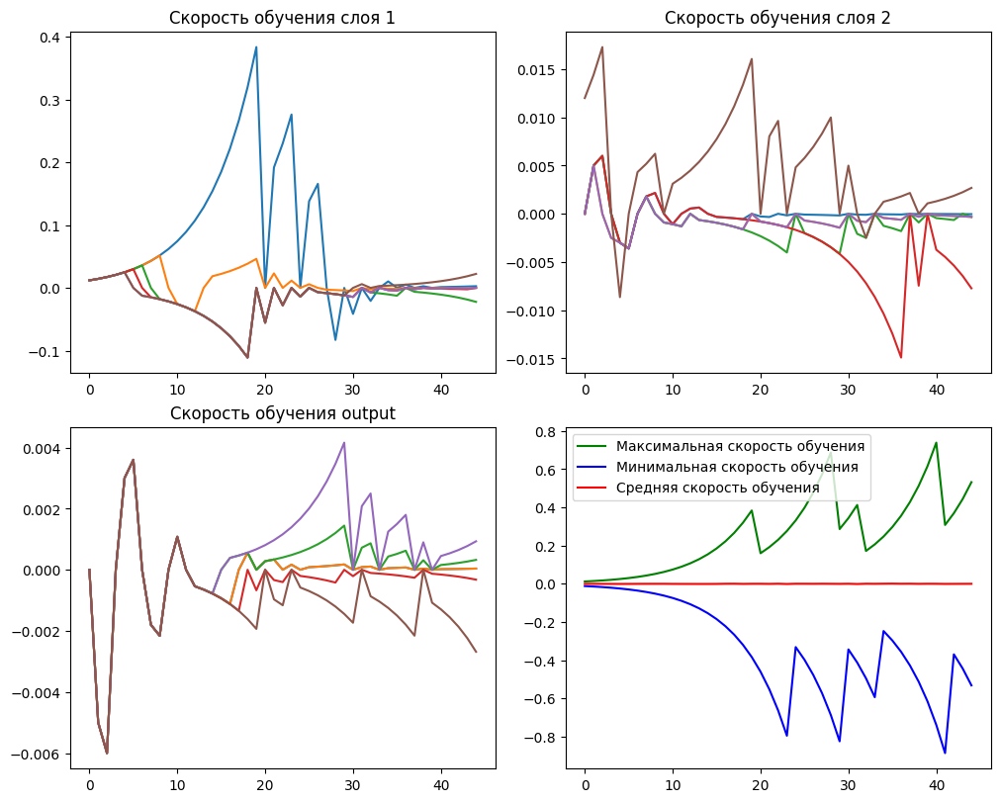

(0.47800731658935547, 0.5173057317733765, 45)

In [ ]:
#RProp
model = copy.deepcopy(model_initial)
optimizer = optim.Rprop(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

0


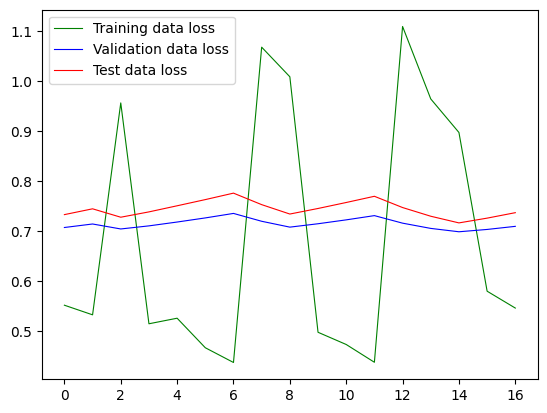

(0.7017328143119812, 0.7368760704994202, 0)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, batch_size = 1)
train_loss, test_loss, epoch

0


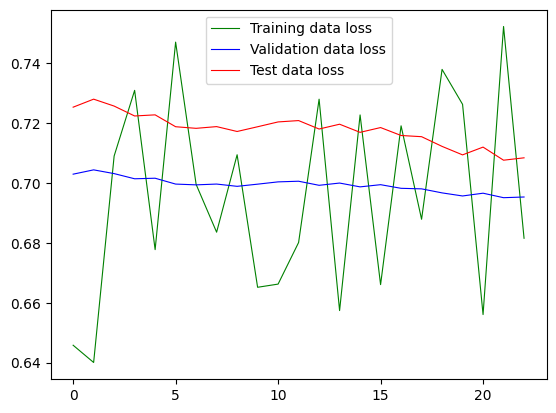

(0.6926596164703369, 0.7084570527076721, 0)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, batch_size = 20)
train_loss, test_loss, epoch

0


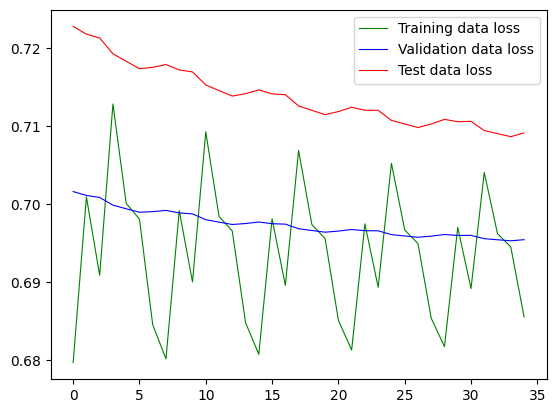

(0.6924466490745544, 0.7091139554977417, 4)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, batch_size = 100)
train_loss, test_loss, epoch

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600
10700
10800
10900
11000
11100
11200
11300
11400
11500
11600
11700
11800
11900
12000
12100
12200
12300
12400
12500
12600
12700
12800
12900
13000
13100
13200
13300
13400
13500
13600
13700
13800
13900
14000
14100
14200
14300
14400
14500
14600
14700
14800
14900
15000
15100
15200
15300
15400
15500
15600
15700
15800
15900
16000
16100
16200
16300
16400
16500
16600
16700
16800
16900
17000
17100
17200
17300
17400
17500
17600
17700
17800
17900
18000
18100
18200
18300
18400
18

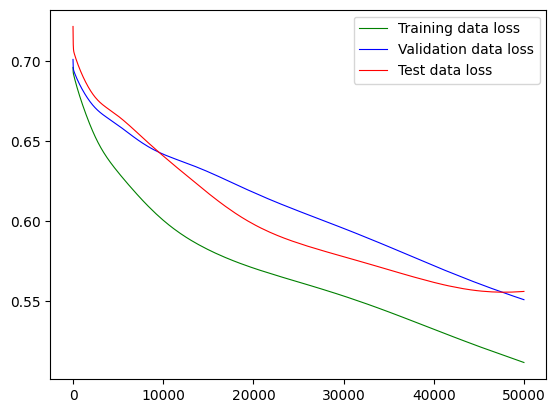

(0.5114453434944153, 0.5559144616127014, 49999)

In [ ]:
model = copy.deepcopy(model_initial)
optimizer = optim.SGD(model.parameters(), lr=0.01)
train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

In [ ]:
class Deep_std(nn.Module):
    def __init__(self, std):
        super().__init__()
        self.layer1 = nn.Linear(16, 20)
        torch.nn.init.normal_(self.layer1.weight, mean=0, std=std)
        self.act1 = nn.Sigmoid()
        self.layer2 = nn.Linear(20, 20)
        torch.nn.init.normal_(self.layer2.weight, mean=0, std=std)
        self.act2 = nn.Sigmoid()
        self.output = nn.Linear(20, 1)
        torch.nn.init.normal_(self.output.weight, mean=0, std=std)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.act1(self.layer1(x))
        x = self.act2(self.layer2(x))
        x = self.sigmoid(self.output(x))
        return x

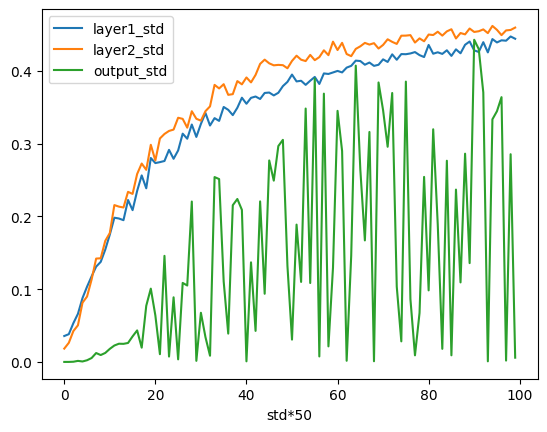

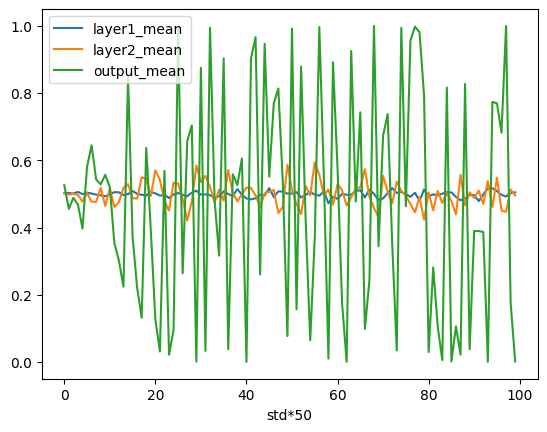

In [ ]:
std1 = []
std2 = []
std3 = []
mean1 = []
mean2 = []
mean3 = []
for i in range (100):
  model_test = Deep_std(i/50)
  act = nn.Sigmoid()
  y_pred1 = x = act(model_test.layer1(X_test))
  std1.append(y_pred1.detach().squeeze().numpy().std())
  mean1.append(y_pred1.detach().squeeze().numpy().mean())
  #print(y_pred1.detach().squeeze().numpy().std())
  y_pred2 = x = act(model_test.layer2(y_pred1))
  std2.append(y_pred2.detach().squeeze().numpy().std())
  mean2.append(y_pred2.detach().squeeze().numpy().mean())
  y_pred3 = x = act(model_test.output(y_pred2))
  std3.append(y_pred3.detach().squeeze().numpy().std())
  mean3.append(y_pred3.detach().squeeze().numpy().mean())
plt.plot(std1, label = "layer1_std")
plt.plot(std2, label = "layer2_std")
plt.plot(std3, label = "output_std")
plt.legend()
plt.xlabel(xlabel = "std*50")
plt.show()
plt.plot(mean1, label = "layer1_mean")
plt.plot(mean2, label = "layer2_mean")
plt.plot(mean3, label = "output_mean")
plt.legend()
plt.xlabel(xlabel = "std*50")
plt.show()

(array([1., 0., 0., 1., 0., 0., 1., 1., 0., 2., 2., 4., 7., 3., 7., 2., 2.,
        2., 0., 3., 5., 0., 6., 5., 0., 2., 2., 2., 2., 4., 2., 2., 2., 3.,
        5., 3., 5., 5., 4., 1., 2., 1., 3., 0., 4., 3., 2., 1., 0., 2.]),
 array([0.48979229, 0.49025917, 0.49072602, 0.49119291, 0.49165976,
        0.49212664, 0.49259353, 0.49306038, 0.49352726, 0.49399412,
        0.494461  , 0.49492788, 0.49539474, 0.49586162, 0.49632847,
        0.49679536, 0.49726224, 0.49772909, 0.49819598, 0.49866283,
        0.49912971, 0.4995966 , 0.50006348, 0.5005303 , 0.50099719,
        0.50146407, 0.50193095, 0.50239784, 0.50286466, 0.50333154,
        0.50379843, 0.50426531, 0.50473219, 0.50519902, 0.5056659 ,
        0.50613278, 0.50659966, 0.50706655, 0.50753337, 0.50800025,
        0.50846714, 0.50893402, 0.5094009 , 0.50986773, 0.51033461,
        0.51080149, 0.51126838, 0.51173526, 0.51220208, 0.51266897,
        0.51313585]),
 <BarContainer object of 50 artists>)

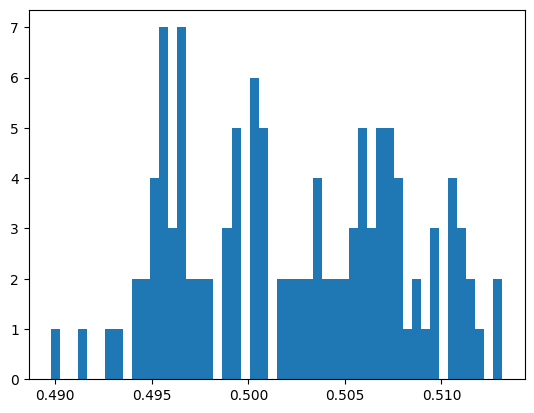

In [ ]:
model_test = Deep_std(0.1)
act = nn.Sigmoid()
y_pred1 = x = act(model_test.layer1(X_test))
std1.append(y_pred1.detach().squeeze().numpy().std())
mean1.append(y_pred1.detach().squeeze().numpy().mean())
#print(y_pred1.detach().squeeze().numpy().std())
y_pred2 = x = act(model_test.layer2(y_pred1))
std2.append(y_pred2.detach().squeeze().numpy().std())
mean2.append(y_pred2.detach().squeeze().numpy().mean())
y_pred3 = x = act(model_test.output(y_pred2))
std3.append(y_pred3.detach().squeeze().numpy().std())
mean3.append(y_pred3.detach().squeeze().numpy().mean())
plt.hist(y_pred3.detach().numpy(), bins = 50)

(array([37.,  1.,  1.,  1.,  1.,  1.,  2.,  0.,  1.,  1.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  1.,  1.,  1.,  2.,  0.,  1.,  0.,  0.,  0.,
         1.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,
         0.,  0.,  0.,  0.,  3.,  1.,  1.,  1.,  1.,  2., 52.]),
 array([9.89942572e-11, 1.99999996e-02, 3.99999991e-02, 5.99999987e-02,
        7.99999982e-02, 9.99999940e-02, 1.19999997e-01, 1.40000001e-01,
        1.59999996e-01, 1.79999992e-01, 1.99999988e-01, 2.19999999e-01,
        2.39999995e-01, 2.59999990e-01, 2.80000001e-01, 2.99999982e-01,
        3.19999993e-01, 3.40000004e-01, 3.59999985e-01, 3.79999995e-01,
        3.99999976e-01, 4.19999987e-01, 4.39999998e-01, 4.59999979e-01,
        4.79999989e-01, 5.00000000e-01, 5.19999981e-01, 5.39999962e-01,
        5.60000002e-01, 5.79999983e-01, 5.99999964e-01, 6.20000005e-01,
        6.39999986e-01, 6.59999967e-01, 6.80000007e-01, 6.99999988e-01,
        7.19999969e-01, 7.40000010e-01, 7.59999990e-01, 7.79999971e-

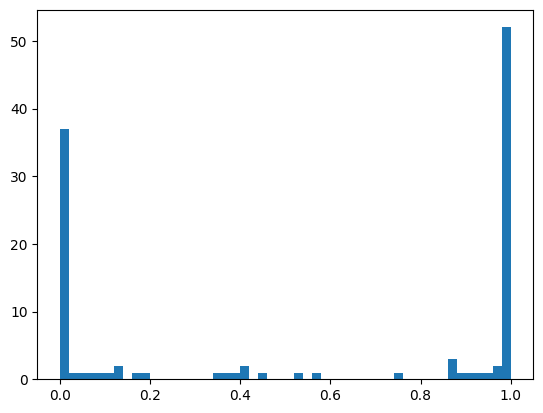

In [ ]:
model_test = Deep_std(5)
act = nn.Sigmoid()
y_pred1 = x = act(model_test.layer1(X_test))
std1.append(y_pred1.detach().squeeze().numpy().std())
mean1.append(y_pred1.detach().squeeze().numpy().mean())
#print(y_pred1.detach().squeeze().numpy().std())
y_pred2 = x = act(model_test.layer2(y_pred1))
std2.append(y_pred2.detach().squeeze().numpy().std())
mean2.append(y_pred2.detach().squeeze().numpy().mean())
y_pred3 = x = act(model_test.output(y_pred2))
std3.append(y_pred3.detach().squeeze().numpy().std())
mean3.append(y_pred3.detach().squeeze().numpy().mean())
plt.hist(y_pred3.detach().numpy(), bins = 50)

(array([1., 0., 0., 1., 0., 1., 1., 1., 1., 2., 3., 3., 1., 3., 1., 3., 1.,
        0., 3., 4., 6., 1., 1., 6., 3., 1., 0., 4., 2., 1., 2., 3., 3., 3.,
        1., 3., 1., 1., 5., 4., 8., 4., 5., 3., 6., 2., 1., 2., 3., 1.]),
 array([0.57497859, 0.57659918, 0.57821977, 0.57984036, 0.58146095,
        0.58308154, 0.58470213, 0.58632272, 0.58794332, 0.58956397,
        0.59118456, 0.59280515, 0.59442574, 0.59604633, 0.59766692,
        0.59928751, 0.6009081 , 0.60252869, 0.60414928, 0.60576987,
        0.60739046, 0.60901105, 0.61063164, 0.61225224, 0.61387283,
        0.61549342, 0.61711407, 0.61873466, 0.62035525, 0.62197584,
        0.62359643, 0.62521702, 0.62683761, 0.6284582 , 0.63007879,
        0.63169938, 0.63331997, 0.63494056, 0.63656116, 0.63818175,
        0.63980234, 0.64142299, 0.64304352, 0.64466417, 0.64628476,
        0.64790535, 0.64952594, 0.65114653, 0.65276712, 0.65438771,
        0.6560083 ]),
 <BarContainer object of 50 artists>)

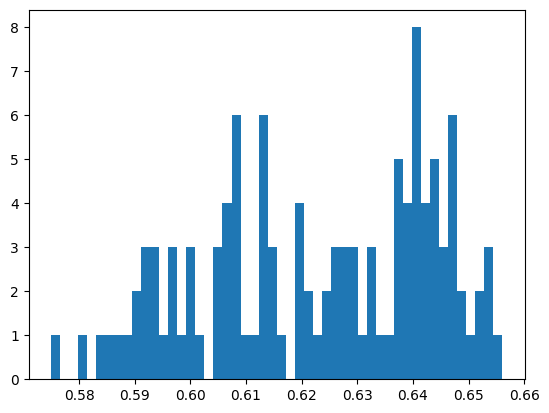

In [ ]:
model_test = Deep()
act = nn.Sigmoid()
y_pred1 = x = act(model_test.layer1(X_test))
std1.append(y_pred1.detach().squeeze().numpy().std())
mean1.append(y_pred1.detach().squeeze().numpy().mean())
#print(y_pred1.detach().squeeze().numpy().std())
y_pred2 = x = act(model_test.layer2(y_pred1))
std2.append(y_pred2.detach().squeeze().numpy().std())
mean2.append(y_pred2.detach().squeeze().numpy().mean())
y_pred3 = x = act(model_test.output(y_pred2))
std3.append(y_pred3.detach().squeeze().numpy().std())
mean3.append(y_pred3.detach().squeeze().numpy().mean())
plt.hist(y_pred3.detach().numpy(), bins = 50)

In [ ]:
import math
class Deep_std_uniform(nn.Module):
    def __init__(self, std, n_neurons = 20, act = nn.Sigmoid()):
        super().__init__()
        self.layer1 = nn.Linear(16, n_neurons)
        torch.nn.init.uniform_(self.layer1.weight, a = -math.sqrt(std*std*12), b =math.sqrt(std*std*12))
        self.act1 = act
        self.layer2 = nn.Linear(n_neurons, n_neurons)
        torch.nn.init.uniform_(self.layer2.weight, a = -math.sqrt(std*std*12), b =math.sqrt(std*std*12))
        self.act2 = act
        self.output = nn.Linear(n_neurons, 1)
        torch.nn.init.uniform_(self.output.weight, a = -math.sqrt(std*std*12), b =math.sqrt(std*std*12))
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.act1(self.layer1(x))
        x = self.act2(self.layer2(x))
        x = self.sigmoid(self.output(x))
        return x

In [ ]:
class Deep_std_truncated(nn.Module):
    def __init__(self, std):
        super().__init__()
        self.layer1 = nn.Linear(16, 20)
        torch.nn.init.trunc_normal_(self.layer1.weight, mean=0, std=std)
        self.act1 = nn.Sigmoid()
        self.layer2 = nn.Linear(20, 20)
        torch.nn.init.trunc_normal_(self.layer2.weight, mean=0, std=std)
        self.act2 = nn.Sigmoid()
        self.output = nn.Linear(20, 1)
        torch.nn.init.trunc_normal_(self.output.weight, mean=0, std=std)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.act1(self.layer1(x))
        x = self.act2(self.layer2(x))
        x = self.sigmoid(self.output(x))
        return x

0


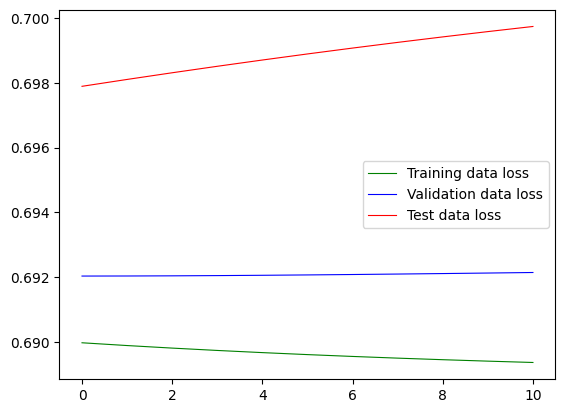

0
100
200
300
400
500
600
700
800
900


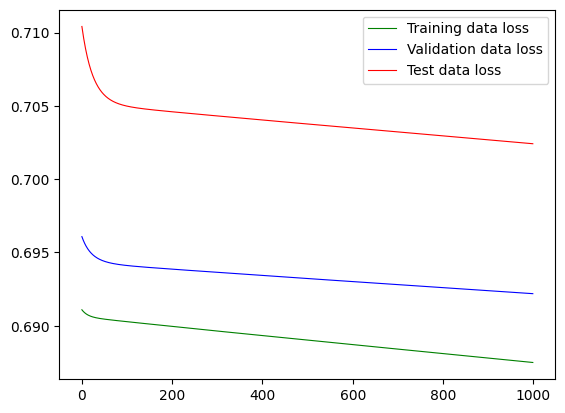

0


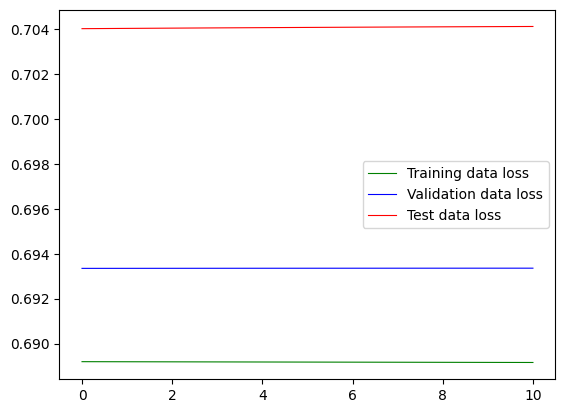

0


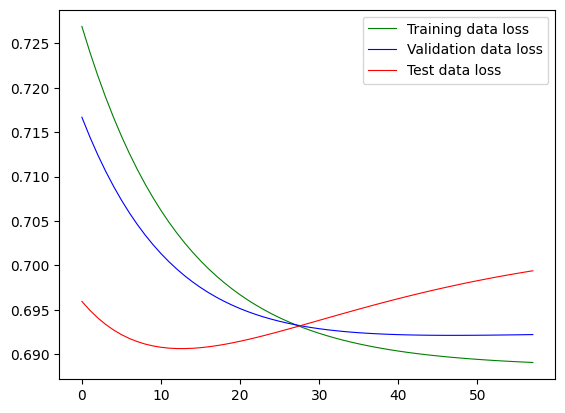

0
100
200
300
400
500
600
700
800
900


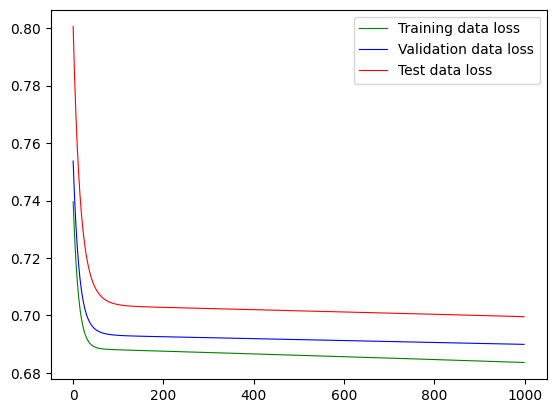

0


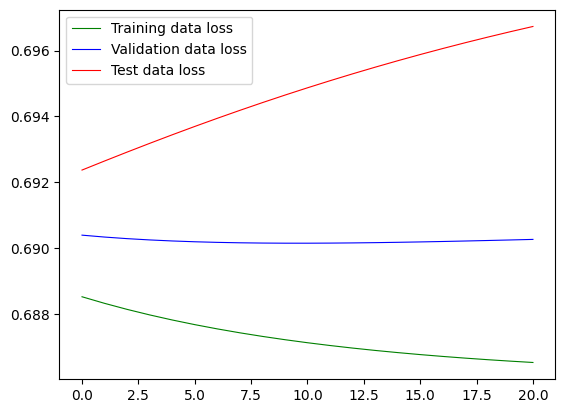

0
100
200
300
400
500
600
700
800
900


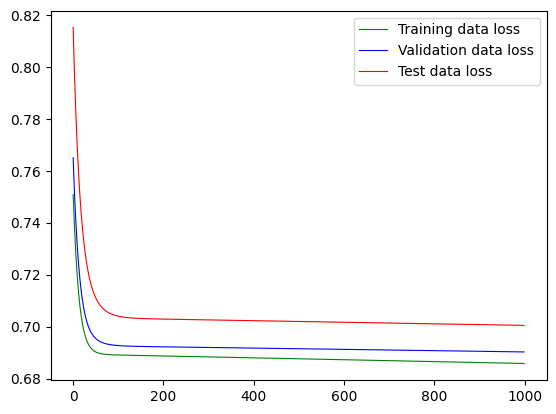

0


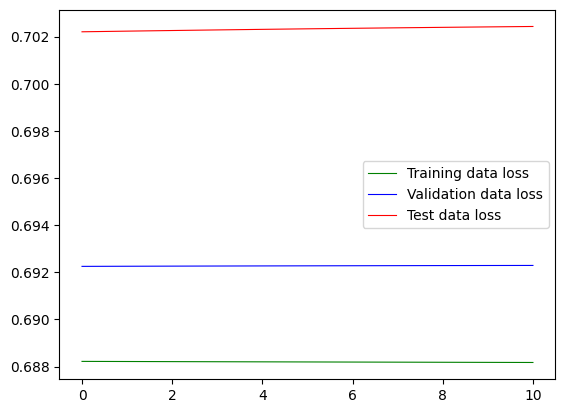

0
100
200
300
400
500
600
700
800
900


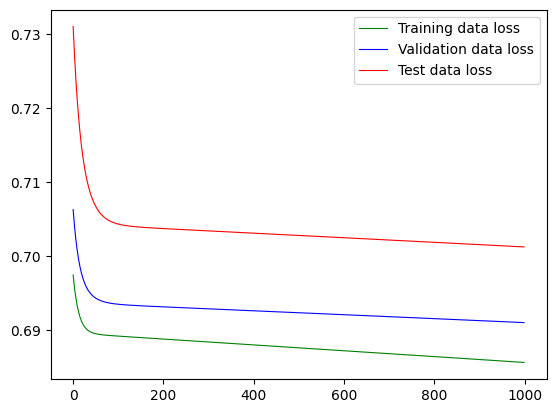

0
100
200
300
400
500
600
700
800
900


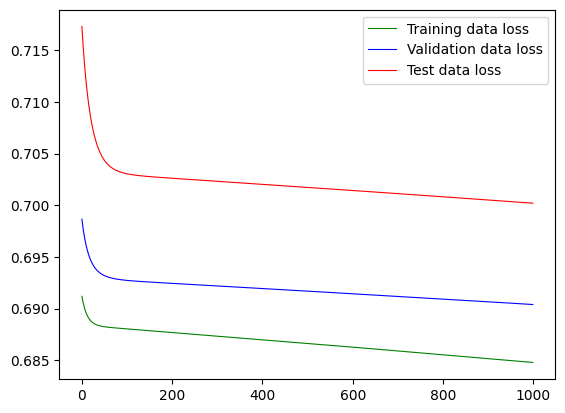

(np.float64(0.6869480967521667),
 np.float64(0.001893381950275049),
 np.float64(0.7006347060203553),
 np.float64(0.0019460102245724628))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std(0.1)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  train_loss, test_loss, epoch
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


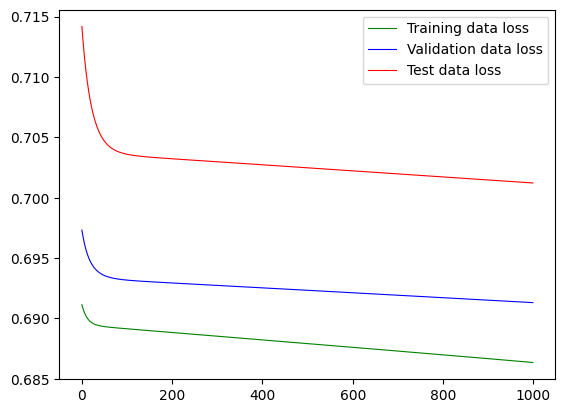

0


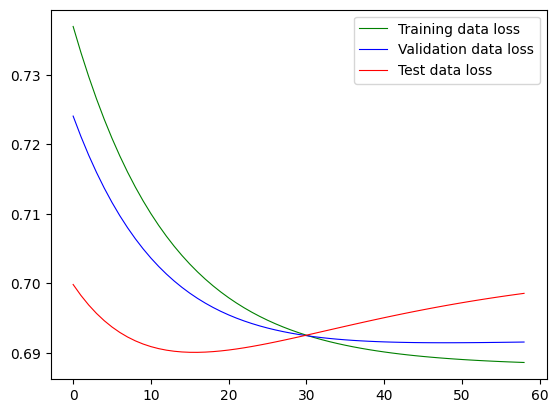

0


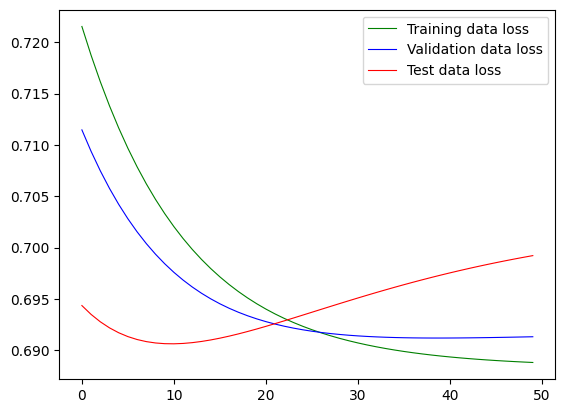

0


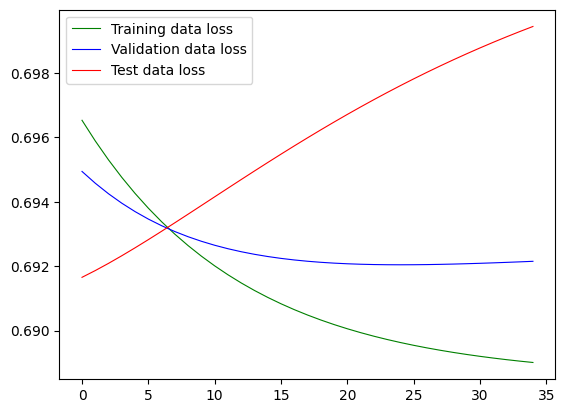

0


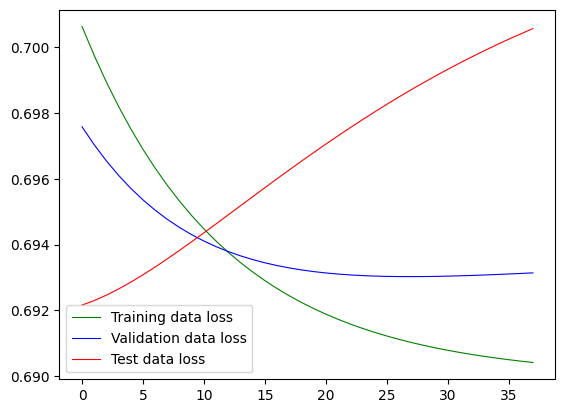

0


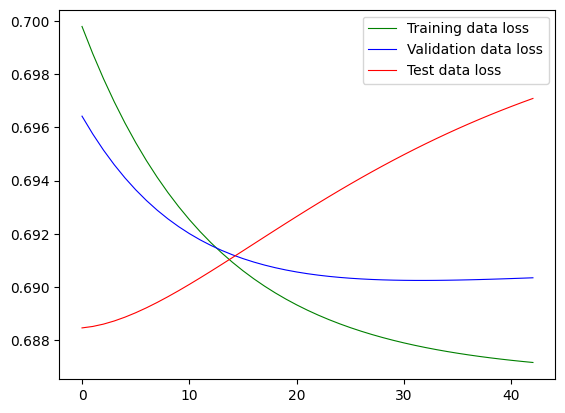

0


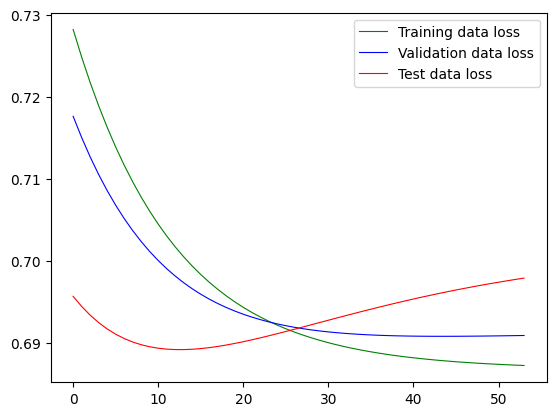

0
100
200
300
400
500
600
700
800
900


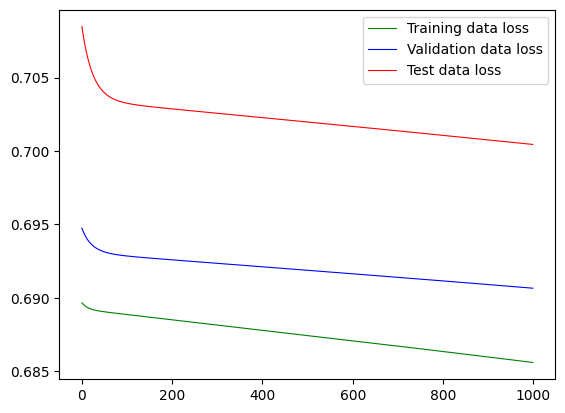

0
100
200
300
400
500
600
700
800
900


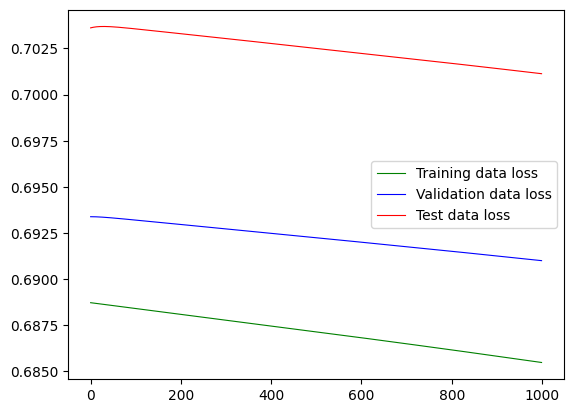

0
100
200
300
400
500
600
700
800
900


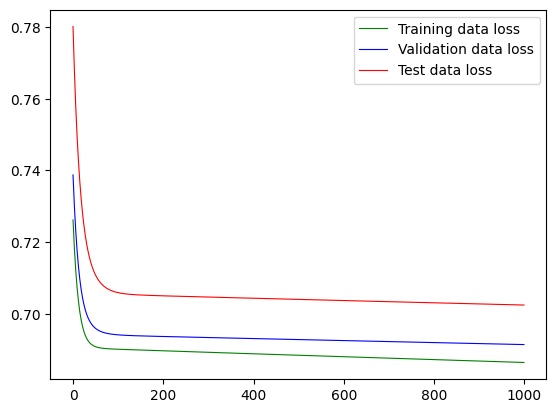

(np.float64(0.6874826312065124),
 np.float64(0.0015361939117876635),
 np.float64(0.6997976243495941),
 np.float64(0.0015786309751413315))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std_truncated(0.1)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  train_loss, test_loss, epoch
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


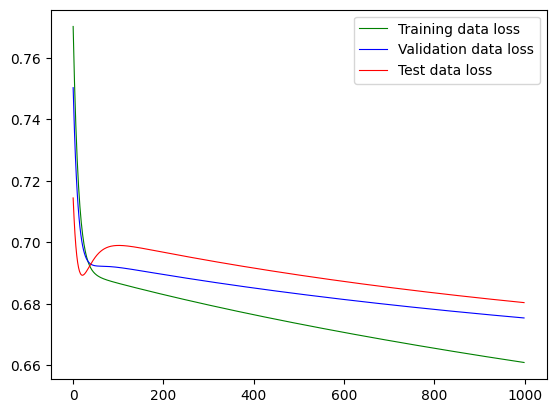

0
100
200
300
400
500
600
700
800
900


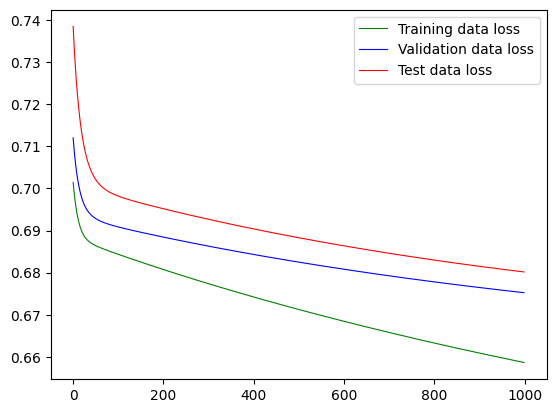

0


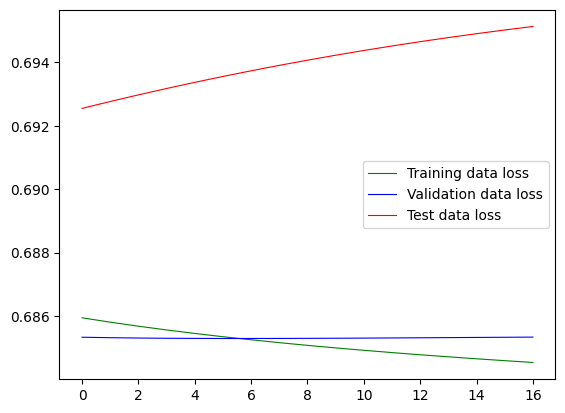

0


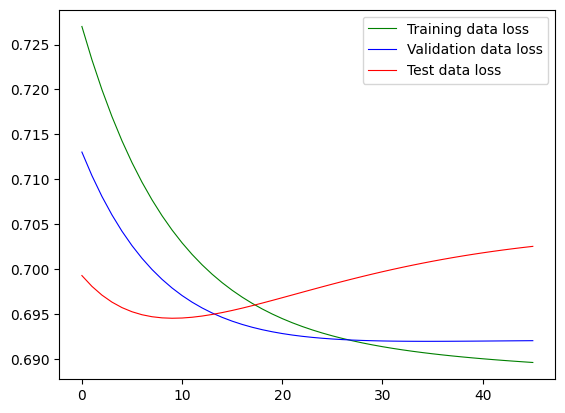

0
100
200
300
400
500
600
700
800
900


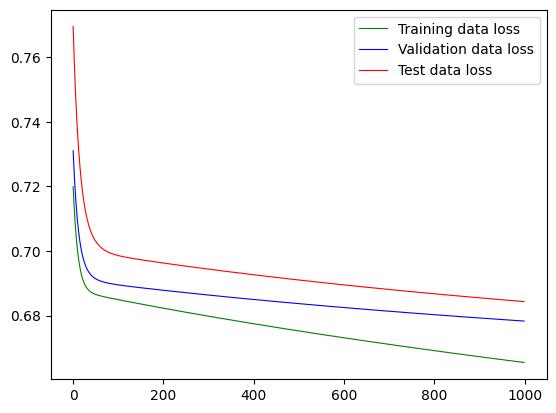

0
100
200
300
400
500
600
700
800
900


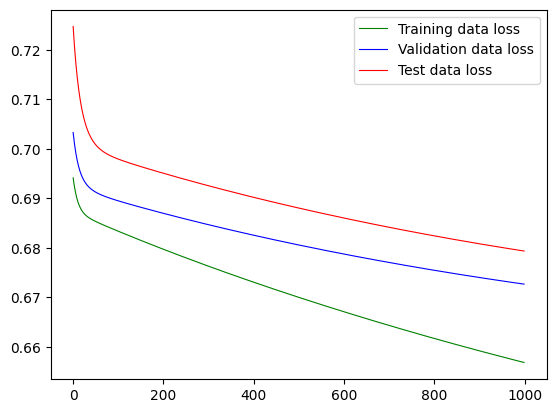

0
100
200
300
400
500
600
700
800
900


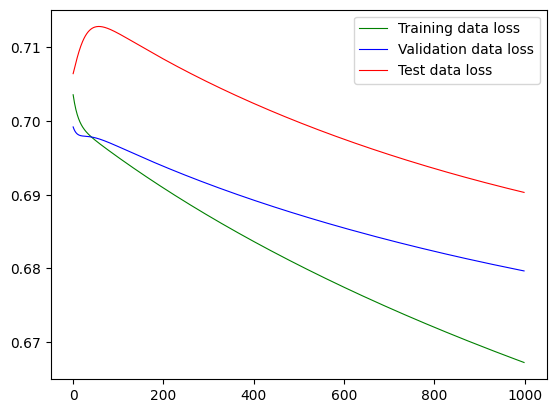

0
100
200
300
400
500
600
700
800
900


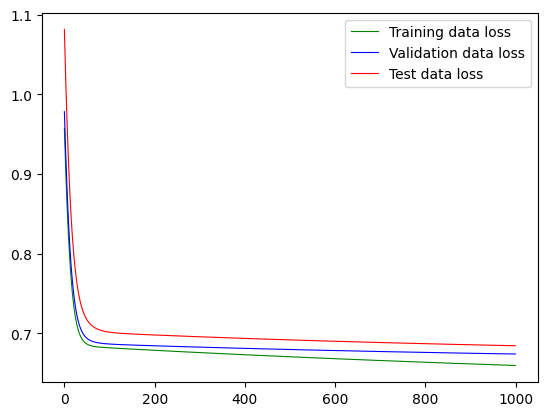

0


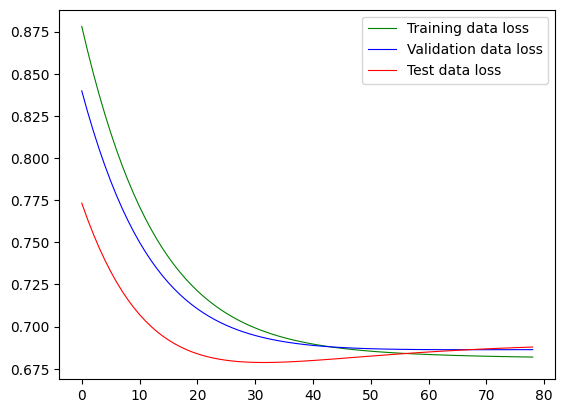

0


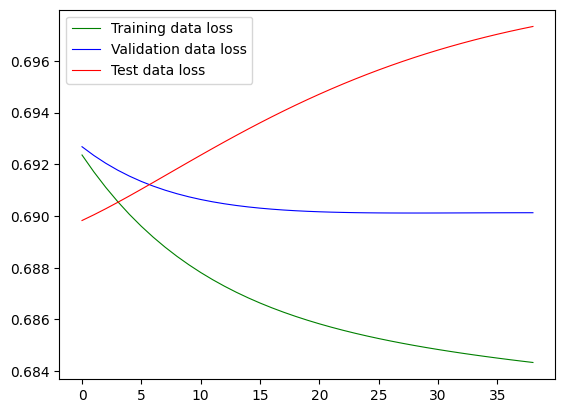

(np.float64(0.6708773672580719),
 np.float64(0.012051042923433354),
 np.float64(0.6881797969341278),
 np.float64(0.007583133903701641))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std_uniform(0.1)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  train_loss, test_loss, epoch
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


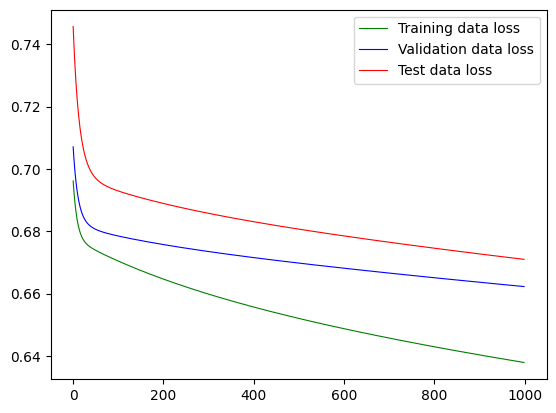

0
100
200
300
400
500
600
700
800
900


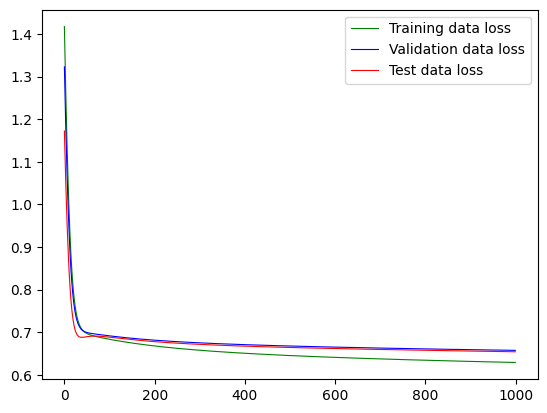

0
100
200
300
400
500
600
700
800
900


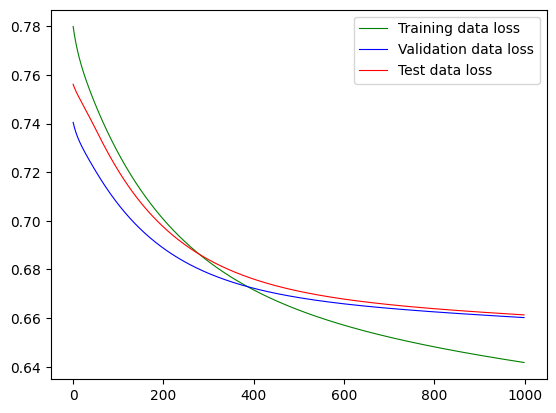

0
100
200
300
400
500
600
700
800
900


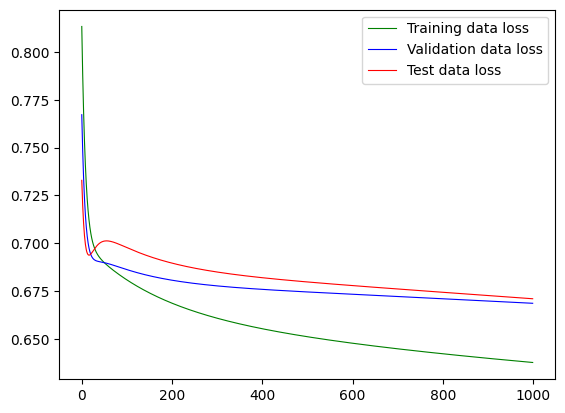

0
100
200
300
400
500
600
700
800
900


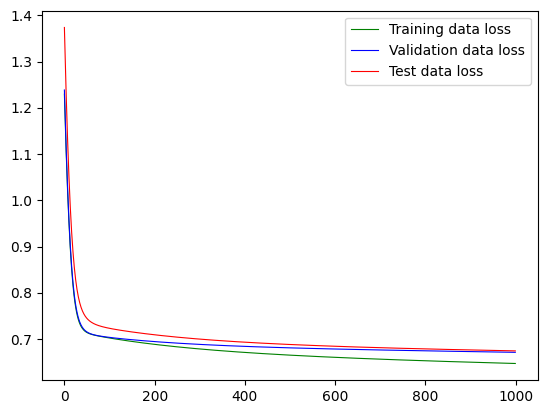

0
100
200
300
400
500
600
700
800
900


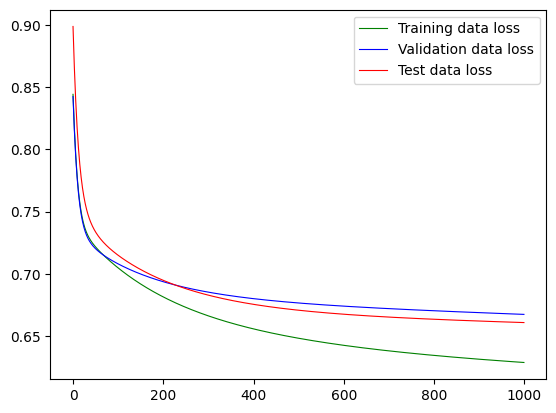

0
100
200
300
400
500
600
700
800
900


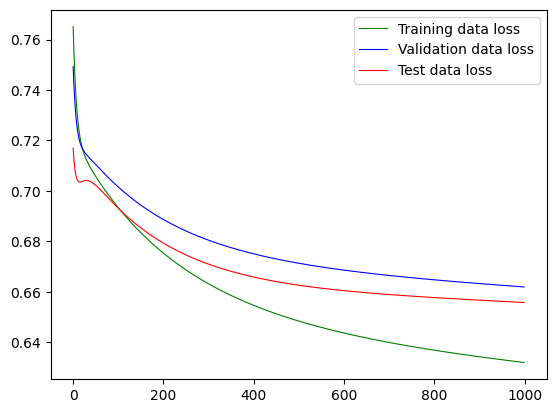

0
100
200
300
400
500
600
700
800
900


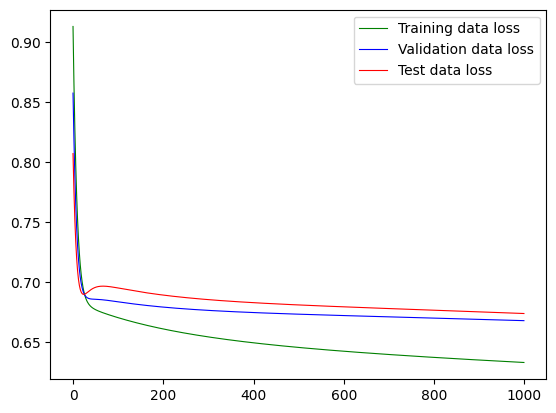

0
100
200
300
400
500
600
700
800
900


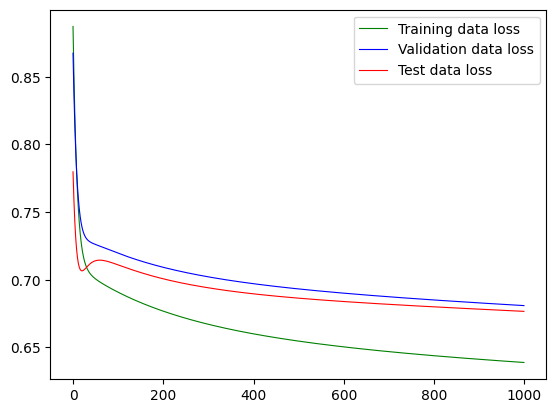

0
100
200
300
400
500
600
700
800
900


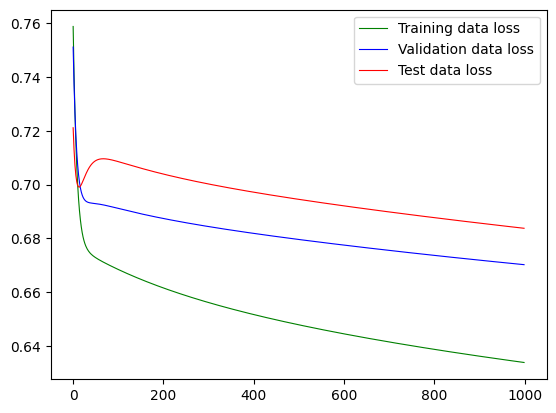

(np.float64(0.6359718859195709),
 np.float64(0.005492016902748284),
 np.float64(0.6682508945465088),
 np.float64(0.009214817293518394))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std(0.34)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


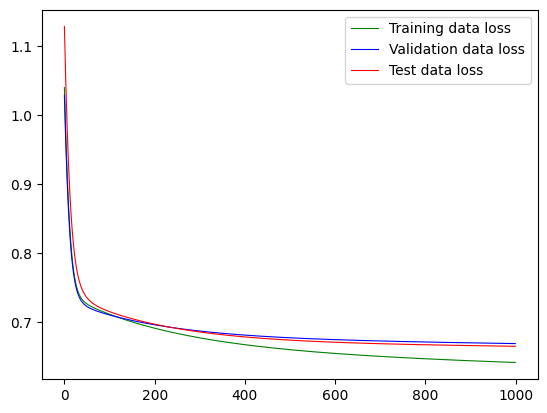

0
100
200
300
400
500
600
700
800
900


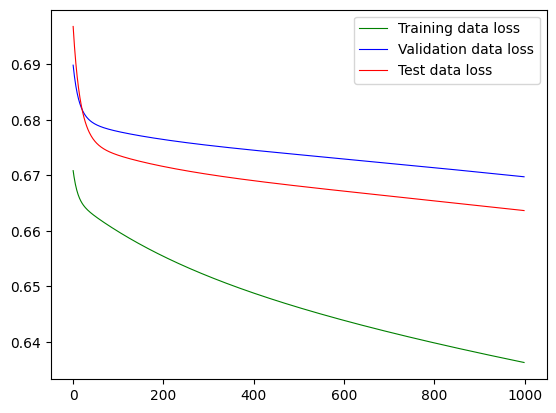

0
100
200
300
400
500
600
700
800
900


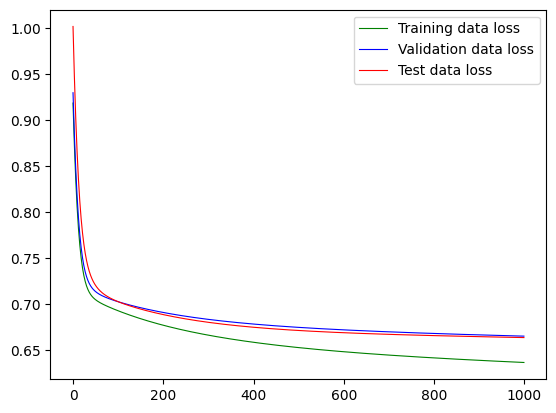

0
100
200
300
400
500
600
700
800
900


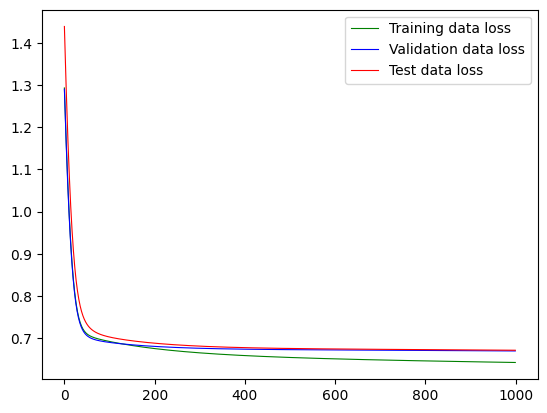

0
100
200
300
400
500
600
700
800
900


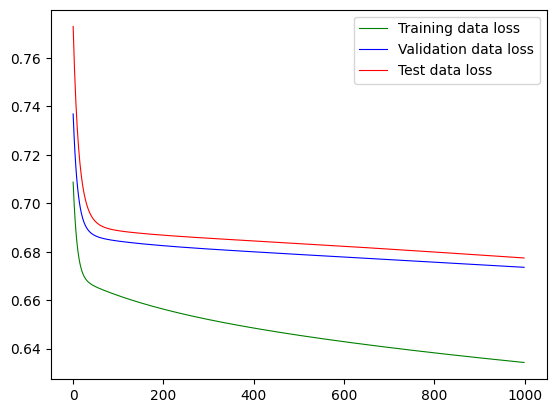

0
100
200
300
400
500
600
700
800
900


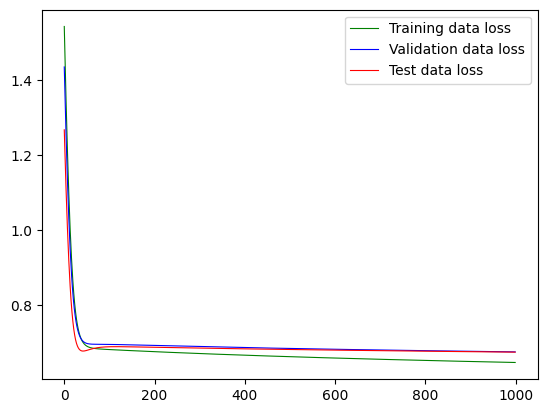

0
100
200
300
400
500
600
700
800
900


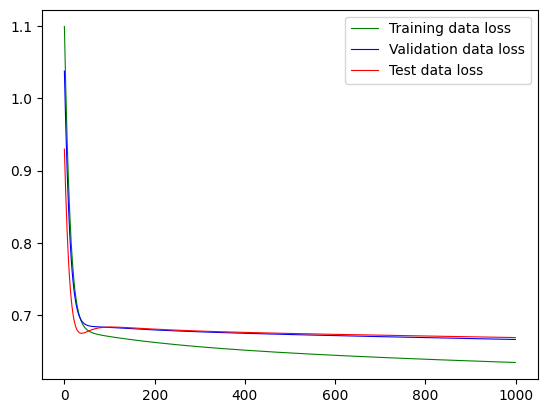

0
100
200
300
400
500
600
700
800
900


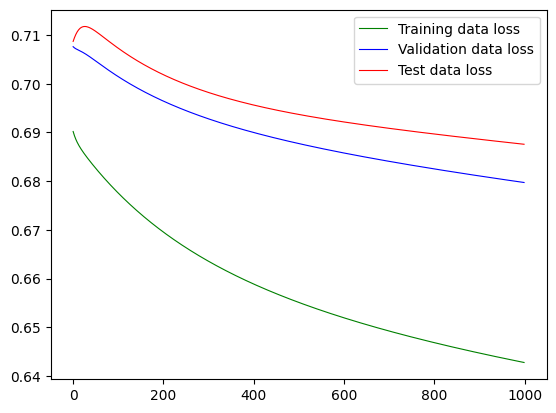

0
100
200
300
400
500
600
700
800
900


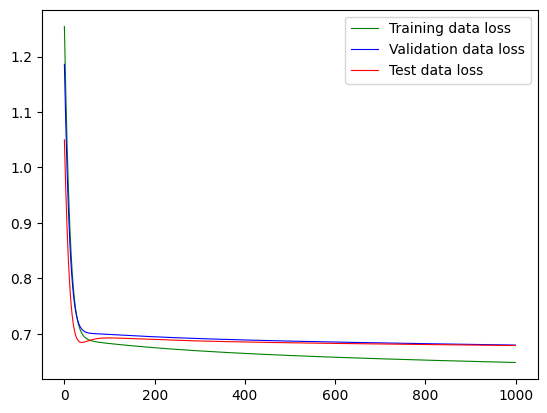

0
100
200
300
400
500
600
700
800
900


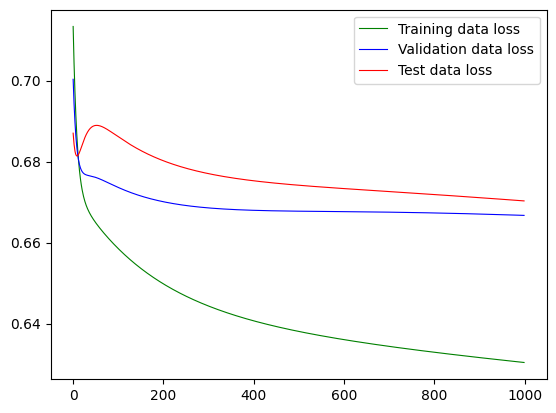

(np.float64(0.6393296539783477),
 np.float64(0.005492604665448315),
 np.float64(0.6720726907253265),
 np.float64(0.007240990624245587))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std_truncated(0.34)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


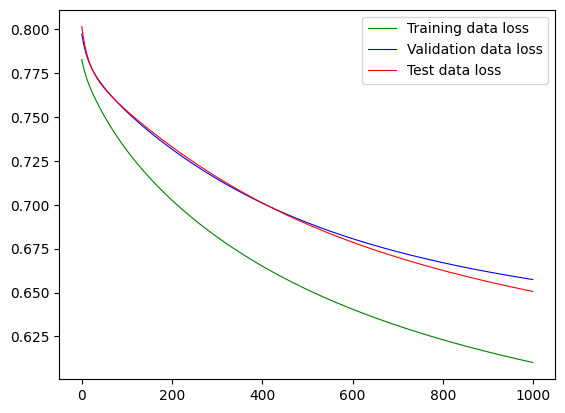

0
100
200
300
400
500
600
700
800
900


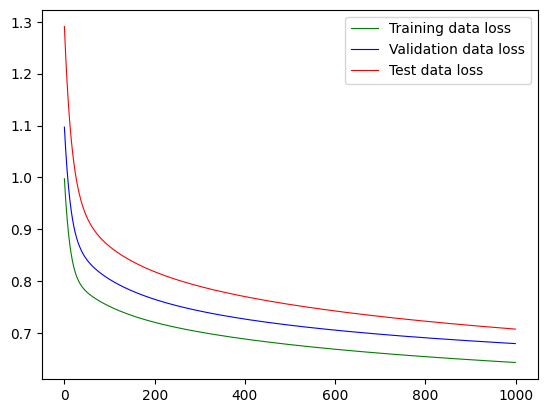

0
100
200
300
400
500
600
700
800
900


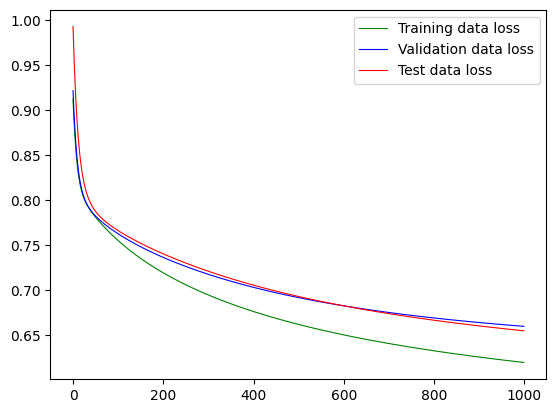

0
100
200
300
400
500
600
700
800
900


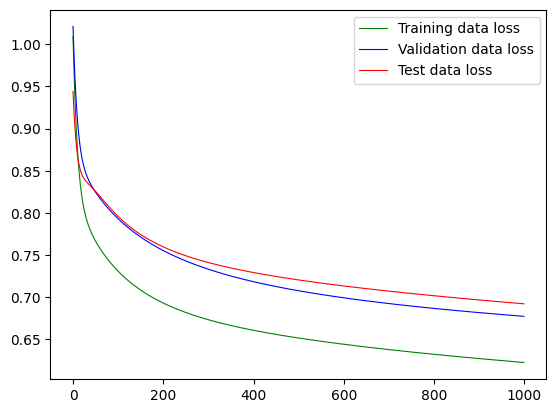

0
100
200
300
400
500
600
700
800
900


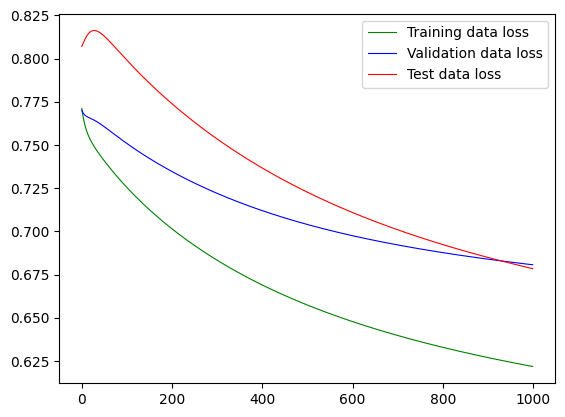

0
100
200
300
400
500
600
700
800
900


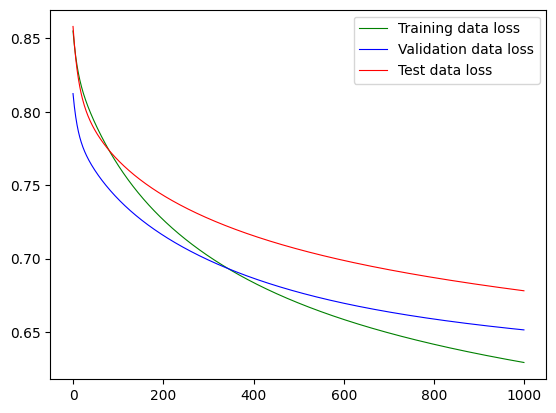

0
100
200
300
400
500
600
700
800
900


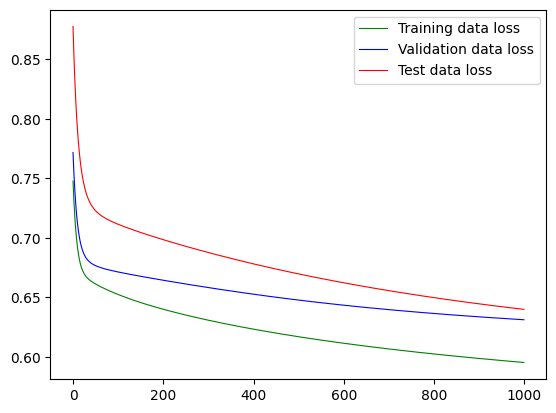

0
100
200
300
400
500
600
700
800
900


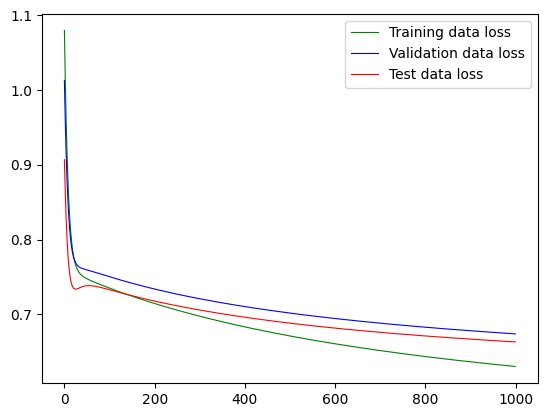

0
100
200
300
400
500
600
700
800
900


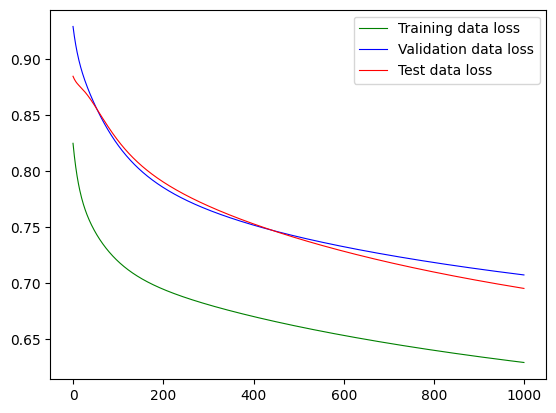

0
100
200
300
400
500
600
700
800
900


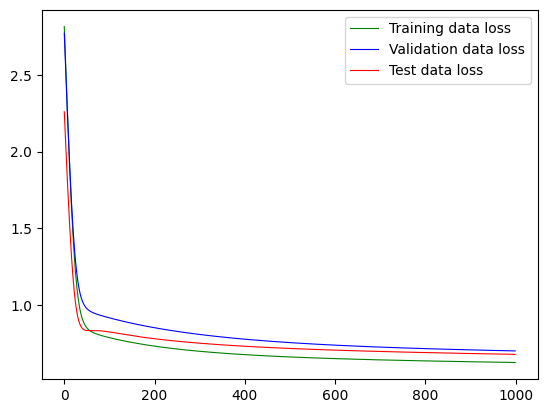

(np.float64(0.6224859416484833),
 np.float64(0.012130407700741374),
 np.float64(0.6737103641033173),
 np.float64(0.020357496449933683))

In [ ]:

trl = []
tel = []
for i in range (10):
  model = Deep_std_uniform(0.34)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


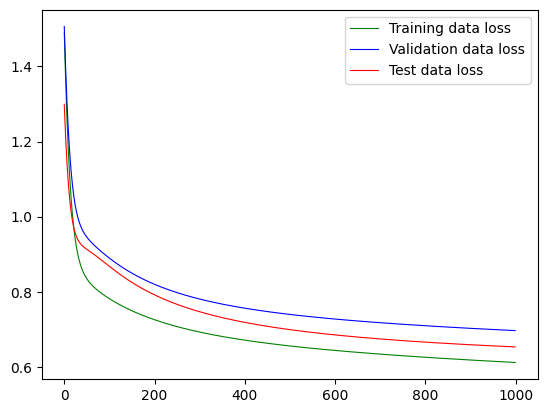

0
100
200
300
400
500
600
700
800
900


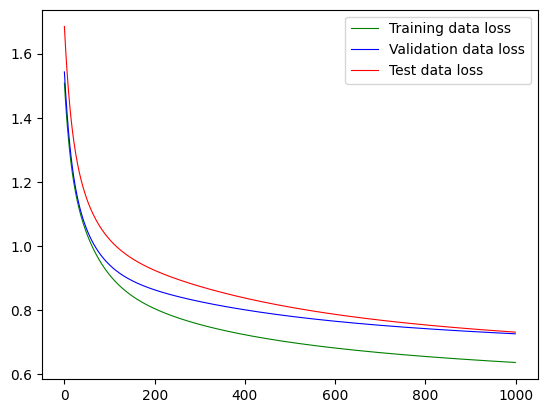

0
100
200
300
400
500
600
700
800
900


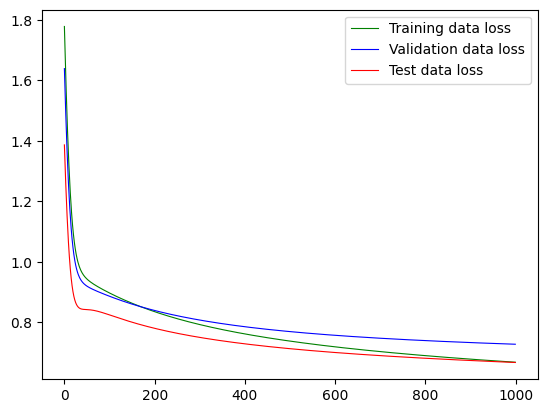

0
100
200
300
400
500
600
700
800
900


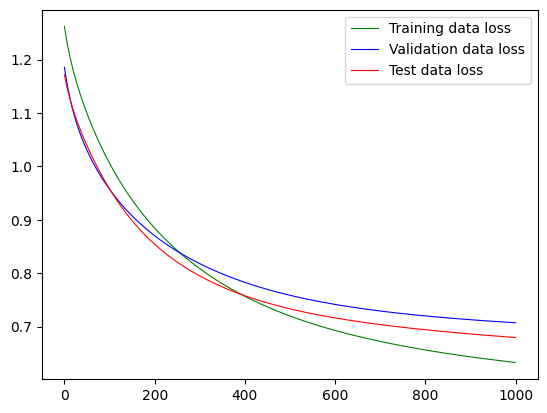

0
100
200
300
400
500
600
700
800
900


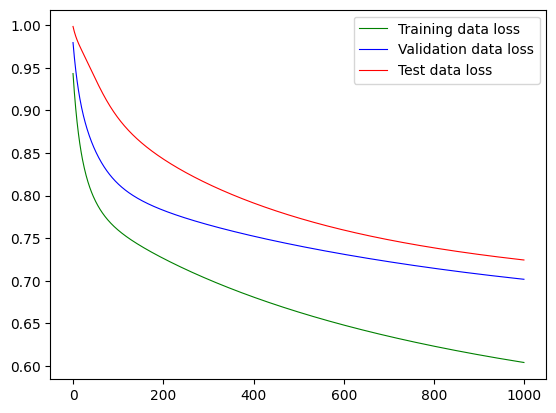

0
100
200
300
400
500
600
700
800
900


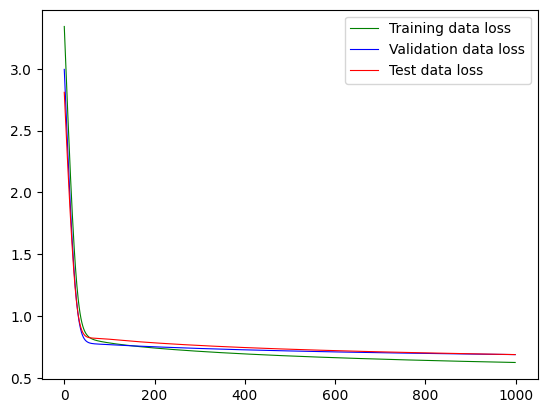

0
100
200
300
400
500
600
700
800
900


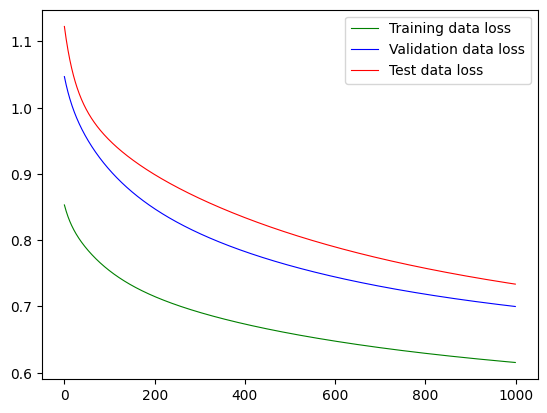

0
100
200
300
400
500
600
700
800
900


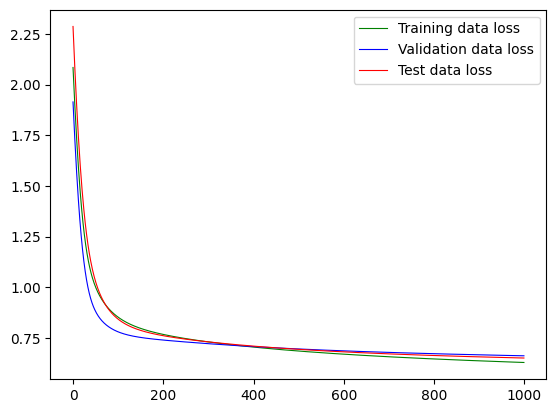

0
100
200
300
400
500
600
700
800
900


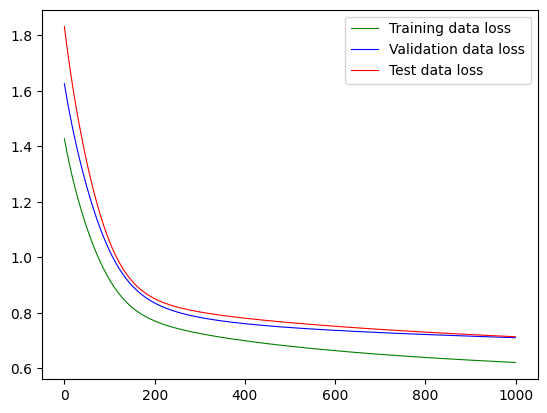

0
100
200
300
400
500
600
700
800
900


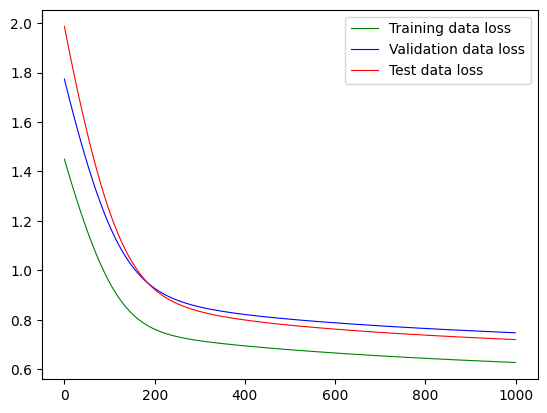

(np.float64(0.6269277453422546),
 np.float64(0.01643677237930745),
 np.float64(0.6961759865283966),
 np.float64(0.03076145628708926))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std(1)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


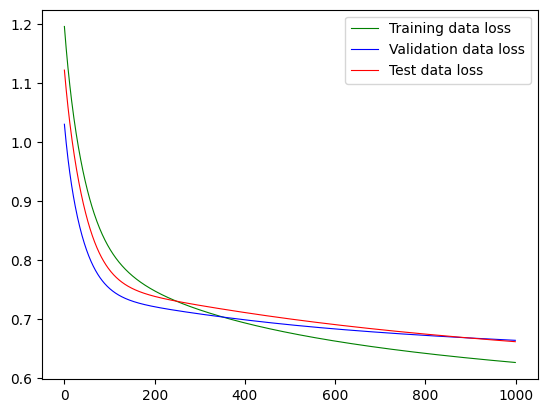

0
100
200
300
400
500
600
700
800
900


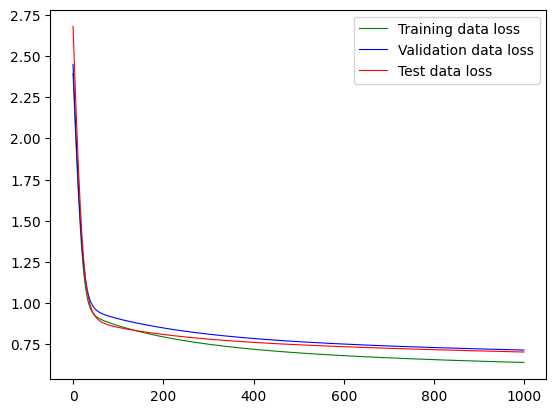

0
100
200
300
400
500
600
700
800
900


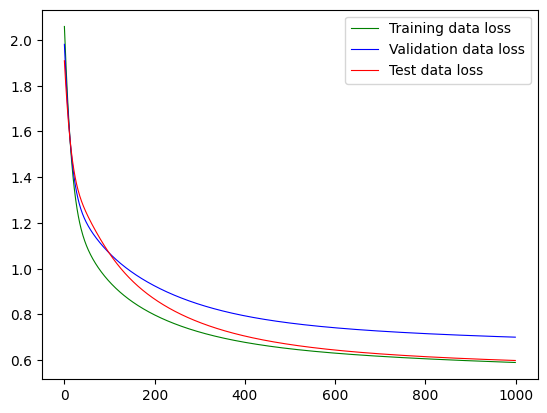

0
100
200
300
400
500
600
700
800
900


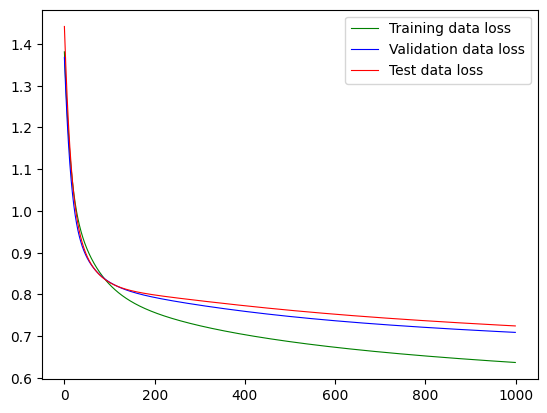

0
100
200
300
400
500
600
700
800
900


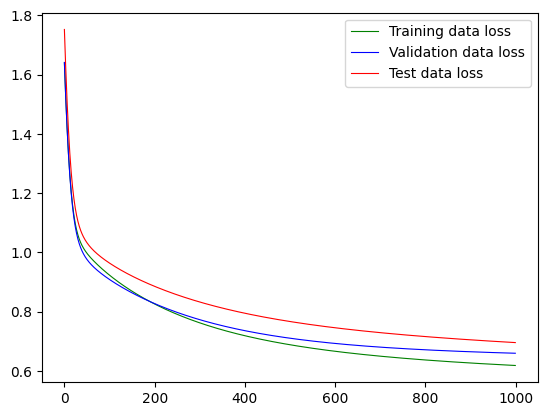

0
100
200
300
400
500
600
700
800
900


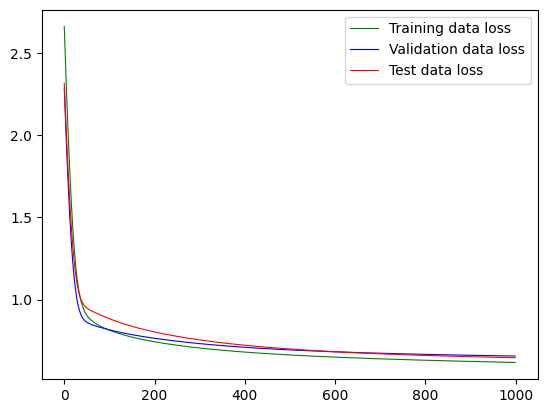

0
100
200
300
400
500
600
700
800
900


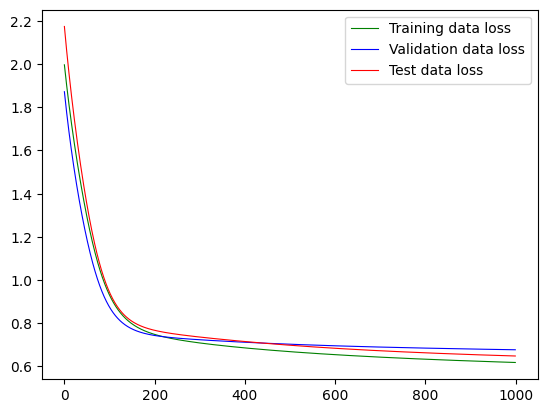

0
100
200
300
400
500
600
700
800
900


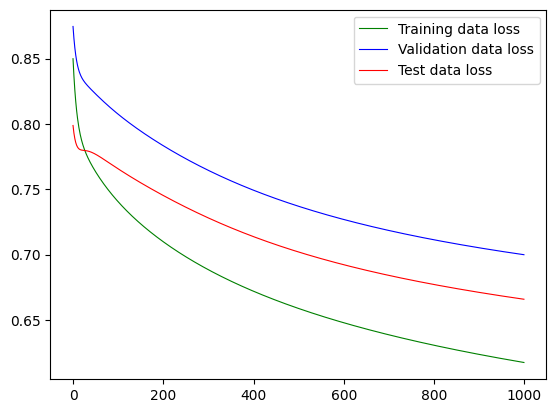

0
100
200
300
400
500
600
700
800
900


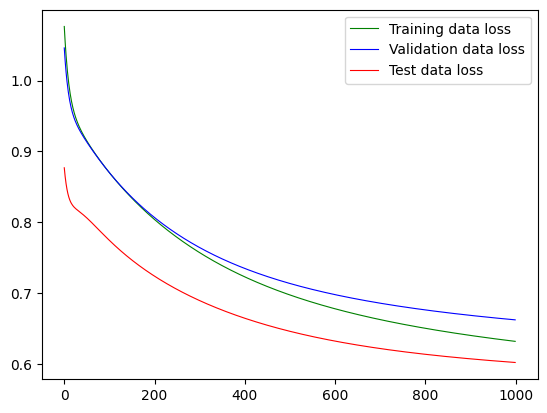

0
100
200
300
400
500
600
700
800
900


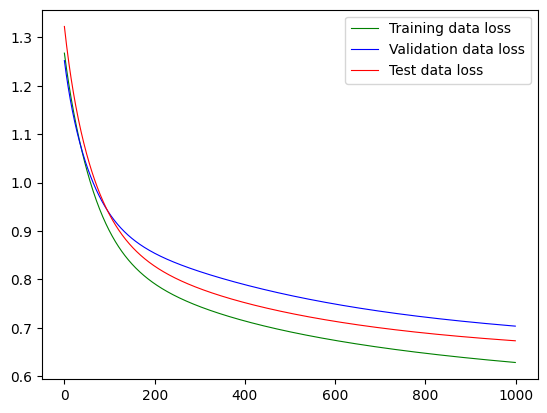

(np.float64(0.6222460389137268),
 np.float64(0.013152383042197353),
 np.float64(0.661771434545517),
 np.float64(0.03844660677044851))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std_truncated(1)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  train_loss, test_loss, epoch
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


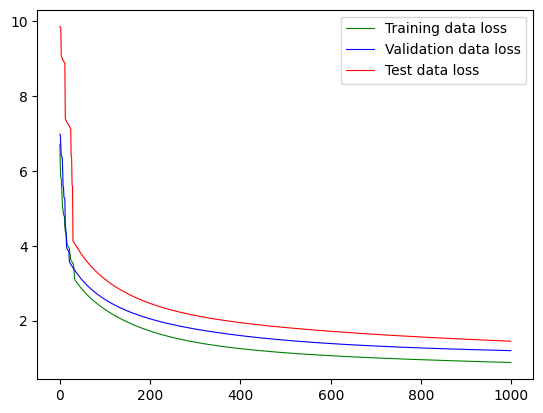

0
100
200
300
400
500
600
700
800
900


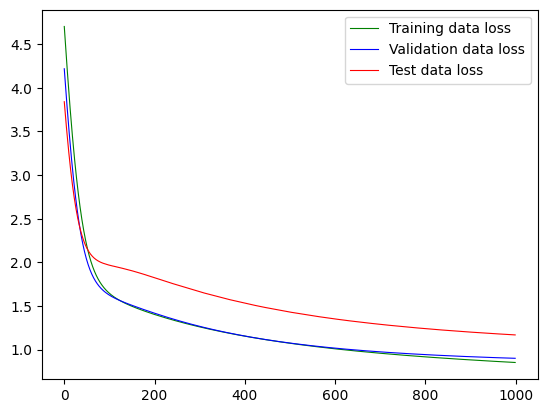

0
100
200
300
400
500
600
700
800
900


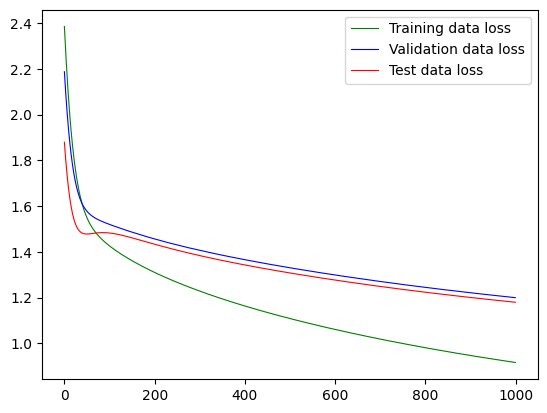

0
100
200
300
400
500
600
700
800
900


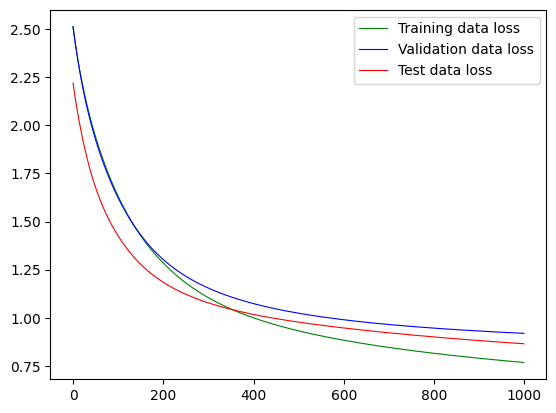

0
100
200
300
400
500
600
700
800
900


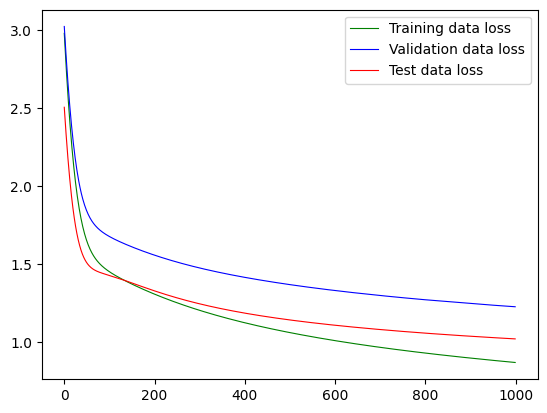

0
100
200
300
400
500
600
700
800
900


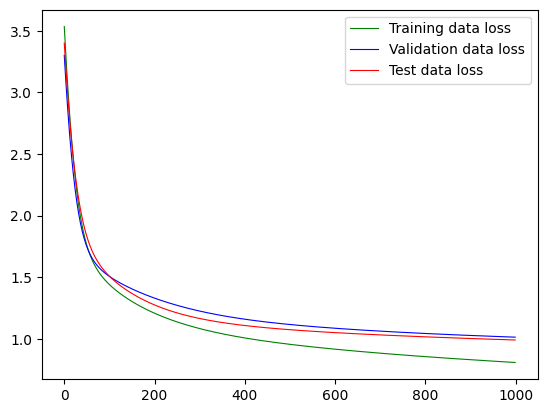

0
100
200
300
400
500
600
700
800
900


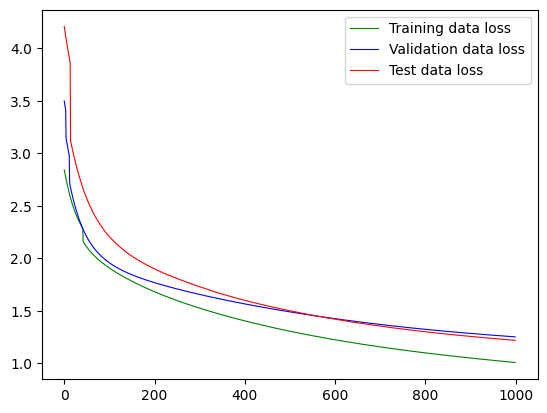

0
100
200
300
400
500
600
700
800
900


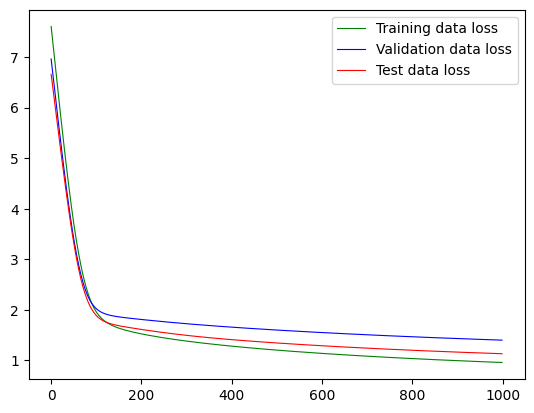

0
100
200
300
400
500
600
700
800
900


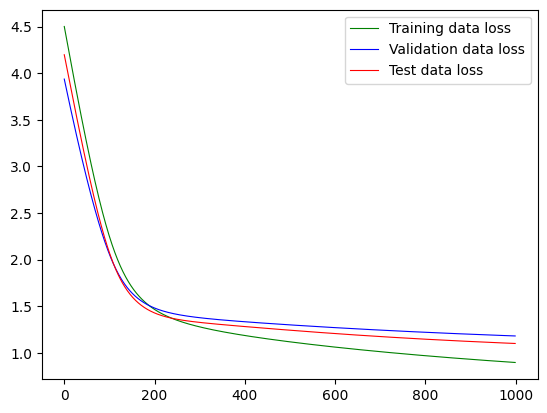

0
100
200
300
400
500
600
700
800
900


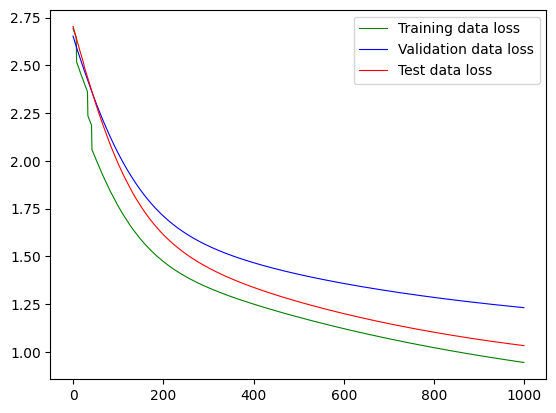

(np.float64(0.8895862936973572),
 np.float64(0.06794078933375812),
 np.float64(1.115343600511551),
 np.float64(0.1495054166470351))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std_uniform(1)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

In [ ]:

import copy
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import tqdm

def model_train_monte_carlo(model, X, y, optimizer, batch_size = len(X_train)):
    weights1_dynamic = []
    weights2_dynamic = []
    weights3_dynamic = []
    for i in range (6):
                  weights1_dynamic.append([])
                  weights2_dynamic.append([])
                  weights3_dynamic.append([])
    loss_graph = []
    val_loss_graph = []
    test_loss_graph = []
    classification_error_graph = []
    val_classification_error_graph = []
    test_classification_error_graph = []
    stop_criterion = 0

    # loss function and optimizer
    loss_fn = nn.BCELoss()  # binary cross entropy
    #optimizer = optim.Adam(model.parameters(), lr=lr)

    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1)
    X_train = torch.tensor(X_train.values, dtype=torch.float32)
    y_train = torch.tensor(y_train.values, dtype=torch.float32)
    X_val = torch.tensor(X_val.values, dtype=torch.float32)
    y_val = torch.tensor(y_val.values, dtype=torch.float32)

    n_epochs = 1000   # number of epochs to run
    #batch_size = len(X_train)  # size of each batch
    batch_start = torch.arange(0, len(X_train), batch_size)

    for epoch in range(n_epochs):
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1)
        X_train = torch.tensor(X_train.values, dtype=torch.float32)
        y_train = torch.tensor(y_train.values, dtype=torch.float32)
        X_val = torch.tensor(X_val.values, dtype=torch.float32)
        y_val = torch.tensor(y_val.values, dtype=torch.float32)
        model.train()
        with tqdm.tqdm(batch_start, unit="batch", mininterval=0, disable=True) as bar:
            bar.set_description(f"Epoch {epoch}")
            for start in bar:
                # take a batch
                X_batch = X_train[start:start+batch_size]
                y_batch = y_train[start:start+batch_size]
                # forward pass
                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)
                loss_graph.append(loss.detach().numpy())
                # backward pass
                optimizer.zero_grad()
                loss.backward()
                # update weights
                optimizer.step()
                model.eval()

                y_pred = model(X_test)
                acc = (y_pred.round() == y_test).float().mean()
                y_pred = model(X_val)
                acc = (y_pred.round() == y_val).float().mean()
                val_loss = loss_fn(y_pred, y_val)
                val_loss_graph.append(val_loss.detach().numpy())

                val_classification_error_graph.append(float(acc))

                if len(val_loss_graph)>1:
                  if val_loss_graph[-1] > val_loss_graph[-2]:
                    stop_criterion += 1
                  if stop_criterion >= 10:
                    break

        acc = float(acc)
        if epoch % 100 == 0:
          print (epoch)
        if stop_criterion >= 10:
                    break
    plt.plot(loss_graph, 'g', label='Training data loss', linewidth=0.8)
    plt.plot(val_loss_graph, 'b', label='Test data loss', linewidth=0.8)
    plt.legend()
    plt.show()

    y_pred = model(X_val)
    acc = (y_pred.round() == y_val).float().mean()
    test_loss = loss_fn(y_pred, y_val).detach().item()

    y_pred = model(X_train)
    train_loss = loss_fn(y_pred, y_train).detach().item()

    return train_loss, test_loss, epoch

In [ ]:
model_init = Deep_std_uniform(0.34)

0


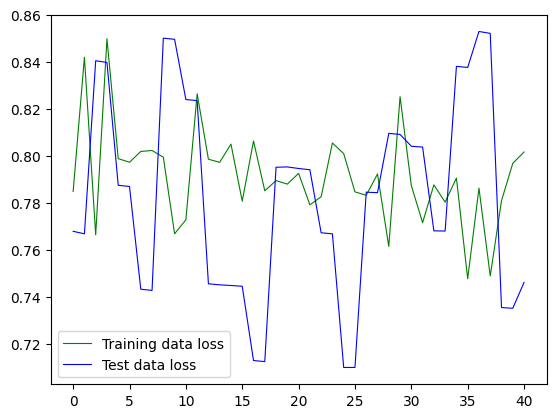

0


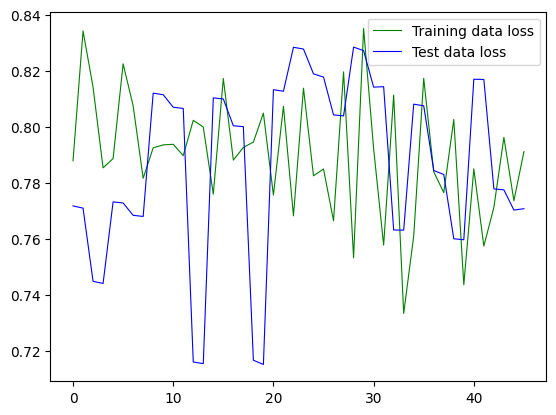

0


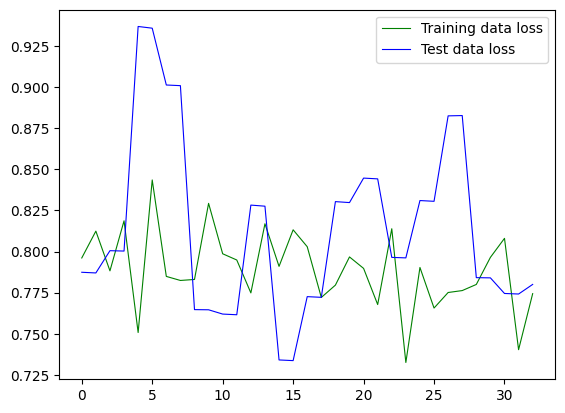

0


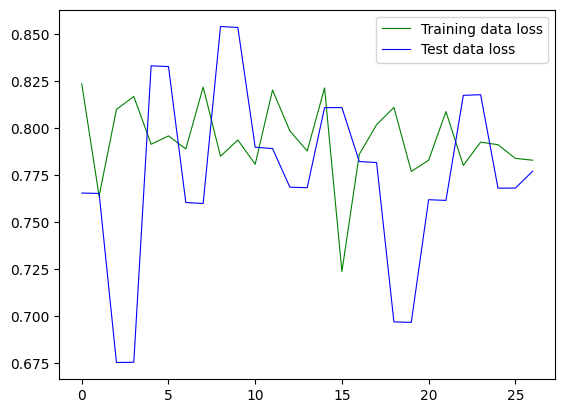

0


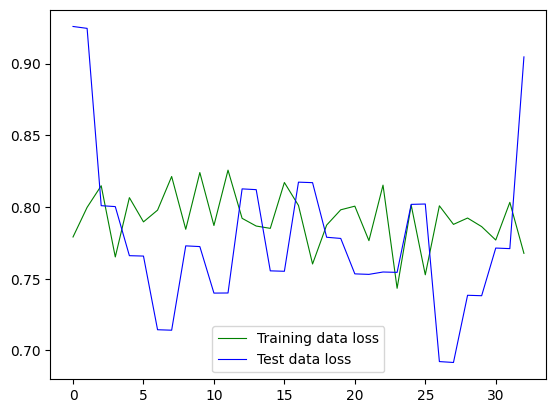

0


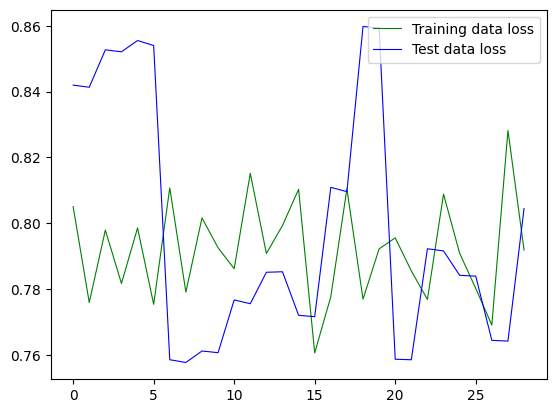

0


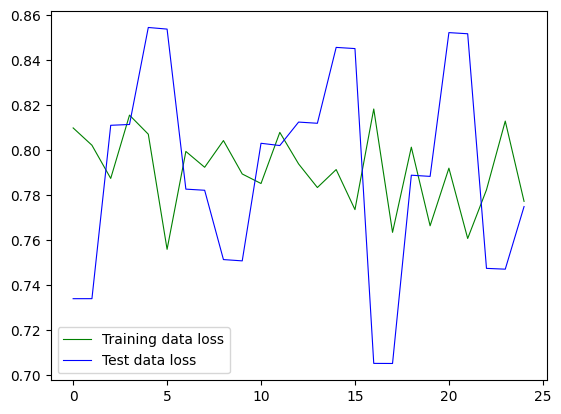

0


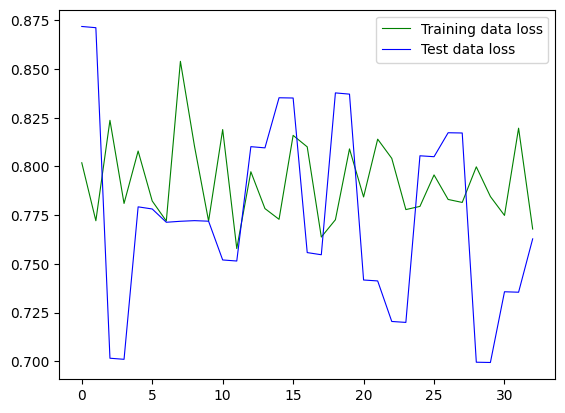

0


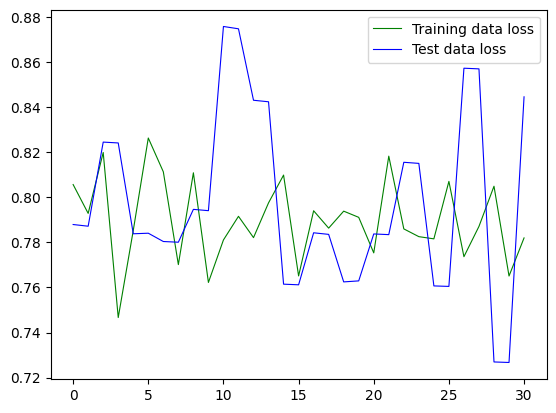

0


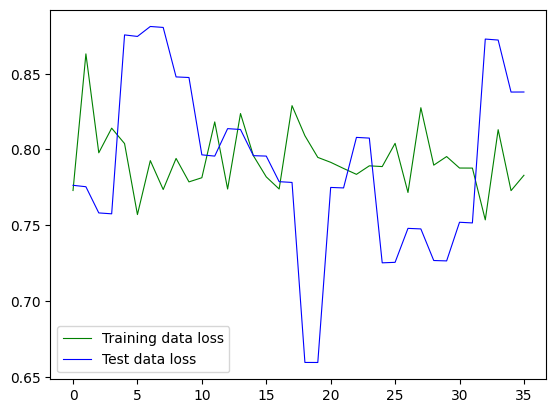

(np.float64(0.7811395406723023),
 np.float64(0.005487088810538782),
 np.float64(0.800361692905426),
 np.float64(0.04591043552191219))

In [ ]:

trl = []
tel = []
for i in range (10):
  model = copy.deepcopy(model_init)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train_monte_carlo(model, X, y, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

In [ ]:
skf = StratifiedKFold(n_splits=10, shuffle=True)
StratifiedKFold(n_splits=10, random_state=None, shuffle=True)
for train_index, test_index in skf.split(X, y):
  X_train, X_val = X.to_numpy()[train_index], X.to_numpy()[test_index]
  y_train, y_val = y.to_numpy()[train_index], y.to_numpy()[test_index]

StratifiedKFold(n_splits=10, random_state=None, shuffle=True)


In [ ]:

import copy
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import tqdm
from sklearn.model_selection import StratifiedKFold

def model_train_10_fold(model, X, y, optimizer, batch_size = len(X_train), nfolds = 10):
    weights1_dynamic = []
    weights2_dynamic = []
    weights3_dynamic = []
    for i in range (6):
                  weights1_dynamic.append([])
                  weights2_dynamic.append([])
                  weights3_dynamic.append([])
    loss_graph = []
    val_loss_graph = []
    test_loss_graph = []
    classification_error_graph = []
    val_classification_error_graph = []
    test_classification_error_graph = []
    stop_criterion = 0

    # loss function and optimizer
    loss_fn = nn.BCELoss()  # binary cross entropy
    #optimizer = optim.Adam(model.parameters(), lr=lr)
    skf = StratifiedKFold(n_splits=nfolds, shuffle=True)
    StratifiedKFold(n_splits=nfolds, random_state=1, shuffle=True)
    for train_index, test_index in skf.split(X, y):
      X_train, X_val = X.to_numpy()[train_index], X.to_numpy()[test_index]
      y_train, y_val = y.to_numpy()[train_index], y.to_numpy()[test_index]
      X_train = torch.tensor(X_train, dtype=torch.float32)
      y_train = torch.tensor(y_train, dtype=torch.float32)
      X_val = torch.tensor(X_val, dtype=torch.float32)
      y_val = torch.tensor(y_val, dtype=torch.float32)

    n_epochs = 100   # number of epochs to run
    #batch_size = len(X_train)  # size of each batch
    batch_start = torch.arange(0, len(X_train), batch_size)

    for epoch in range(n_epochs):
      if stop_criterion >= 10:
                    break
      for train_index, test_index in skf.split(X, y):
        X_train, X_val = X.to_numpy()[train_index], X.to_numpy()[test_index]
        y_train, y_val = y.to_numpy()[train_index], y.to_numpy()[test_index]
        X_train = torch.tensor(X_train, dtype=torch.float32)
        y_train = torch.tensor(y_train, dtype=torch.float32)
        X_val = torch.tensor(X_val, dtype=torch.float32)
        y_val = torch.tensor(y_val, dtype=torch.float32)
        model.train()
        with tqdm.tqdm(batch_start, unit="batch", mininterval=0, disable=True) as bar:
            bar.set_description(f"Epoch {epoch}")
            for start in bar:
                if stop_criterion >= 10:
                    break
                # take a batch
                X_batch = X_train[start:start+batch_size]
                y_batch = y_train[start:start+batch_size]
                # forward pass
                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)
                loss_graph.append(loss.detach().numpy())
                # backward pass
                optimizer.zero_grad()
                loss.backward()
                # update weights
                optimizer.step()
                model.eval()

                y_pred = model(X_test)
                acc = (y_pred.round() == y_test).float().mean()
                y_pred = model(X_val)
                acc = (y_pred.round() == y_val).float().mean()
                val_loss = loss_fn(y_pred, y_val)
                val_loss_graph.append(val_loss.detach().numpy())

                val_classification_error_graph.append(float(acc))

                if len(val_loss_graph)>1:
                  if val_loss_graph[-1] > val_loss_graph[-2]:
                    stop_criterion += 1
                  if stop_criterion >= 10:
                    break

        acc = float(acc)
        if epoch % 100 == 0:
          print (epoch)
        if stop_criterion >= 10:
                    break
    plt.plot(loss_graph, 'g', label='Training data loss', linewidth=0.8)
    plt.plot(val_loss_graph, 'b', label='Test data loss', linewidth=0.8)
    plt.legend()
    plt.show()

    y_pred = model(X_val)
    acc = (y_pred.round() == y_val).float().mean()
    test_loss = loss_fn(y_pred, y_val).detach().item()

    y_pred = model(X_train)
    train_loss = loss_fn(y_pred, y_train).detach().item()

    return train_loss, test_loss, epoch

0
0
0
0
0
0
0
0
0
0


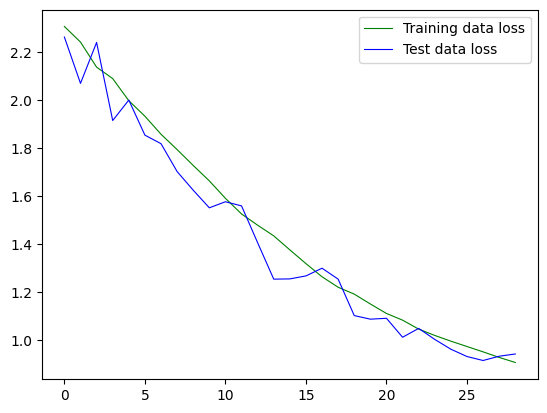

0
0
0
0
0
0
0
0
0
0


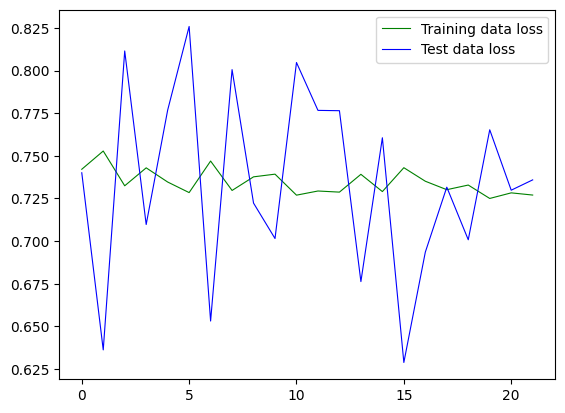

0
0
0
0
0
0
0
0
0
0


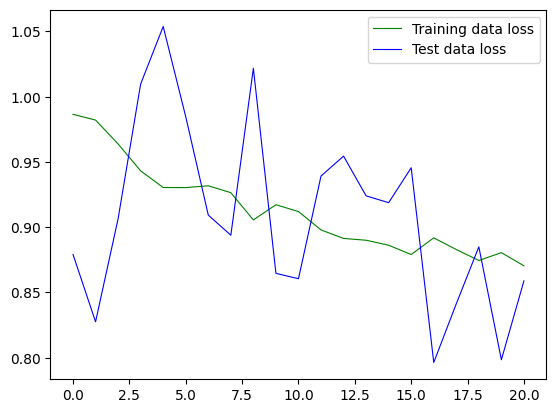

0
0
0
0
0
0
0
0
0
0


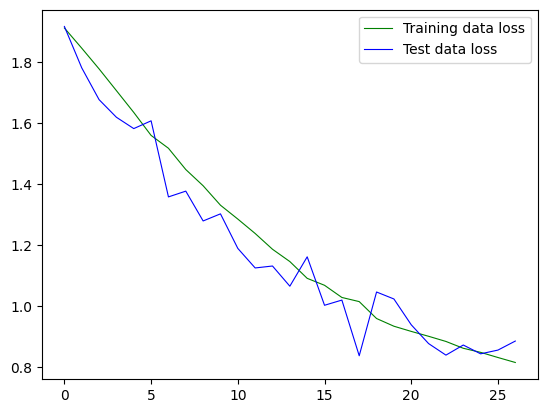

0
0
0
0
0
0
0
0
0
0


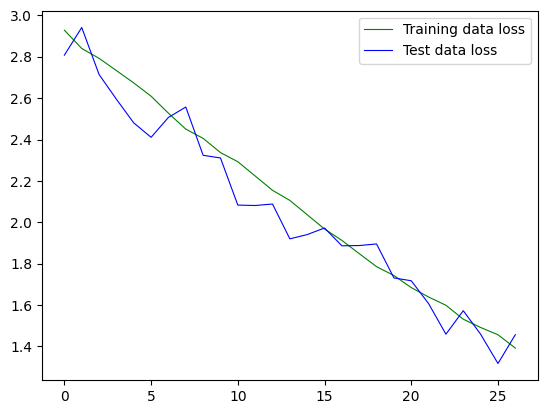

0
0
0
0
0
0
0
0
0
0


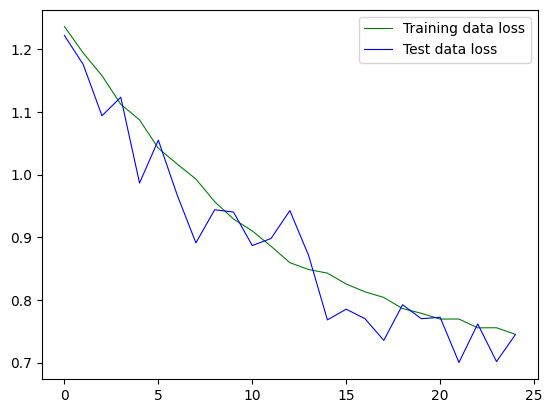

0
0
0
0
0
0
0
0
0
0


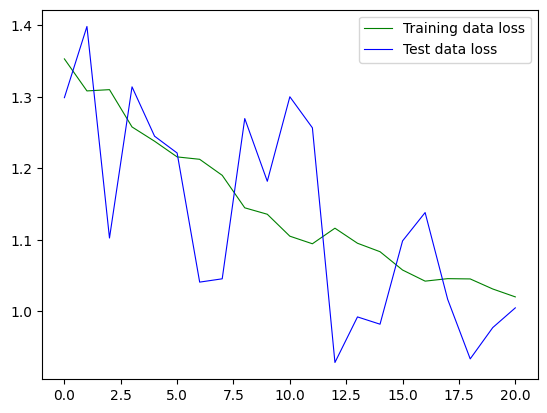

0
0
0
0
0
0
0
0
0
0


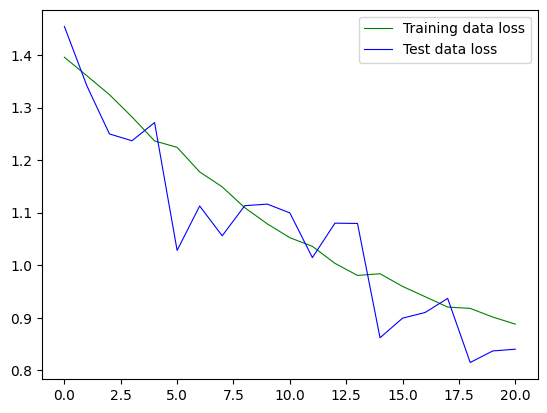

0
0
0
0
0
0
0
0
0
0


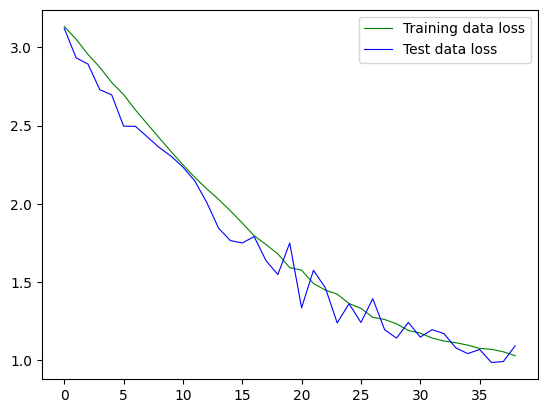

0
0
0
0
0
0
0
0
0
0


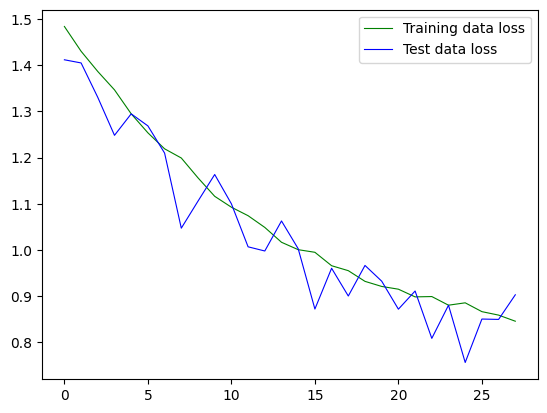

(np.float64(0.912941700220108),
 np.float64(0.17244947497538113),
 np.float64(0.9464931666851044),
 np.float64(0.198638243876278))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std_uniform(0.34)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train_10_fold(model, X, y, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300


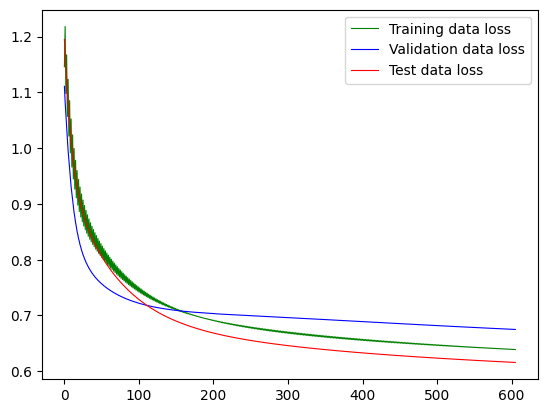

0
100
200


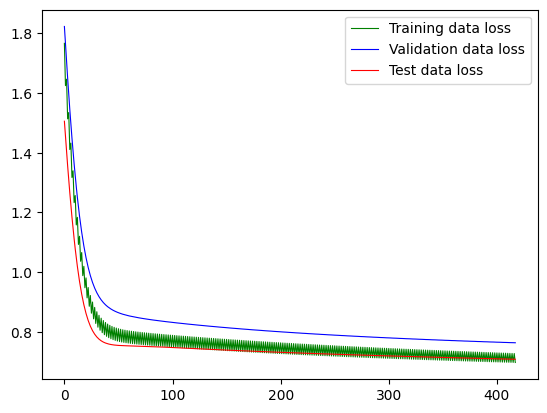

0
100
200
300


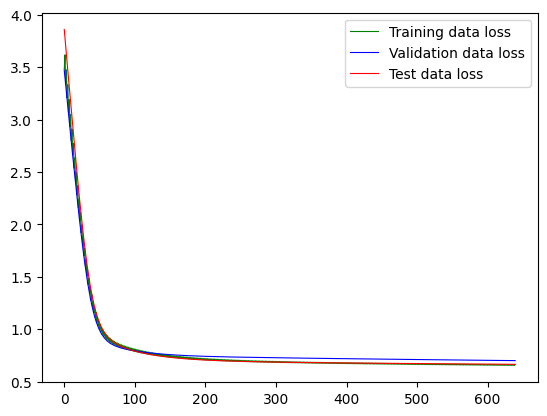

0


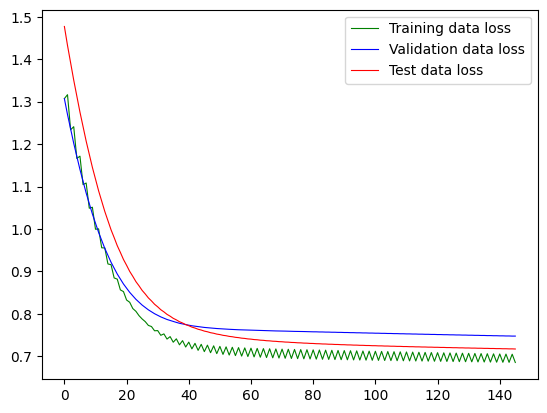

0


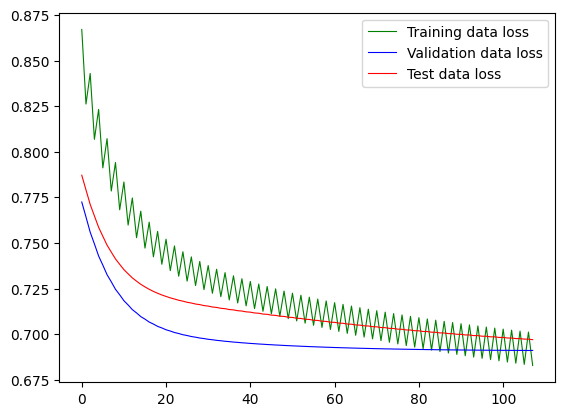

0


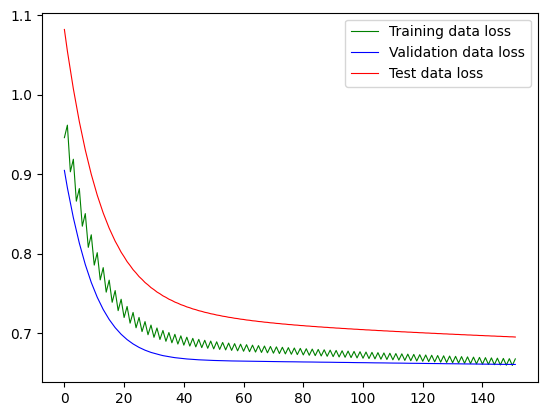

0
100


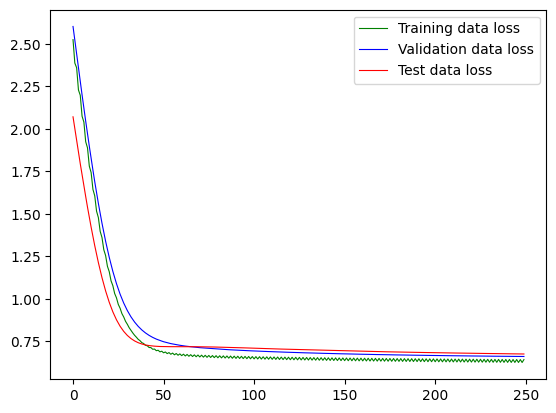

0


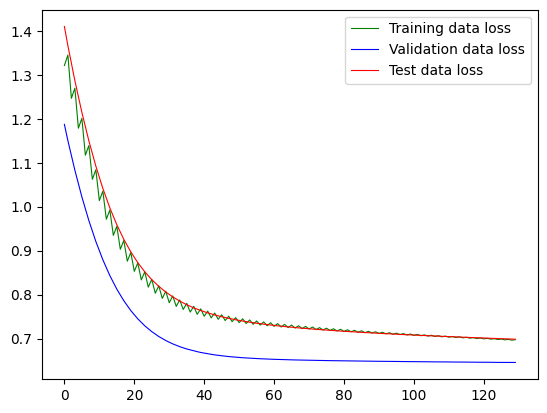

0
100


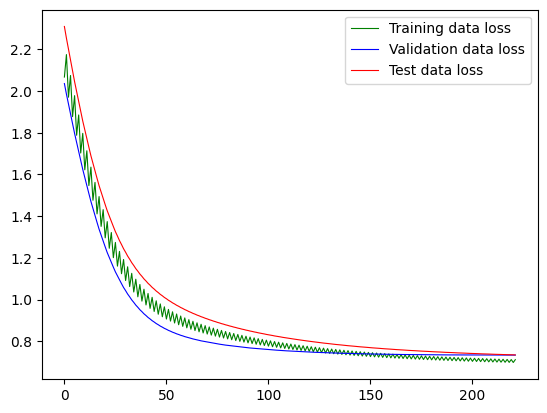

0
100
200
300
400
500


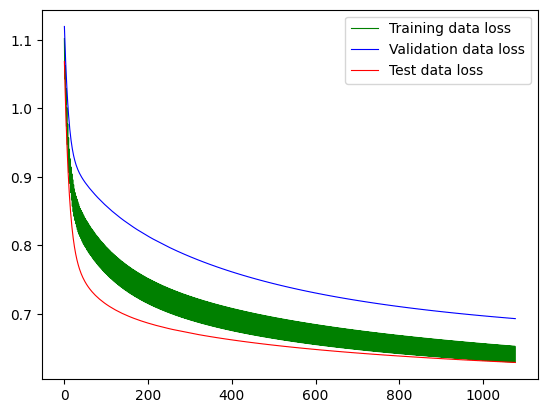

(np.float64(0.674267852306366),
 np.float64(0.02903783163777373),
 np.float64(0.683691281080246),
 np.float64(0.03568952685654576))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std_uniform(0.34)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
0


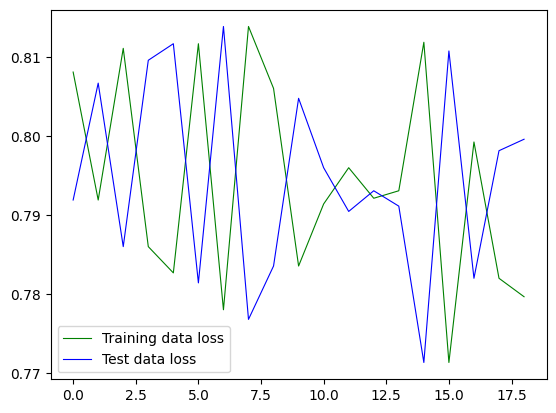

0
0


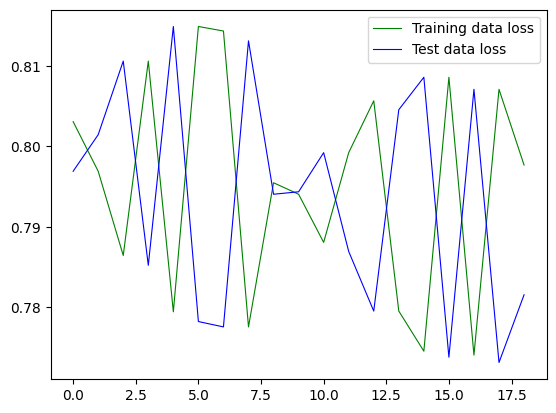

0
0


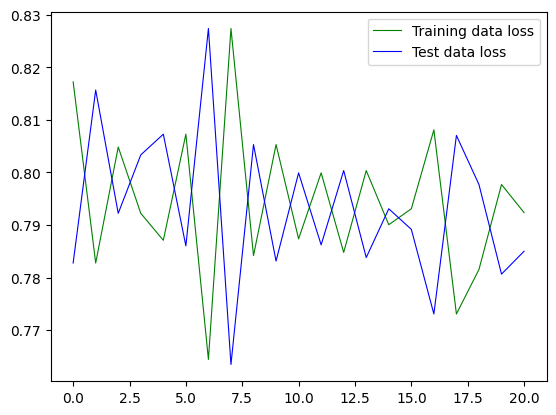

0
0


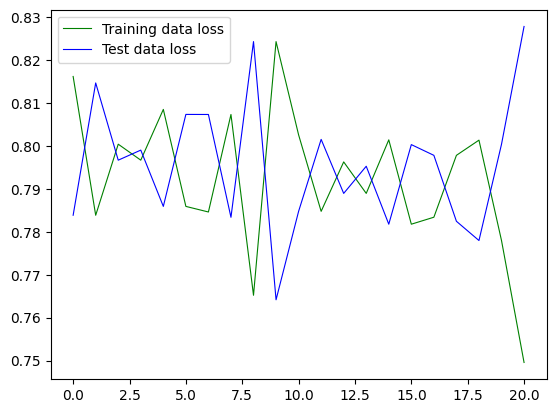

0
0


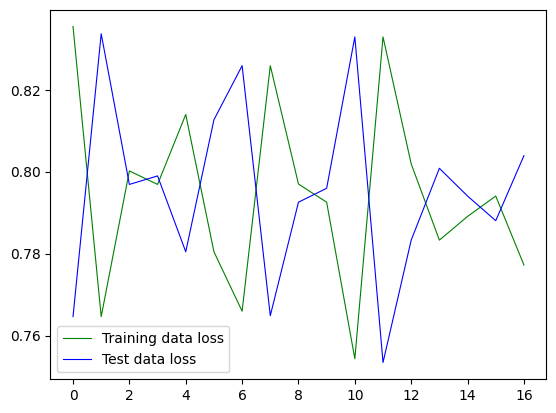

0
0


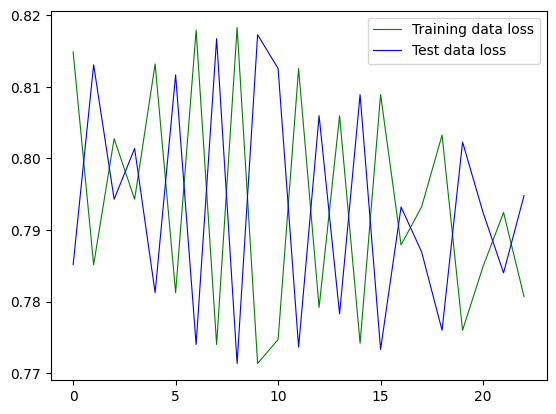

0
0


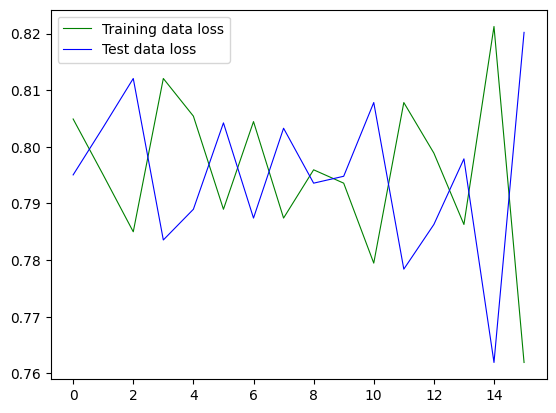

0
0


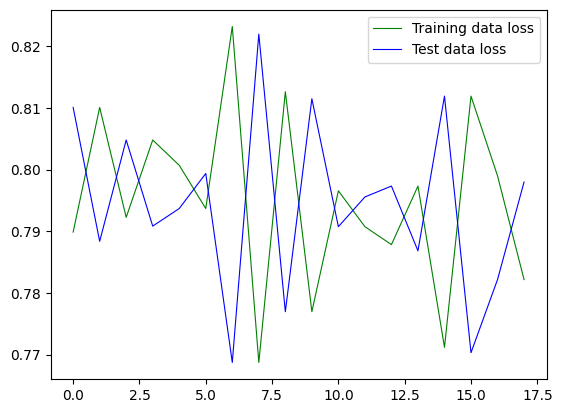

0
0


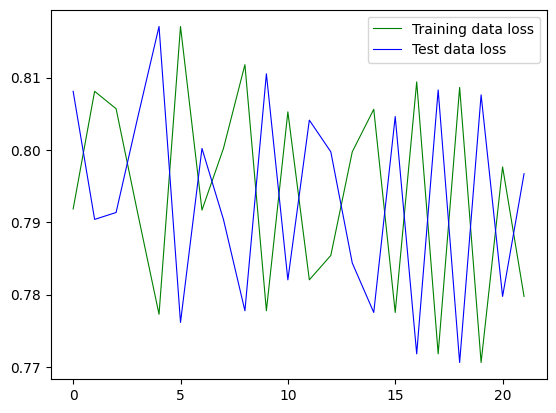

0
0


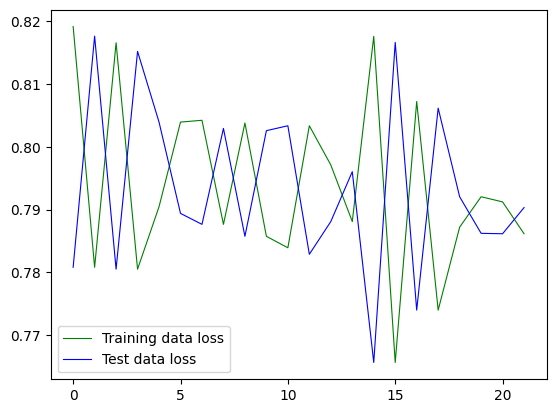

0
0
0


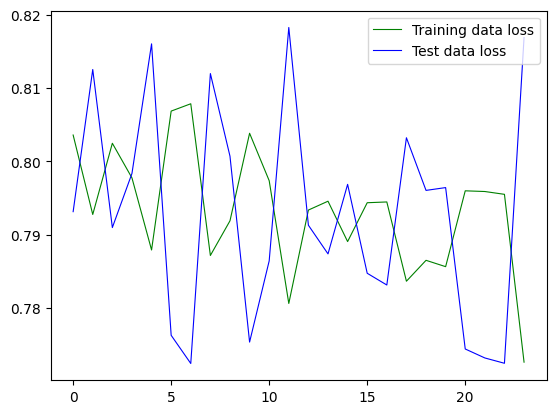

0
0
0


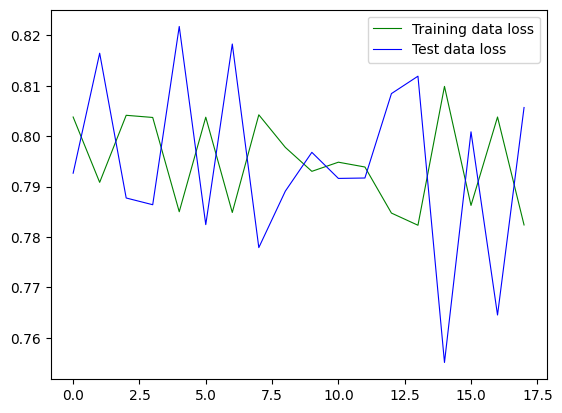

0
0
0


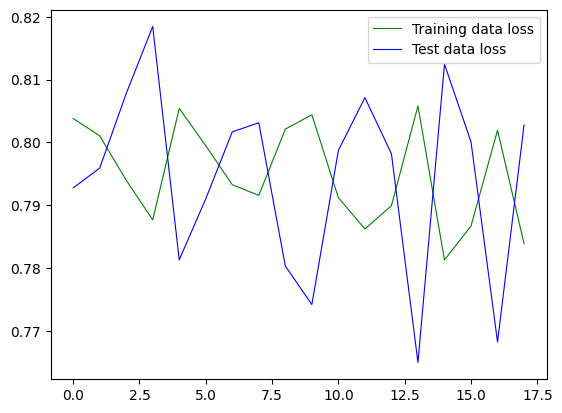

0
0
0


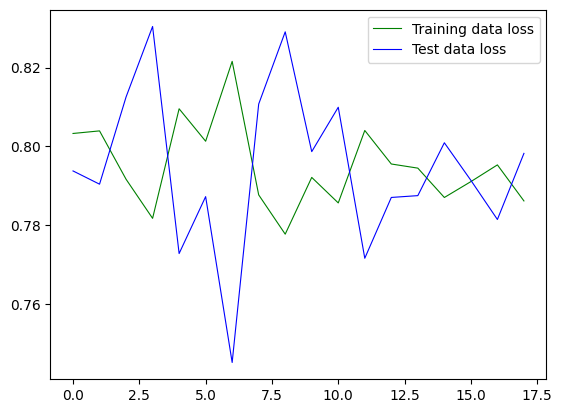

0
0
0


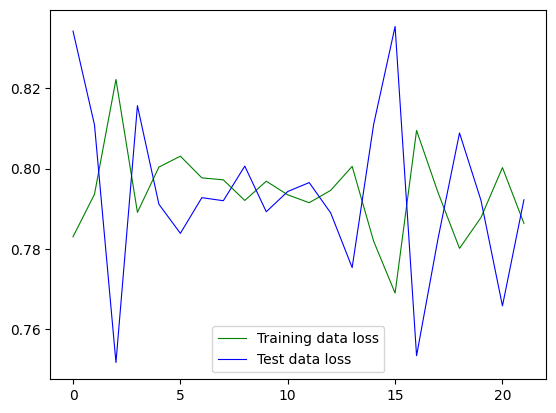

0
0
0


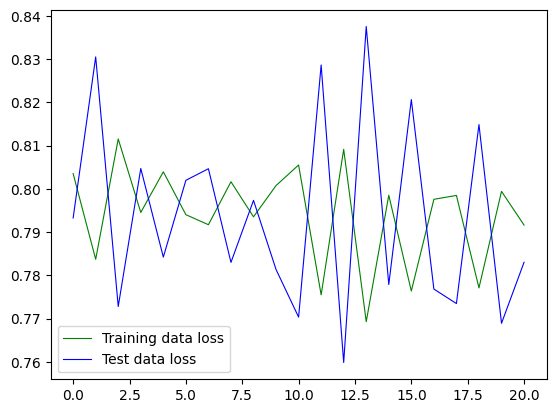

0
0
0


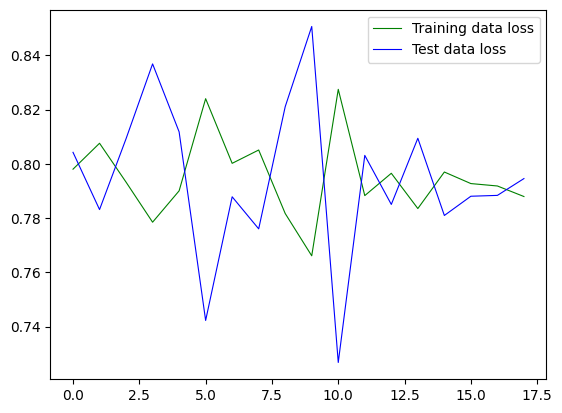

0
0
0


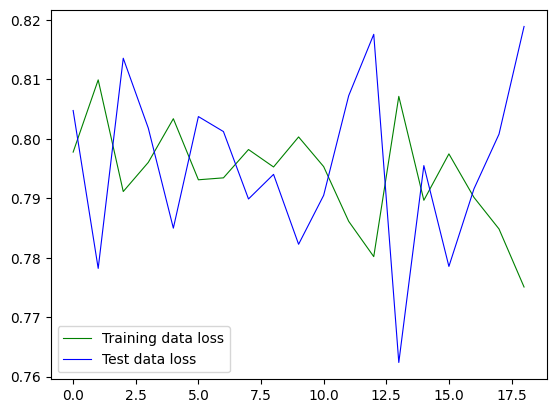

0
0
0


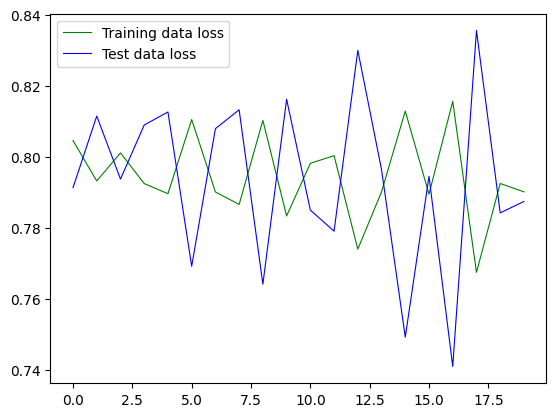

0
0
0


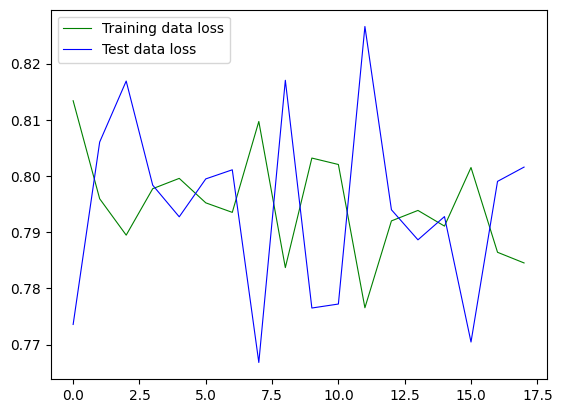

0
0
0
0


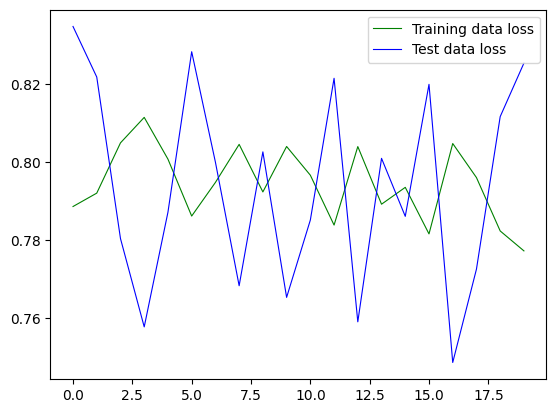

0
0
0
0


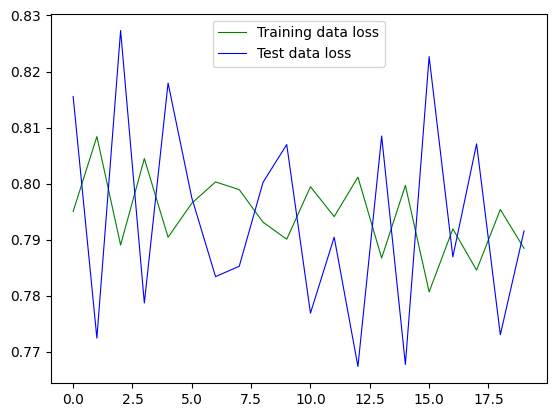

0
0
0
0


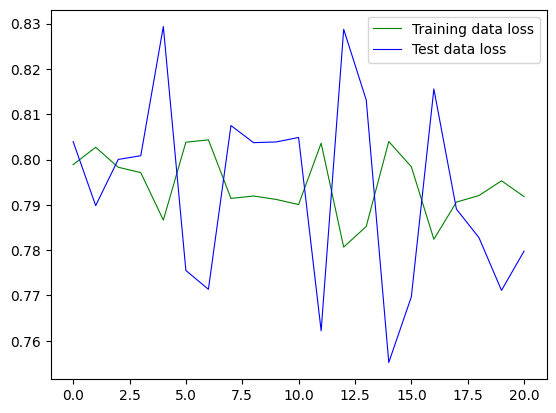

0
0
0
0


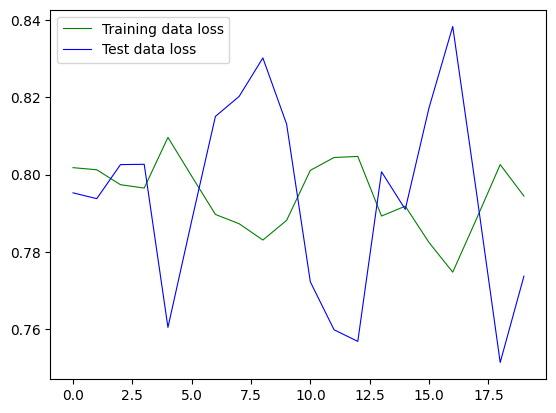

0
0
0
0


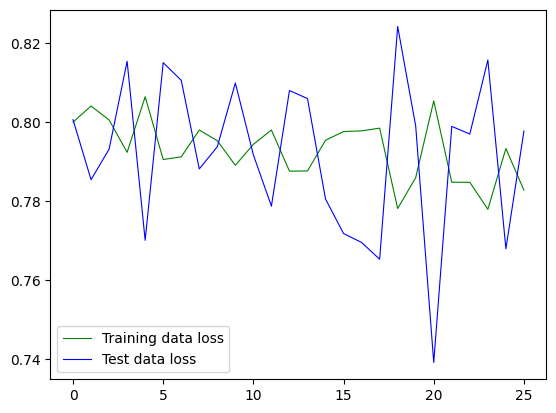

0
0
0
0


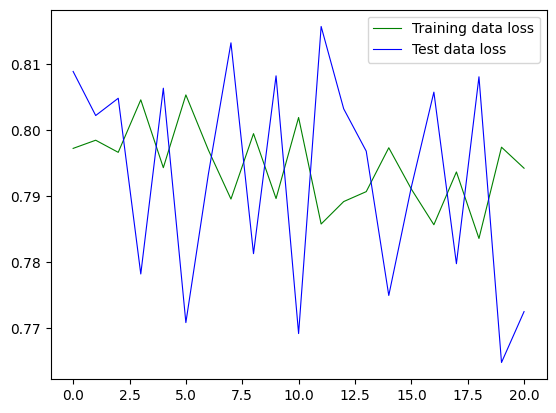

0
0
0
0


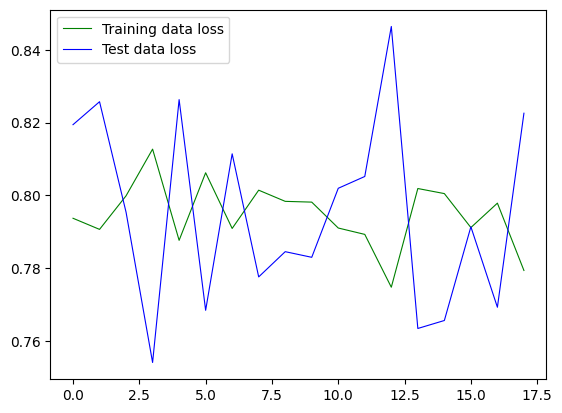

0
0
0
0


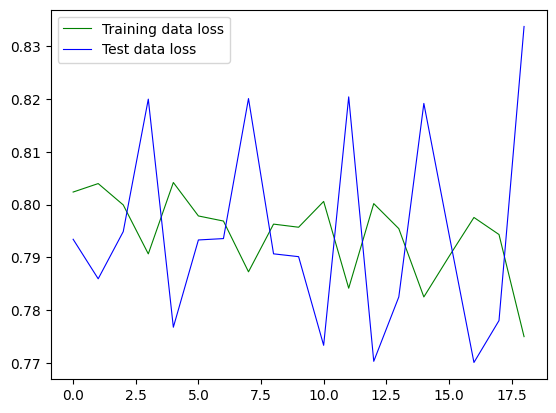

0
0
0
0


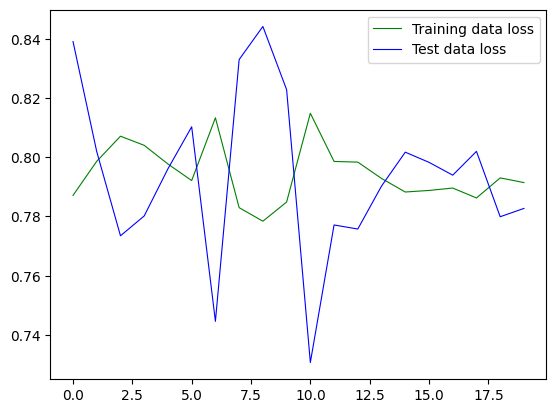

0
0
0
0


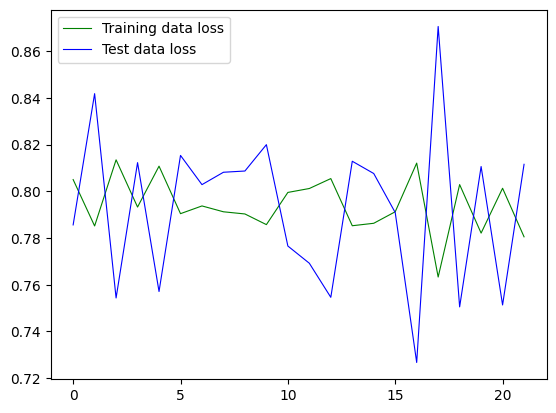

0
0
0
0
0


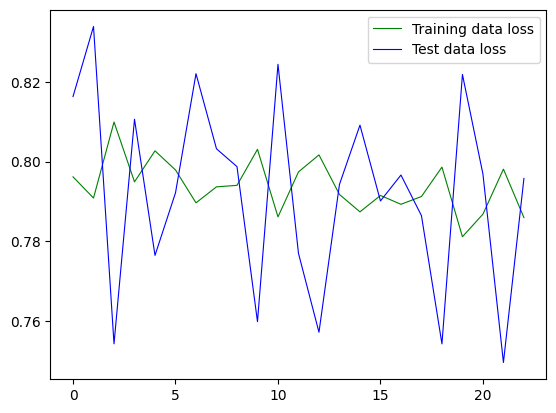

0
0
0
0
0


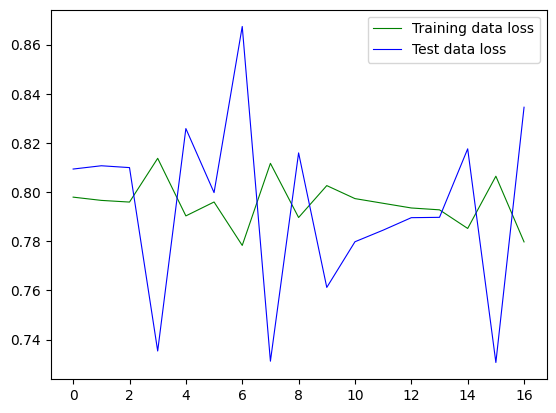

0
0
0
0
0


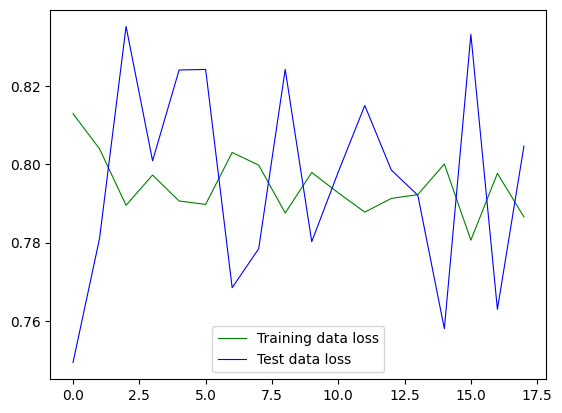

0
0
0
0
0


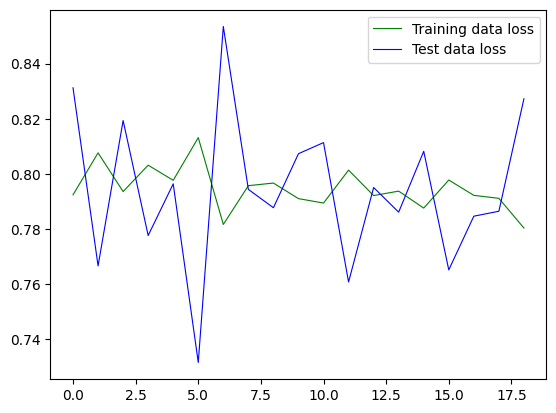

0
0
0
0
0


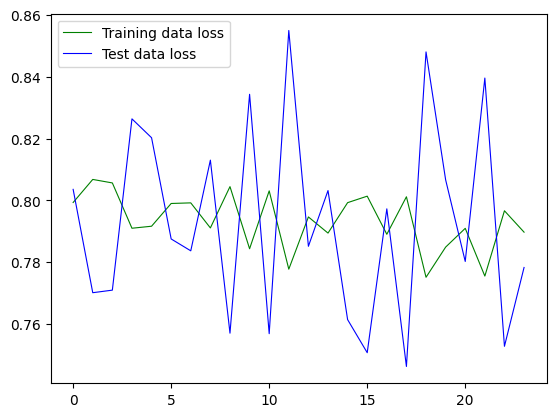

0
0
0
0
0


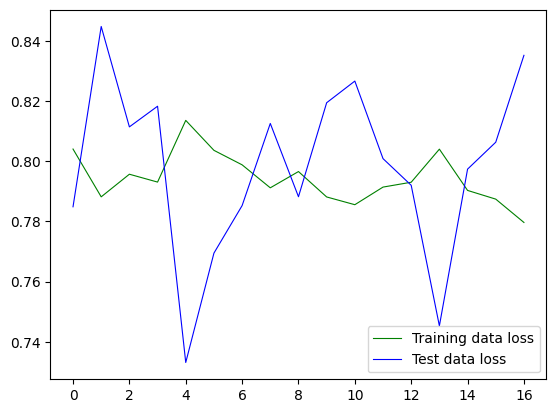

0
0
0
0
0


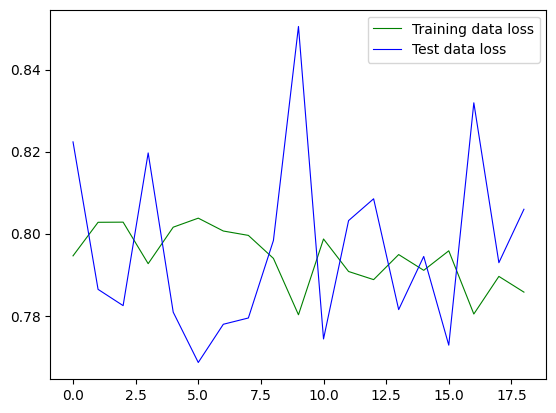

0
0
0
0
0


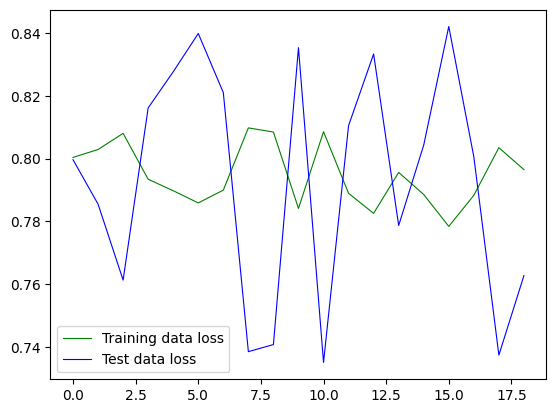

0
0
0
0
0


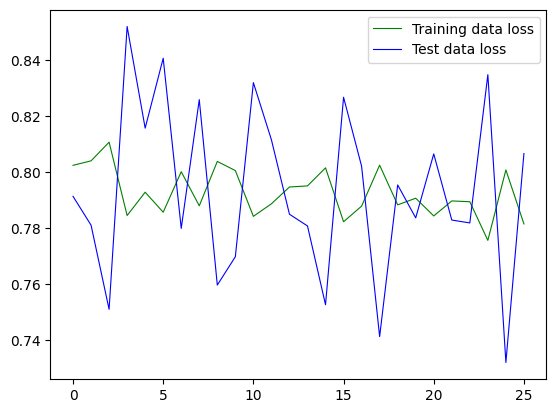

0
0
0
0
0


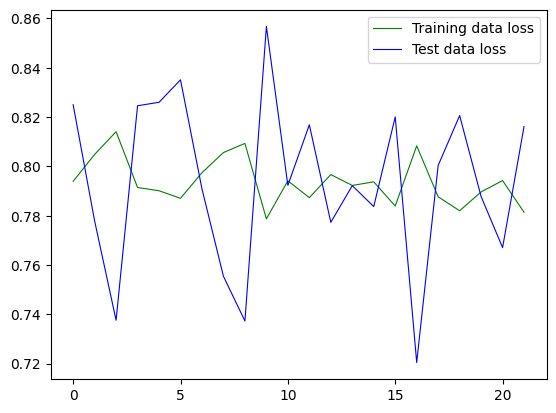

0
0
0
0
0
0


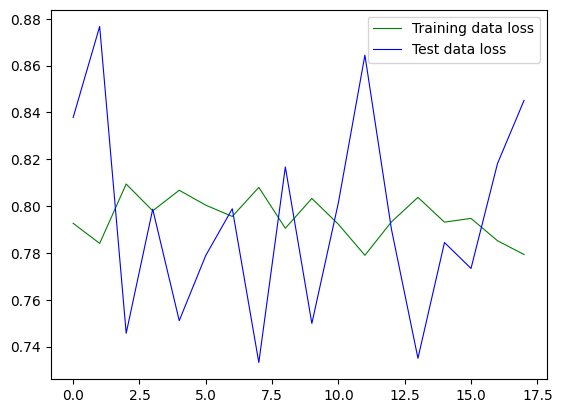

0
0
0
0
0
0


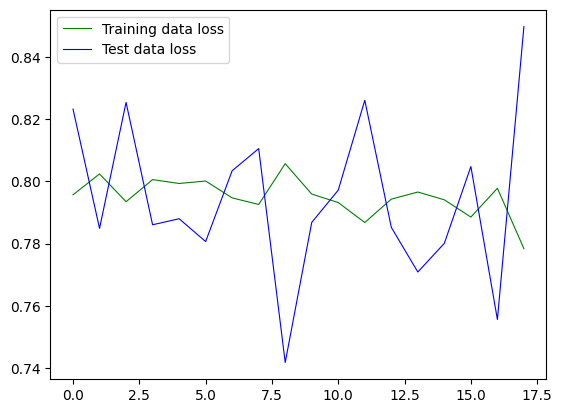

0
0
0
0
0
0


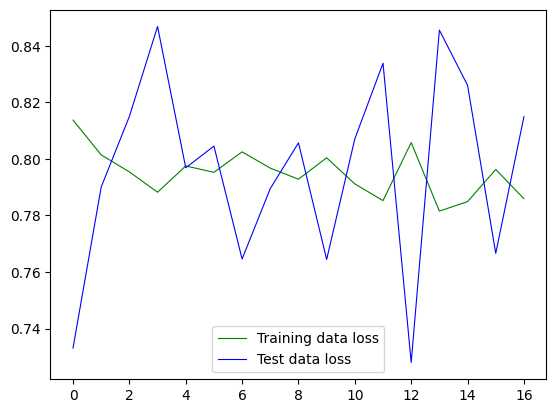

0
0
0
0
0
0


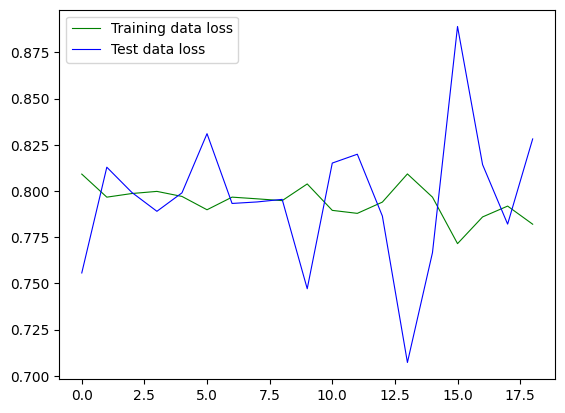

0
0
0
0
0
0


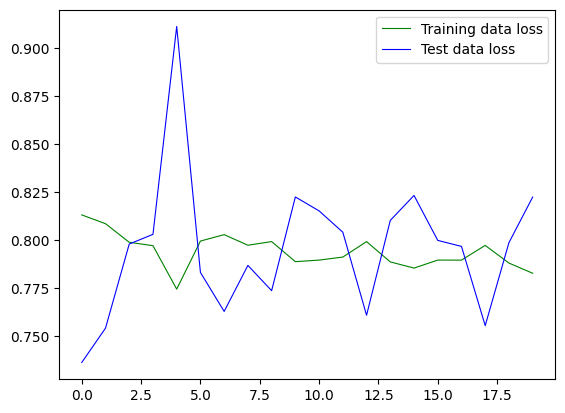

0
0
0
0
0
0


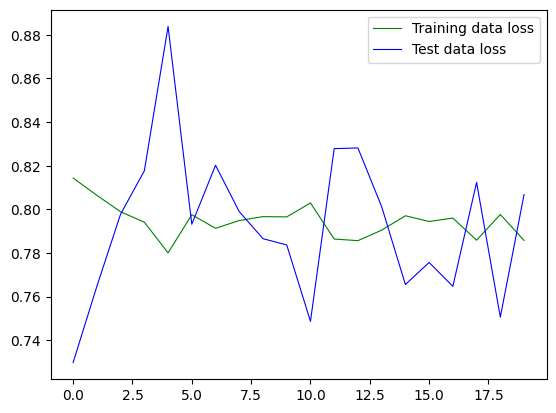

0
0
0
0
0
0


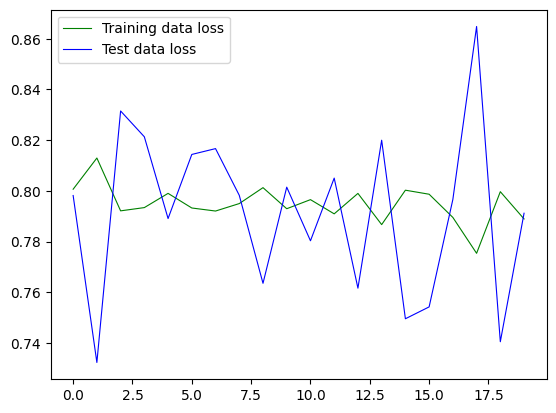

0
0
0
0
0
0


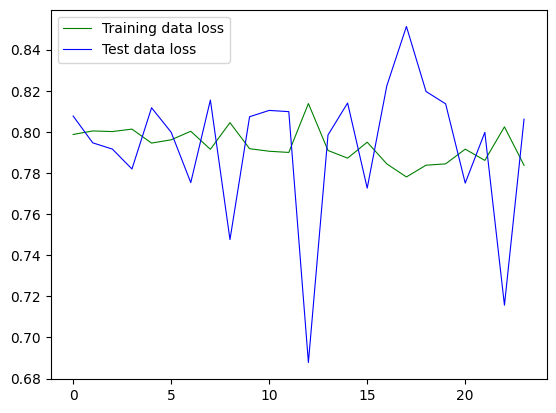

0
0
0
0
0
0


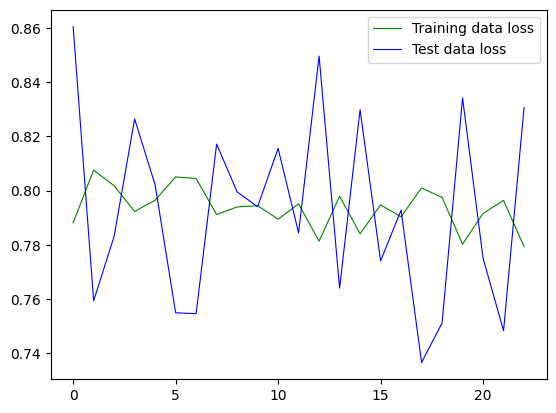

0
0
0
0
0
0


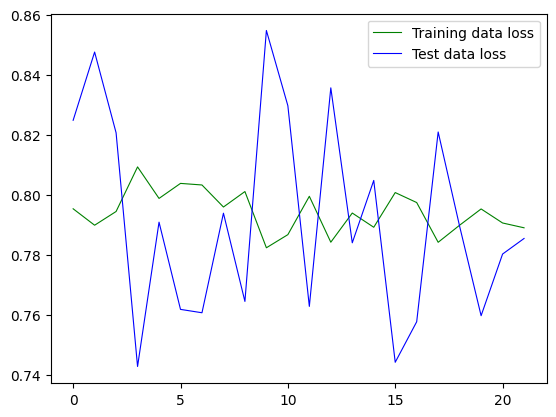

0
0
0
0
0
0
0


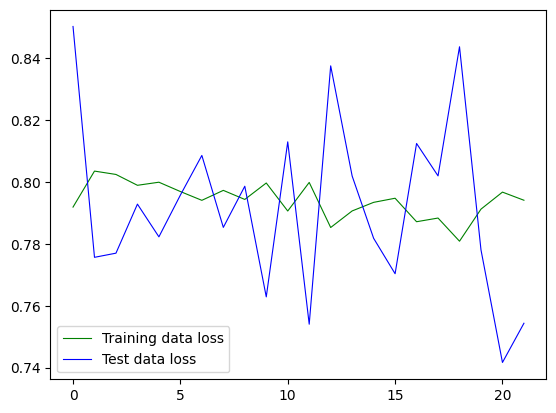

0
0
0
0
0
0
0


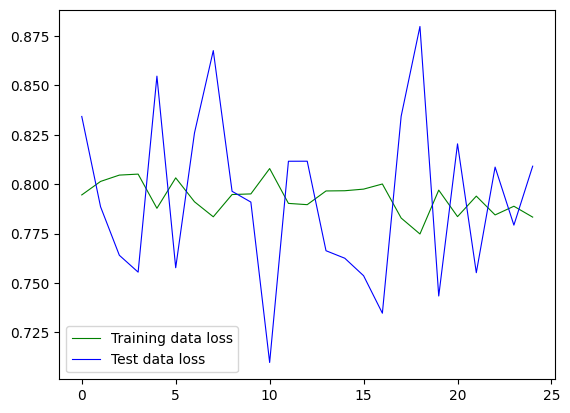

0
0
0
0
0
0
0


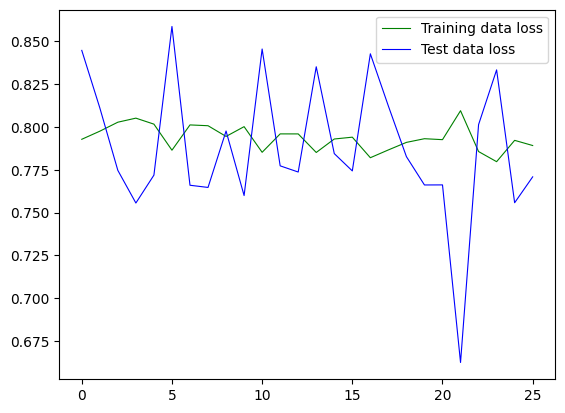

0
0
0
0
0
0
0


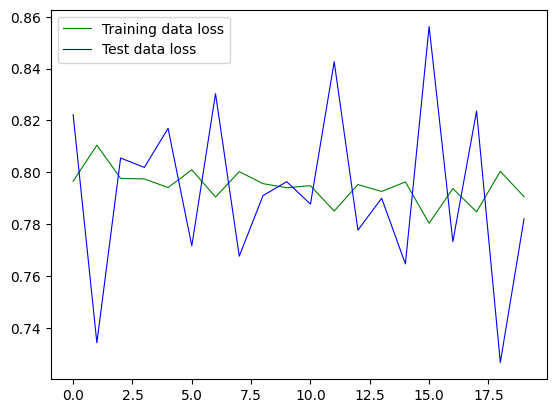

0
0
0
0
0
0
0


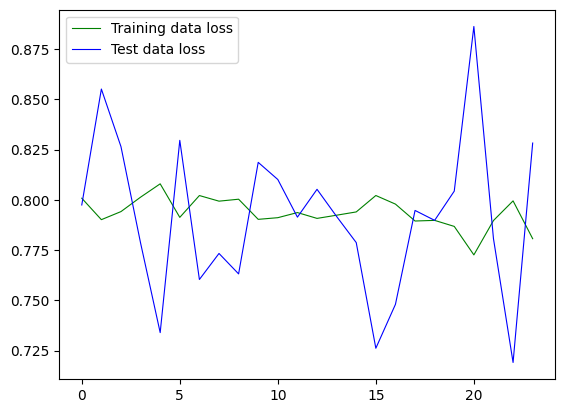

0
0
0
0
0
0
0


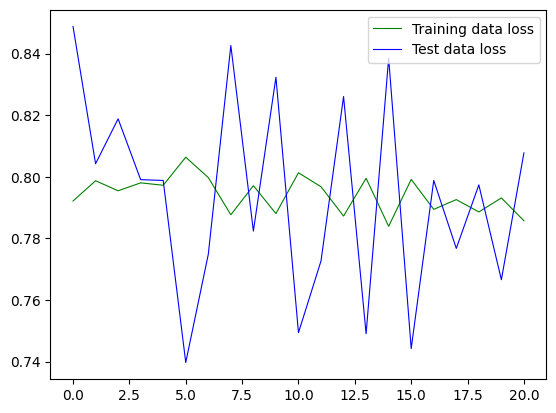

0
0
0
0
0
0
0


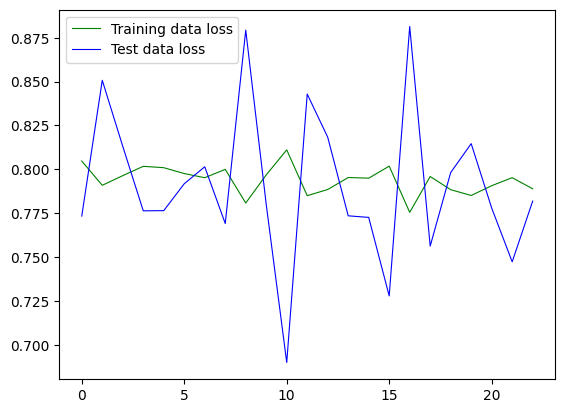

0
0
0
0
0
0
0


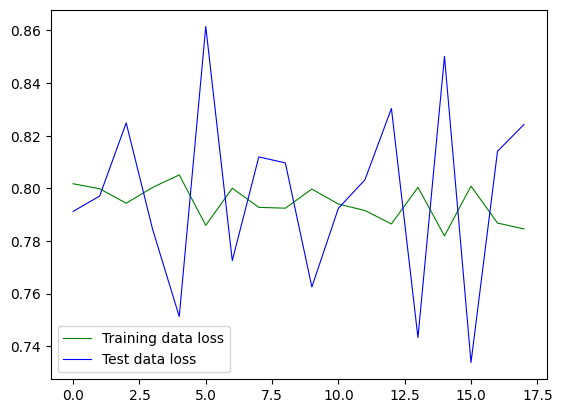

0
0
0
0
0
0
0


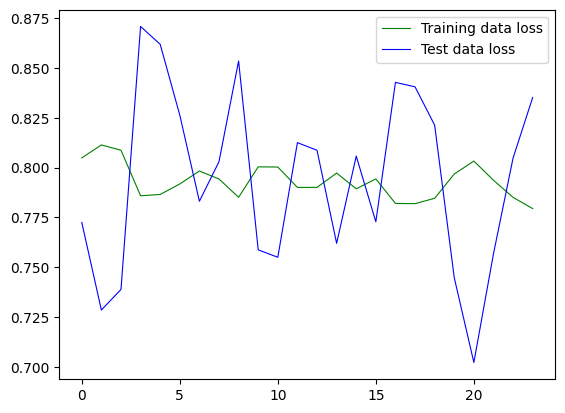

0
0
0
0
0
0
0


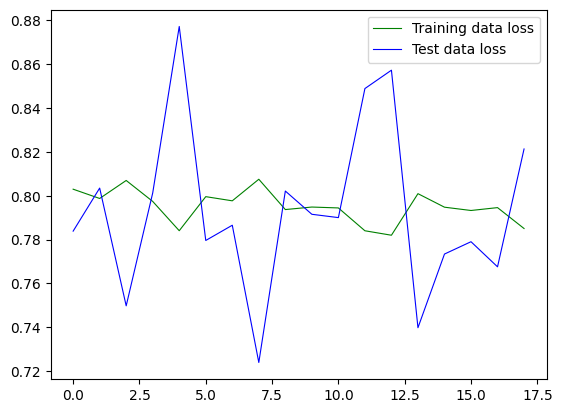

0
0
0
0
0
0
0
0


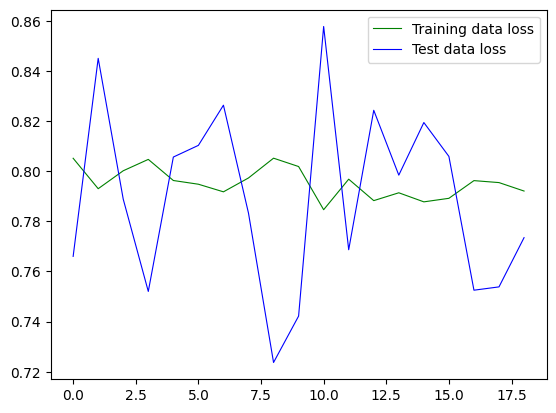

0
0
0
0
0
0
0
0


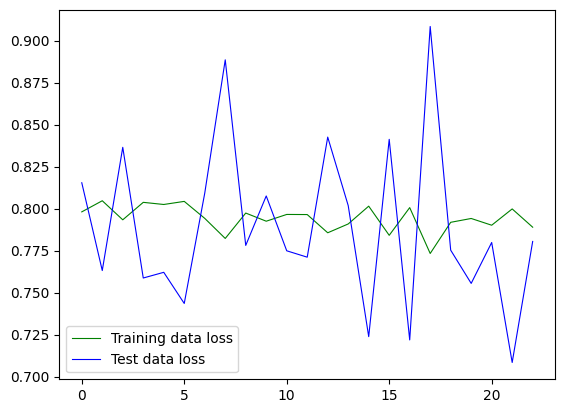

0
0
0
0
0
0
0
0


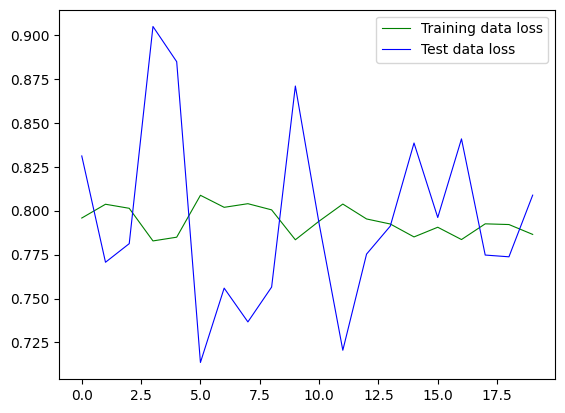

0
0
0
0
0
0
0
0


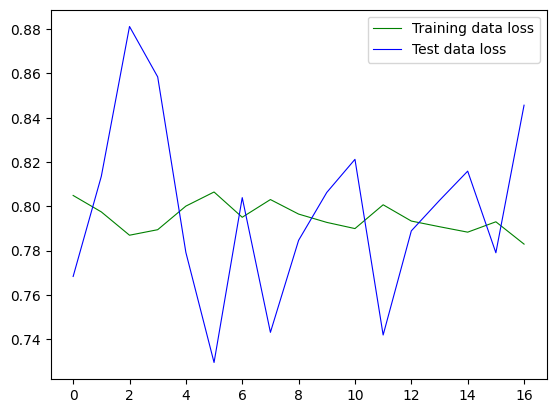

0
0
0
0
0
0
0
0


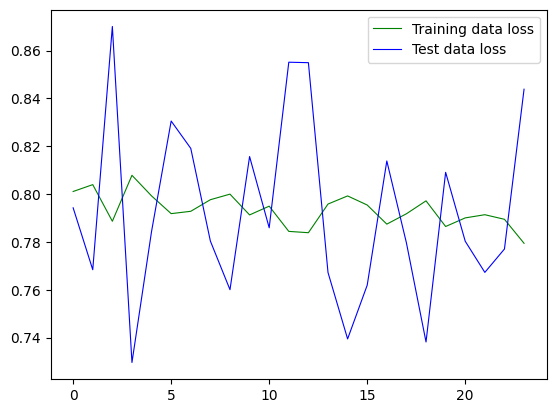

0
0
0
0
0
0
0
0


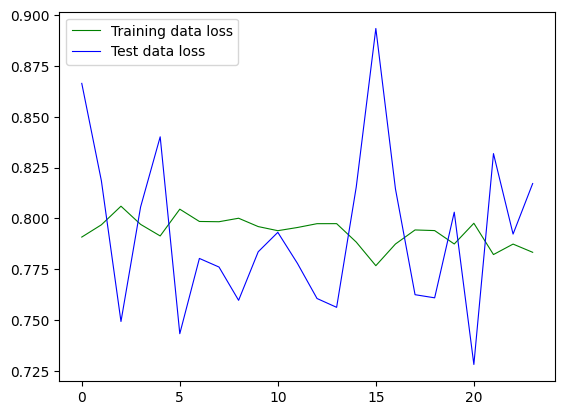

0
0
0
0
0
0
0
0


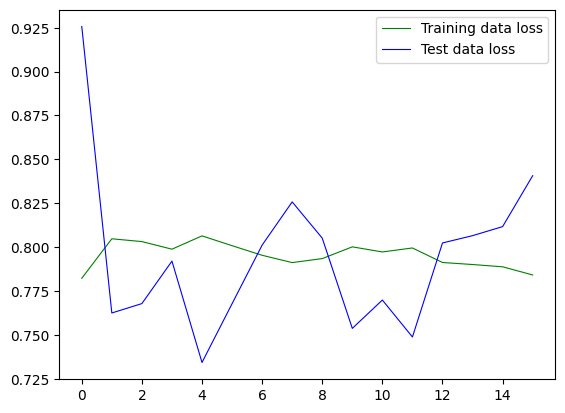

0
0
0
0
0
0
0
0


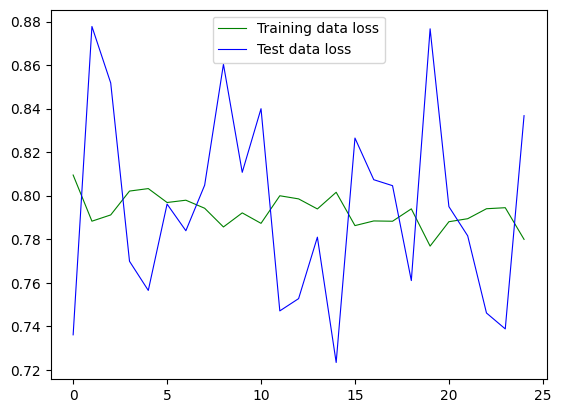

0
0
0
0
0
0
0
0


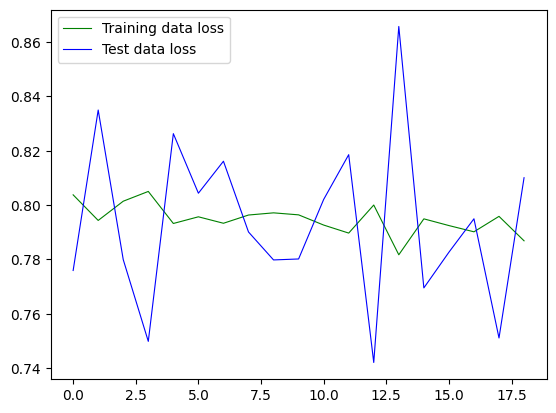

0
0
0
0
0
0
0
0


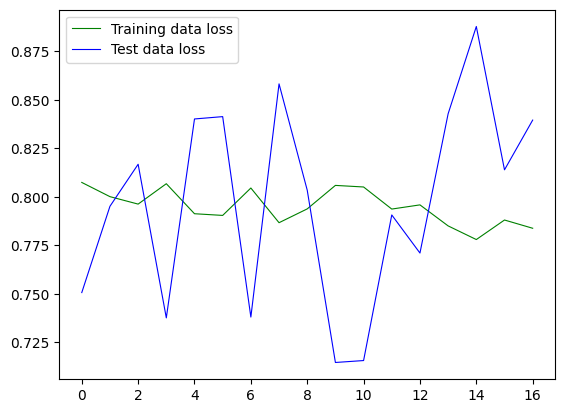

0
0
0
0
0
0
0
0
0


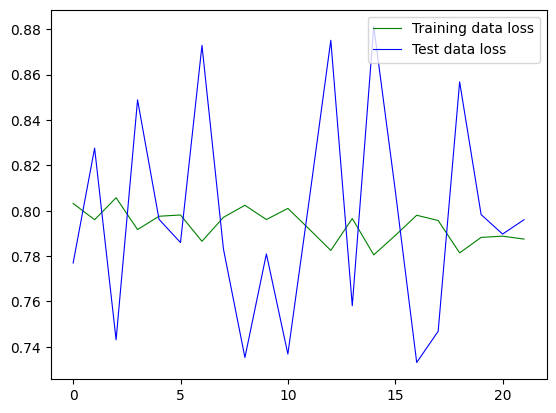

0
0
0
0
0
0
0
0
0


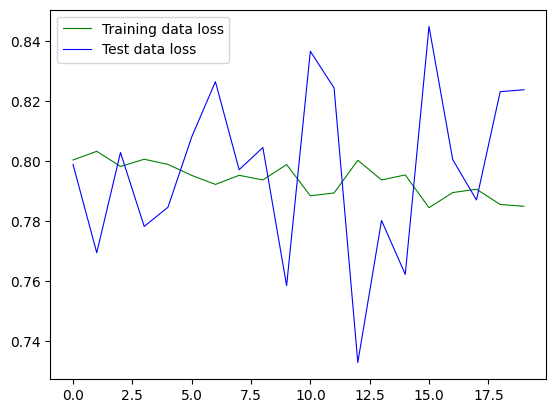

0
0
0
0
0
0
0
0
0


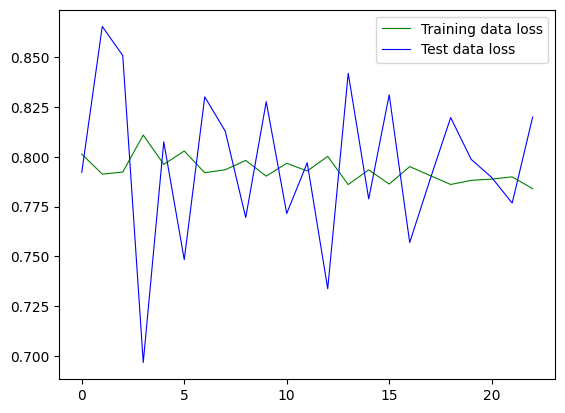

0
0
0
0
0
0
0
0
0


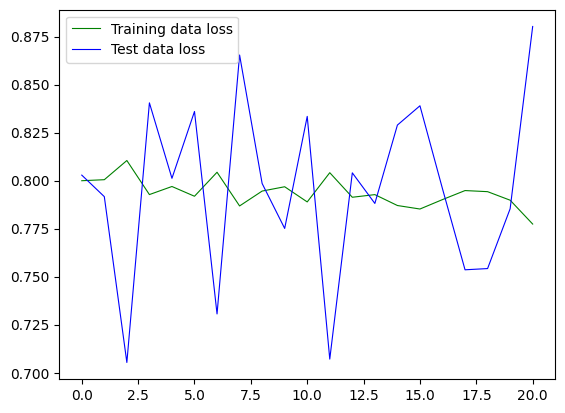

0
0
0
0
0
0
0
0
0


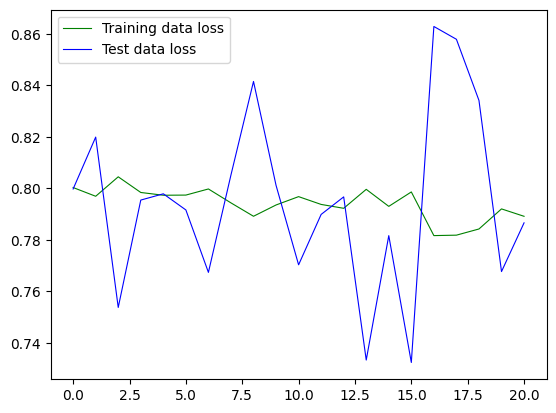

0
0
0
0
0
0
0
0
0


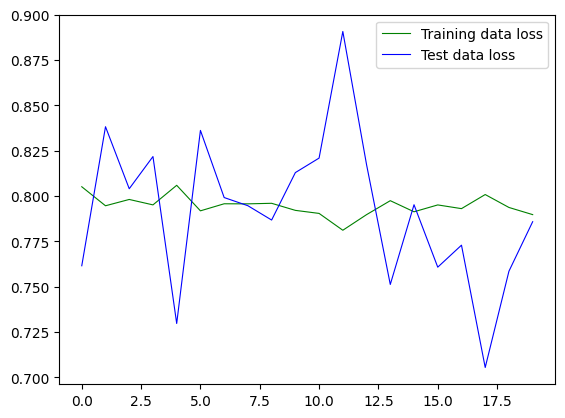

0
0
0
0
0
0
0
0
0


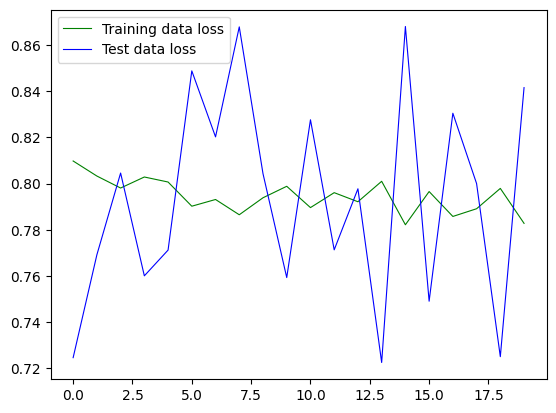

0
0
0
0
0
0
0
0
0


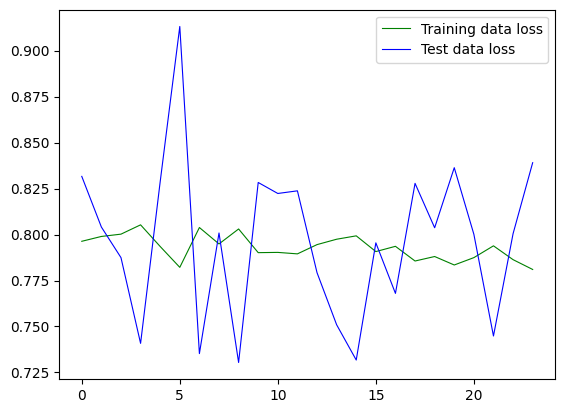

0
0
0
0
0
0
0
0
0


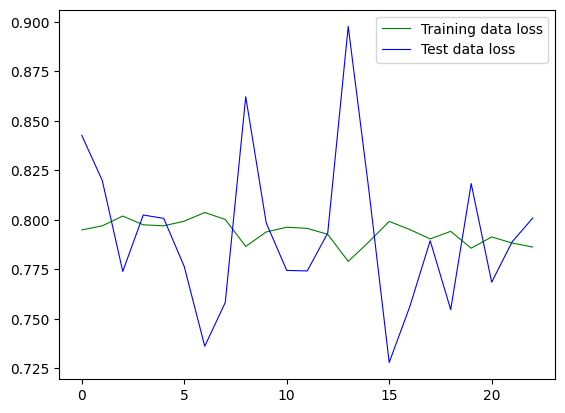

0
0
0
0
0
0
0
0
0


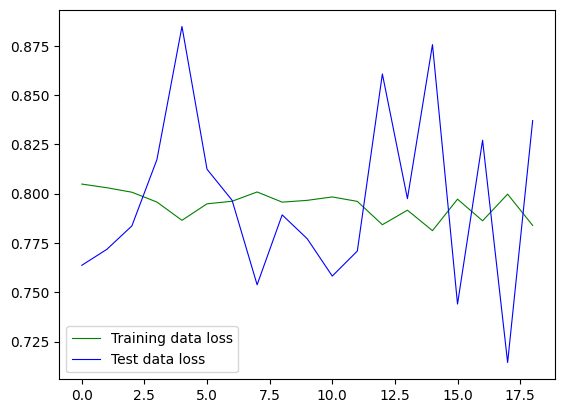

0
0
0
0
0
0
0
0
0
0


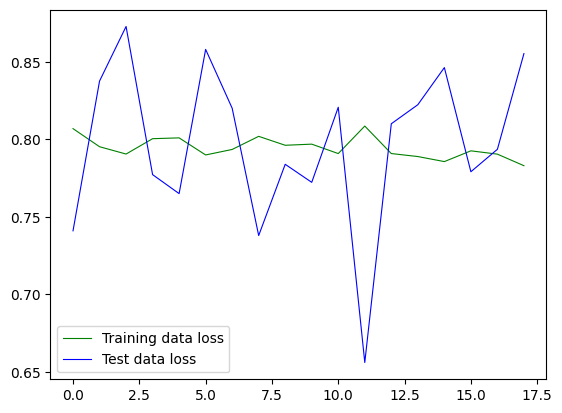

0
0
0
0
0
0
0
0
0
0


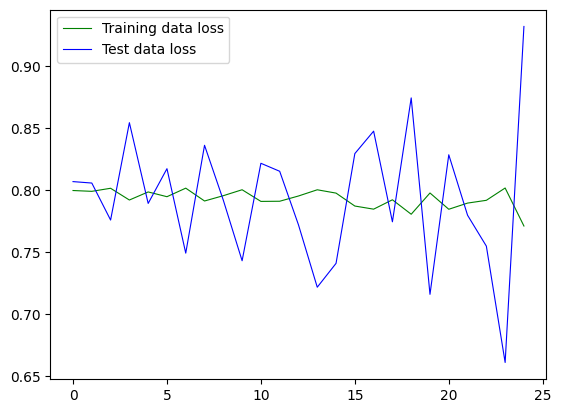

0
0
0
0
0
0
0
0
0
0


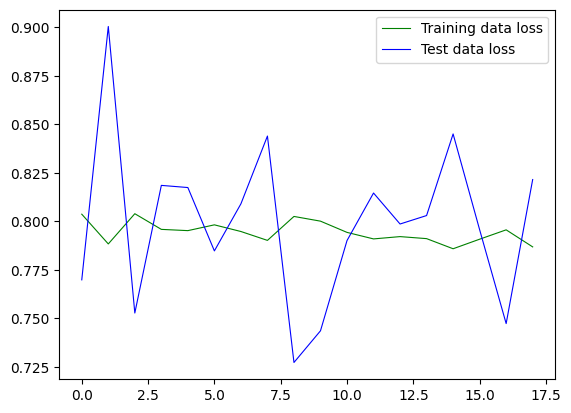

0
0
0
0
0
0
0
0
0
0


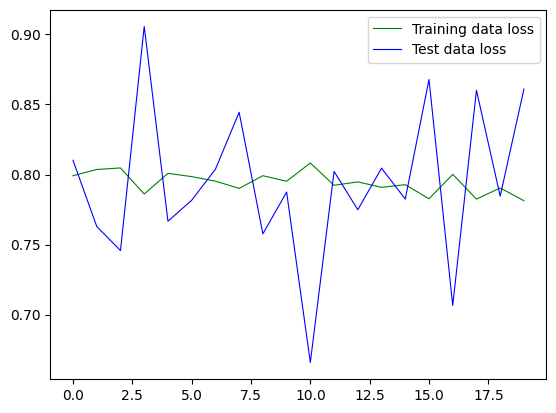

0
0
0
0
0
0
0
0
0
0


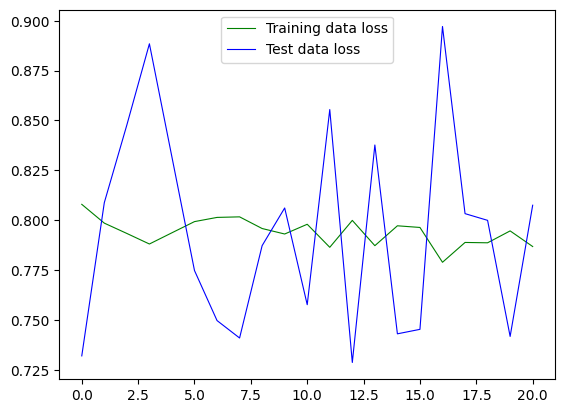

0
0
0
0
0
0
0
0
0
0


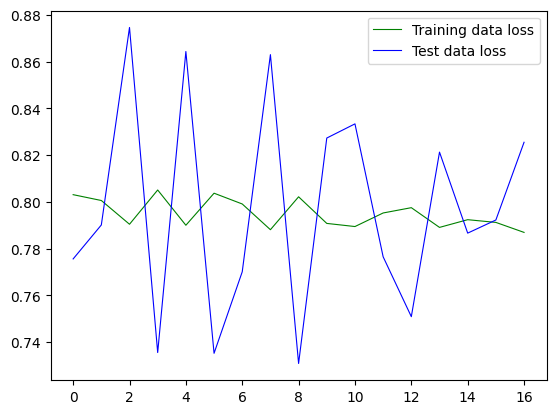

0
0
0
0
0
0
0
0
0
0


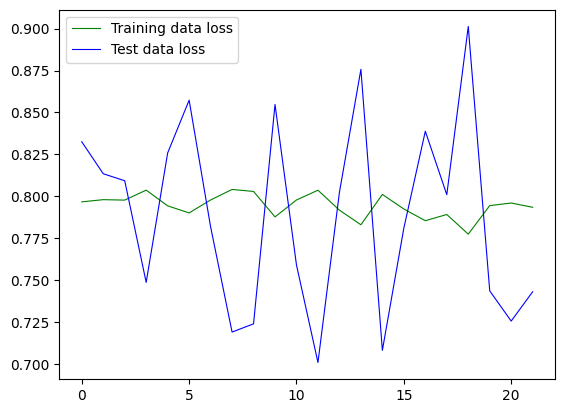

0
0
0
0
0
0
0
0
0
0


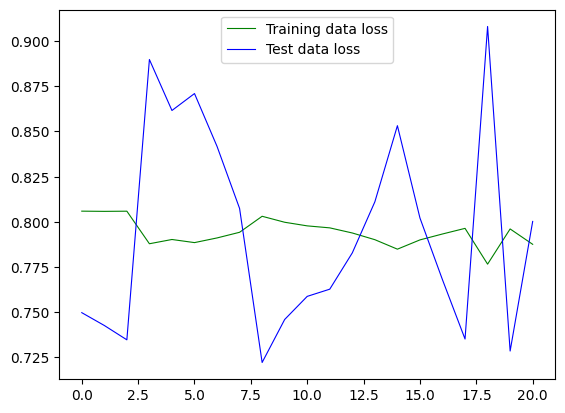

0
0
0
0
0
0
0
0
0
0


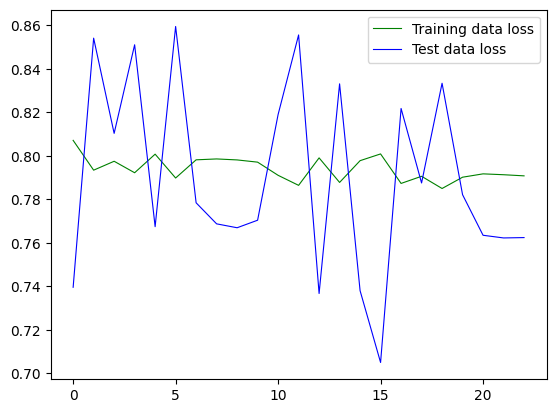

0
0
0
0
0
0
0
0
0
0


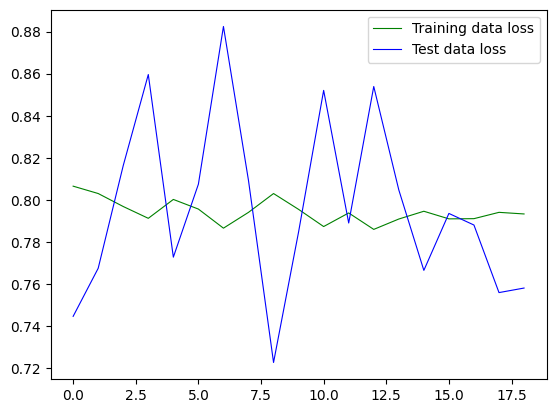

0
0
0
0
0
0
0
0
0


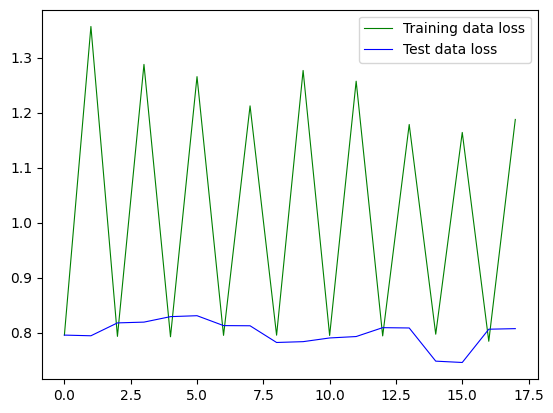

0
0
0
0
0
0
0
0
0
0


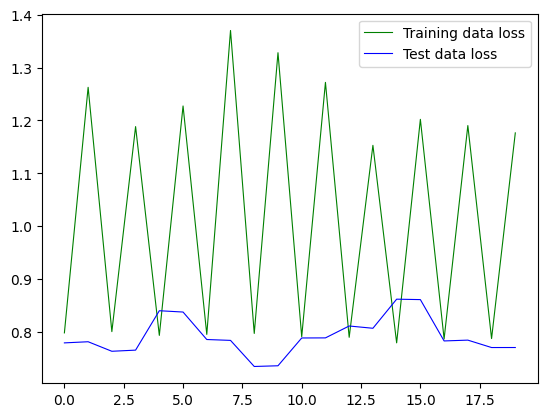

0
0
0
0
0
0
0
0
0


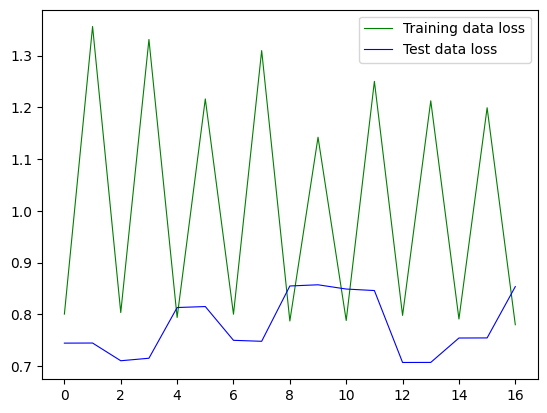

0
0
0
0
0
0
0
0
0
0


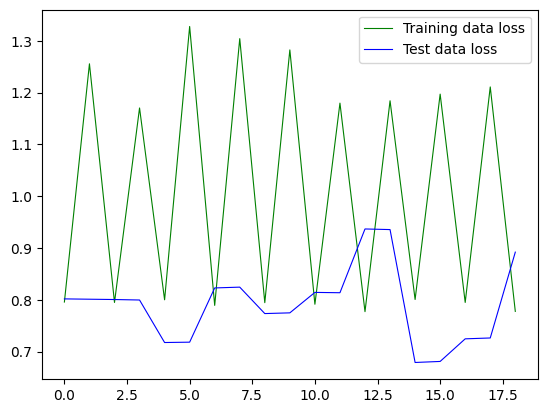

0
0
0
0
0
0
0
0
0


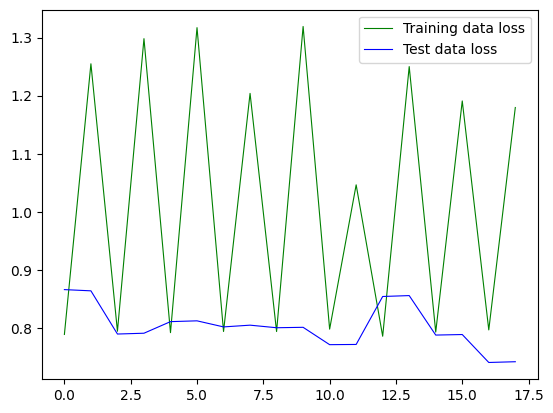

0
0
0
0
0
0
0
0


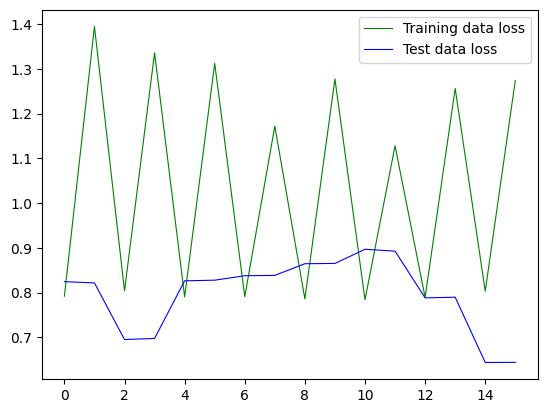

0
0
0
0
0
0
0
0
0
0


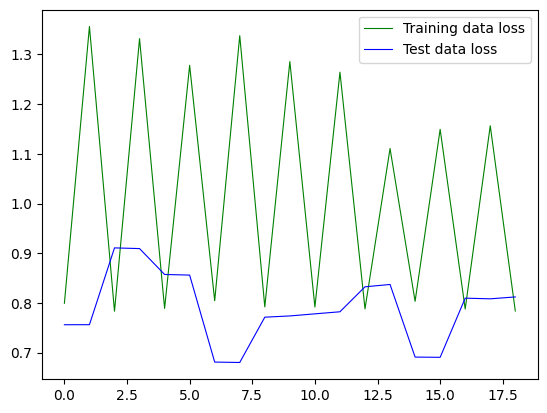

0
0
0
0
0
0
0
0
0
0


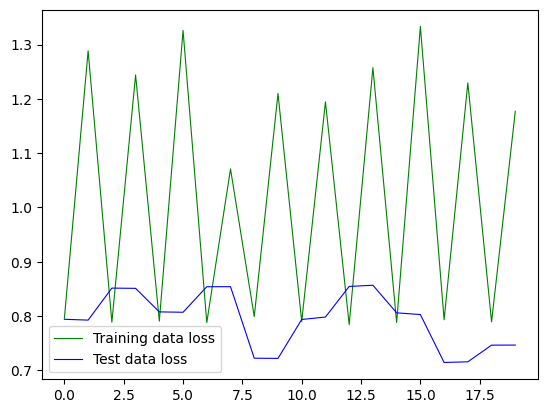

0
0
0
0
0
0
0
0
0


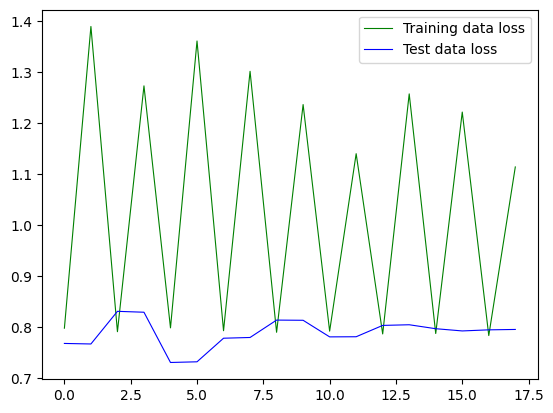

0
0
0
0
0
0
0
0
0


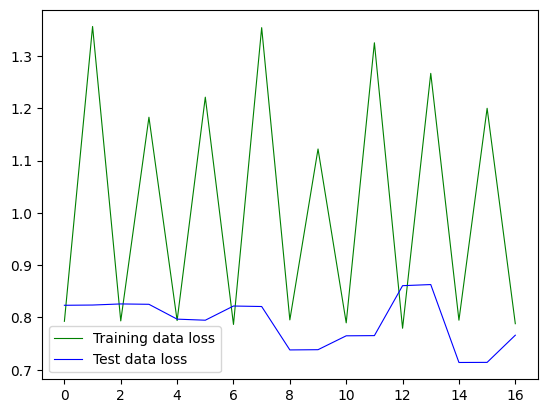

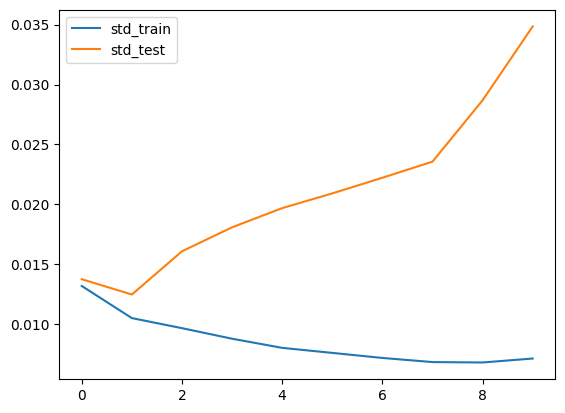

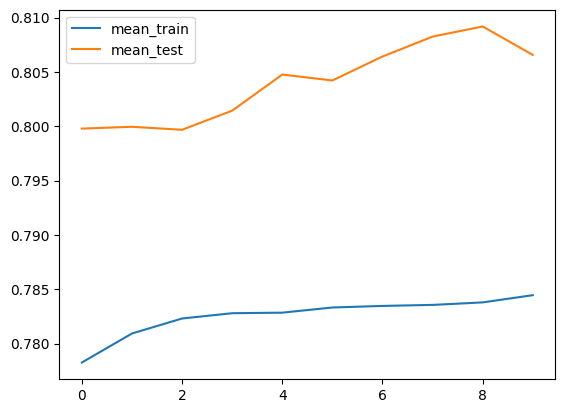

In [ ]:
std_test_total=[]
mean_test_total=[]
std_train_total=[]
mean_train_total=[]
trl = []
tel = []
for j in range (10):
  for i in range (10):
    model = copy.deepcopy(model_init)
    optimizer = optim.SGD(model.parameters(), lr=0.01)
    train_loss, test_loss, epoch = model_train_10_fold(model, X, y, optimizer, nfolds = j+2)
    trl.append(train_loss)
    tel.append(test_loss)
  std_train_total.append(np.array(trl).std())
  mean_train_total.append(np.array(trl).mean())
  std_test_total.append(np.array(tel).std())
  mean_test_total.append(np.array(tel).mean())
plt.plot(std_train_total, label = "std_train")
plt.plot(std_test_total, label = "std_test")
plt.legend()
plt.show()
plt.plot(mean_train_total, label = "mean_train")
plt.plot(mean_test_total, label = "mean_test")
plt.legend()
plt.show()

In [ ]:

import copy
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import tqdm
from sklearn.model_selection import StratifiedKFold

def model_train_loocv(model, X, y, optimizer, batch_size = 1150, nfolds = 10):

    loss_graph = []
    val_loss_graph = []
    test_loss_graph = []
    classification_error_graph = []
    val_classification_error_graph = []
    test_classification_error_graph = []
    stop_criterion = 0

    # loss function and optimizer
    loss_fn = nn.BCELoss()  # binary cross entropy
    #optimizer = optim.Adam(model.parameters(), lr=lr)
    n_epochs = 100   # number of epochs to run
    #batch_size = len(X_train)  # size of each batch
    batch_start = torch.arange(0, 1150, 1150)

    for epoch in range(n_epochs):
        if stop_criterion >= 10:
                    break

        X_train, X_val = np.delete(X.to_numpy(), epoch%1151, axis = 0), X.to_numpy()[epoch%1151, :]
        y_train, y_val = np.delete(y.to_numpy(), epoch%1151, axis = 0), y.to_numpy()[epoch%1151, :]
        X_train = torch.tensor(X_train, dtype=torch.float32)
        y_train = torch.tensor(y_train, dtype=torch.float32)
        X_val = torch.tensor(X_val, dtype=torch.float32)
        y_val = torch.tensor(y_val, dtype=torch.float32)
        model.train()
        with tqdm.tqdm(batch_start, unit="batch", mininterval=0, disable=True) as bar:
            bar.set_description(f"Epoch {epoch}")
            for start in bar:
                if stop_criterion >= 10:
                    break
                # take a batch
                X_batch = X_train
                y_batch = y_train
                # forward pass
                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)
                loss_graph.append(loss.detach().numpy())
                # backward pass
                optimizer.zero_grad()
                loss.backward()
                # update weights
                optimizer.step()
                model.eval()

                y_pred = model(X_test)
                acc = (y_pred.round() == y_test).float().mean()
                y_pred = model(X_val)
                acc = (y_pred.round() == y_val).float().mean()
                val_loss = loss_fn(y_pred, y_val)
                val_loss_graph.append(val_loss.detach().numpy())

                val_classification_error_graph.append(float(acc))

                if len(val_loss_graph)>1:
                  if val_loss_graph[-1] > val_loss_graph[-2]:
                    stop_criterion += 1
                  if stop_criterion >= 10:
                    break

        acc = float(acc)
        if epoch % 100 == 0:
          print (epoch)
        if stop_criterion >= 10:
                    break
    plt.plot(loss_graph, 'g', label='Training data loss', linewidth=0.8)
    plt.plot(val_loss_graph, 'b', label='Test data loss', linewidth=0.8)
    plt.legend()
    plt.show()

    y_pred = model(X_val)
    acc = (y_pred.round() == y_val).float().mean()
    test_loss = loss_fn(y_pred, y_val).detach().item()

    y_pred = model(X_train)
    train_loss = loss_fn(y_pred, y_train).detach().item()

    return train_loss, test_loss, epoch

0


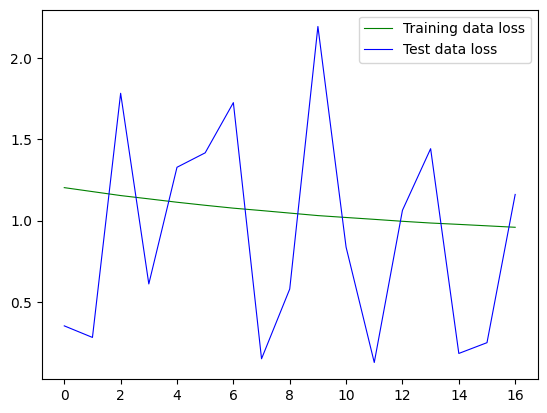

0


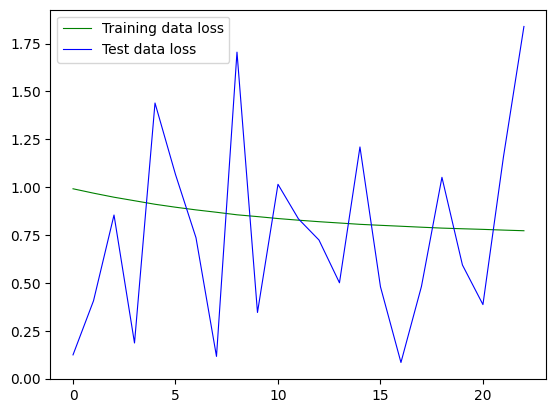

0


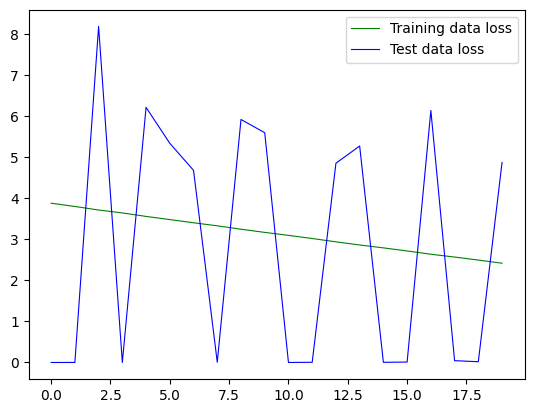

0


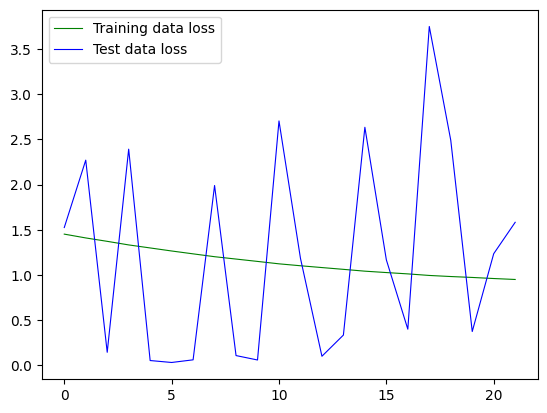

0


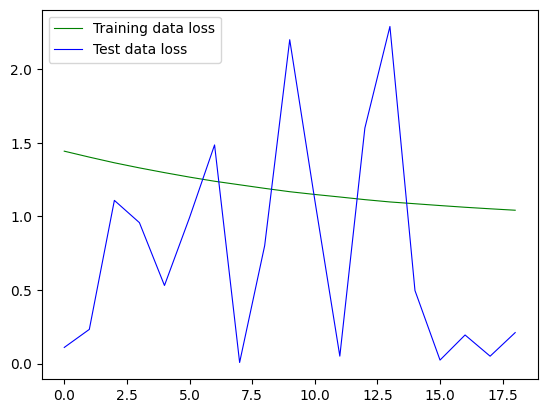

0


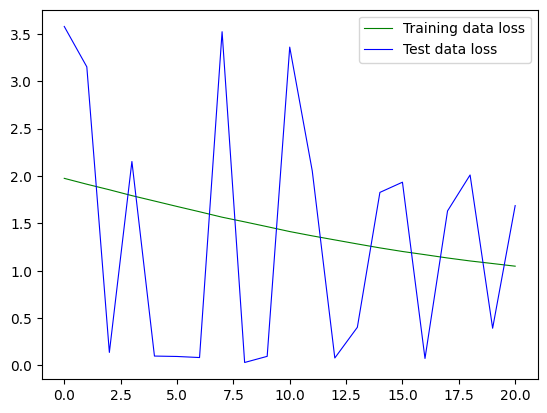

0


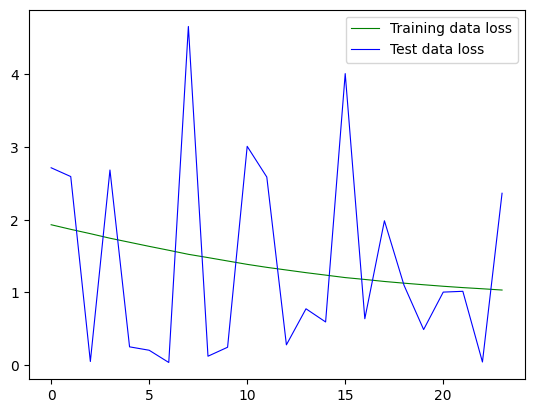

0


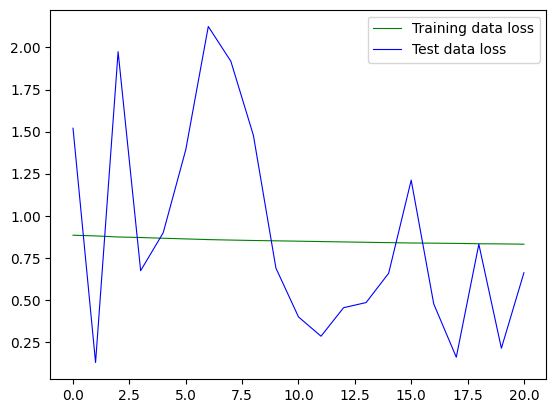

0


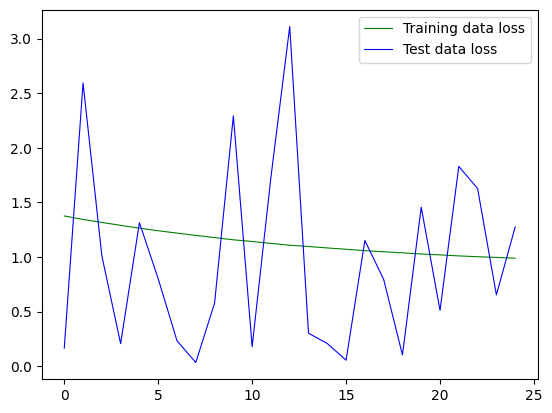

0


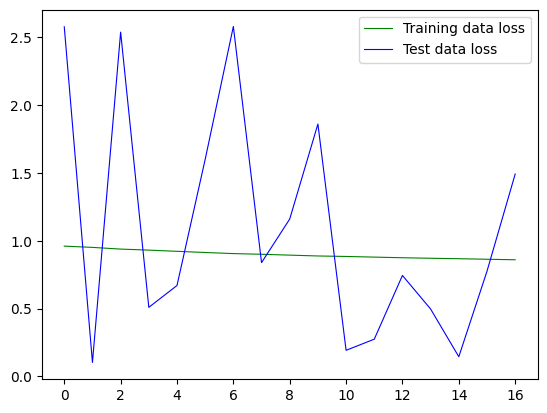

(np.float64(1.0749766886234284),
 np.float64(0.4318685927435837),
 np.float64(1.7142481535673142),
 np.float64(1.197076188464517))

In [ ]:
trl = []
tel = []
for i in range (10):
  model = Deep_std_uniform(0.34)
  optimizer = optim.SGD(model.parameters(), lr=0.01)
  train_loss, test_loss, epoch = model_train_loocv(model, X, y, optimizer)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

In [ ]:

import copy
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import tqdm
from sklearn.model_selection import StratifiedKFold

def model_train_basic_10_fold(model, X, y, optimizer, closure, batch_size = len(X_train), nfolds = 10):
    weights1_dynamic = []
    weights2_dynamic = []
    weights3_dynamic = []
    for i in range (6):
                  weights1_dynamic.append([])
                  weights2_dynamic.append([])
                  weights3_dynamic.append([])
    loss_graph = []
    val_loss_graph = []
    test_loss_graph = []
    classification_error_graph = []
    val_classification_error_graph = []
    test_classification_error_graph = []
    stop_criterion = 0

    # loss function and optimizer
    loss_fn = nn.BCELoss()  # binary cross entropy
    #optimizer = optim.Adam(model.parameters(), lr=lr)
    skf = StratifiedKFold(n_splits=nfolds, shuffle=True)
    StratifiedKFold(n_splits=nfolds, random_state=1, shuffle=True)
    for train_index, test_index in skf.split(X, y):
      X_train, X_val = X.to_numpy()[train_index], X.to_numpy()[test_index]
      y_train, y_val = y.to_numpy()[train_index], y.to_numpy()[test_index]
      X_train = torch.tensor(X_train, dtype=torch.float32)
      y_train = torch.tensor(y_train, dtype=torch.float32)
      X_val = torch.tensor(X_val, dtype=torch.float32)
      y_val = torch.tensor(y_val, dtype=torch.float32)

    n_epochs = 100   # number of epochs to run
    #batch_size = len(X_train)  # size of each batch
    batch_start = torch.arange(0, len(X_train), batch_size)

    for epoch in range(n_epochs):
      if stop_criterion >= 10:
                    break
      for train_index, test_index in skf.split(X, y):
        X_train, X_val = X.to_numpy()[train_index], X.to_numpy()[test_index]
        y_train, y_val = y.to_numpy()[train_index], y.to_numpy()[test_index]
        X_train = torch.tensor(X_train, dtype=torch.float32)
        y_train = torch.tensor(y_train, dtype=torch.float32)
        X_val = torch.tensor(X_val, dtype=torch.float32)
        y_val = torch.tensor(y_val, dtype=torch.float32)
        model.train()
        with tqdm.tqdm(batch_start, unit="batch", mininterval=0, disable=True) as bar:
            bar.set_description(f"Epoch {epoch}")
            for start in bar:
                if stop_criterion >= 10:
                    break
                # take a batch
                X_batch = X_train[start:start+batch_size]
                y_batch = y_train[start:start+batch_size]
                # forward pass
                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)
                loss_graph.append(loss.detach().numpy())
                # backward pass
                optimizer.zero_grad()
                loss.backward()
                # update weights
                optimizer.step(closure)
                model.eval()

                y_pred = model(X_test)
                acc = (y_pred.round() == y_test).float().mean()
                y_pred = model(X_val)
                acc = (y_pred.round() == y_val).float().mean()
                val_loss = loss_fn(y_pred, y_val)
                val_loss_graph.append(val_loss.detach().numpy())

                val_classification_error_graph.append(float(acc))

                if len(val_loss_graph)>1:
                  if val_loss_graph[-1] > val_loss_graph[-2]:
                    stop_criterion += 1
                  if stop_criterion >= 10:
                    break

        acc = float(acc)
        if epoch % 100 == 0:
          print (epoch)
        if stop_criterion >= 10:
                    break
    plt.plot(loss_graph, 'g', label='Training data loss', linewidth=0.8)
    plt.plot(val_loss_graph, 'b', label='Test data loss', linewidth=0.8)
    plt.legend()
    plt.show()

    y_pred = model(X_val)
    acc = (y_pred.round() == y_val).float().mean()
    test_loss = loss_fn(y_pred, y_val).detach().item()

    y_pred = model(X_train)
    train_loss = loss_fn(y_pred, y_train).detach().item()

    return train_loss, test_loss, epoch

0
0
0
0
0
0
0
0
0
0


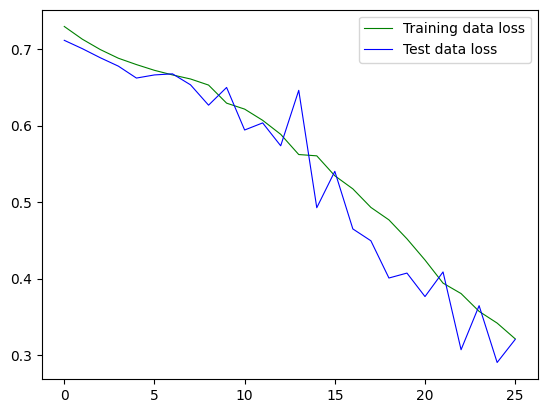

(0.31326064467430115, 0.3204422891139984, 3)

In [ ]:
#BFGS
model = copy.deepcopy(model_initial)
optimizer = optim.LBFGS(model.parameters(), lr=0.01)
loss_fn = torch.nn.BCELoss()
def closure():
    optimizer.zero_grad()
    loss_fn(model(X_train), y_train).backward()
    loss = loss_fn(model(X_train), y_train)
    return loss
train_loss, test_loss, epoch = model_train_basic_10_fold(model, X, y, optimizer, closure)
train_loss, test_loss, epoch

0
0
0
0
0
0
0
0
0
0


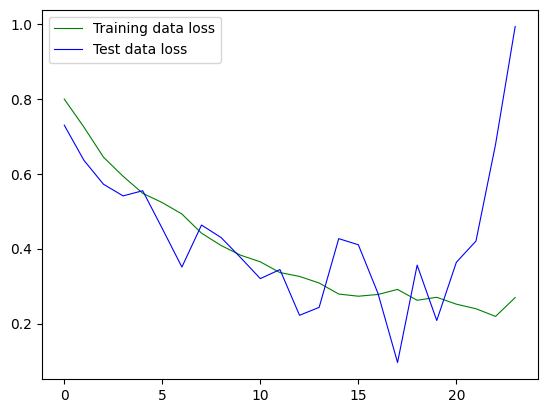

0
0
0
0
0
0
0
0
0
0


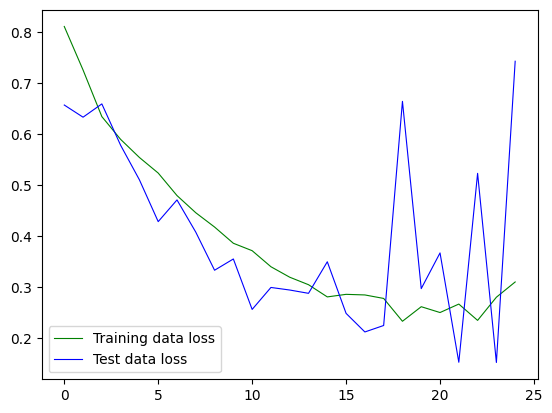

0
0
0
0
0
0
0
0
0
0


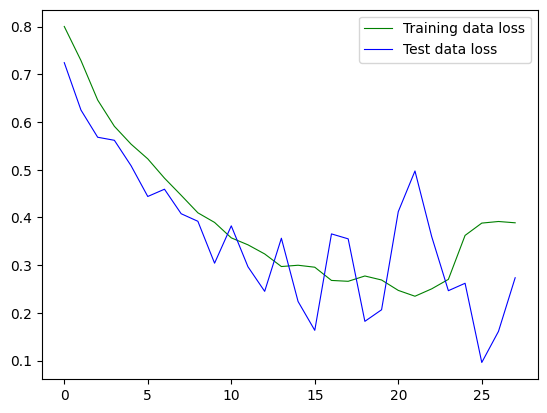

0
0
0
0
0
0
0
0
0
0


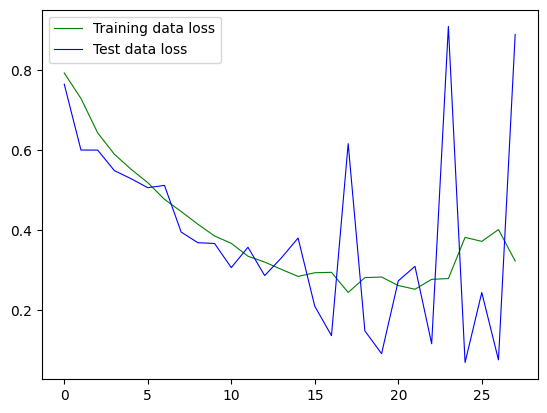

0
0
0
0
0
0
0
0
0
0


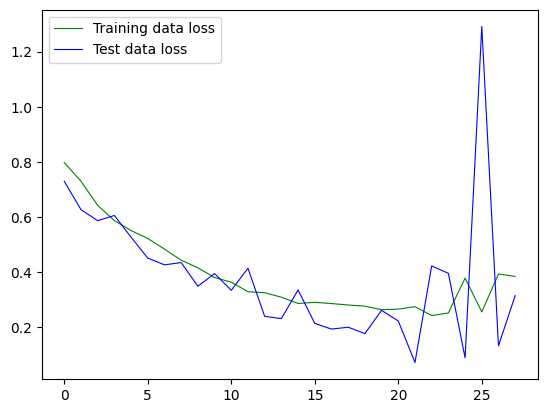

0
0
0
0
0
0
0
0
0
0


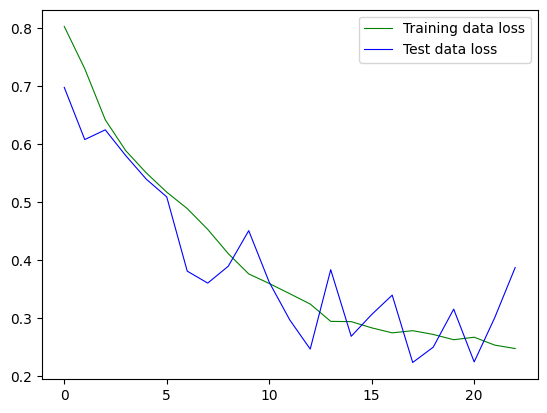

0
0
0
0
0
0
0
0
0
0


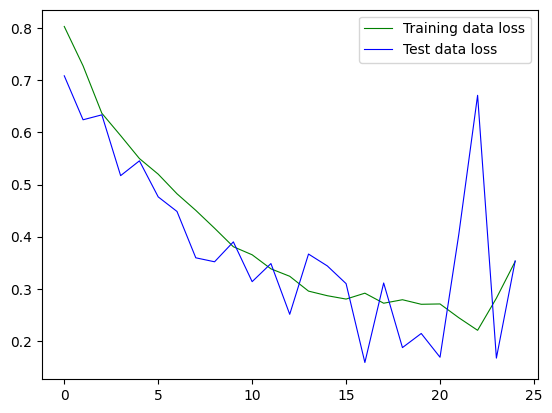

0
0
0
0
0
0
0
0
0
0


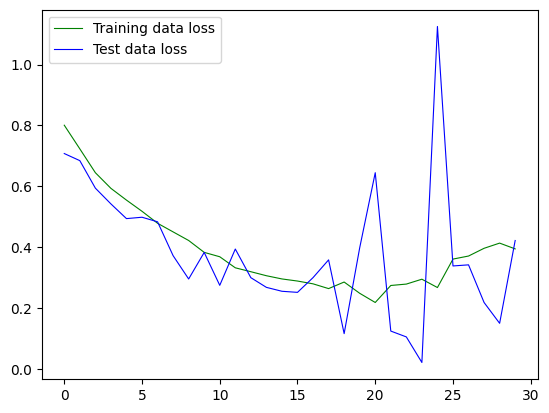

0
0
0
0
0
0
0
0
0
0


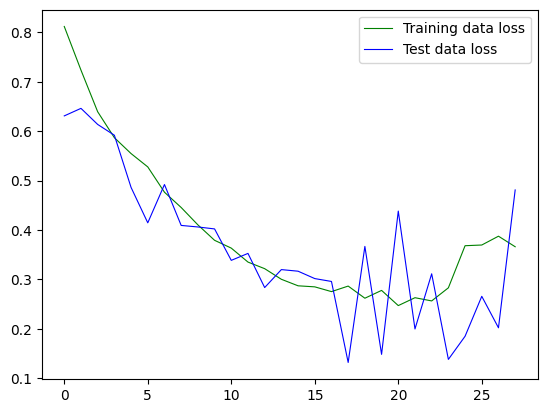

0
0
0
0
0
0
0
0
0
0


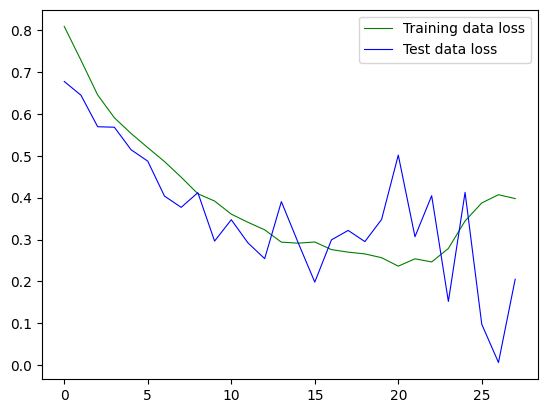

(np.float64(0.35993279218673707),
 np.float64(0.06419179233959048),
 np.float64(0.5062671363353729),
 np.float64(0.258213929523632))

In [ ]:
#BFGS

trl = []
tel = []
for i in range (10):
  model1 = copy.deepcopy(model_init)
  optimizer = optim.LBFGS(model1.parameters(), lr=0.01)
  loss_fn = torch.nn.BCELoss()
  def closure():
      optimizer.zero_grad()
      loss_fn(model1(X_train), y_train).backward()
      loss = loss_fn(model1(X_train), y_train)
      return loss
  train_loss, test_loss, epoch = model_train_basic_10_fold(model1, X, y, optimizer, closure)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
0
0
0
0
0
0
0
0
0


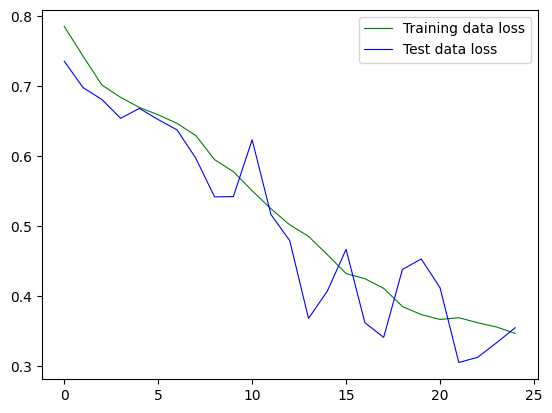

0
0
0
0
0
0
0
0
0
0


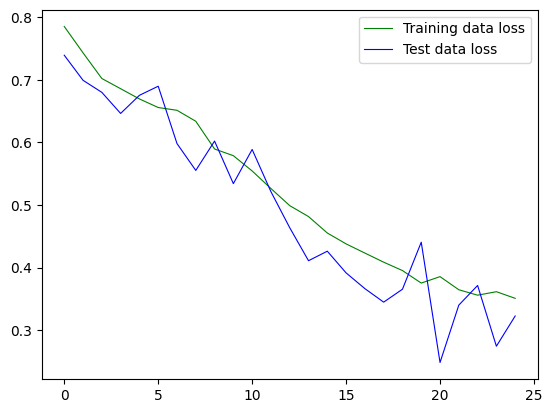

0
0
0
0
0
0
0
0
0
0


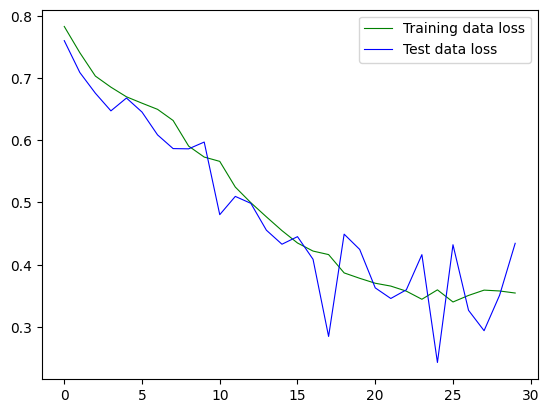

0
0
0
0
0
0
0
0
0
0


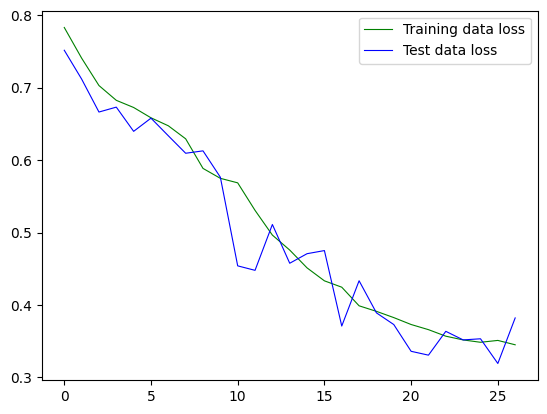

0
0
0
0
0
0
0
0
0
0


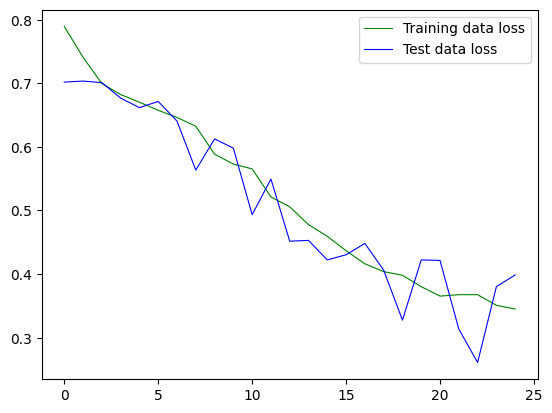

0
0
0
0
0
0
0
0
0
0


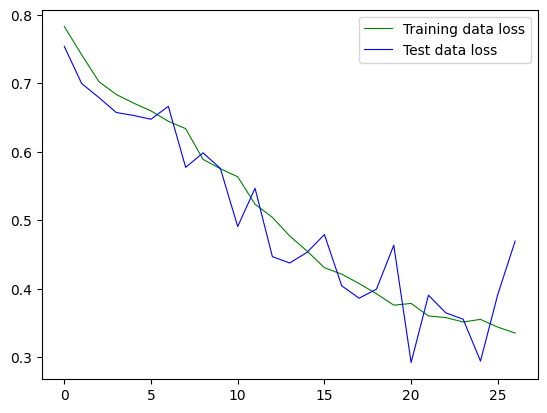

0
0
0
0
0
0
0
0
0
0


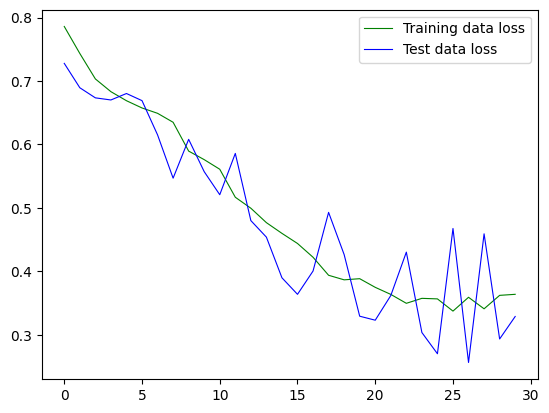

0
0
0
0
0
0
0
0
0
0


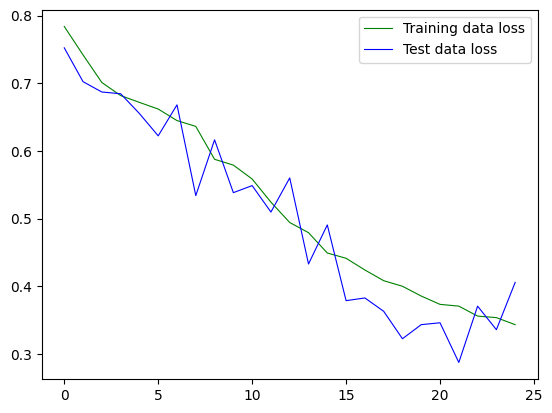

0
0
0
0
0
0
0
0
0
0


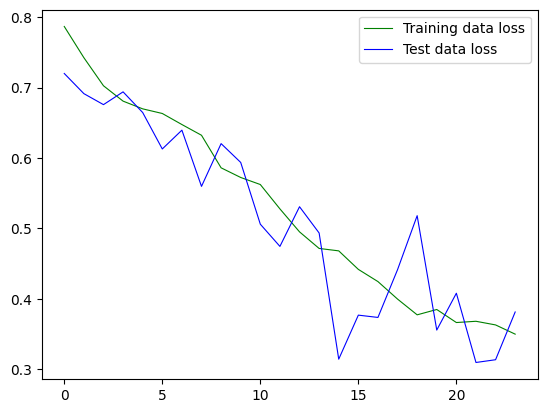

0
0
0
0
0
0
0
0
0
0


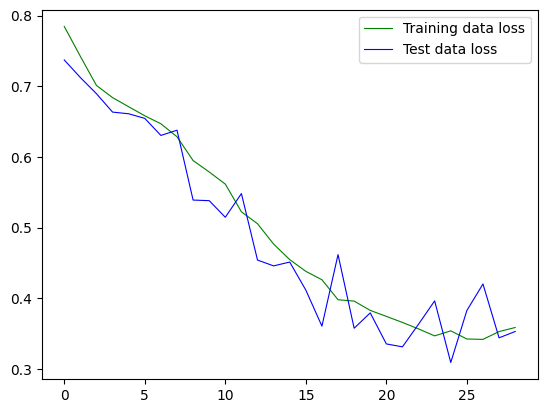

(np.float64(0.3503589928150177),
 np.float64(0.009089581682395813),
 np.float64(0.38315101265907286),
 np.float64(0.04369885548936502))

In [ ]:
#BFGS
model_init = Deep_std_uniform(0.34, 15)
trl = []
tel = []
for i in range (10):
  model1 = copy.deepcopy(model_init)
  optimizer = optim.LBFGS(model1.parameters(), lr=0.01)
  loss_fn = torch.nn.BCELoss()
  def closure():
      optimizer.zero_grad()
      loss_fn(model1(X_train), y_train).backward()
      loss = loss_fn(model1(X_train), y_train)
      return loss
  train_loss, test_loss, epoch = model_train_basic_10_fold(model1, X, y, optimizer, closure)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
0
0
0
0
0
0
0
0
0


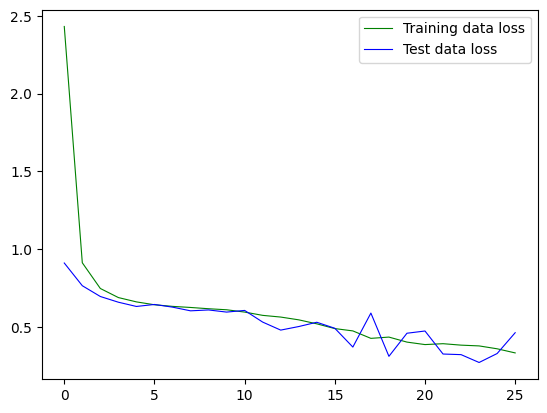

0
0
0
0
0
0
0
0
0
0


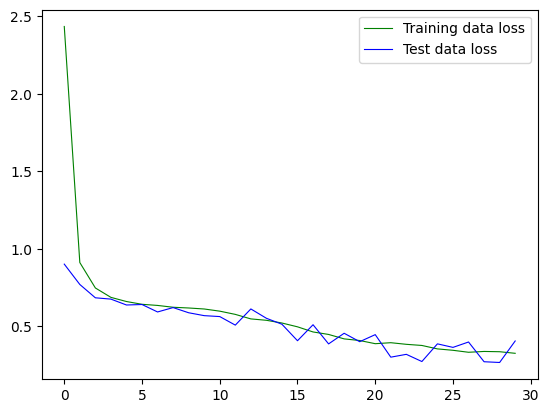

0
0
0
0
0
0
0
0
0
0


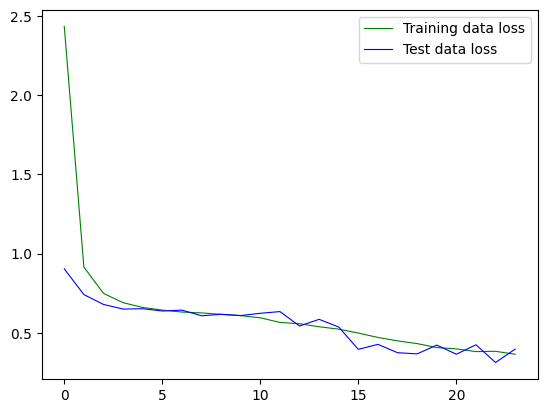

0
0
0
0
0
0
0
0
0
0


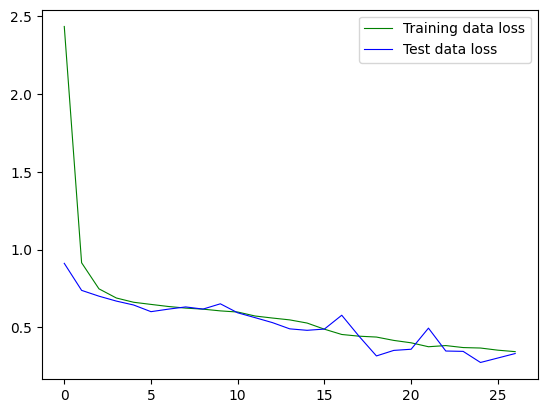

0
0
0
0
0
0
0
0
0
0


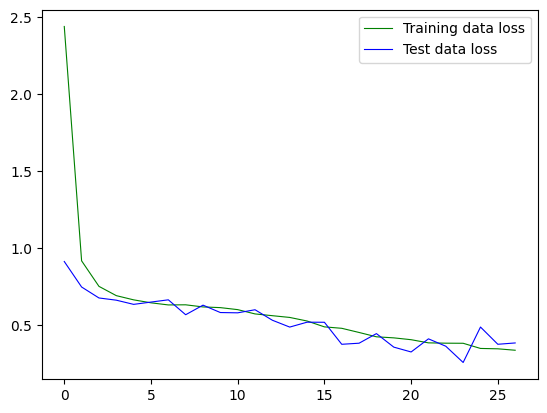

0
0
0
0
0
0
0
0
0
0


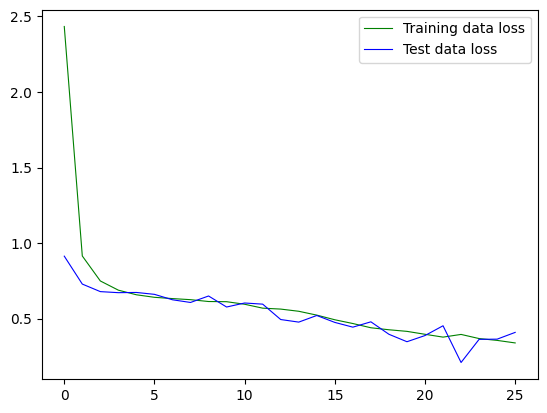

0
0
0
0
0
0
0
0
0
0


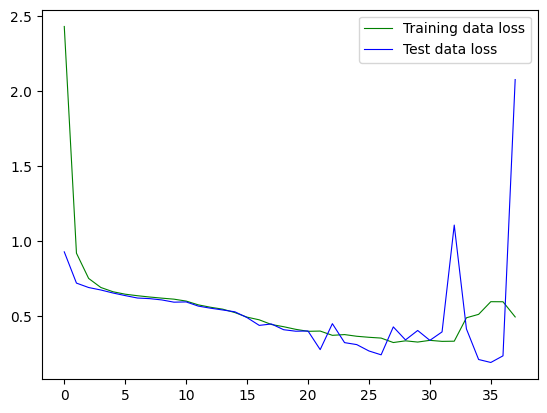

0
0
0
0
0
0
0
0
0
0


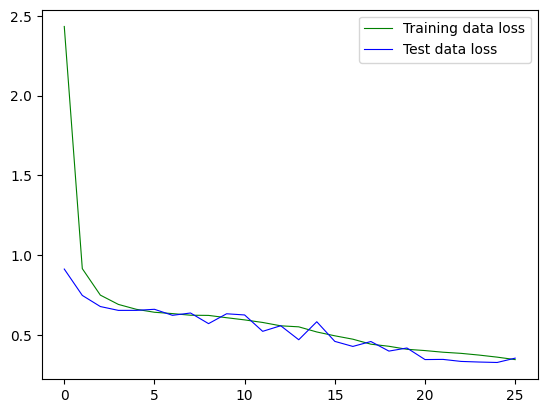

0
0
0
0
0
0
0
0
0
0


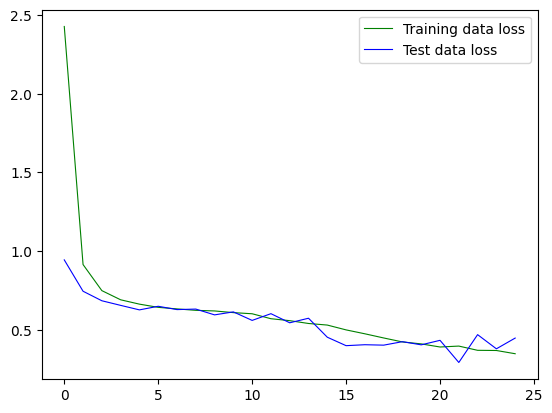

0
0
0
0
0
0
0
0
0
0


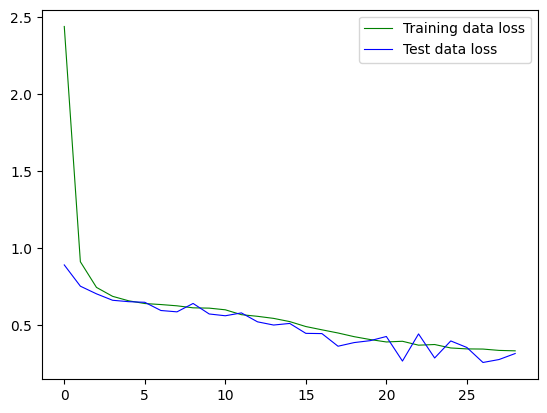

(np.float64(0.35195093154907225),
 np.float64(0.05222157442899284),
 np.float64(0.558389300107956),
 np.float64(0.5080902729753778))

In [ ]:
#BFGS
act = nn.Softplus()
model_init = Deep_std_uniform(0.34, 15)
trl = []
tel = []
for i in range (10):
  model1 = copy.deepcopy(model_init)
  optimizer = optim.LBFGS(model1.parameters(), lr=0.01)
  loss_fn = torch.nn.BCELoss()
  def closure():
      optimizer.zero_grad()
      loss_fn(model1(X_train), y_train).backward()
      loss = loss_fn(model1(X_train), y_train)
      return loss
  train_loss, test_loss, epoch = model_train_basic_10_fold(model1, X, y, optimizer, closure)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

In [ ]:
import math
class Deep_std_uniform_linear(nn.Module):
    def __init__(self, std, n_neurons = 20):
        super().__init__()
        self.layer1 = nn.Linear(16, n_neurons)
        torch.nn.init.uniform_(self.layer1.weight, a = -math.sqrt(std*std*12), b =math.sqrt(std*std*12))
        self.layer2 = nn.Linear(n_neurons, n_neurons)
        torch.nn.init.uniform_(self.layer2.weight, a = -math.sqrt(std*std*12), b =math.sqrt(std*std*12))
        self.output = nn.Linear(n_neurons, 1)
        torch.nn.init.uniform_(self.output.weight, a = -math.sqrt(std*std*12), b =math.sqrt(std*std*12))
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.sigmoid(self.output(x))
        return x

0
0
0
0
0
0
0
0
0
0


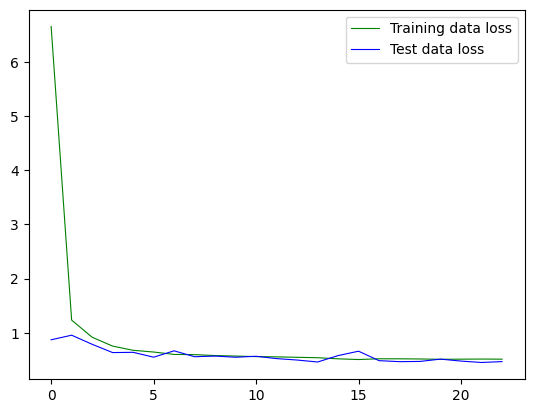

0
0
0
0
0
0
0
0
0
0


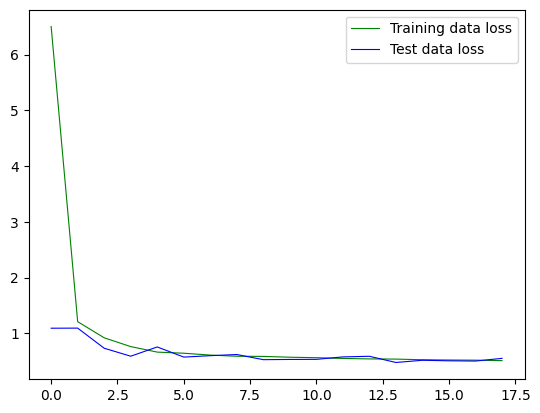

0
0
0
0
0
0
0
0
0
0


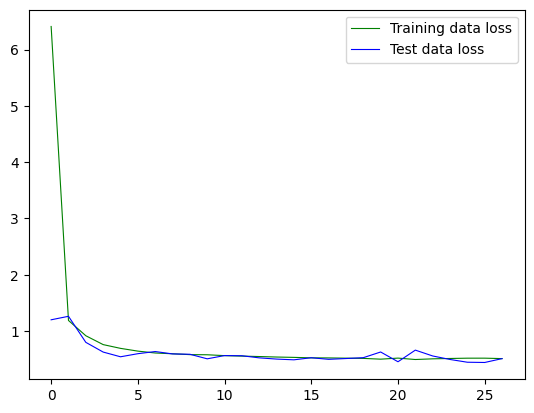

0
0
0
0
0
0
0
0
0
0


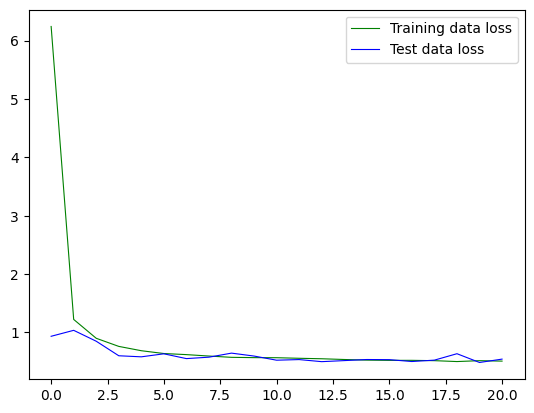

0
0
0
0
0
0
0
0
0
0


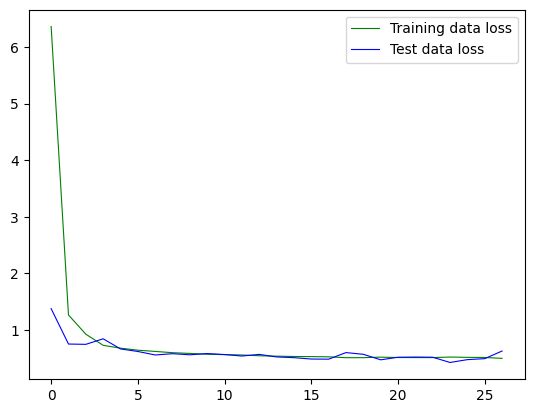

0
0
0
0
0
0
0
0
0
0


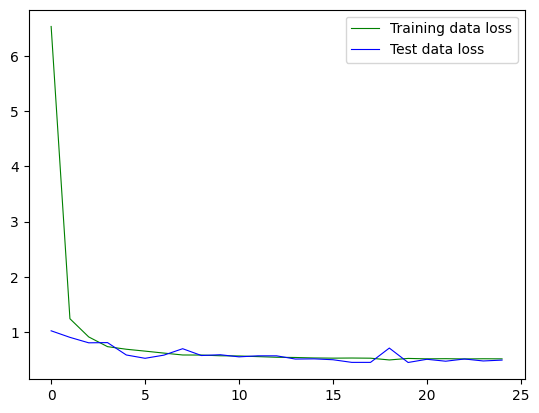

0
0
0
0
0
0
0
0
0
0


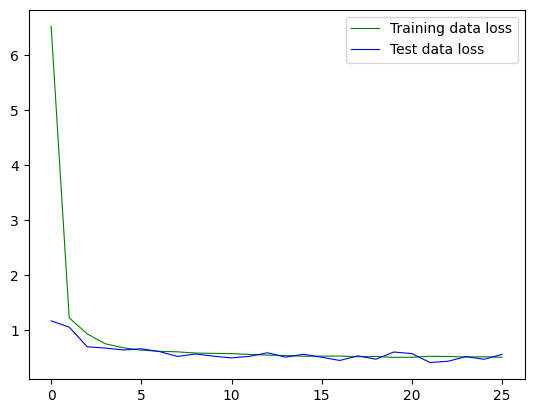

0
0
0
0
0
0
0
0
0
0


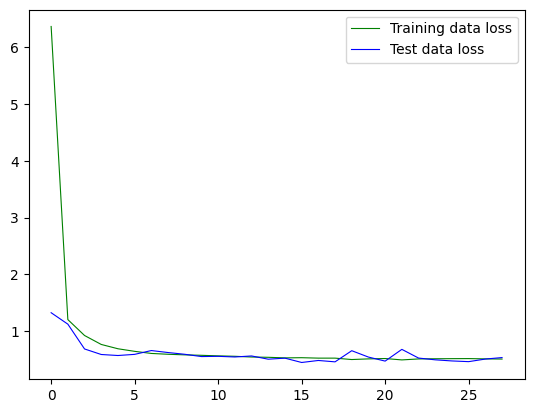

0
0
0
0
0
0
0
0
0
0


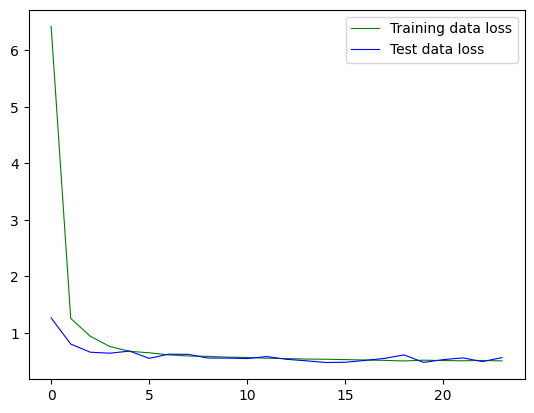

0
0
0
0
0
0
0
0
0
0


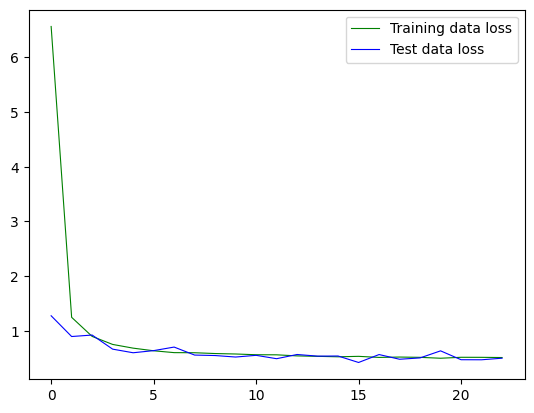

(np.float64(0.5074119478464126),
 np.float64(0.0048398055187362675),
 np.float64(0.5339352548122406),
 np.float64(0.04243897767710527))

In [ ]:
#BFGS
act = nn.Softplus()
model_init = Deep_std_uniform_linear(0.34, 15)
trl = []
tel = []
for i in range (10):
  model1 = copy.deepcopy(model_init)
  optimizer = optim.LBFGS(model1.parameters(), lr=0.01)
  loss_fn = torch.nn.BCELoss()
  def closure():
      optimizer.zero_grad()
      loss_fn(model1(X_train), y_train).backward()
      loss = loss_fn(model1(X_train), y_train)
      return loss
  train_loss, test_loss, epoch = model_train_basic_10_fold(model1, X, y, optimizer, closure)
  trl.append(train_loss)
  tel.append(test_loss)
np.array(trl).mean(), np.array(trl).std(), np.array(tel).mean(), np.array(tel).std()

0
100
200
300
400
500
600
700
800
900


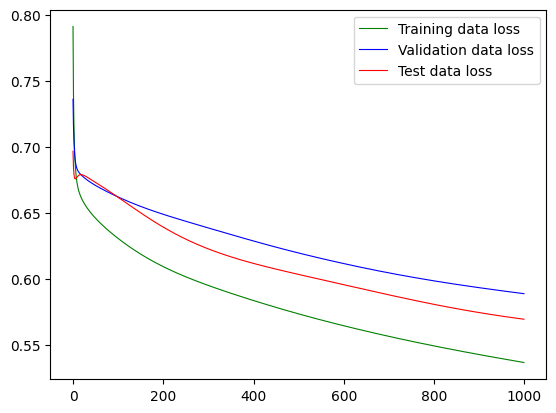

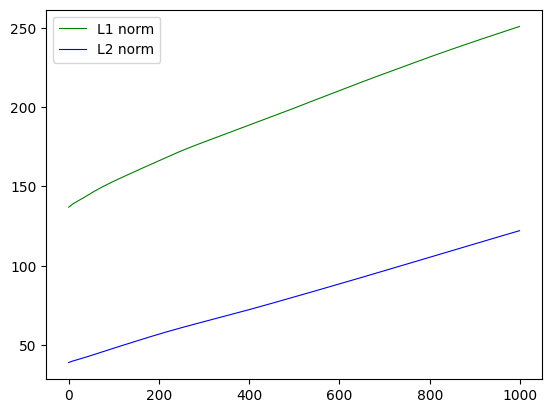

0
100


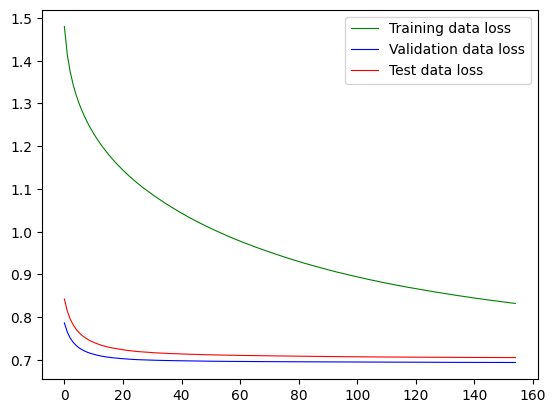

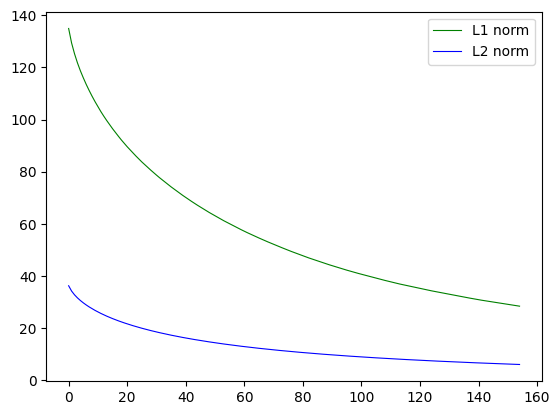

0


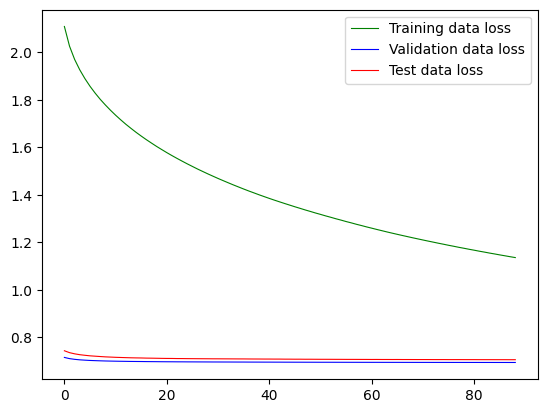

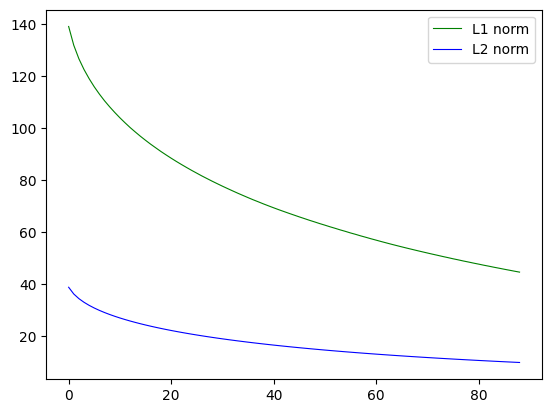

0


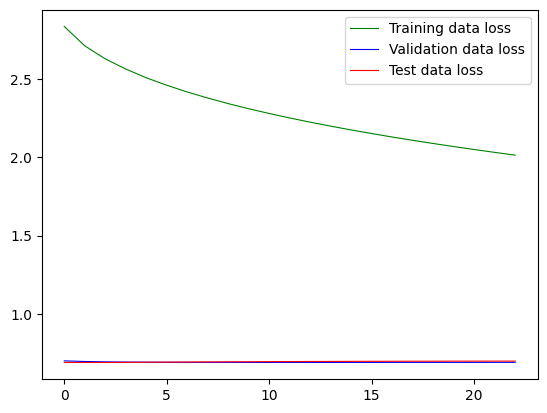

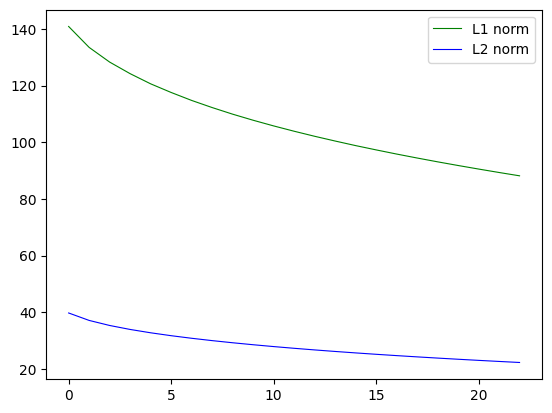

0


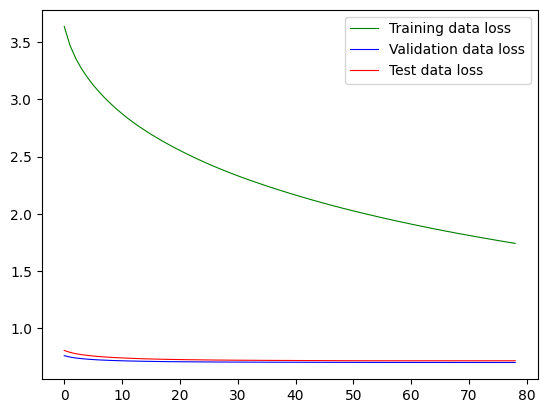

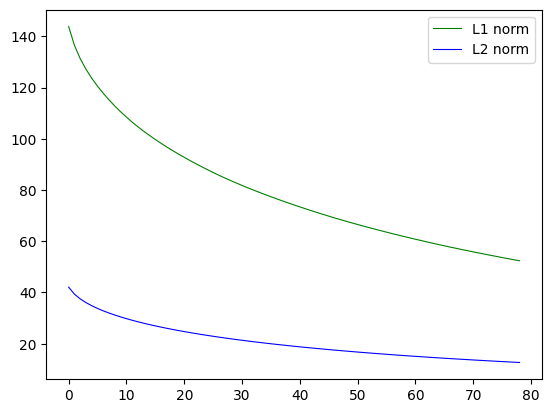

0


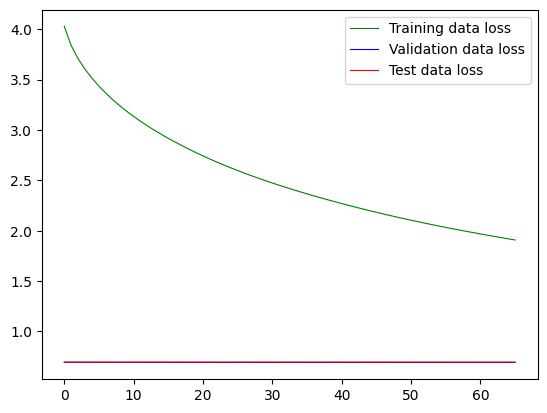

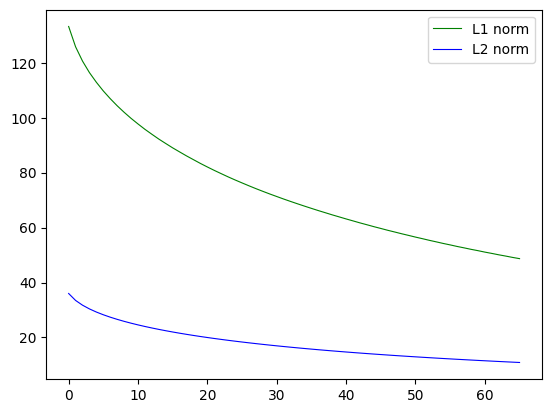

0
100
200
300


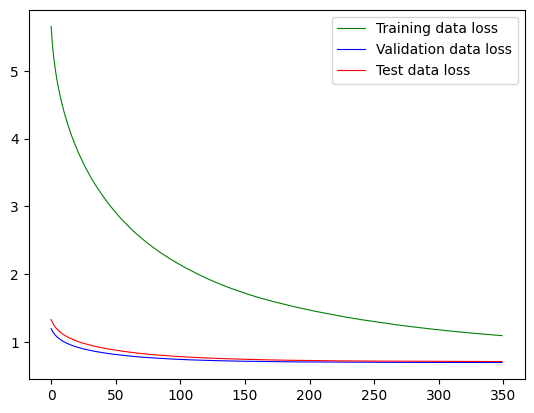

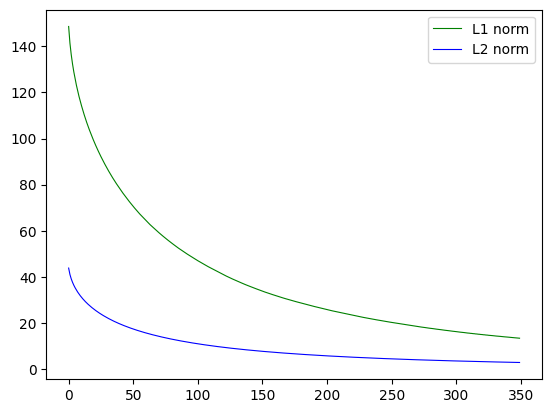

0


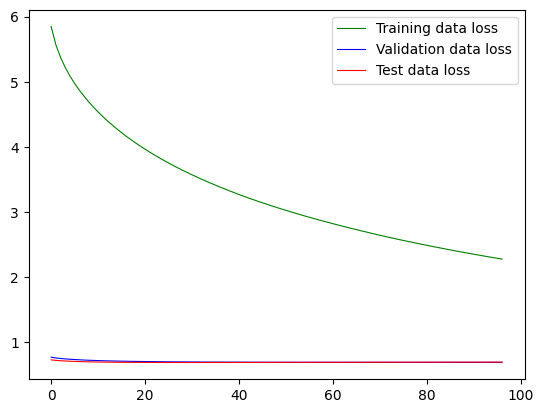

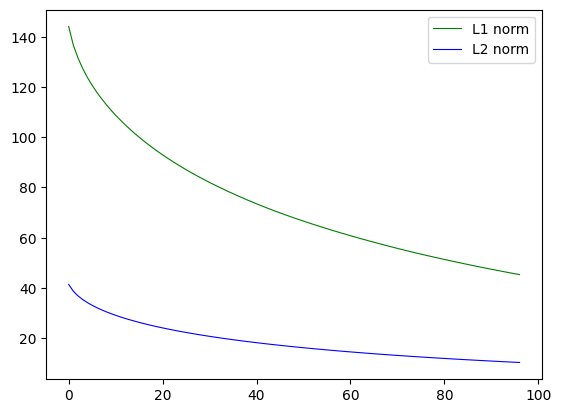

0


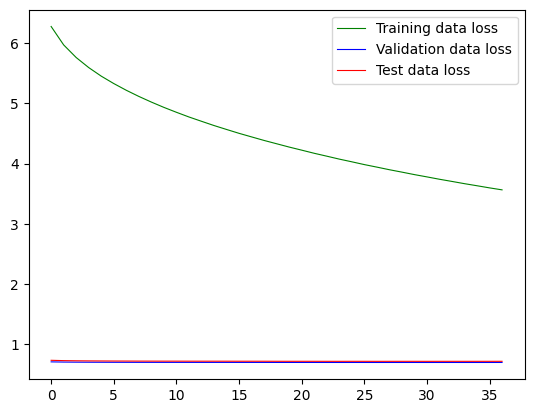

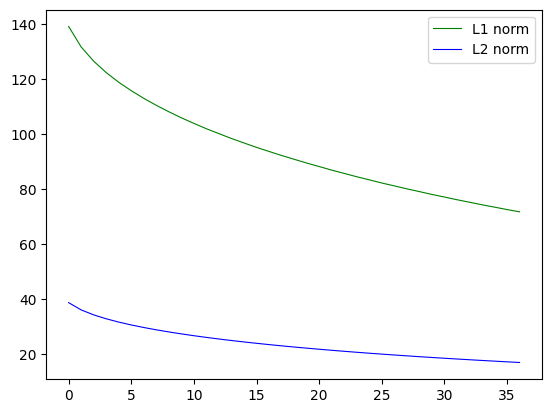

0


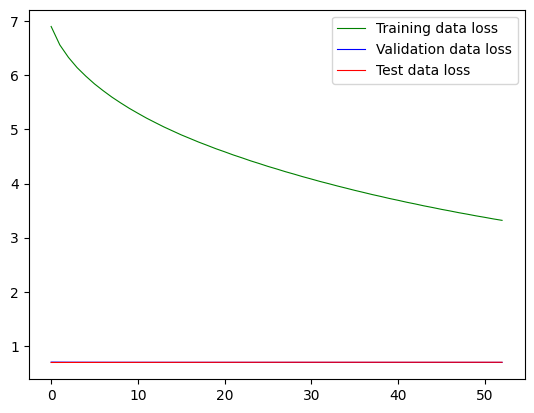

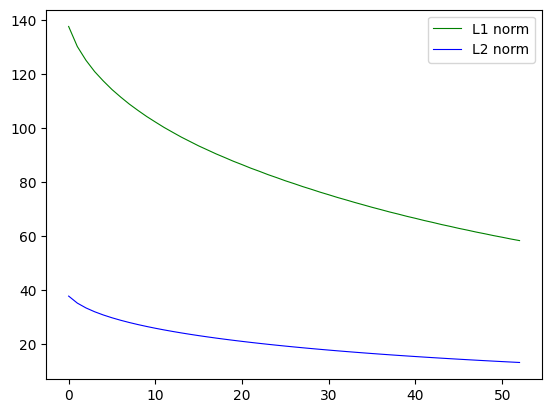

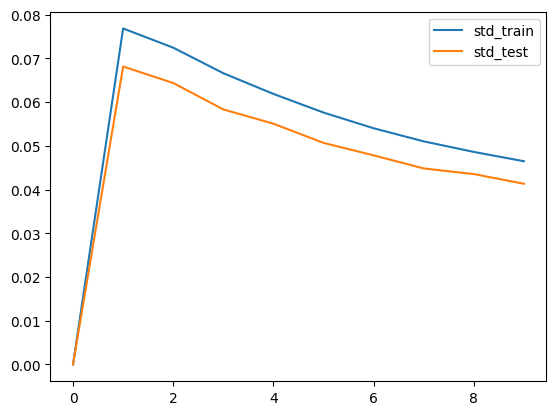

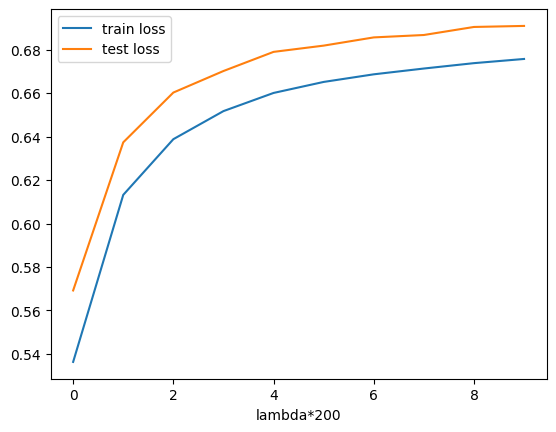

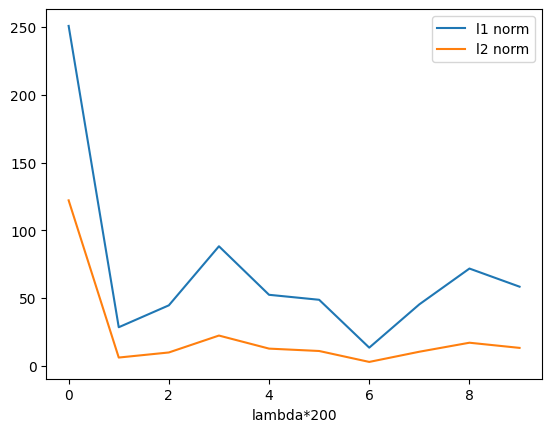

In [ ]:
#Adagrad
std_test_total=[]
mean_test_total=[]
std_train_total=[]
mean_train_total=[]
l1 = []
l2 = []
trl = []
tel = []
for j in range (10):
  for i in range (1):
      model1 = Deep()
      optimizer = optim.Adagrad(model1.parameters(), lr = 0.01)
      train_loss, test_loss, epoch, l1n, l2n = model_train(model1, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, regularization_type="L1", lambda_reg=j*0.005)
      l1.append(l1n)
      l2.append(l2n)
      trl.append(train_loss)
      tel.append(test_loss)
  std_train_total.append(np.array(trl).std())
  mean_train_total.append(np.array(trl).mean())
  std_test_total.append(np.array(tel).std())
  mean_test_total.append(np.array(tel).mean())
plt.plot(std_train_total, label = "std_train")
plt.plot(std_test_total, label = "std_test")
plt.legend()
plt.show()
plt.plot(mean_train_total, label = "train loss")
plt.plot(mean_test_total, label = "test loss")
plt.xlabel("lambda*200")
plt.legend()
plt.show()
plt.plot(l1, label = "l1 norm")
plt.plot(l2, label = "l2 norm")
plt.xlabel("lambda*200")
plt.legend()
plt.show()

0
100
200
300
400
500
600
700
800
900


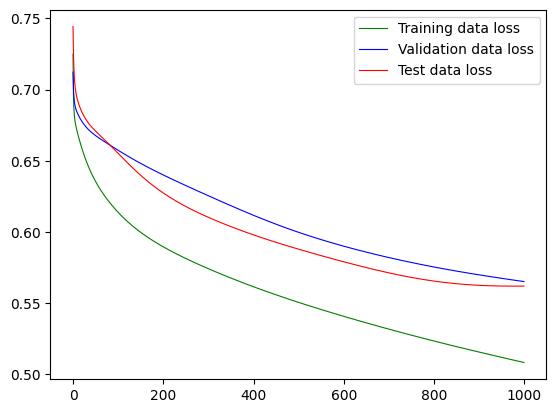

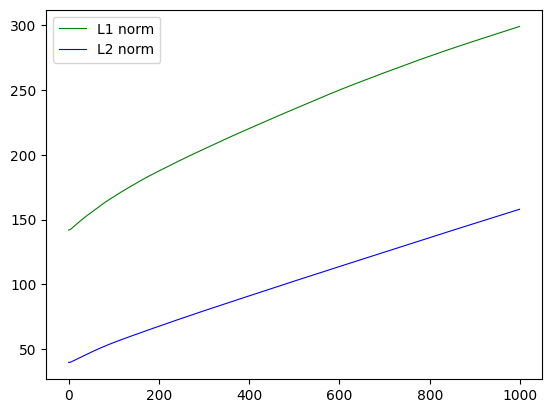

0
100
200
300
400
500
600
700
800
900


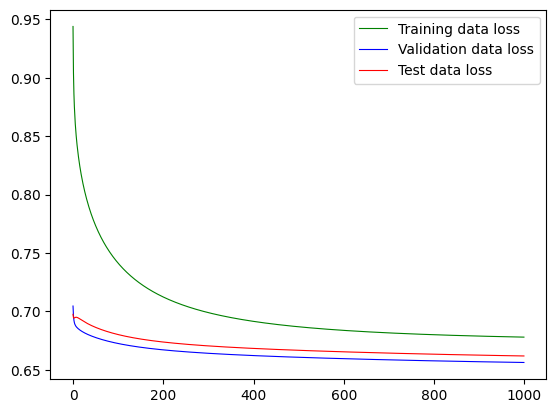

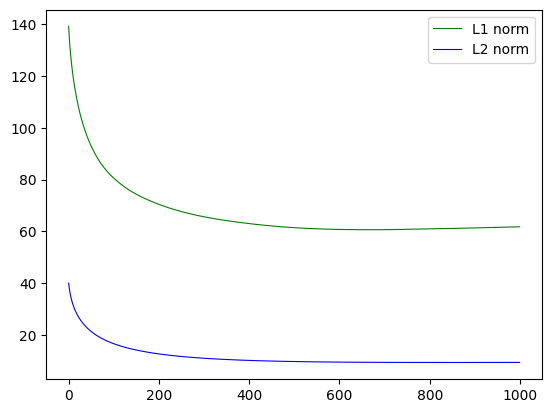

0
100


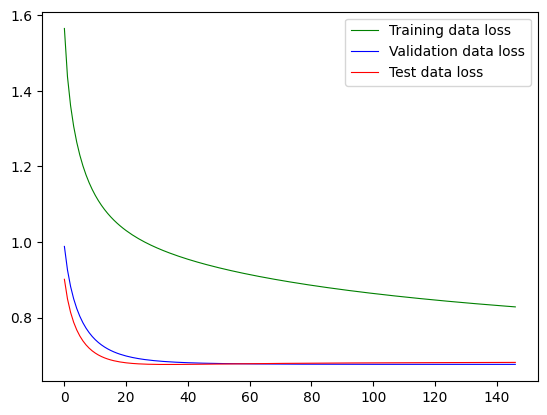

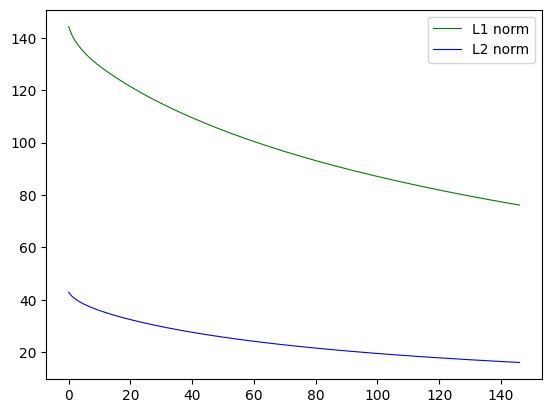

0


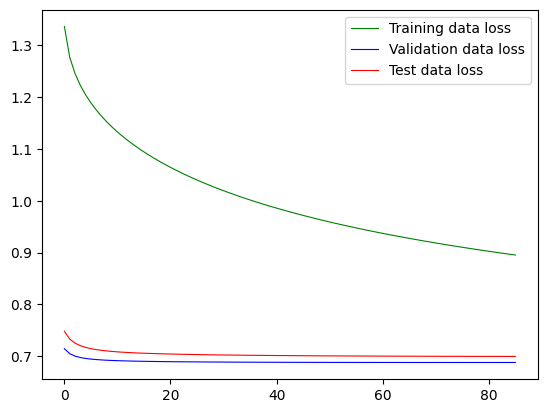

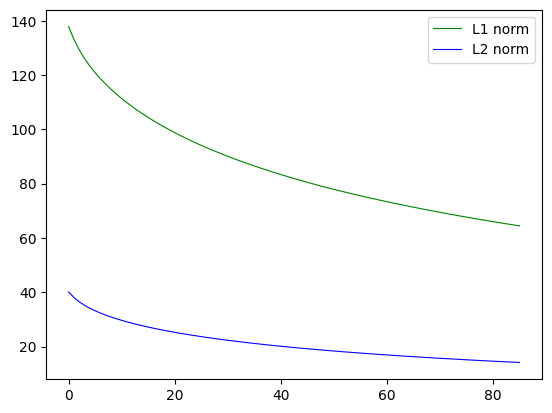

0


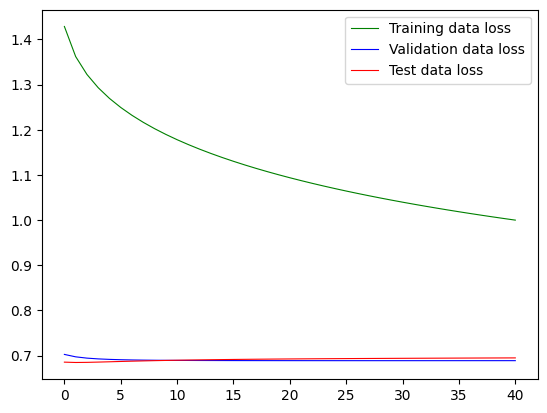

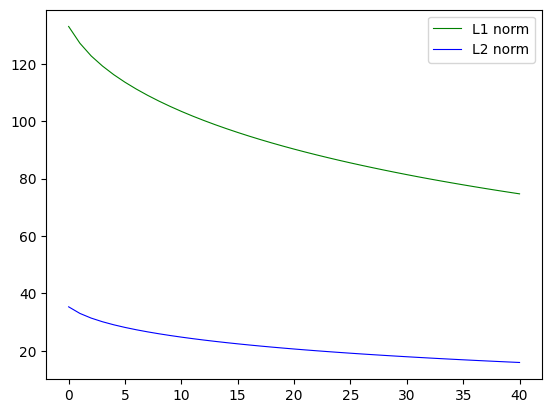

0


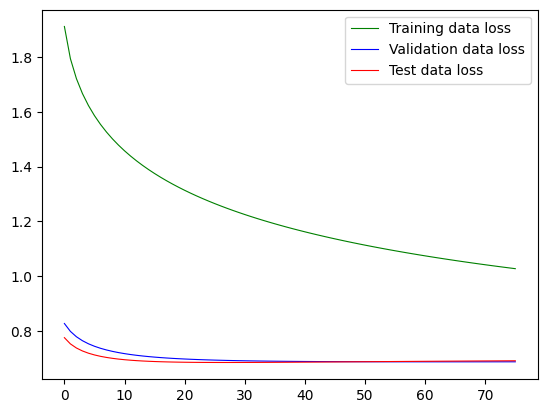

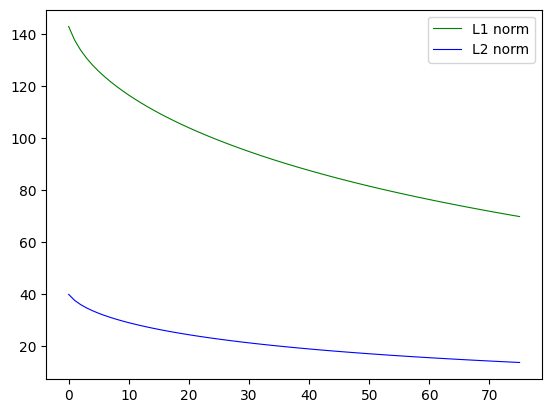

0


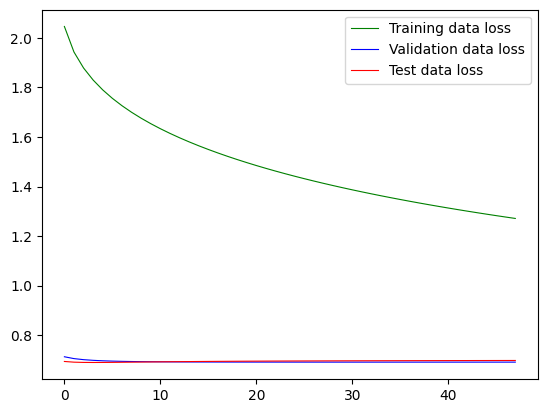

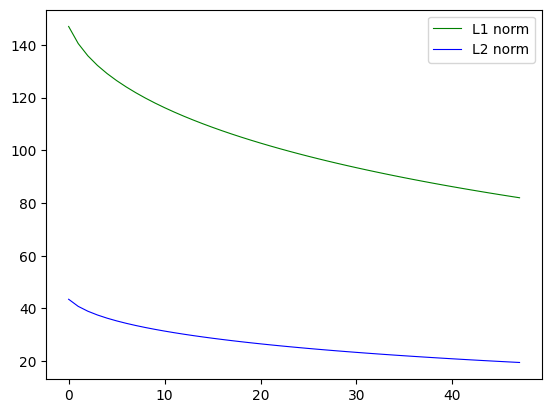

0


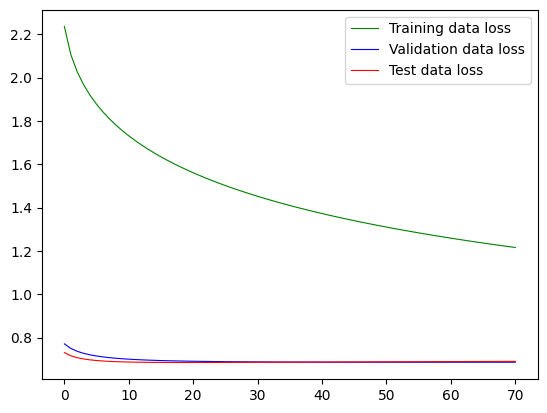

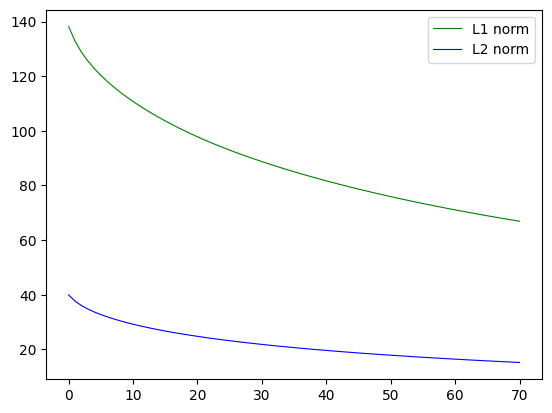

0


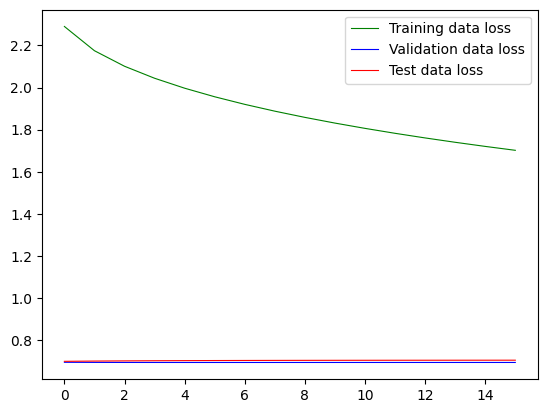

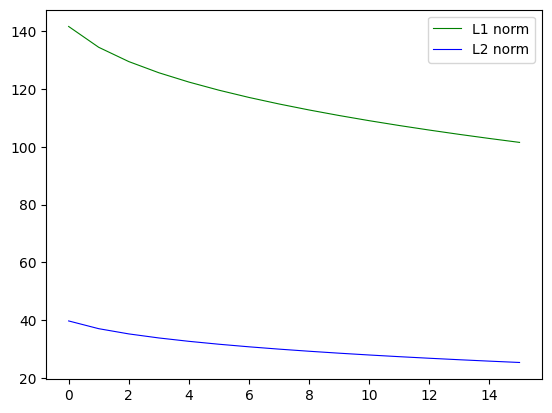

0


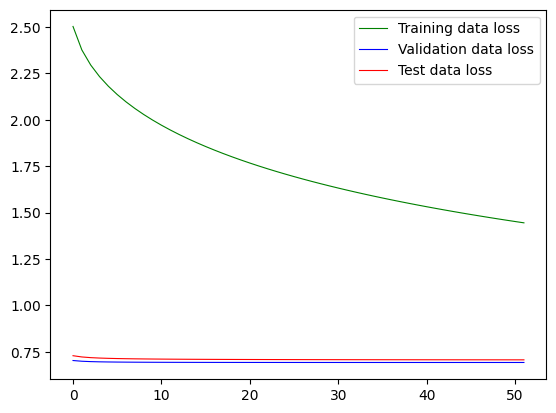

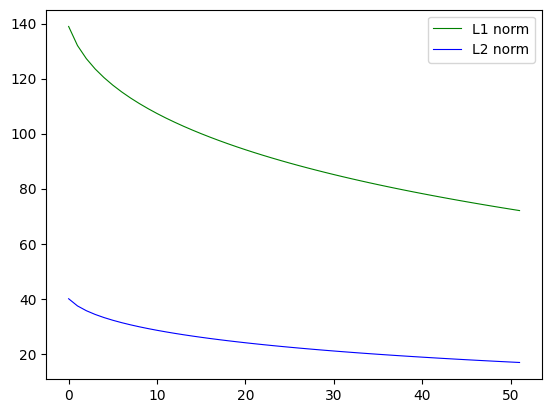

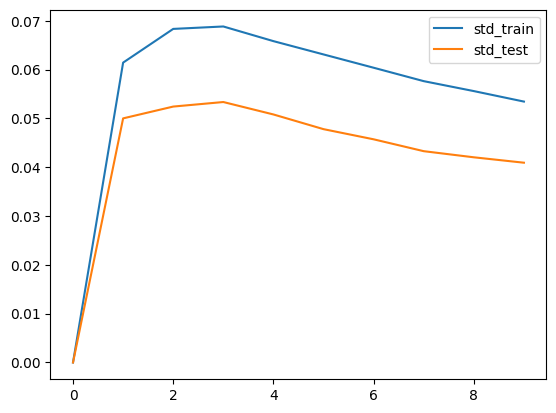

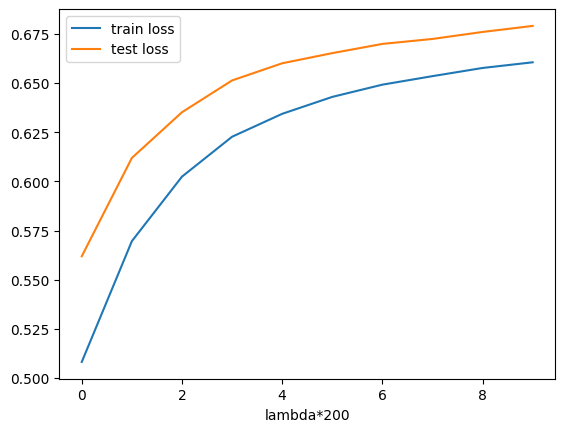

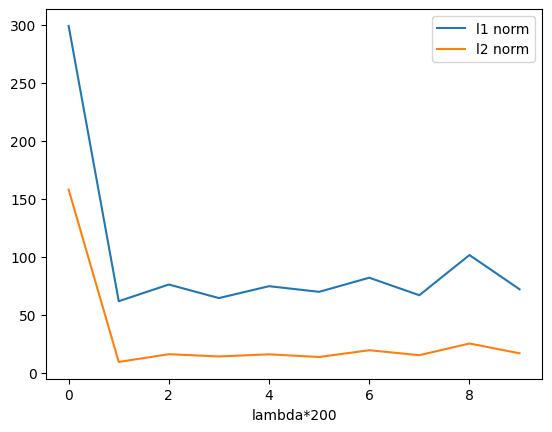

In [ ]:
#Adagrad
std_test_total=[]
mean_test_total=[]
std_train_total=[]
mean_train_total=[]
l1 = []
l2 = []
trl = []
tel = []
for j in range (10):
  for i in range (1):
      model1 = Deep()
      optimizer = optim.Adagrad(model1.parameters(), lr = 0.01)
      train_loss, test_loss, epoch, l1n, l2n = model_train(model1, X_train, y_train, X_val, y_val, X_test, y_test, optimizer, regularization_type="L2", lambda_reg=j*0.005)
      l1.append(l1n)
      l2.append(l2n)
      trl.append(train_loss)
      tel.append(test_loss)
  std_train_total.append(np.array(trl).std())
  mean_train_total.append(np.array(trl).mean())
  std_test_total.append(np.array(tel).std())
  mean_test_total.append(np.array(tel).mean())
plt.plot(std_train_total, label = "std_train")
plt.plot(std_test_total, label = "std_test")
plt.legend()
plt.show()
plt.plot(mean_train_total, label = "train loss")
plt.plot(mean_test_total, label = "test loss")
plt.xlabel("lambda*200")
plt.legend()
plt.show()
plt.plot(l1, label = "l1 norm")
plt.plot(l2, label = "l2 norm")
plt.xlabel("lambda*200")
plt.legend()
plt.show()

In [ ]:
def convert_to_binary(arr, threshold=0.5):
  """
  Converts a NumPy array to binary based on a threshold.

  Args:
    arr (np.ndarray): The input NumPy array.
    threshold (float, optional): The threshold value. Defaults to 0.5.

  Returns:
    np.ndarray: A binary NumPy array (0 and 1).
  """
  return (arr > threshold).astype(int)

In [ ]:
loss_fn = nn.BCELoss()
loss_fn(y_train, model(X_train))

tensor(40.5078, grad_fn=<BinaryCrossEntropyBackward0>)

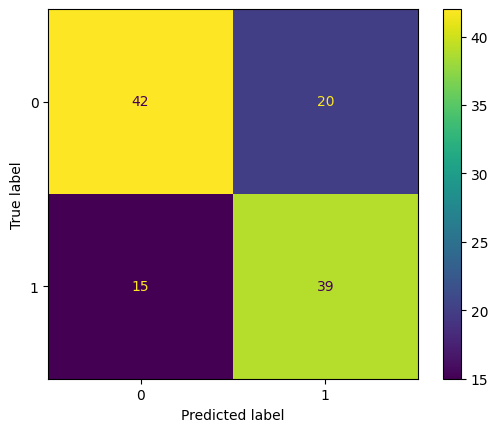

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
y_pred = model(X_test)
cm = confusion_matrix(y_test, convert_to_binary(y_pred.detach().numpy()))
ConfusionMatrixDisplay(cm).plot()
incorrect _predictions = np.count_nonzero(y_test - convert_to_binary(y_pred.detach().numpy()))
error_rate = incorrect_predictions / total_predictions

In [ ]:
model2 = Deep()

In [ ]:
model = copy.deepcopy(model_initial)

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900


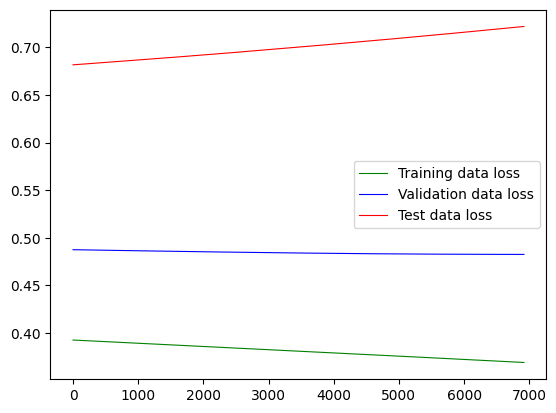

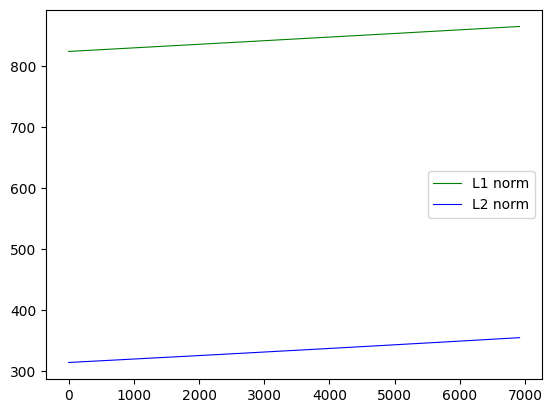

(0.3715360462665558, 0.7173509001731873, 6918)

In [ ]:
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum = 0.5, nesterov = True)
train_loss, test_loss, epoch, l1, l2 = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

In [ ]:
optimizer = optim.SGD(model.parameters(), lr=0.1, momentum = 0.1, nesterov = True)
train_loss, test_loss, epoch, l1, l2 = model_train(model, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

In [ ]:
rng = np.random.default_rng()

In [ ]:
X_noisy = np.concatenate((X, rng.normal(size=(25, 16))))

In [ ]:
X_noisy = np.concatenate((X, rng.normal(size=(25, 16))))
y_noisy = np.concatenate((y, convert_to_binary(rng.normal(size=(25, 1)), threshold=0)))


X_train_n, X_test_n, y_train_n, y_test_n = train_test_split(X_noisy, y_noisy, test_size=0.1, random_state=1)

X_train_n, X_val_n, y_train_n, y_val_n = train_test_split(X_train_n, y_train_n, test_size=0.33, random_state=1)


X_train_n = torch.tensor(X_train_n, dtype=torch.float32)
y_train_n = torch.tensor(y_train_n, dtype=torch.float32)
X_val_n = torch.tensor(X_val_n, dtype=torch.float32)
y_val_n = torch.tensor(y_val_n, dtype=torch.float32)
X_test_n = torch.tensor(X_test_n, dtype=torch.float32)
y_test_n = torch.tensor(y_test_n, dtype=torch.float32)

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900


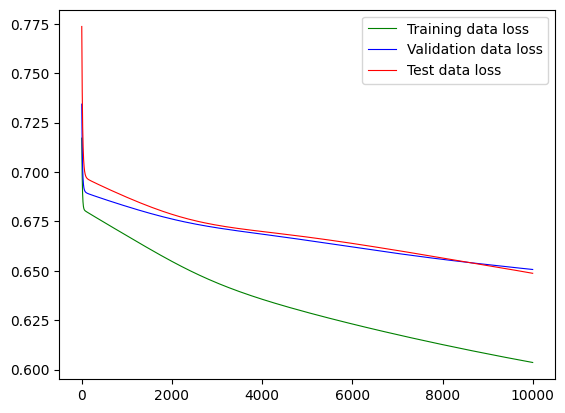

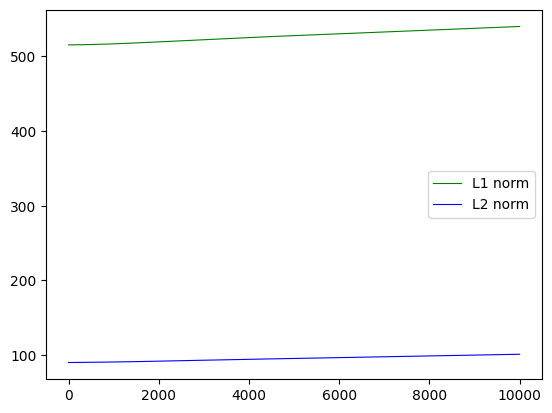

(0.6063299775123596, 0.6512706279754639, 9999)

In [ ]:
model_1 = copy.deepcopy(model_initial)
optimizer = optim.SGD(model_1.parameters(), lr=0.01, momentum = 0.01, nesterov = True)
train_loss, test_loss, epoch, l1, l2 = model_train(model_1, X_train, y_train, X_val, y_val, X_test, y_test, optimizer)
train_loss, test_loss, epoch

0


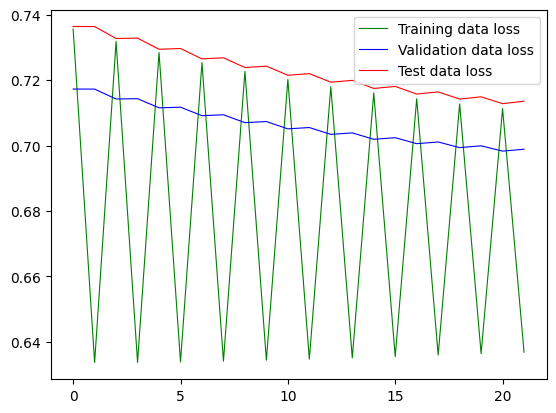

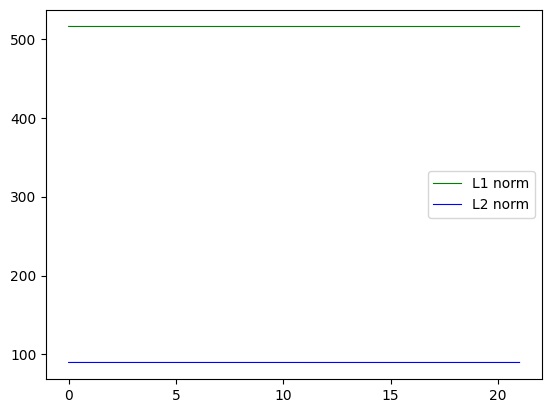

(0.7297301292419434, 0.736372709274292, 10)

In [ ]:
model_noisy = copy.deepcopy(model_initial)
optimizer = optim.SGD(model_noisy.parameters(), lr=0.01, momentum = 0.01, nesterov = True)
train_loss, test_loss, epoch, l1, l2 = model_train(model_noisy, X_train_n, y_train_n, X_val_n, y_val_n, X_test_n, y_test_n, optimizer)
train_loss, test_loss, epoch

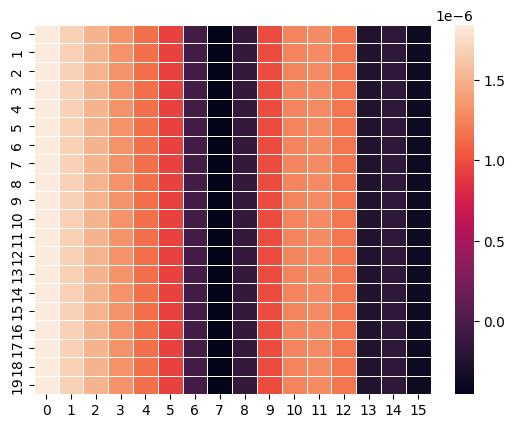

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pylab as plt

uniform_data = np.random.rand(10, 12)
ax = sns.heatmap(model1.layer1.weight.detach().numpy(), linewidth=0.5)
plt.show()

plt.show()